In [4608]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
#yesterday1 = date.today() - timedelta(days=3)
d12f = lambda x:(date.today() - timedelta(days=x)).strftime("%Y-%m-%d")

countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

221


In [4609]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS1(dfLV,vL=[0,1],pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [4610]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])**0.5*(t- coeffs[3])**0.5 )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases',zoom=1.):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7]*coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop/4,  2.61212092e+01, -9.65961409e-01,  5.96529356e-03], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    if zoom != 1.:
        ax3.set_ylim([0,zoom])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL[1],nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL[0],nu=x[3])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSS1(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [4996]:
def forecastRRA(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  (coeffs[0]*coeffs[1]*np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2]))/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]))/(0.00020109*t+0.01602351)
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_RA.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_RA.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x, t[-1],tt+8,allmodel 

def forecast2RRA(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a) 
    acoef = [0.00020331, 0.01585989]
    def model(t, coeffs):
        coeffsUS=coeffs2#[5.34712379e+04,  1.87189938e+01, -9.10329896e+01,  2.63753359e-03]
        return  (coeffs[0]*coeffs[1]*np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2]))/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+model0(t, coeffsUS))/(acoef[0]*t+acoef[1])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  (coeffs[0]*coeffs[1]*np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2]))/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]))/(acoef[0]*t+acoef[1])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    #x0 = np.array([5.86900283e+04, 2.15711530e+01, -9.80541238e+01,  2.21893275e-03], dtype=float)
    x0 = np.array([5.40599372e+03, 4.02558326e+00, 9.34289930e+01, 9.87224726e-01], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_RA.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_RA.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x, t+8,allmodel 


In [4633]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly\nChange,Net\nChange,Density\n(P/Km²),Land Area\n(Km²),Migrants\n(net),Fert.\nRate,Med.\nAge,Urban\nPop %,World\nShare
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [4634]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [4635]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [4636]:
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,11683249,7000.0,358640.0,680.0,7703446.0,"+5,844",3621163,21735.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,Asia,14048637,10090.0,249251.0,130.0,12537763.0,"+7,982",1261623,22539.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
2,NaN,South America,9827408,126.0,298817.0,7.0,8828637.0,316,699954,17958.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
3,NaN,Europe,11047048,53120.0,280045.0,829.0,4116471.0,"+36,416",6650532,24782.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,1840838,1971.0,44077.0,65.0,1529549.0,"+31,695",267212,2436.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [4637]:
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
228,NaN,Total:,11047048,53120.0,280045.0,829.0,4116471.0,"+36,416",6650532,24782.0,NaN,NaN,NaN,NaN,NaN,Europe,,NaN,NaN
229,NaN,Total:,1840838,1971.0,44077.0,65.0,1529549.0,"+31,695",267212,2436.0,NaN,NaN,NaN,NaN,NaN,Africa,,NaN,NaN
230,NaN,Total:,39569,14.0,980.0,NaN,32787.0,NaN,5802,26.0,NaN,NaN,NaN,NaN,NaN,Australia/Oceania,,NaN,NaN
231,NaN,Total:,721,NaN,15.0,NaN,659.0,NaN,47,4.0,NaN,NaN,NaN,NaN,NaN,NaN,,NaN,NaN
232,NaN,European Union,7212035,23866.0,184862.0,344.0,1801181.0,NaN,3399738,19809.0,16197.701683,415.186494,118582141.0,266326.791933,NaN,Europe,NaN,NaN,NaN


In [4638]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,11683249,7000.0,358640.0,680.0,7703446.0,"+5,844",3621163,21735.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,Asia,14048637,10090.0,249251.0,130.0,12537763.0,"+7,982",1261623,22539.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
2,NaN,South America,9827408,126.0,298817.0,7.0,8828637.0,316,699954,17958.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
3,NaN,Europe,11047048,53120.0,280045.0,829.0,4116471.0,"+36,416",6650532,24782.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,1840838,1971.0,44077.0,65.0,1529549.0,"+31,695",267212,2436.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [4639]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
102,96.0,Lithuania,18092,0.0,182.0,0.0,5082.0,0,12828,51.0,6679.0,67.0,1050223.0,387700.0,"2,708,852",Europe,150,"14,884",3


No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:815: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


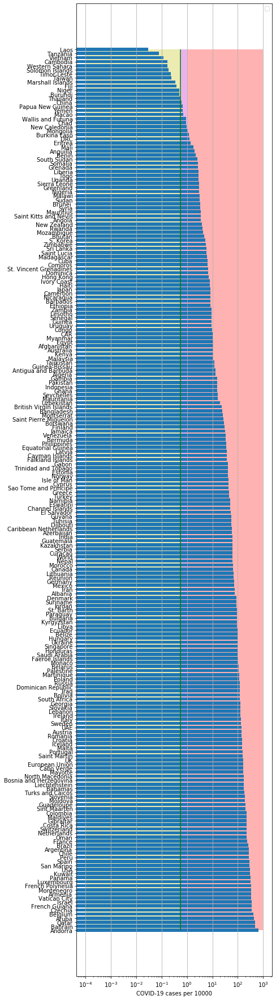

In [4640]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:815: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


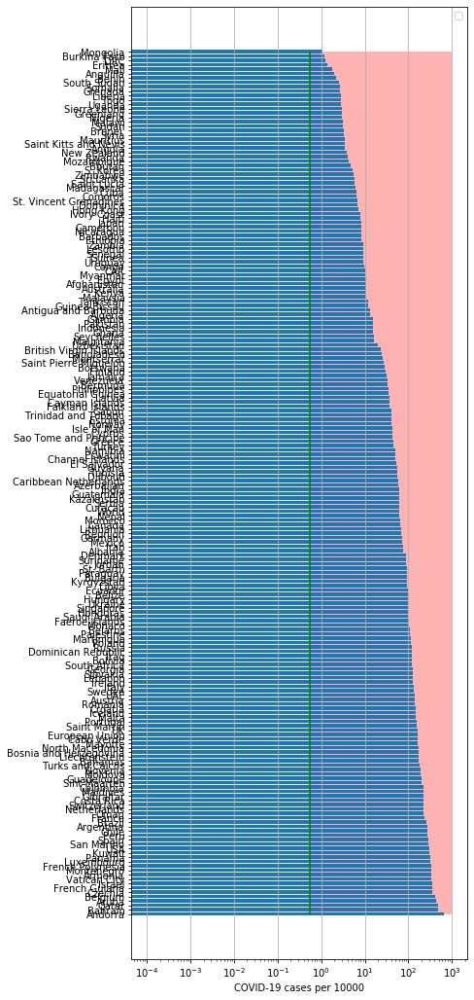

In [4641]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

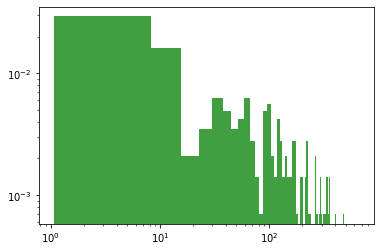

In [4642]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [4643]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
           date    cases  active    death
259 2020-10-31  1280504       0  35878.0
260 2020-11-01  1296693       0  35878.0
261 2020-11-02  1313087       0  36257.0
262 2020-11-03  1331756       0  36495.0
263 2020-11-04  1356798       0  38118.0
GB
           date    cases  active    death
248 2020-10-31  1011660       0  46555.0
249 2020-11-01  1034914       0  46717.0
250 2020-11-02  1053864       0  46853.0
251 2020-11-03  1073882       0  47250.0
252 2020-11-04  1099059       0  47742.0
IT
           date   cases  active    death
251 2020-10-31  679430  351386  38618.0
252 2020-11-01  709335  378129  38826.0
253 2020-11-02  731588  396512  39059.0
254 2020-11-03  759829  418142  39412.0
255 2020-11-04  790377  443235  39764.0
LT
           date    cases  active  death      tests
236 2020-10-31  15719.0   10613  166.0  1027761.0
237 2020-11-01  16556.0   11435  170.0  1033171.0
238 2020-11-02  17453.0   12283  175.0  1038164.0
239 2020-11-03  18092.0   12765  182.0  1050223.0
24

           date    cases  active  death
249 2020-10-31  16291.0    4633  358.0
250 2020-11-01  16400.0    4742  358.0
251 2020-11-02  16637.0    4978  359.0
252 2020-11-03  16902.0    5243  359.0
253 2020-11-04  16930.0    3869  361.0
ID
           date    cases    active     death
245 2020-10-31  8184082  570420.0  122149.0
246 2020-11-01  8230711  563262.0  122651.0
247 2020-11-02  8267623  541363.0  123139.0
248 2020-11-03  8313876  533748.0  123650.0
249 2020-11-04  8364086  527923.0  124354.0
ED
           date     cases   active    death
245 2020-10-31  168192.0  13763.0  12670.0
246 2020-11-01  169194.0   7462.0  12684.0
247 2020-11-02  169562.0   7822.0  12692.0
248 2020-11-03  170110.0   8364.0  12698.0
249 2020-11-04  171433.0   9681.0  12704.0
PH
           date   cases   active   death
238 2020-10-31  383113  27115.0  7238.0
239 2020-11-01  385400  29301.0  7269.0
240 2020-11-02  387161  30876.0  7318.0
241 2020-11-03  388137  31679.0  7367.0
242 2020-11-04  389725  32773.0

In [4644]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [4645]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.5736370895455778
intercept: 1.5257275136595085
slope: [0.01720968]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:6: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  


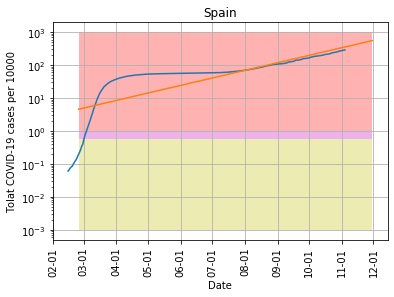

In [4647]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-11-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [4648]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.548413075699115
intercept: -0.06418115321467521
slope: [0.02348386]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


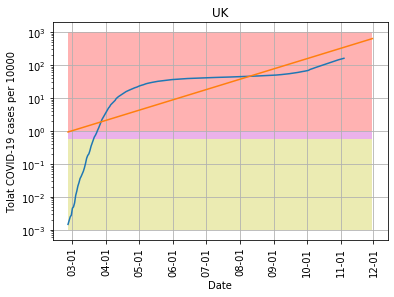

In [4650]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-11-30', "pictures/coronaGB.png", model1, 'UK',1000)

In [4651]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 7.01378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6146845284847795
intercept: 1.5791976637853244
slope: [-0.003111]


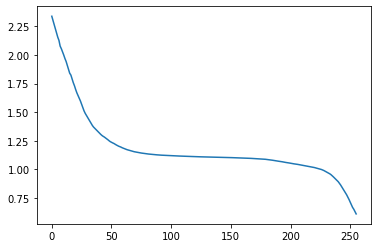

In [4652]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  """


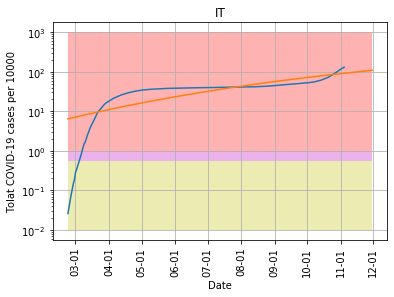

In [4654]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-11-30', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [4655]:
cs=y_pred11[-1]/10000.*populationIT

In [4656]:
cs

658096.5360837409

In [4657]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.5964640506812052
intercept: -0.04615532103758957
slope: [0.0157458]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


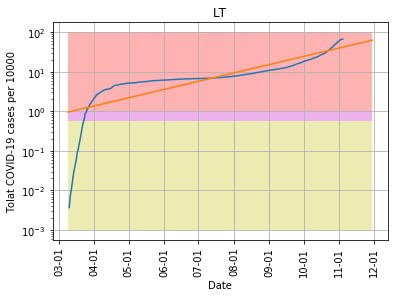

In [4658]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-11-30', "pictures/coronaLT.png", model1, 'LT',100)

In [4659]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7330671251007028
intercept: -2.049403594021741
slope: [0.0317539]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


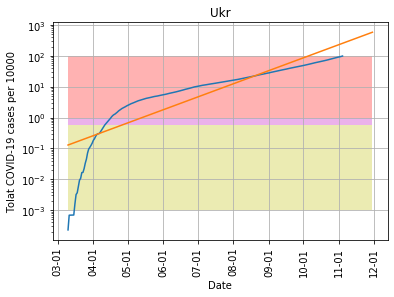

In [4661]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-11-30', "pictures/coronaUkr.png", model11, 'Ukr',100)

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  app.launch_new_instance()


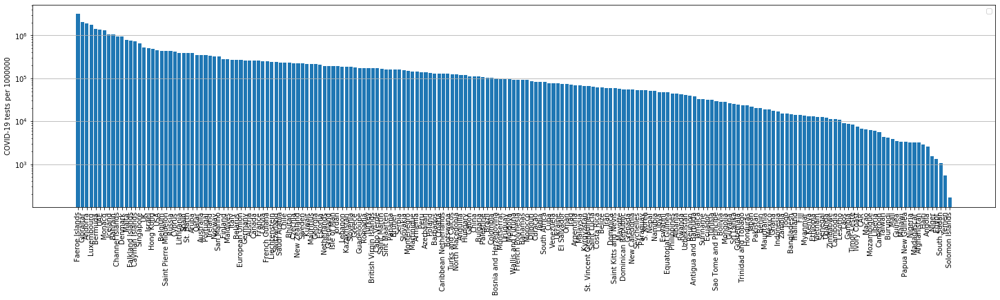

In [4662]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [4663]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6112435071764865
intercept: 0.4466425565040102
slope: [0.02656209]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


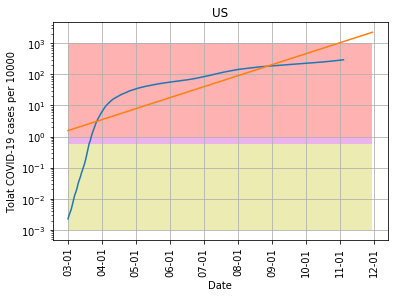

In [4664]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-11-30', "pictures/coronaUS.png", model11, 'US',1000)

In [4665]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
232  European Union  0.025632


Text(0.5, 1.0, 'Death rate')

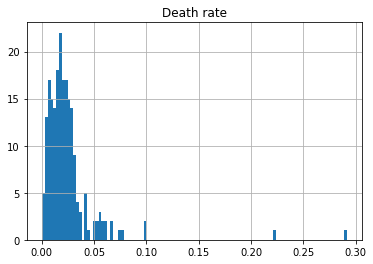

In [4666]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
#plt.xlim([0,0.15])

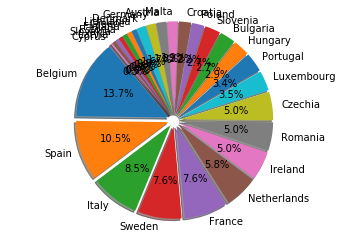

In [4667]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [4668]:
dfTTh.head()

,Country,Deathsper1Mpop
24,Belgium,1062.0
12,Spain,815.0
18,Italy,658.0
44,Sweden,593.0
11,France,592.0


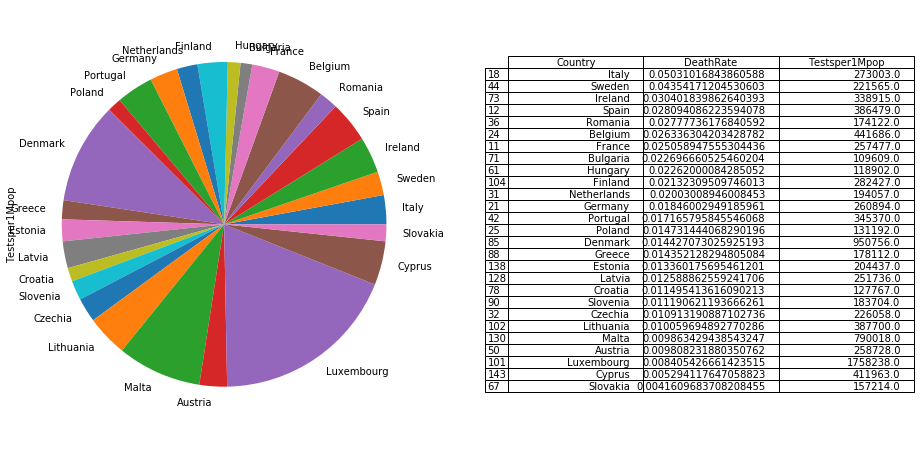

In [4669]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
#dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

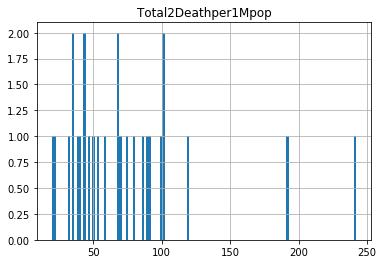

In [4670]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [4671]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
11,France,23626.0,592.0
12,Spain,29016.0,815.0
18,Italy,13079.0,658.0
21,Germany,7123.0,131.0
24,Belgium,40338.0,1062.0


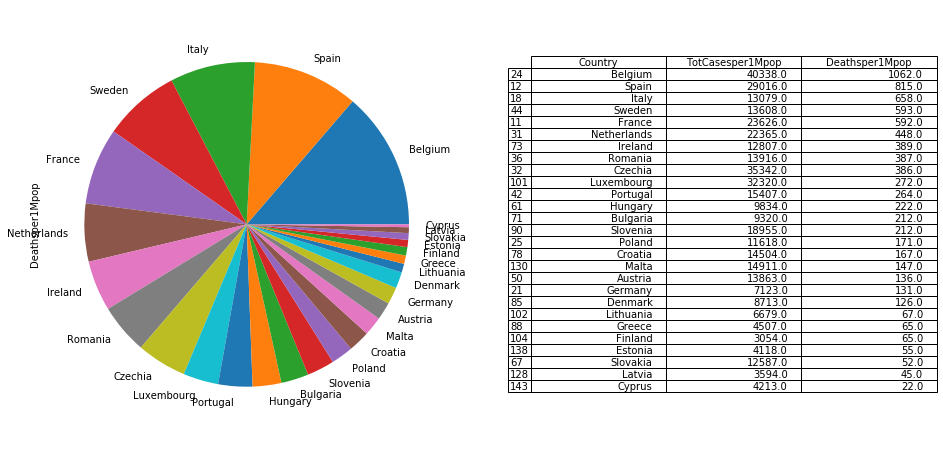

In [4672]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [4673]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,0.0,North America,11683249,7000.0,358640.0,680.0,7703446.0,"+5,844",3621163,21735.0,0.0,0.0,0.0,0.0,0,North America,\n,0,0
1,0.0,Asia,14048637,10090.0,249251.0,130.0,12537763.0,"+7,982",1261623,22539.0,0.0,0.0,0.0,0.0,0,Asia,\n,0,0
2,0.0,South America,9827408,126.0,298817.0,7.0,8828637.0,316,699954,17958.0,0.0,0.0,0.0,0.0,0,South America,\n,0,0
3,0.0,Europe,11047048,53120.0,280045.0,829.0,4116471.0,"+36,416",6650532,24782.0,0.0,0.0,0.0,0.0,0,Europe,\n,0,0
4,0.0,Africa,1840838,1971.0,44077.0,65.0,1529549.0,"+31,695",267212,2436.0,0.0,0.0,0.0,0.0,0,Africa,\n,0,0


In [4674]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
11,France,0.091760
12,Spain,0.075078
18,Italy,0.047908
21,Germany,0.027302
24,Belgium,0.091327


In [4675]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
     Czechia             0.156340
 Netherlands             0.115250
     Croatia             0.113519
    Slovenia             0.103182
      France             0.091760
     Belgium             0.091327
      Poland             0.088557
    Bulgaria             0.085030
     Hungary             0.082707
    Slovakia             0.080063
     Romania             0.079921
       Spain             0.075078
      Sweden             0.061418
     Austria             0.053581
       Italy             0.047908
    Portugal             0.044610
     Ireland             0.037788
     Germany             0.027302
      Greece             0.025304
     Estonia             0.020143
       Malta             0.018874
  Luxembourg             0.018382
   Lithuania             0.017227
      Latvia             0.014277
     Finland             0.010813
      Cyprus             0.010227
     Denmark             0.009164


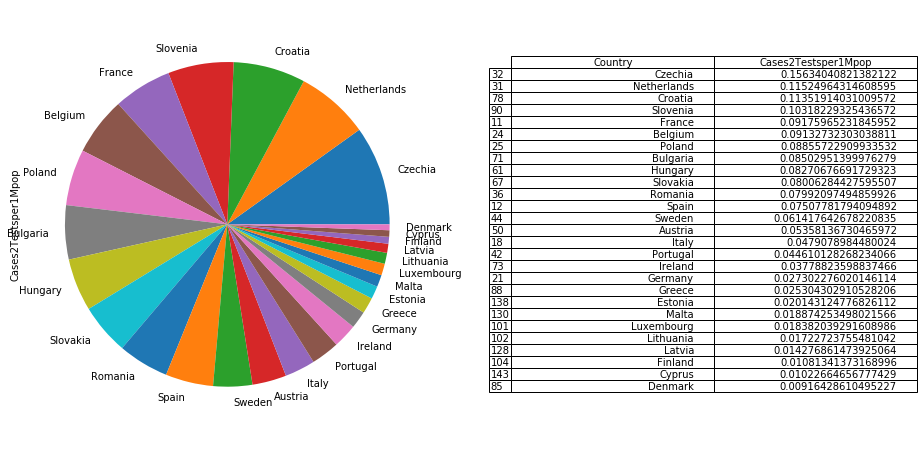

In [4676]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [4677]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
80,Singapore,0.000482,661251.0
180,Burundi,0.001650,4133.0
47,Qatar,0.001740,354533.0
171,Curaçao,0.001959,83012.0
112,Sri Lanka,0.001969,25417.0
...,...,...,...
216,Montserrat,0.076923,96735.0
16,Mexico,0.098797,18901.0
219,Western Sahara,0.100000,0.0
220,MS Zaandam,0.222222,0.0


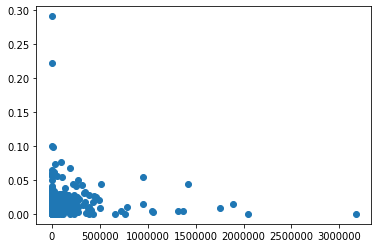

In [4678]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.7/site-packages/matplotlib/patches.py:715: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.7/site-packages/matplotlib/projections/polar.py:55: RuntimeWarning: invalid value encountered in greater_equal
  r = np.where(r >= 0, r, np.nan)


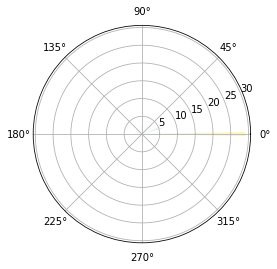

In [4679]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

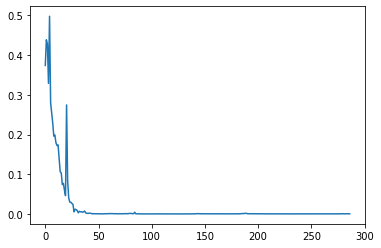

In [4680]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [4681]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


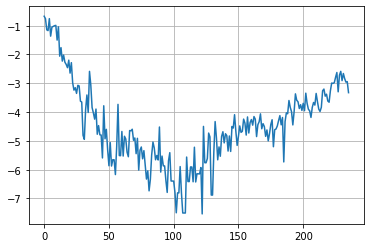

In [4682]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

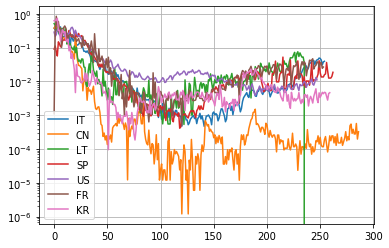

In [4683]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

248 248
coefficient of determination: 0.6776798706489604
intercept: -13.325085887109417
slope: [-0.03937705]


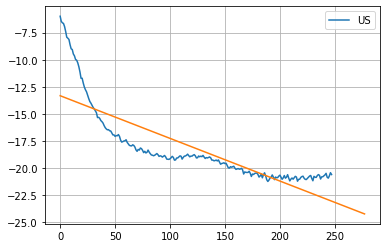

In [4684]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

In [4685]:
#np.diff(dfIT["cases"])

255 255
coefficient of determination: 0.3093548162047468
intercept: -14.363525509604337
slope: [-0.02069683]


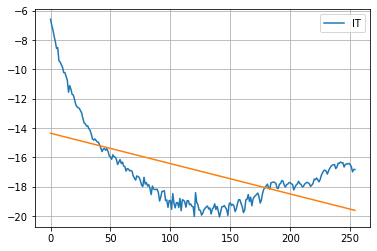

In [4686]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [4687]:
#model11.coef_

In [4688]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

237 237
coefficient of determination: 0.8658952756552514
intercept: -16.754181175443048
slope: [-0.02772063]


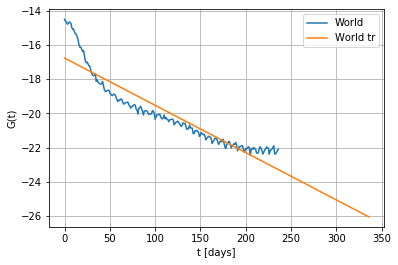

In [4689]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

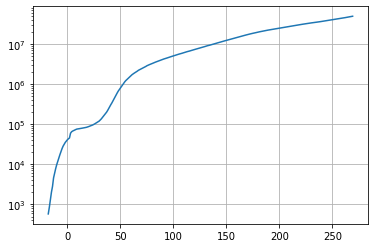

In [4690]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [4691]:
dfW['cases'].values

array([     580,      845,     1317,     2015,     2800,     4581,
           6058,     7813,     9823,    11950,    14553,    17391,
          20630,    24545,    28266,    31439,    34876,    37552,
          40553,    43099,    45134,    59287,    64438,    67100,
          69197,    71329,    73332,    75184,    75700,    76677,
          77673,    78651,    79205,    80087,    80828,    81820,
          83112,    84615,    86604,    88585,    90443,    93016,
          95314,    98425,   102050,   106099,   109991,   114381,
         118948,   126214,   134576,   145483,   156653,   169593,
         182490,   198238,   218822,   244933,   275597,   305036,
         337489,   378860,   422629,   471035,   531864,   596366,
         663079,   723279,   784738,   858355,   936237,  1016330,
        1117928,  1203058,  1274578,  1347566,  1432869,  1519195,
        1605277,  1700004,  1780713,  1853505,  1925330,  2000065,
        2084633,  2183942,  2252370,  2332650,  2407467,  2482

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 1.39267240e+08  3.19852808e-01 -2.79285281e+02  2.13439298e-02]


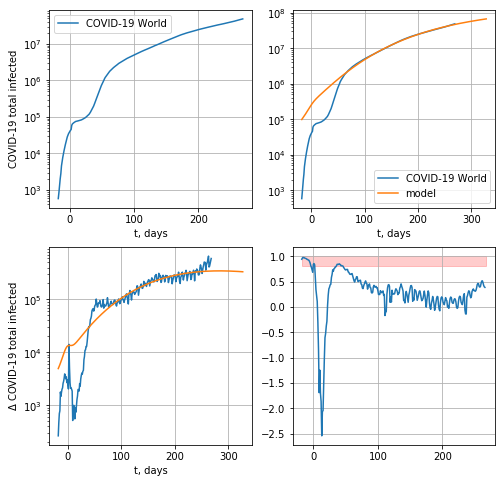

415782.7986705409


In [4692]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

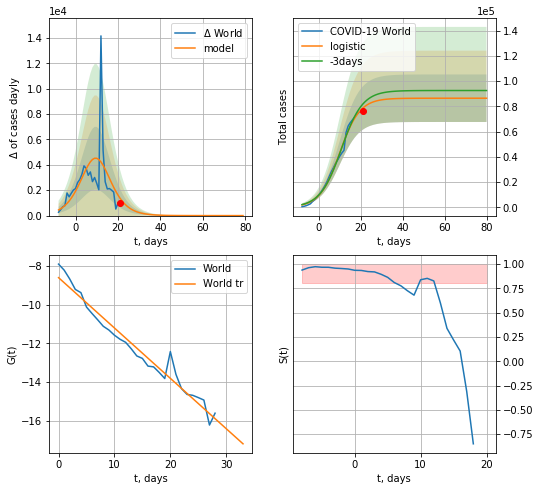

World data at: 2020-11-04
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  86473 ± 18834
	 total death:  2196 ± 1434
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


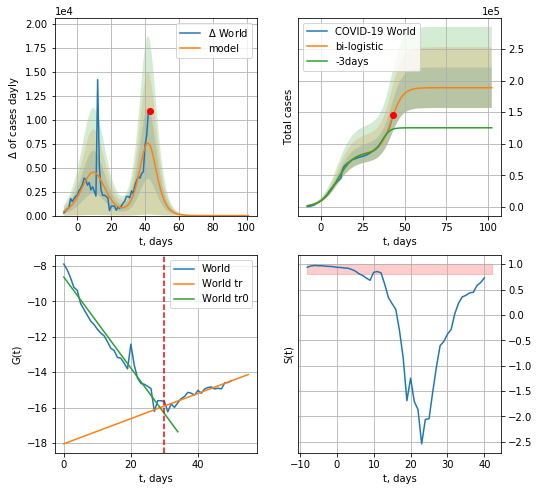

World data at: 2020-11-04
+3 day model MAPE: 0.21572977405755475
model: bi-logistic
coeffs:  [1.02227620e+05 2.95650803e-01 4.22367007e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860967254475
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  188701 ± 32065
	 total death:  4793 ± 2443
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:311: RuntimeWarning: overflow encountered in exp


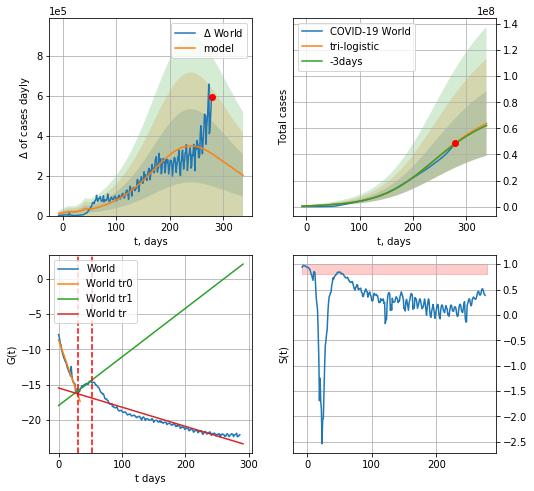

World data at: 2020-11-04
+3 day model MAPE: 0.011059474252294572
model: tri-logistic
coeffs:  [6.31179190e+07 2.04491509e-02 2.32921060e+02] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227620e+05
 2.95650803e-01 4.22367007e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.3874904117739067
forecast at the end of period: +59 days
	 deltaDaycases:  201198
	 total cases:  63689940 ± 24679241
	 total death:  1618044 ± 1880929
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.868204
 intercept: -15.469612
 slope: -0.027232


In [4693]:
vL = 30
T18 = 40
x = forecast("World",dfW[:vL],d1,7*T18-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*T18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*T18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

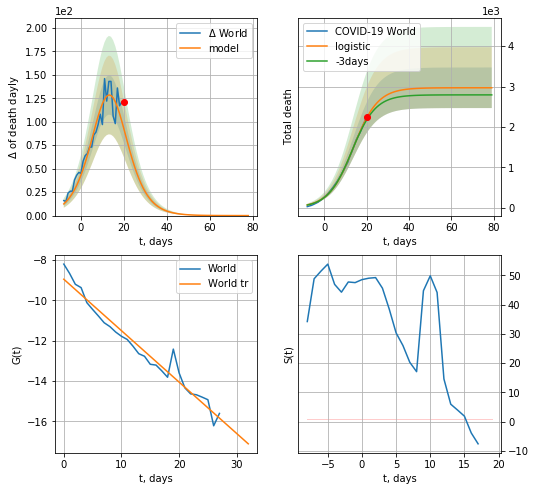

World data at: 2020-11-04
+3 day model MAPE: 0.027312195038559757
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +59 days
	 total death:  2969 ± 502
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


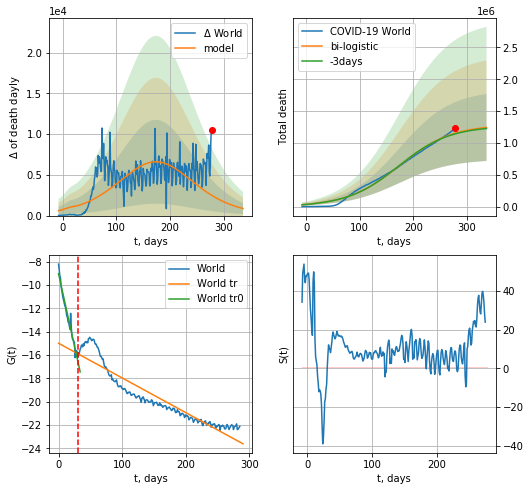

World data at: 2020-11-04
+3 day model MAPE: 0.008845303514027155
model: bi-logistic
coeffs:  [1.28355466e+06 2.06011381e-02 1.74171722e+02] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.42353140883886137
forecast at the end of period: +59 days
	 deltaDaydeath:  870
	 total death:  1243204 ± 526536
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.884585
 intercept: -14.989530
 slope: -0.029707


In [4694]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*T18-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*T18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [4695]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


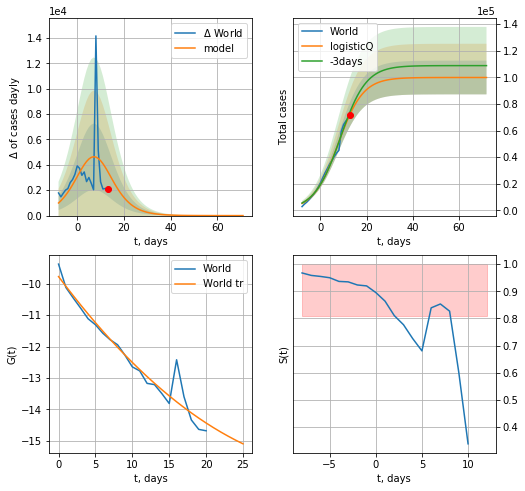

World data at: 2020-11-04
+3 day model MAPE: 0.031856
model: logisticQ
coeffs: [ 9.98643061e+04  1.79654926e-05  7.63889443e+00 -1.03374511e+04]
rational stdev: 0.126959
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 99863 ± 12678
	 total death: 2537 ± 966
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


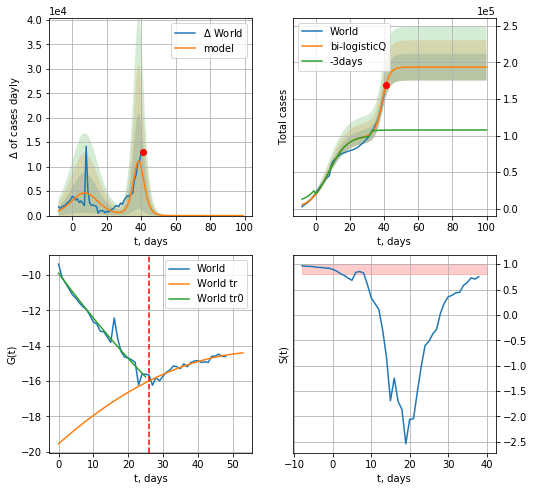

World data at: 2020-11-04
+3 day model MAPE: 0.635592
model: bi-logisticQ
coeffs: [ 9.37621522e+04  2.37764402e-05  3.89555041e+01 -2.00834102e+04]
rational stdev: 0.094698
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 193626 ± 18336
	 total death: 4919 ± 1397
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


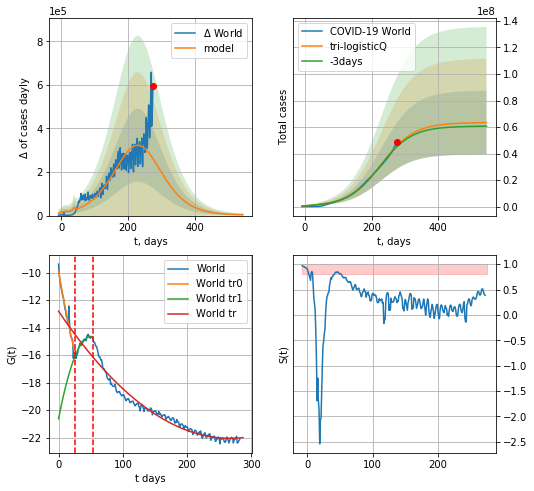

World data at: 2020-11-04
+3 day model MAPE: 0.014601
model: tri-logisticQ
coeffs: [ 6.30734135e+07  1.10925191e-07  2.28868650e+02 -1.84235992e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.379459
forecast at the end of period: +269 days
	 deltaDaycases: 4157
	 total cases: 63377045 ± 24048994
	 total death: 1610094 ± 1832894
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.962048
 intercept_: -12.799549052561165
 coeffs_: [ 0.         -0.06939102  0.00013022]


In [4696]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*T18-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*T18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


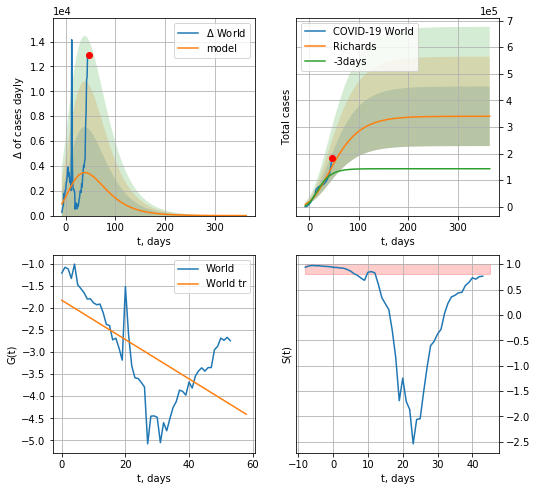

World data at: 2020-11-04
+3 day model MAPE: 0.241623
model: Richards
coeffs: [ 3.40076103e+05  3.50838629e+00 -1.35190892e+02  7.92527881e-03]
rational stdev: 0.329278
forecast at the end of period: +319 days
	 deltaDaycases: 1
	 total cases: 340036 ± 111966
	 total death: 8638 ± 8532
trend coefficient of determination: 0.389869
 intercept: -1.829859
 slope: -0.044449


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


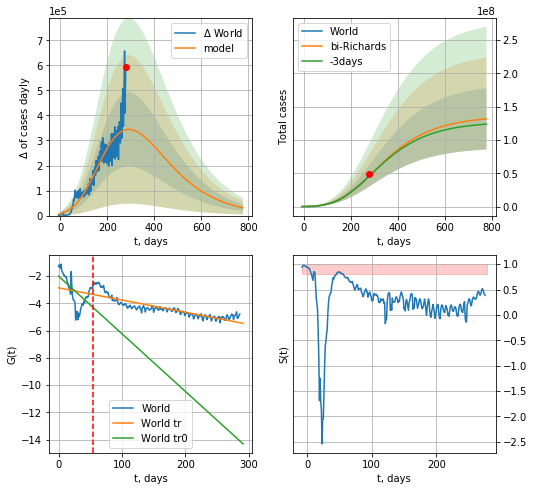

World data at: 2020-11-04
+3 day model MAPE: 0.008191
model: bi-Richards
coeffs: [ 1.35946324e+08  3.29017068e-01 -2.62614370e+02  2.11520067e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.349253
forecast at the end of period: +499 days
	 deltaDaycases: 31036
	 total cases: 131764045 ± 46018936
	 total death: 3347467 ± 3507334
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.363441
 intercept: -2.001398
 slope: -0.042258
trend coefficient of determination: 0.765716
 intercept: -2.863374
 slope: -0.008929


In [4697]:
vL = 55
x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[:],d1,80*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

288


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


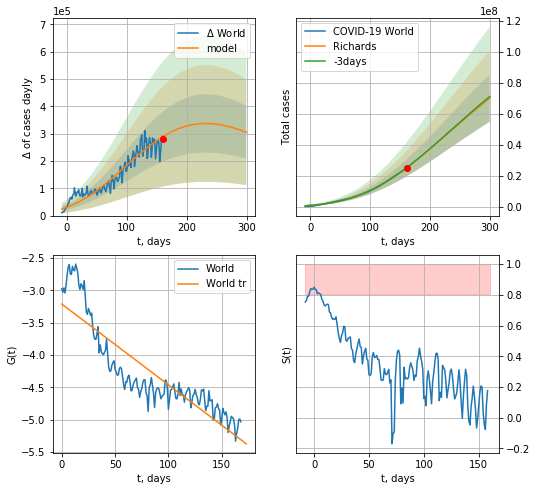

World data at: 2020-11-04
+3 day model MAPE: 0.002418
model: Richards
coeffs: [ 1.28495826e+08  2.24806532e-01 -2.41081878e+02  3.22679331e-02]
rational stdev: 0.218258
forecast at the end of period: +139 days
	 deltaDaycases: 305543
	 total cases: 70109392 ± 15301964
	 total death: 1781130 ± 1166239
trend coefficient of determination: 0.783281
 intercept: -3.211630
 slope: -0.012490


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


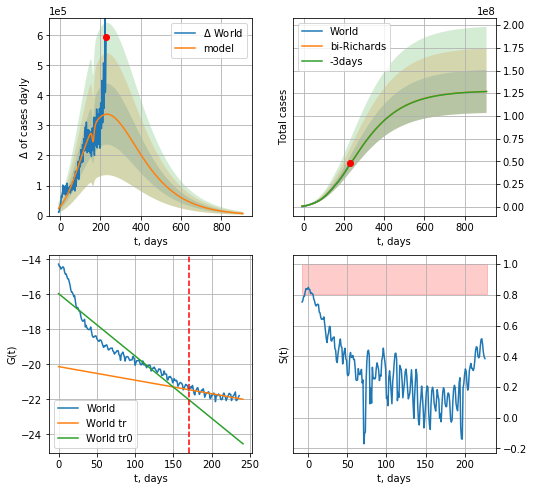

World data at: 2020-11-04
+3 day model MAPE: 0.002431
model: bi-Richards
coeffs: [-5.91677921e+05  3.26642533e-01  1.64033318e+02  9.82112317e-01]
rational stdev: 0.186616
forecast at the end of period: +679 days
	 deltaDaycases: 6900
	 total cases: 126952675 ± 23691433
	 total death: 3225234 ± 1805643
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.870019
 intercept: -15.953139
 slope: -0.035644
trend coefficient of determination: 0.497179
 intercept: -20.127509
 slope: -0.007757


In [4698]:
print (len(dfW))
vL = 170+50
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[50:],d1,100*9-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-50)
#x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


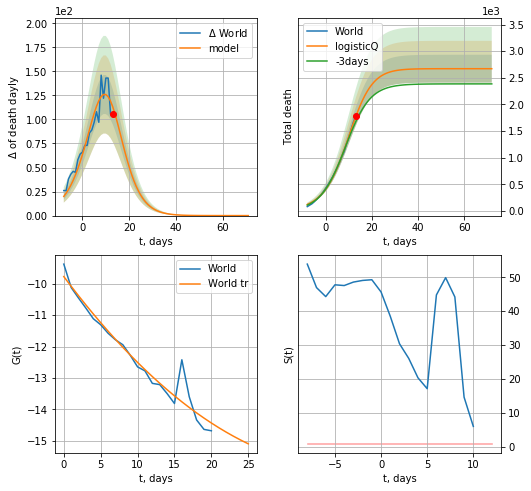

World data at: 2020-11-04
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67018329e+03  8.28113131e-04  9.49649422e+00 -2.18461064e+02]
rational stdev: 0.098000
forecast at the end of period: +59 days
	 total death: 2670 ± 261
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


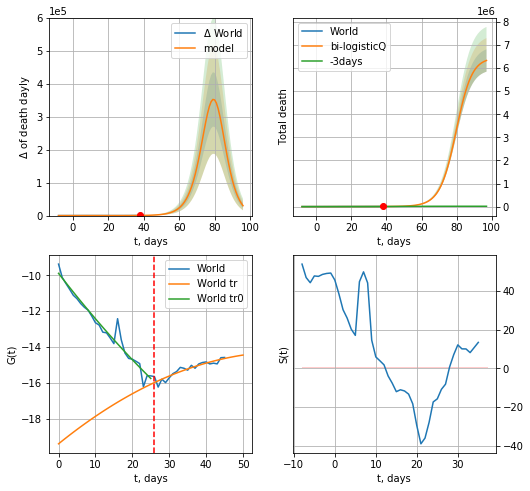

World data at: 2020-11-04
+3 day model MAPE: 0.105641
model: bi-logisticQ
coeffs: [ 6.44010385e+06  6.89934025e-04  7.95796325e+01 -2.38740330e+02]
rational stdev: 0.076590
forecast at the end of period: +59 days
	 total death: 6330881 ± 484883
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:477: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


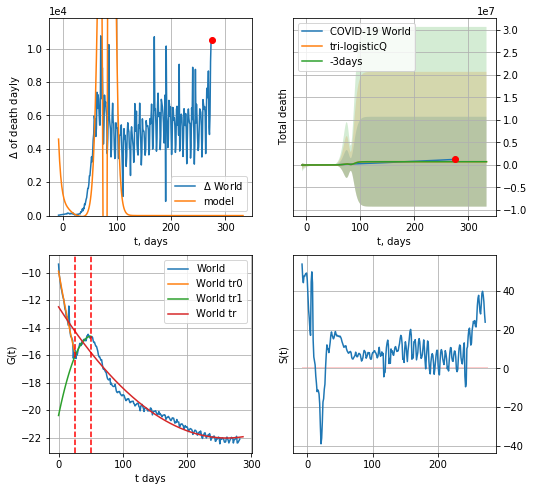

World data at: 2020-11-04
+3 day model MAPE: 0.011484
model: tri-logisticQ
coeffs: [-5.71916494e+06  2.35571997e-03  7.89924992e+01 -3.29494065e+01]
rational stdev: 13.783314
forecast at the end of period: +59 days
	 total death: 723609 ± 9973731
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.960095
 intercept_: -12.483889238351436
 coeffs_: [ 0.         -0.07302811  0.00013977]


In [4699]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*T18-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*T18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*T18-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


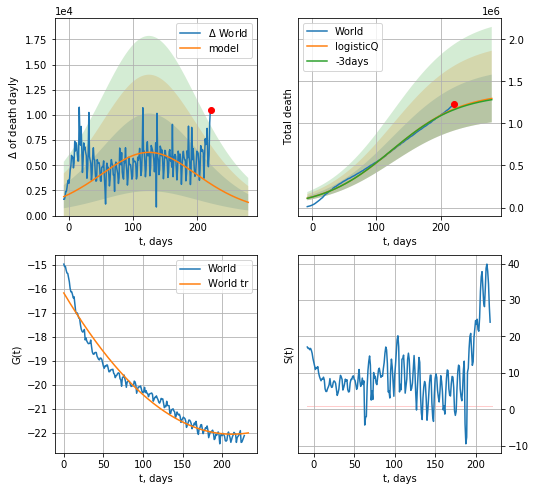

World data at: 2020-11-04
+3 day model MAPE: 0.006993
model: logisticQ
coeffs: [ 1.37187727e+06  3.14529611e-07  1.24775430e+02 -5.81057659e+04]
rational stdev: 0.218559
forecast at the end of period: +59 days
	 total death: 1296900 ± 283449
trend coefficient of determination: 0.962048
 intercept_: -16.16692019433831
 coeffs_: [ 0.         -0.05532818  0.00013022]


In [4700]:
x = forecastRRR("World",dfW[58:],d1,7*T18-dT,1.0,False,cases='death')

In [4701]:
#trend(dfSP,'SP',10)

In [4702]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

In [4703]:
try:
    dfSP = read_df(pd.DataFrame(),"SP")
    vL = 40#len(dfSP[:])-7-dT
    #x = forecast('Spain',dfSP[:vL],d1,7*T18-dT,1.0,cases='cases')
    #xx = forecast2('Spain',dfSP[:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')
except:
    print("Exception occurs")

SP
           date    cases  active    death
259 2020-10-31  1280504       0  35878.0
260 2020-11-01  1296693       0  35878.0
261 2020-11-02  1313087       0  36257.0
262 2020-11-03  1331756       0  36495.0
263 2020-11-04  1356798       0  38118.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide


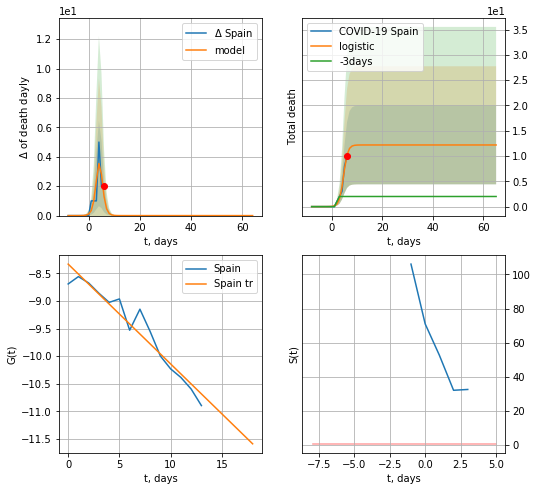

Spain data at: 2020-11-04
+3 day model MAPE: 4.756036700963932
model: logistic
coeffs:  [12.18291976  1.20295815  4.63698223]
rational stdev:  0.6384450788145528
forecast at the end of period: +59 days
	 total death:  12 ± 7
trend coefficient of determination: 0.932343
 intercept: -8.335143
 slope: -0.180548


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: invalid value encountered in true_divide


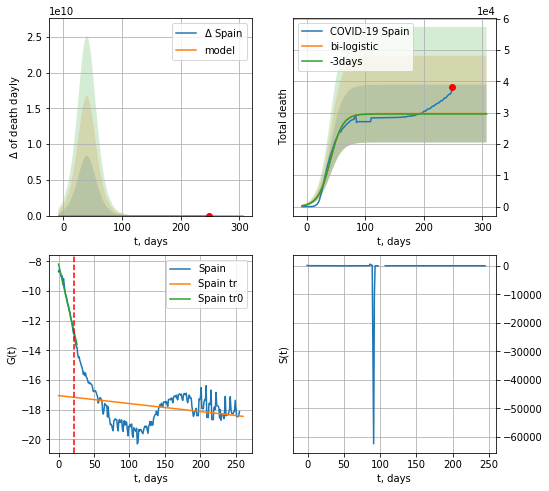

Spain data at: 2020-11-04
+3 day model MAPE: 0.004636541373204791
model: bi-logistic
coeffs:  [2.96993828e+04 9.46387691e-02 4.05874421e+01] [12.18291976  1.20295815  4.63698223]
rational stdev:  0.3104394934334793
forecast at the end of period: +59 days
	 deltaDaydeath:  0
	 total death:  29711 ± 9223
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.977622
 intercept: -8.181737
 slope: -0.208457
trend coefficient of determination: 0.079756
 intercept: -17.042137
 slope: -0.005375


In [4704]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*T18-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


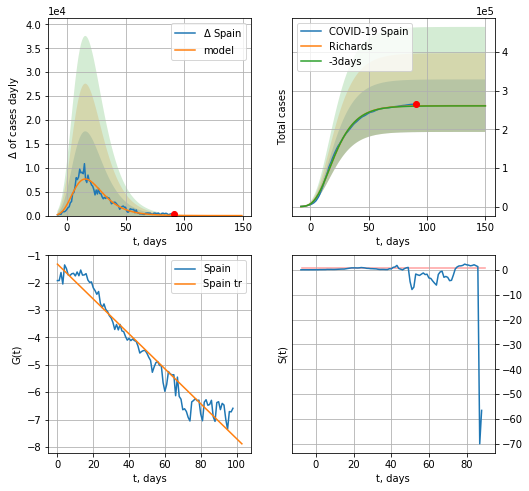

Spain data at: 2020-11-04
+3 day model MAPE: 0.002063
model: Richards
coeffs: [ 2.61234581e+05  1.11545617e+01 -4.55891964e+01  7.16375241e-03]
rational stdev: 0.259932
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 261228 ± 67901
	 total death: 7338 ± 5722
trend coefficient of determination: 0.950456
 intercept: -1.320749
 slope: -0.063751


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


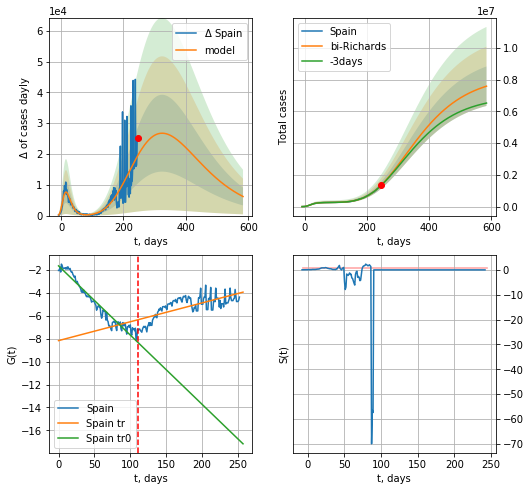

Spain data at: 2020-11-04
+3 day model MAPE: 0.009472
model: bi-Richards
coeffs: [ 8.02742043e+06  3.33620687e-01 -6.68370091e+01  2.75293259e-02]
rational stdev: 0.164083
forecast at the end of period: +339 days
	 deltaDaycases: 6202
	 total cases: 7583296 ± 1244286
	 total death: 213045 ± 104870
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.943893
 intercept: -1.662821
 slope: -0.060317
trend coefficient of determination: 0.519555
 intercept: -8.174706
 slope: 0.016430


In [4705]:
iL = 10
vL = 110+iL#75+iL#135+1
x = forecastRR('Spain',dfSP[iL:vL-iL],d1,7*T18-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Spain',dfSP[iL:],d12f(1),7*80-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


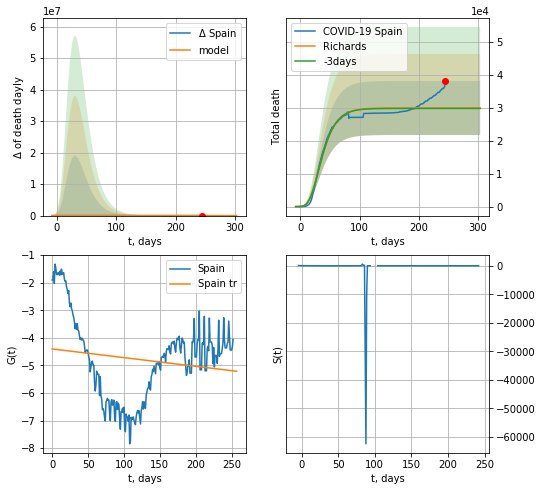

Spain data at: 2020-11-04
+3 day model MAPE: 0.004989
model: Richards
coeffs: [ 2.99846481e+04  1.51144500e+01 -5.90881000e+01  4.05323820e-03]
rational stdev: 0.273859
forecast at the end of period: +59 days
	 total death: 29984 ± 8211
trend coefficient of determination: 0.024361
 intercept: -4.401899
 slope: -0.003146


In [4706]:
x = forecastRR('Spain',dfSP[10:],d1,7*T18-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

In [4707]:
#x = forecastRRR('Spain',dfSP[:50],d1,7*T18-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
#xx = forecast2RRR('Spain',dfSP[:],d1,7*T18-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


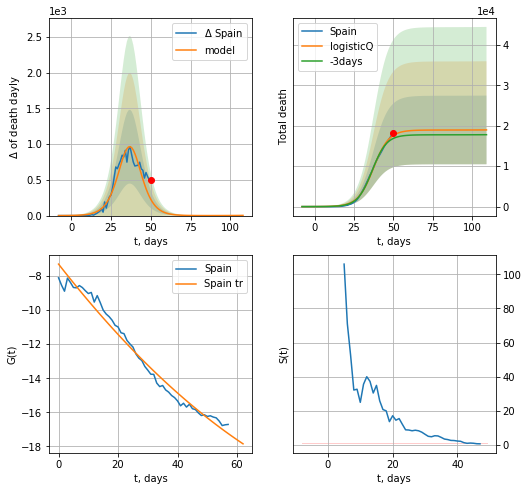

Spain data at: 2020-11-04
+3 day model MAPE: 0.047871
model: logisticQ
coeffs: [ 1.89599654e+04  5.38912704e-06  3.72491565e+01 -3.78046979e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.447682
forecast at the end of period: +59 days
	 total death: 18988 ± 8500
trend coefficient of determination: 0.978811
 intercept_: -7.301838938937334
 coeffs_: [ 0.         -0.22359908  0.00086295]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: invalid value encountered in true_divide


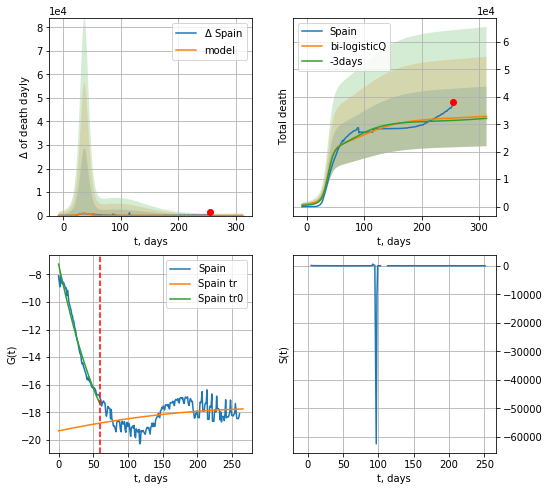

Spain data at: 2020-11-04
+3 day model MAPE: 0.028152
model: bi-logisticQ
coeffs: [ 1.29573562e+04  1.26048861e-08  9.28119358e+01 -2.21209242e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.330333
forecast at the end of period: +59 days
	 total death: 32884 ± 10862
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.978897
 intercept_: -7.2487934110171
 coeffs_: [ 0.         -0.2311524   0.00102662]
trend coefficient of determination: 0.130488
 intercept_: -19.355119324356714
 coeffs_: [ 0.00000000e+00  1.05183128e-02 -1.70135056e-05]


In [4708]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

In [4709]:
#x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

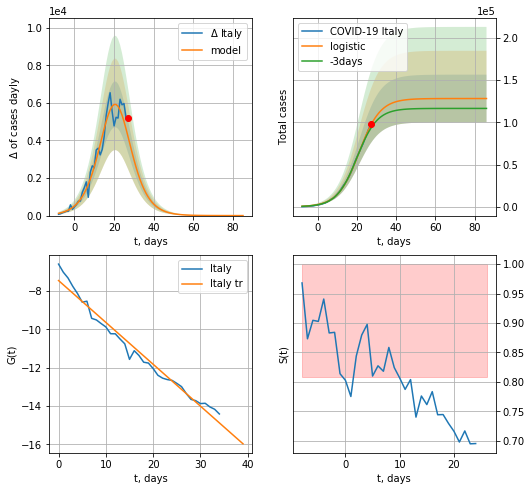

Italy data at: 2020-11-04
+3 day model MAPE: 0.0455783779571316
model: logistic
coeffs:  [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  0.22065596629973358
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  128138 ± 28274
	 total death:  6446 ± 4267
trend coefficient of determination: 0.974872
 intercept: -7.448746
 slope: -0.218671


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


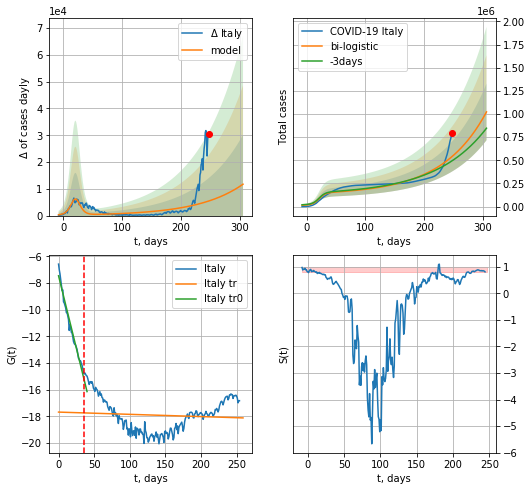

Italy data at: 2020-11-04
+3 day model MAPE: 0.09463215332007935
model: bi-logistic
coeffs:  [3.55964962e+09 1.31999571e-02 9.33945093e+02] [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  0.29916237321618716
forecast at the end of period: +59 days
	 deltaDaycases:  11724
	 total cases:  1022467 ± 305883
	 total death:  51440 ± 46166
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975965
 intercept: -7.466589
 slope: -0.217097
trend coefficient of determination: 0.007041
 intercept: -17.689599
 slope: -0.001681


In [4710]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,T18*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,T18*7-dT,x,1.0,vL=vL)

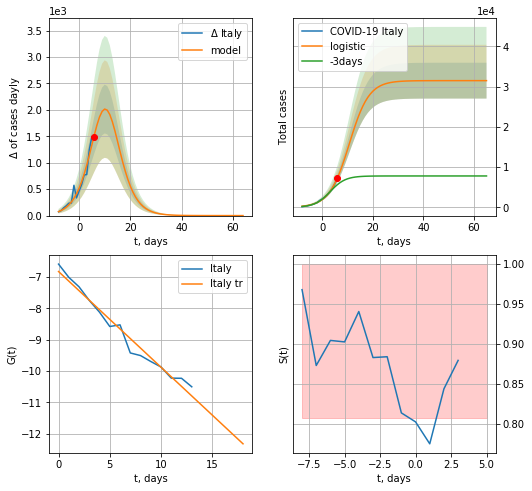

Italy data at: 2020-11-04
+3 day model MAPE: 0.4426444096966454
model: logistic
coeffs:  [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.1414781796365507
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  31497 ± 4456
	 total death:  1584 ± 672
trend coefficient of determination: 0.972594
 intercept: -6.827533
 slope: -0.305163


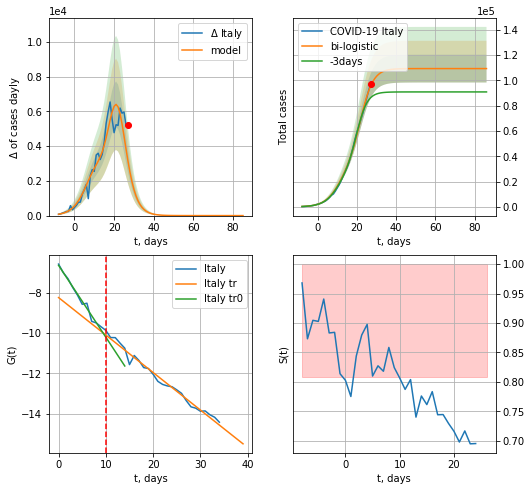

Italy data at: 2020-11-04
+3 day model MAPE: 0.1273932630183904
model: bi-logistic
coeffs:  [7.78644566e+04 3.07215545e-01 2.18188310e+01] [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.10049358712471239
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  109362 ± 10990
	 total death:  5502 ± 1658
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:311: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


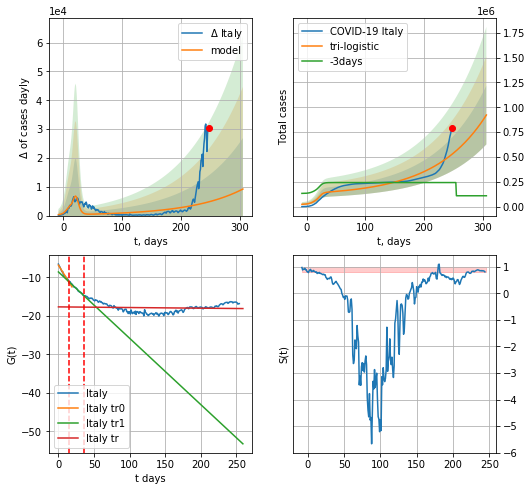

Italy data at: 2020-11-04
+3 day model MAPE: 1.1844578324438895
model: tri-logistic
coeffs:  [2.99555802e+09 1.13881944e-02 1.02704033e+03] [3.14978219e+04 2.56455865e-01 1.06869170e+01 7.78644566e+04
 3.07215545e-01 2.18188310e+01]
forecast rational stdev:  0.3204723892498596
forecast at the end of period: +59 days
	 deltaDaycases:  9206
	 total cases:  922598 ± 295667
	 total death:  46416 ± 44625
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498
trend1 coefficient of determination: 0.980669
 intercept: -8.621660
 slope: -0.172200
trend coefficient of determination: 0.007041
 intercept: -17.689599
 slope: -0.001681


In [4711]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*T18-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*T18-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*T18-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

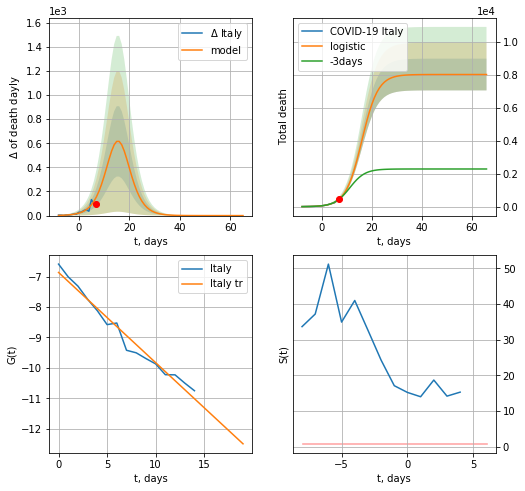

Italy data at: 2020-11-04
+3 day model MAPE: 0.04050488963495004
model: logistic
coeffs:  [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12009378173020563
forecast at the end of period: +59 days
	 total death:  8021 ± 963
trend coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498


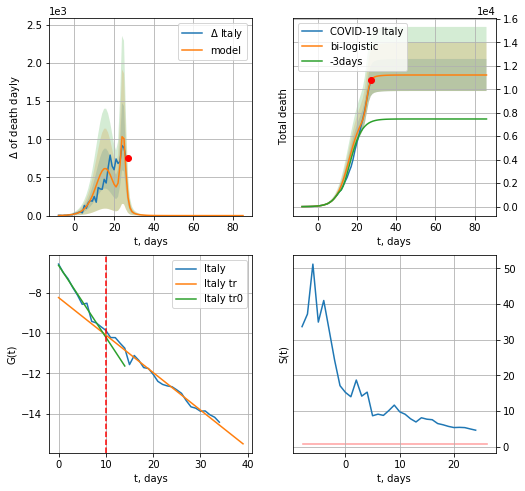

Italy data at: 2020-11-04
+3 day model MAPE: 0.5045402783114736
model: bi-logistic
coeffs:  [3.18986478e+03 1.24682064e+00 2.50159742e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12176299197618909
forecast at the end of period: +59 days
	 deltaDaydeath:  0
	 total death:  11211 ± 1365
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


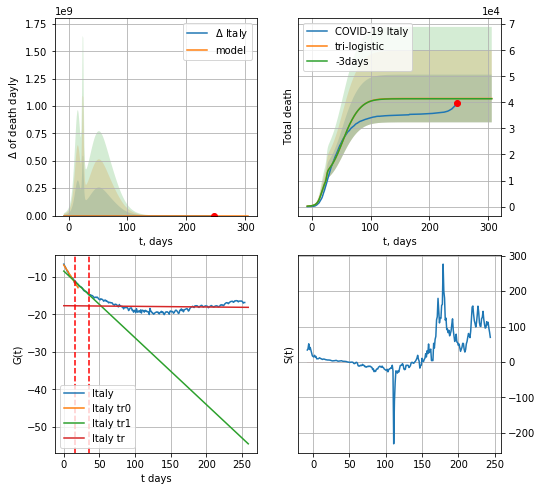

Italy data at: 2020-11-04
+3 day model MAPE: 0.0024979607188485428
model: tri-logistic
coeffs:  [2.42235428e+04 8.65550555e-02 5.02456139e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01 3.18986478e+03
 1.24682064e+00 2.50159742e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.2206459943764666
forecast at the end of period: +59 days
	 deltaDaydeath:  0
	 total death:  41490 ± 9154
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976775
 intercept: -6.838969
 slope: -0.302094
trend1 coefficient of determination: 0.986358
 intercept: -8.457993
 slope: -0.177909
trend coefficient of determination: 0.007041
 intercept: -17.689599
 slope: -0.001681


In [4712]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*T18-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*T18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


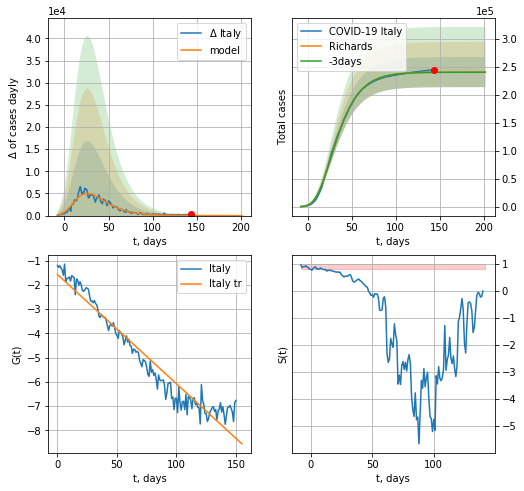

Italy data at: 2020-11-04
+3 day model MAPE: 0.001137
model: Richards
coeffs: [ 2.40825315e+05  8.29717345e+00 -6.16464143e+01  6.82557212e-03]
rational stdev: 0.111816
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 240813 ± 26926
	 total death: 12115 ± 4063
trend coefficient of determination: 0.940744
 intercept: -1.565853
 slope: -0.045125


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


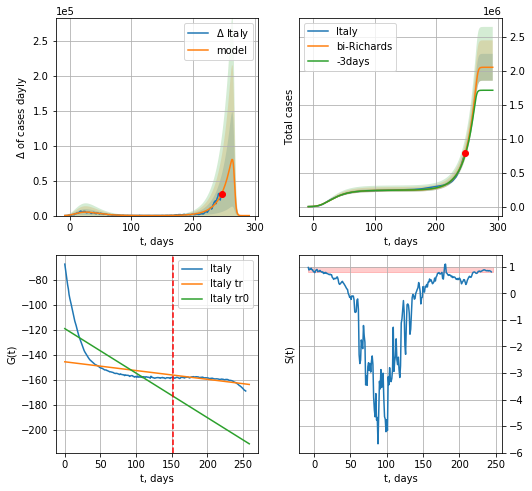

Italy data at: 2020-11-04
+3 day model MAPE: 0.030213
model: bi-Richards
coeffs: [1.80731306e+06 5.97715478e-02 2.67389240e+02 1.22065314e+01]
rational stdev: 0.096599
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 2048138 ± 197848
	 total death: 103042 ± 29861
bi-Richards approximation splitting point: 152
trend coefficient of determination: 0.585539
 intercept: -119.106804
 slope: -0.355844
trend coefficient of determination: 0.611215
 intercept: -145.639814
 slope: -0.070012


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


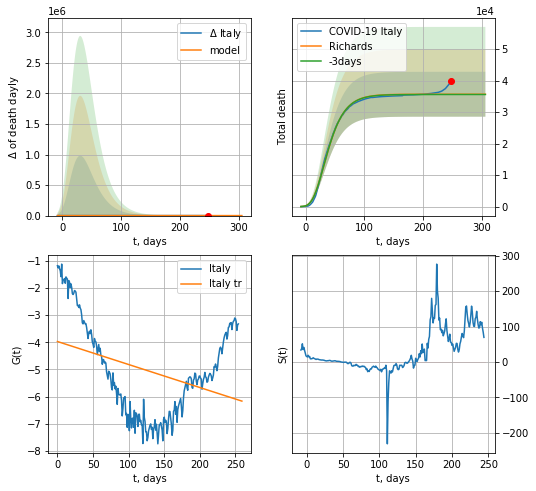

Italy data at: 2020-11-04
+3 day model MAPE: 0.002315
model: Richards
coeffs: [ 3.56809446e+04  9.71616806e+00 -7.11202981e+01  5.27570180e-03]
rational stdev: 0.199687
forecast at the end of period: +59 days
	 total death: 35680 ± 7125
trend coefficient of determination: 0.129635
 intercept: -3.971810
 slope: -0.008456


In [4713]:
vL=152
x = forecastRR('Italy',dfIT[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Italy',dfIT[:],d1,38*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Italy',dfIT[:],d1,T18*7-dT,1.0,cases='death')

In [4714]:
#x = forecastRRR('Italy',dfIT[:],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


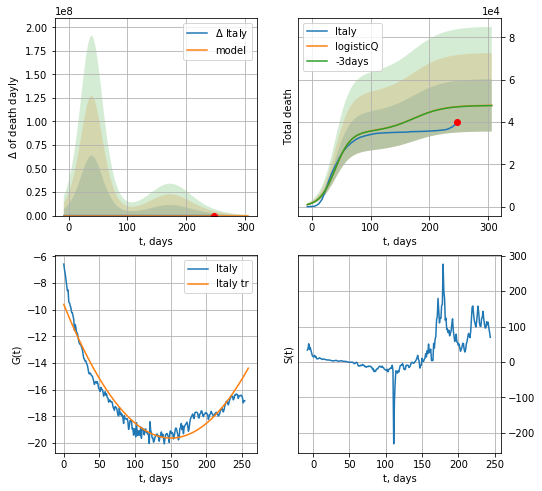

Italy data at: 2020-11-04
+3 day model MAPE: 0.001801
model: logisticQ
coeffs: [ 3.53810143e+04  1.22161532e-07  3.96276353e+01 -6.19230934e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.258359
forecast at the end of period: +59 days
	 total death: 47833 ± 12358
trend coefficient of determination: 0.925018
 intercept_: -9.61386936669824
 coeffs_: [ 0.         -0.13333709  0.00044347]


In [4715]:
x = forecastRRR('Italy',dfIT[:],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [4716]:
dT

221

FR
           date      cases   active    death
259 2020-10-31  1367625.0  1213179  36788.0
260 2020-11-01  1413915.0  1258669  37019.0
261 2020-11-02  1466433.0  1309894  37435.0
262 2020-11-03  1502763.0  1343760  38289.0
263 2020-11-04  1543321.0  1381985  38674.0


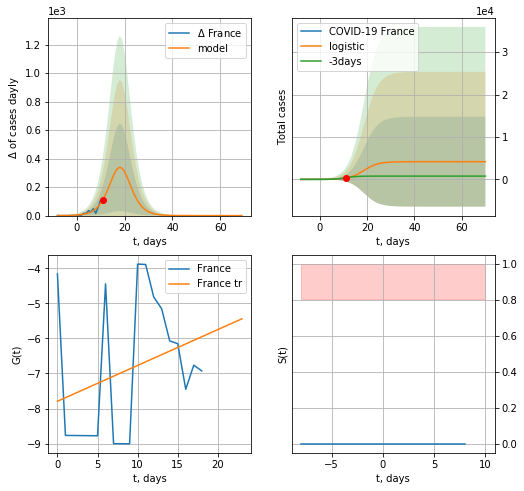

France data at: 2020-11-04
+3 day model MAPE: 0.04053351776025477
model: logistic
coeffs:  [4.17382756e+03 3.25568782e-01 1.85948993e+01]
rational stdev:  2.5390566064289986
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  4173 ± 10597
	 total death:  104 ± 792
trend coefficient of determination: 0.083417
 intercept: -7.793073
 slope: 0.102246


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


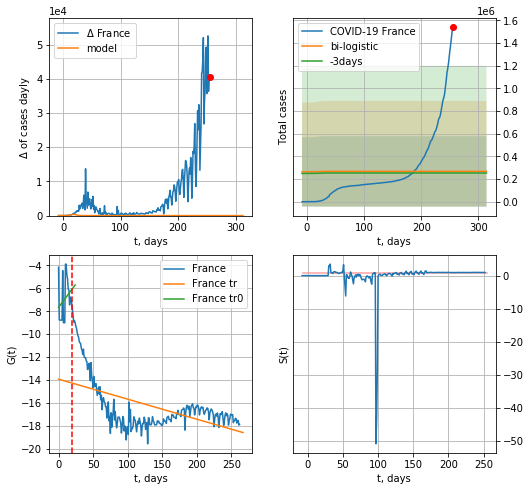

France data at: 2020-11-04
+3 day model MAPE: 0.056015475416546605
model: bi-logistic
coeffs:  [ 2.63718308e+05 -1.47176990e+01  3.60583727e+02] [4.17382756e+03 3.25568782e-01 1.85948993e+01]
rational stdev:  1.1606099107220365
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  267892 ± 310918
	 total death:  6713 ± 23373
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.062178
 intercept: -7.670498
 slope: 0.081817
trend coefficient of determination: 0.310108
 intercept: -13.936922
 slope: -0.017482


In [4717]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
try:
    x = forecast('France',dfFR[:vL],d1,T18*7-dT,1.0)
    xx = forecast2('France',dfFR,d1,T18*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)
except:
    print ("Exception occurs")

In [4718]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

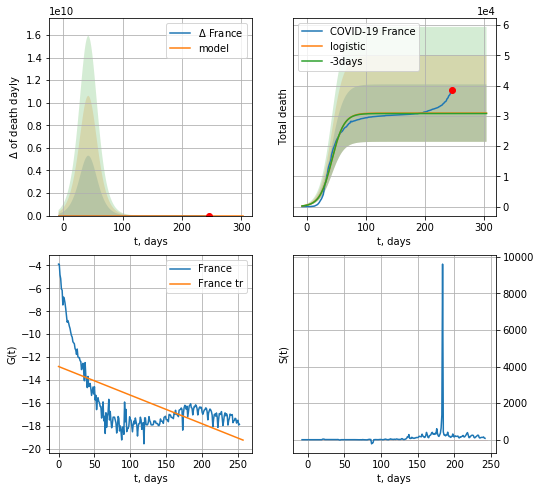

France data at: 2020-11-04
+3 day model MAPE: 0.004563444096281424
model: logistic
coeffs:  [3.09244094e+04 9.69900040e-02 4.25842879e+01]
rational stdev:  0.3072086108285972
forecast at the end of period: +59 days
	 total death:  30924 ± 9500
trend coefficient of determination: 0.372961
 intercept: -12.831189
 slope: -0.025026


In [4719]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*T18-dT,1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


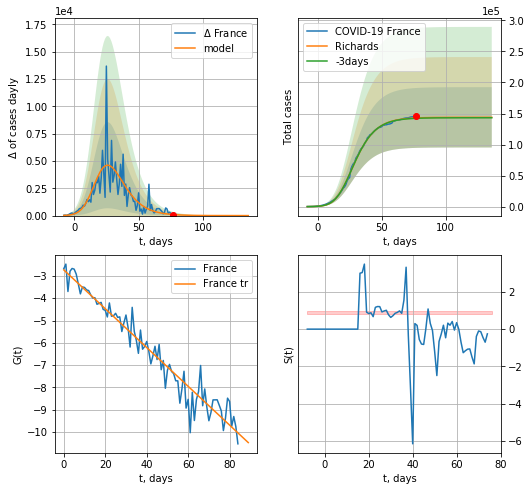

France data at: 2020-11-04
+3 day model MAPE: 0.004381
model: Richards
coeffs: [1.43859283e+05 3.70919988e-01 1.30584298e+01 2.65861146e-01]
rational stdev: 0.337496
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 143856 ± 48550
	 total death: 3604 ± 3649
trend coefficient of determination: 0.942321
 intercept: -2.732113
 slope: -0.086939


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


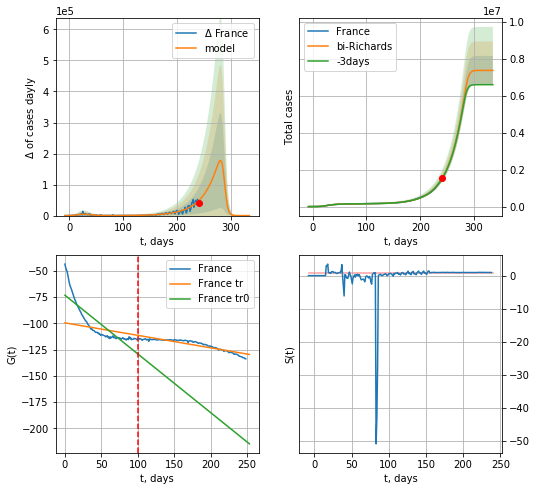

France data at: 2020-11-04
+3 day model MAPE: 0.005214
model: bi-Richards
coeffs: [7.21894846e+06 3.51848590e-02 2.87743683e+02 9.13046892e+00]
rational stdev: 0.106459
forecast at the end of period: +94 days
	 deltaDaycases: 0
	 total cases: 7362807 ± 783834
	 total death: 184504 ± 58926
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.726037
 intercept: -73.267853
 slope: -0.558570
trend coefficient of determination: 0.846118
 intercept: -99.537530
 slope: -0.118776


In [4720]:
vL = 100+14#86+14+40+29
x = forecastRR('France',dfFR[14:vL-14],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('France',dfFR[14:],d1,45*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-14)

In [4721]:
#x = forecastRRR('France',dfFR[10:],d1,34*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


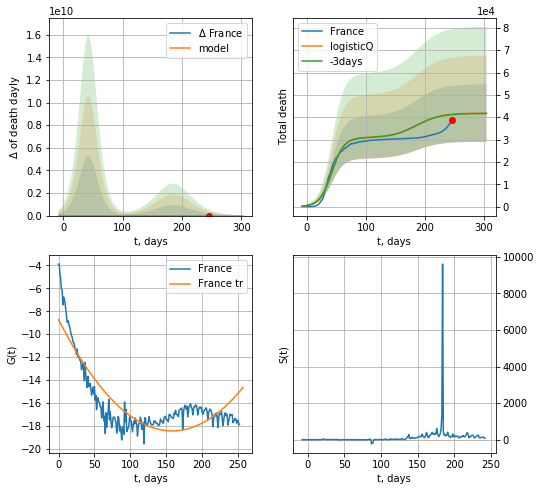

France data at: 2020-11-04
+3 day model MAPE: 0.003569
model: logisticQ
coeffs: [ 3.09244575e+04  1.35364888e-07  4.25852283e+01 -7.16229608e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.307238
forecast at the end of period: +59 days
	 total death: 41843 ± 12855
trend coefficient of determination: 0.757740
 intercept_: -8.728991663400318
 coeffs_: [ 0.         -0.12308646  0.00038913]


In [4722]:
x = forecastRRR('France',dfFR[10:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [4723]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [4724]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

In [4725]:
dfGR = read_df(pd.DataFrame(),"GR")
#x = forecast('Germany',dfGR[:],d1,7*T18-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

GR
           date   cases  active    death
250 2020-10-31  531790  175507  10583.0
251 2020-11-01  544346  177824  10622.0
252 2020-11-02  560586  186752  10734.0
253 2020-11-03  577131  194748  10883.0
254 2020-11-04  597453  194824  11029.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


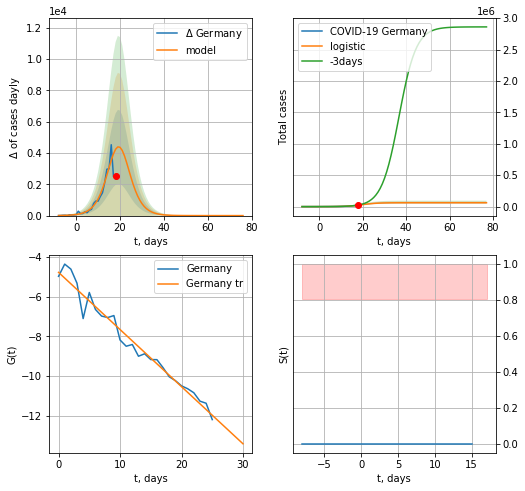

Germany data at: 2020-11-04
+3 day model MAPE: 0.1832688253569737
model: logistic
coeffs:  [6.15503848e+04 2.86340373e-01 1.98405530e+01]
rational stdev:  0.17812668621711658
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  61550 ± 10963
	 total death:  1136 ± 607
trend coefficient of determination: 0.966755
 intercept: -4.774386
 slope: -0.288157


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


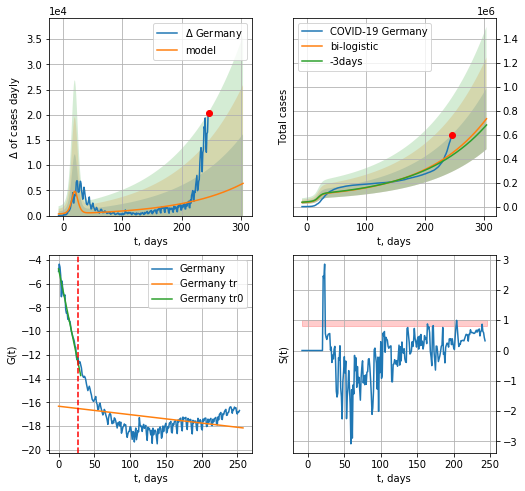

Germany data at: 2020-11-04
+3 day model MAPE: 0.04410340791444696
model: bi-logistic
coeffs:  [1.15749307e+09 9.54339916e-03 1.08566810e+03] [6.15503848e+04 2.86340373e-01 1.98405530e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.34825796809510806
forecast at the end of period: +59 days
	 deltaDaycases:  6386
	 total cases:  734356 ± 255745
	 total death:  13556 ± 14162
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970316
 intercept: -4.764587
 slope: -0.289333
trend coefficient of determination: 0.122458
 intercept: -16.320142
 slope: -0.007079


In [4726]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,T18*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*T18-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

In [4727]:
dfGR = read_df(pd.DataFrame(),"GR")
#x = forecast('Germany',dfGR[14:],d1,24*7-dT,1.0,cases='death')

GR
           date   cases  active    death
250 2020-10-31  531790  175507  10583.0
251 2020-11-01  544346  177824  10622.0
252 2020-11-02  560586  186752  10734.0
253 2020-11-03  577131  194748  10883.0
254 2020-11-04  597453  194824  11029.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


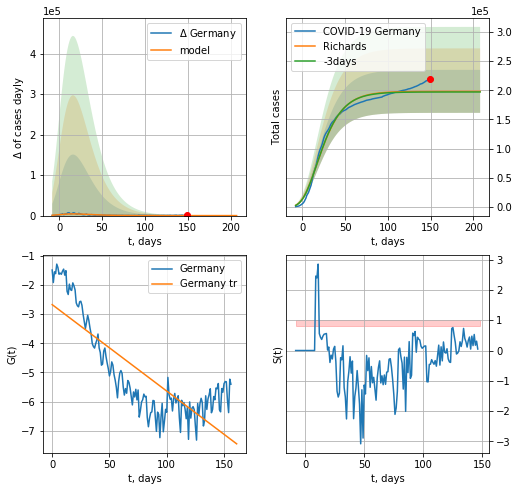

Germany data at: 2020-11-04
+3 day model MAPE: 0.005257
model: Richards
coeffs: [ 1.98147729e+05  1.72977787e+01 -8.12480262e+01  3.36106360e-03]
rational stdev: 0.185673
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 198144 ± 36790
	 total death: 3657 ± 2037
trend coefficient of determination: 0.673909
 intercept: -2.674804
 slope: -0.029637


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


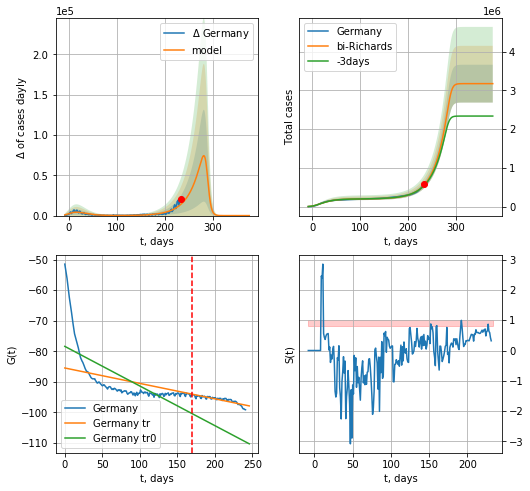

Germany data at: 2020-11-04
+3 day model MAPE: 0.034303
model: bi-Richards
coeffs: [2.97817084e+06 3.80677905e-02 2.89033018e+02 7.19899630e+00]
rational stdev: 0.153733
forecast at the end of period: +143 days
	 deltaDaycases: 0
	 total cases: 3176318 ± 488305
	 total death: 58634 ± 27041
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.494398
 intercept: -78.386613
 slope: -0.129632
trend coefficient of determination: 0.767506
 intercept: -85.461606
 slope: -0.050430


In [4728]:
vL = 170+12#94+12
x = forecastRR('Germany',dfGR[12:vL-12],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Germany',dfGR[12:],d1,52*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

In [4729]:
#x = forecastRRR('Germany',dfGR[:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


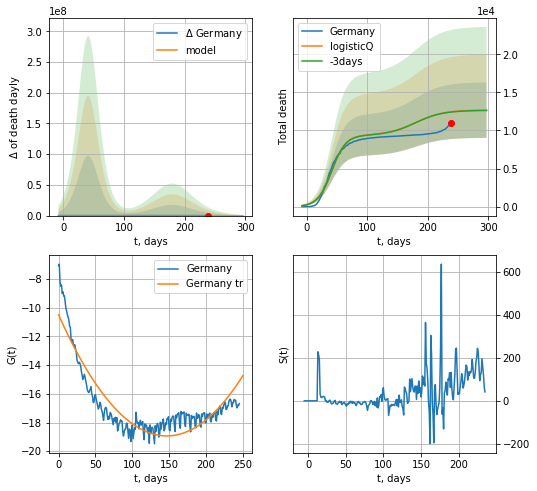

Germany data at: 2020-11-04
+3 day model MAPE: 0.002477
model: logisticQ
coeffs: [ 9.36550459e+03  1.21814274e-07  4.12061405e+01 -7.12004885e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.287673
forecast at the end of period: +59 days
	 total death: 12662 ± 3642
trend coefficient of determination: 0.837097
 intercept_: -10.484840214296892
 coeffs_: [ 0.         -0.11537043  0.00039373]


In [4730]:
x = forecastRRR('Germany',dfGR[8:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

US
           date    cases   active     death
244 2020-10-31  9402717  3104195  236077.0
245 2020-11-01  9475788  3134870  236501.0
246 2020-11-02  9567543  3159144  236997.0
247 2020-11-03  9693632  3217705  238656.0
248 2020-11-04  9802374  3269400  239842.0


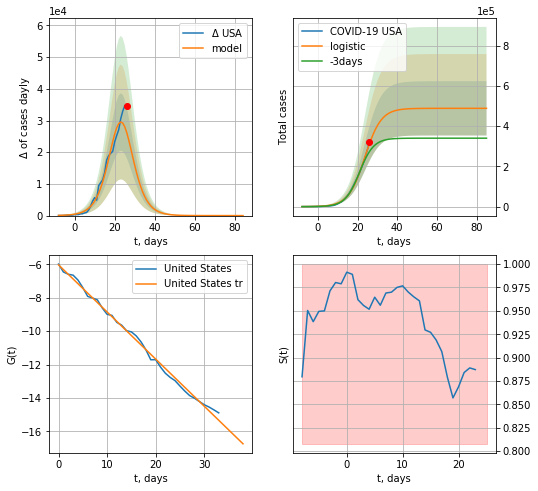

USA data at: 2020-11-04
+3 day model MAPE: 0.17962965905806133
model: logistic
coeffs:  [4.89025787e+05 2.41973856e-01 2.36121759e+01]
rational stdev:  0.27607026078318453
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  489025 ± 135005
	 total death:  11965 ± 9909
trend coefficient of determination: 0.995387
 intercept: -6.036925
 slope: -0.281840


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


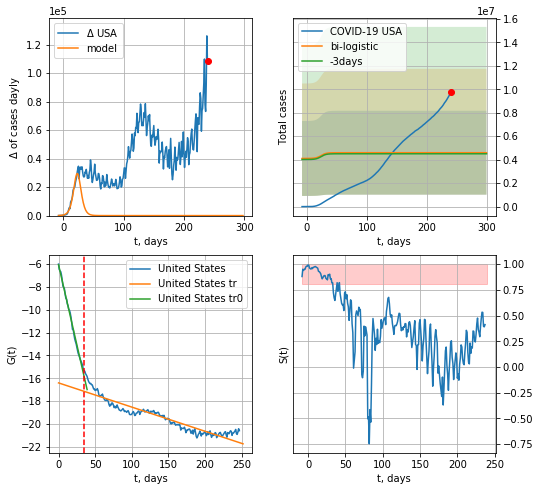

USA data at: 2020-11-04
+3 day model MAPE: 0.020037977599897835
model: bi-logistic
coeffs:  [ 3.28194892e+06 -3.70462648e+01  8.85109819e+02] [4.89025787e+05 2.41973856e-01 2.36121759e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.778221736672442
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  4591461 ± 3573175
	 total death:  112342 ± 262280
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995488
 intercept: -6.051468
 slope: -0.280518
trend coefficient of determination: 0.874645
 intercept: -16.409516
 slope: -0.021201


In [4731]:
vL=35
dfUS = read_df(pd.DataFrame(),"US")
x = forecast('USA',dfUS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

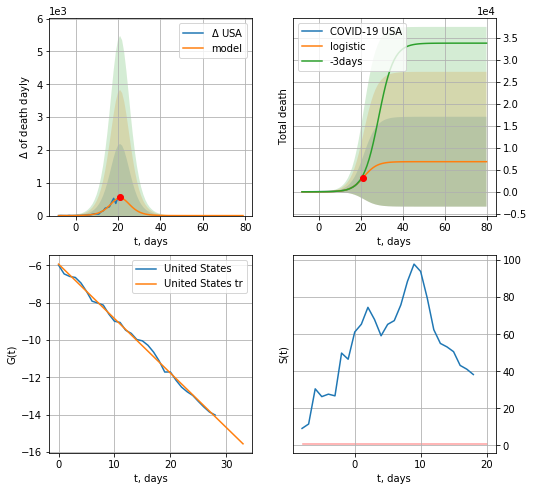

USA data at: 2020-11-04
+3 day model MAPE: 0.21421329662103625
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +59 days
	 total death:  6833 ± 10202
trend coefficient of determination: 0.996549
 intercept: -5.938291
 slope: -0.291586


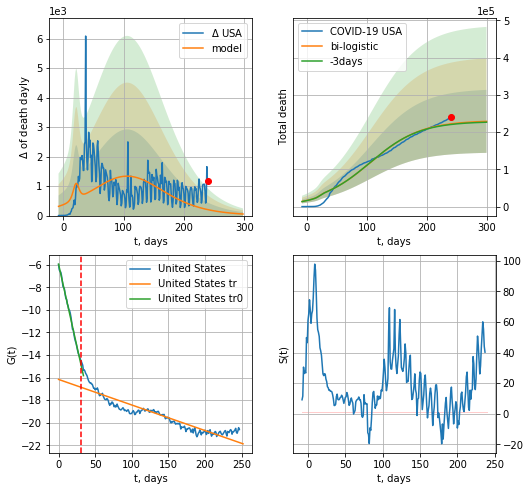

USA data at: 2020-11-04
+3 day model MAPE: 0.007763422411124358
model: bi-logistic
coeffs:  [2.24126271e+05 2.38636096e-02 1.06148507e+02] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.36938225371362177
forecast at the end of period: +59 days
	 deltaDaydeath:  53
	 total death:  228734 ± 84490
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996707
 intercept: -5.949158
 slope: -0.290421
trend coefficient of determination: 0.852335
 intercept: -16.159139
 slope: -0.022626


In [4732]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*T18-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


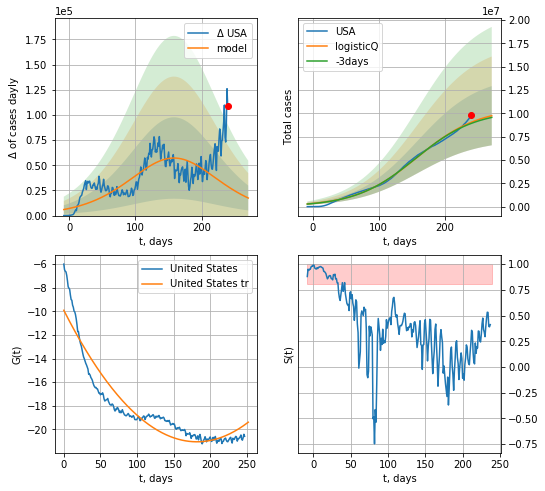

USA data at: 2020-11-04
+3 day model MAPE: 0.013627
model: logisticQ
coeffs: [ 1.05598851e+07  1.09908282e-07  1.58332120e+02 -1.96581538e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.325648
forecast at the end of period: +31 days
	 deltaDaycases: 17461
	 total cases: 9750304 ± 3175172
	 total death: 238567 ± 233066
trend coefficient of determination: 0.881826
 intercept_: -9.907014090754345
 coeffs_: [ 0.         -0.12274485  0.00033752]


In [4733]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


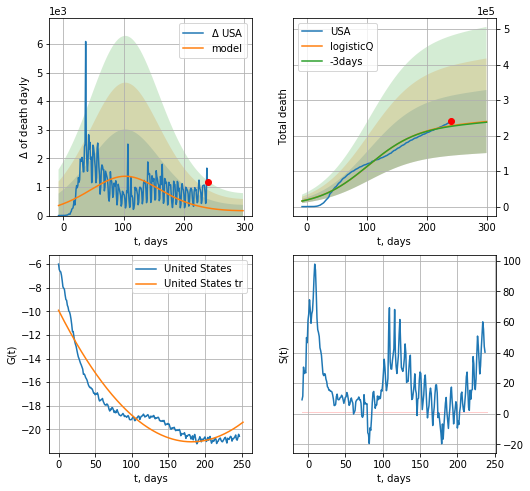

USA data at: 2020-11-04
+3 day model MAPE: 0.007296
model: logisticQ
coeffs: [ 2.30026895e+05  3.24739339e-08  1.02720678e+02 -7.28178288e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.370604
forecast at the end of period: +59 days
	 total death: 239697 ± 88832
trend coefficient of determination: 0.881826
 intercept_: -9.907014090754345
 coeffs_: [ 0.         -0.12274485  0.00033752]


In [4734]:
x = forecastRRR('USA',dfUS[:],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


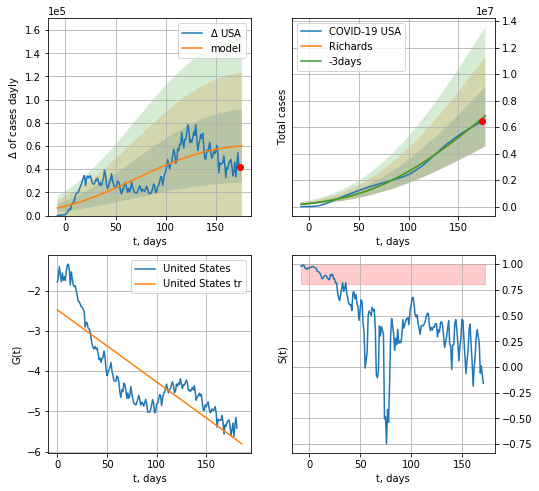

USA data at: 2020-11-04
+3 day model MAPE: 0.007169
model: Richards
coeffs: [ 2.02180819e+07  3.38258066e-01 -2.63554827e+02  2.42850860e-02]
rational stdev: 0.331103
forecast at the end of period: +3 days
	 deltaDaycases: 60044
	 total cases: 6801620 ± 2252039
	 total death: 166420 ± 165306
trend coefficient of determination: 0.720619
 intercept: -2.477701
 slope: -0.017904


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


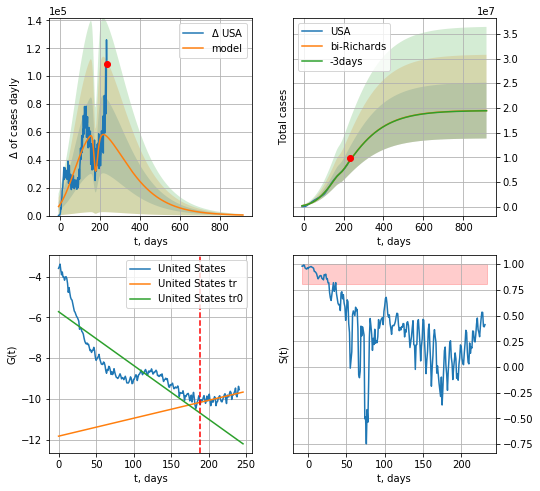

USA data at: 2020-11-04
+3 day model MAPE: 0.003645
model: bi-Richards
coeffs: [-7.15308472e+05  3.95491265e-01  1.68862073e+02  3.13057159e-01]
rational stdev: 0.290534
forecast at the end of period: +682 days
	 deltaDaycases: 424
	 total cases: 19451287 ± 5651267
	 total death: 475929 ± 414821
bi-Richards approximation splitting point: 189
trend coefficient of determination: 0.741274
 intercept: -5.722309
 slope: -0.026311
trend coefficient of determination: 0.413637
 intercept: -11.820309
 slope: 0.008775


In [4735]:
iL = 6
vL = 189+iL#90+iL
x = forecastRR('USA',dfUS[iL:vL-iL],d1,7*32-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('USA',dfUS[iL:],d1,7*129-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [4736]:
#x = forecastQR('USA',dfUS[20:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
           date    cases  active    death
248 2020-10-31  1011660       0  46555.0
249 2020-11-01  1034914       0  46717.0
250 2020-11-02  1053864       0  46853.0
251 2020-11-03  1073882       0  47250.0
252 2020-11-04  1099059       0  47742.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


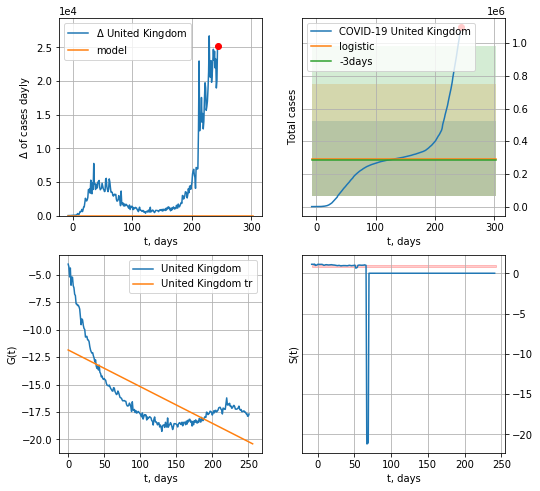

United Kingdom data at: 2020-11-04
+3 day model MAPE: 0.033197950588333774
model: logistic
coeffs:  [ 2.92473423e+05 -1.53875148e+01  3.82424746e+02]
rational stdev:  0.7843332507744828
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  292473 ± 229396
	 total death:  12704 ± 29892
trend coefficient of determination: 0.501281
 intercept: -11.848972
 slope: -0.033390


In [4737]:
try:
    dfGB = read_df(pd.DataFrame(),"GB")
    x = forecast('United Kingdom',dfGB[:],d1,7*T18-dT,1.)
    #x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
    #xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)
except:
    print ("Exception occurs")

In [4738]:
#x = forecast('United Kingdom',dfGB[:],d1,T18*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide


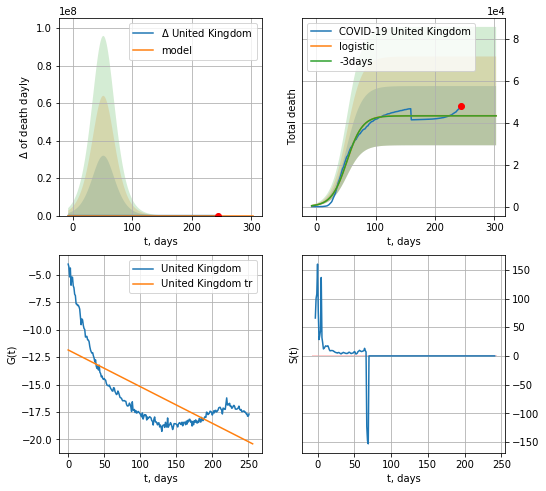

United Kingdom data at: 2020-11-04
+3 day model MAPE: 0.001998544453236021
model: logistic
coeffs:  [4.33013108e+04 7.69439060e-02 5.15667624e+01]
rational stdev:  0.32544262246450784
forecast at the end of period: +59 days
	 total death:  43301 ± 14092
trend coefficient of determination: 0.501281
 intercept: -11.848972
 slope: -0.033390


In [4739]:
x = forecast('United Kingdom',dfGB[:],d1,T18*7-dT,1.,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


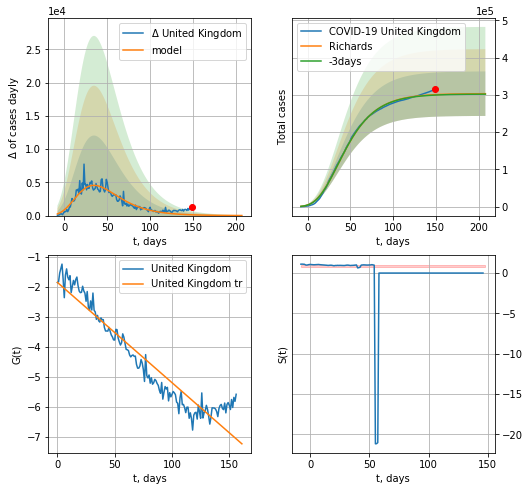

United Kingdom data at: 2020-11-04
+3 day model MAPE: 0.003816
model: Richards
coeffs: [ 3.03489308e+05  6.12972307e+00 -8.74178249e+01  6.67320475e-03]
rational stdev: 0.196914
forecast at the end of period: +59 days
	 deltaDaycases: 10
	 total cases: 303232 ± 59710
	 total death: 13172 ± 7781
trend coefficient of determination: 0.908649
 intercept: -1.860003
 slope: -0.033421


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


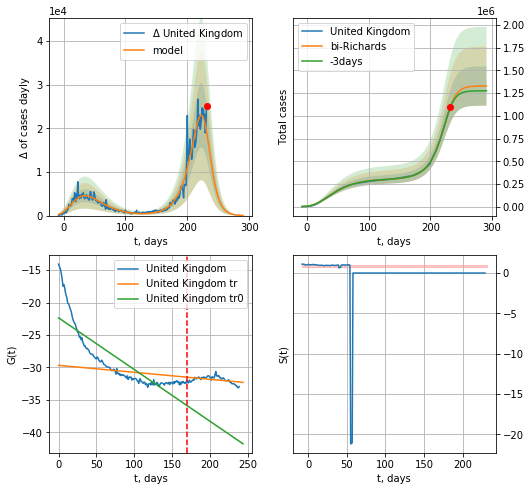

United Kingdom data at: 2020-11-04
+3 day model MAPE: 0.008164
model: bi-Richards
coeffs: [1.02622723e+06 5.67251450e-02 2.29351274e+02 2.09893567e+00]
rational stdev: 0.163118
forecast at the end of period: +59 days
	 deltaDaycases: 40
	 total cases: 1329390 ± 216847
	 total death: 57747 ± 28258
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.712361
 intercept: -22.350932
 slope: -0.079643
trend coefficient of determination: 0.189662
 intercept: -29.675760
 slope: -0.010769


In [4740]:
vL = 170+12#143+12
x = forecastRR('United Kingdom',dfGB[12:vL-12],d1,T18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('United Kingdom',dfGB[12:],d1,40*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
#x = forecastRR('United Kingdom',dfGB[:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


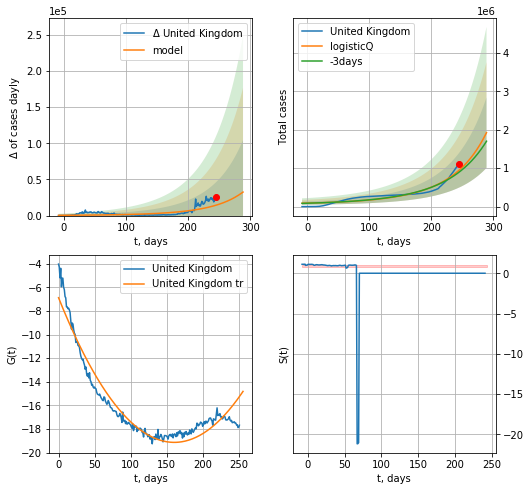

United Kingdom data at: 2020-11-04
+3 day model MAPE: 0.055670
model: logisticQ
coeffs: [ 2.45438522e+09  2.26464170e-05  5.88536227e+02 -7.64993990e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.476511
forecast at the end of period: +45 days
	 deltaDaycases: 32550
	 total cases: 1925452 ± 917498
	 total death: 83639 ± 119564
trend coefficient of determination: 0.931009
 intercept_: -6.879822438352436
 coeffs_: [ 0.         -0.15264948  0.00047514]


In [4741]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


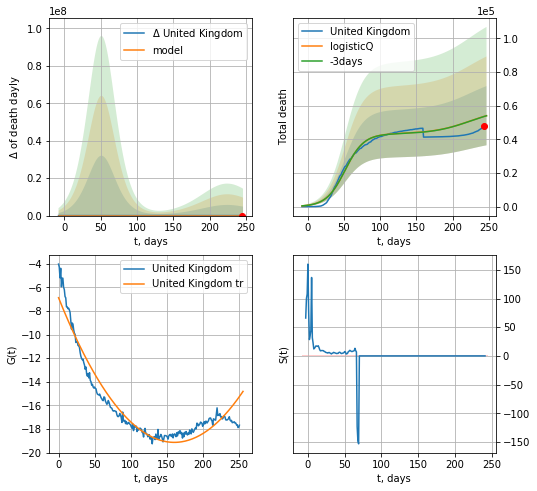

United Kingdom data at: 2020-11-04
+3 day model MAPE: 0.000835
model: logisticQ
coeffs: [ 4.33012516e+04  1.59155193e-07  5.15678465e+01 -4.83270761e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.325461
forecast at the end of period: +3 days
	 total death: 54078 ± 17600
trend coefficient of determination: 0.931009
 intercept_: -6.879822438352436
 coeffs_: [ 0.         -0.15264948  0.00047514]


In [4742]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [4743]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [4744]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [4745]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [4746]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [4747]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

DK
           date    cases  active  death
247 2020-10-31  46351.0   11107  721.0
248 2020-11-01  47299.0   11617  723.0
249 2020-11-02  48241.0   12106  724.0
250 2020-11-03  49594.0   12755  728.0
251 2020-11-04  50530.0   12909  729.0


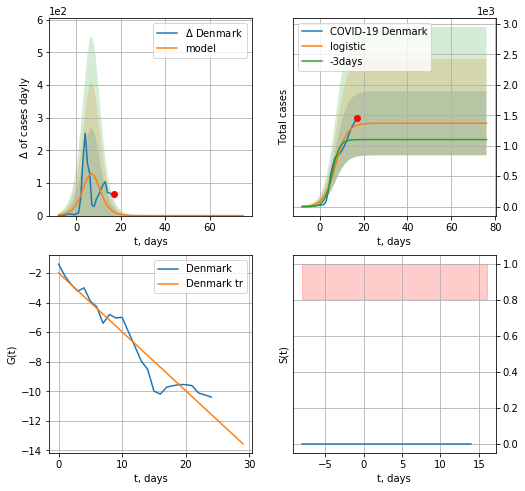

Denmark data at: 2020-11-04
+3 day model MAPE: 0.22309164797181072
model: logistic
coeffs:  [1.36966074e+03 3.75718857e-01 7.30059730e+00]
rational stdev:  0.3847660616131427
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  1369 ± 526
	 total death:  19 ± 21
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


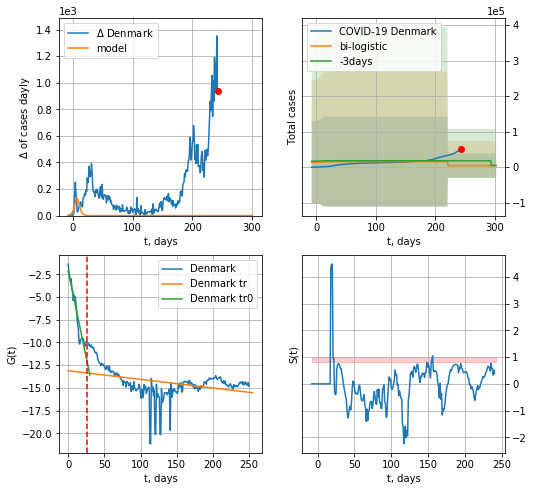

Denmark data at: 2020-11-04
+3 day model MAPE: 0.7685826266659319
model: bi-logistic
coeffs:  [11084.98825213  -120.98755979   220.50475432] [1.36966074e+03 3.75718857e-01 7.30059730e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  8.311783849260172
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  4140 ± 34418
	 total death:  59 ± 1471
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.135741
 intercept: -13.113090
 slope: -0.009487


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp


In [4748]:
dfDK = read_df(pd.DataFrame(),"DK")
vL = 26
try:
    x = forecast('Denmark',dfDK[:vL],d1,7*T18-dT,1.0)
    xx = forecast2('Denmark',dfDK[:],d1,T18*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

In [4749]:
d12f(4)

'2020-11-01'

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


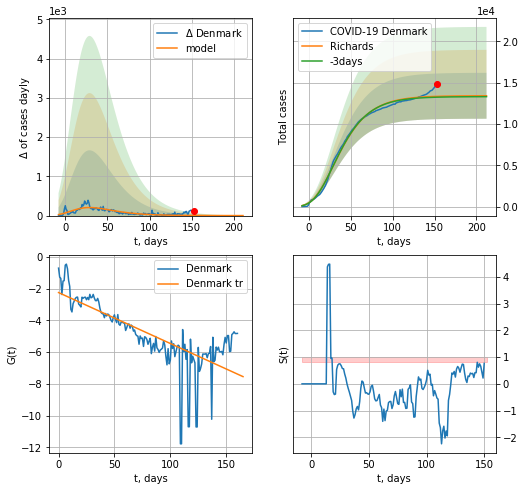

Denmark data at: 2020-11-04
+3 day model MAPE: 0.007554
model: Richards
coeffs: [ 1.34130300e+04  7.49026131e+00 -9.48203706e+01  5.58236421e-03]
rational stdev: 0.207033
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 13406 ± 2775
	 total death: 193 ± 119
trend coefficient of determination: 0.554551
 intercept: -2.245446
 slope: -0.032115


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


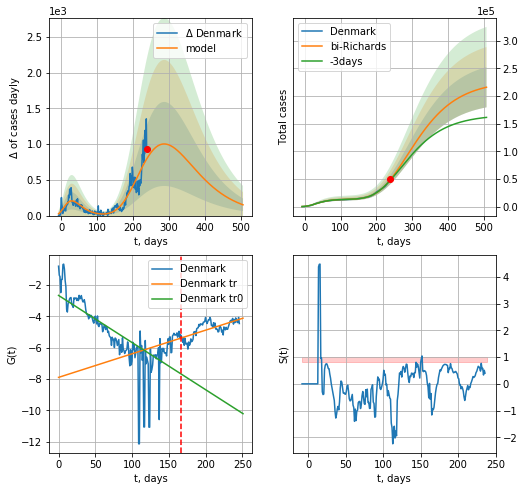

Denmark data at: 2020-11-04
+3 day model MAPE: 0.022997
model: bi-Richards
coeffs: [2.14518439e+05 3.04969620e-01 4.38731338e+01 4.25197172e-02]
rational stdev: 0.168433
forecast at the end of period: +269 days
	 deltaDaycases: 150
	 total cases: 216013 ± 36383
	 total death: 3116 ± 1574
bi-Richards approximation splitting point: 166
trend coefficient of determination: 0.514240
 intercept: -2.655802
 slope: -0.030072
trend coefficient of determination: 0.475122
 intercept: -7.887750
 slope: 0.015060


In [4750]:
vL = 170#125+4
x = forecastRR('Denmark',dfDK[4:vL-4],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Denmark',dfDK[4:],d1,70*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

In [4751]:
#x = forecastRRR('Denmark',dfDK[:18],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
#x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
           date    cases  active  death
248 2020-10-31  20331.0    8186  282.0
249 2020-11-01  20635.0    8490  282.0
250 2020-11-02  21339.0    9194  282.0
251 2020-11-03  21956.0    9811  282.0
252 2020-11-04  22578.0   10433  282.0


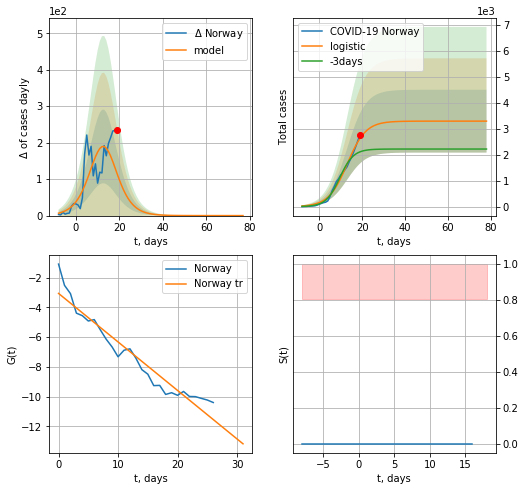

Norway data at: 2020-11-04
+3 day model MAPE: 0.28148190042351234
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.36743919108062534
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  3297 ± 1211
	 total death:  41 ± 45
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


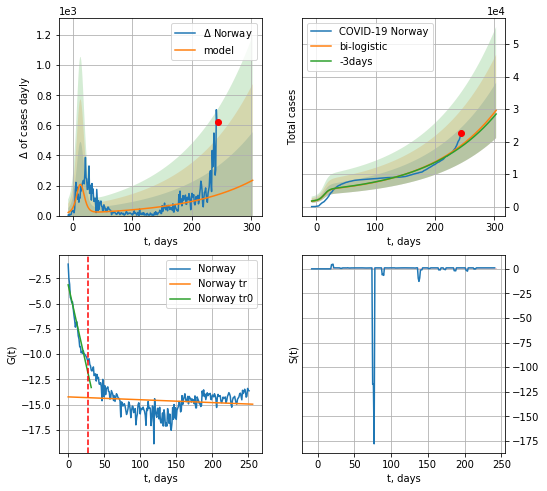

Norway data at: 2020-11-04
+3 day model MAPE: 0.023023996414232167
model: bi-logistic
coeffs:  [3.15804703e+07 8.95559604e-03 1.09452190e+03] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.2889438667237825
forecast at the end of period: +59 days
	 deltaDaycases:  234
	 total cases:  29633 ± 8562
	 total death:  370 ± 320
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.020683
 intercept: -14.217856
 slope: -0.002817


In [4752]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*T18-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,T18*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

In [4753]:
vL = 28#len(dfNG)-13-dT
#x = forecast('Norway',dfNG[:-12-dT],d1,7*T18-dT,1.0)
#xx = forecast2('Norway',dfNG[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


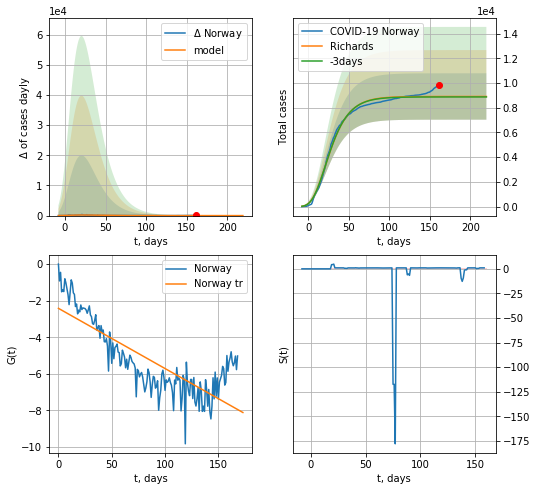

Norway data at: 2020-11-04
+3 day model MAPE: 0.004158
model: Richards
coeffs: [ 8.91182665e+03  1.17805192e+01 -6.51408289e+01  5.19219885e-03]
rational stdev: 0.210568
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 8911 ± 1876
	 total death: 111 ± 70
trend coefficient of determination: 0.645538
 intercept: -2.421068
 slope: -0.032887


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


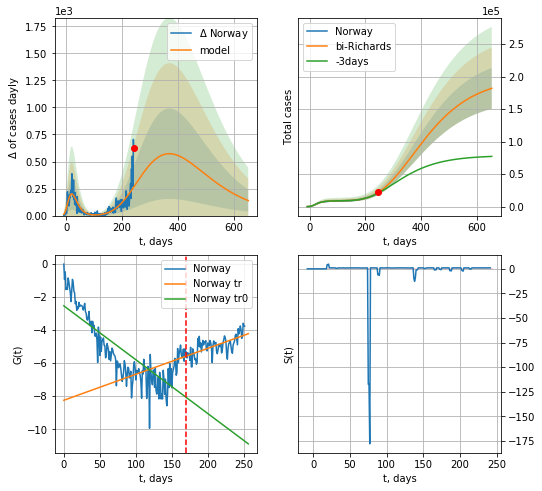

Norway data at: 2020-11-04
+3 day model MAPE: 0.036252
model: bi-Richards
coeffs: [ 1.90645865e+05  4.58890096e-01 -1.18465031e+02  1.79385308e-02]
rational stdev: 0.173123
forecast at the end of period: +409 days
	 deltaDaycases: 138
	 total cases: 181892 ± 31489
	 total death: 2271 ± 1179
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.634933
 intercept: -2.539890
 slope: -0.032561
trend coefficient of determination: 0.433191
 intercept: -8.244730
 slope: 0.015701


In [4754]:
vL = 170#96+22
x = forecastRR('Norway',dfNG[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Norway',dfNG[:],d1,90*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

In [4755]:
#x = forecastRRR('Norway',dfNG[:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


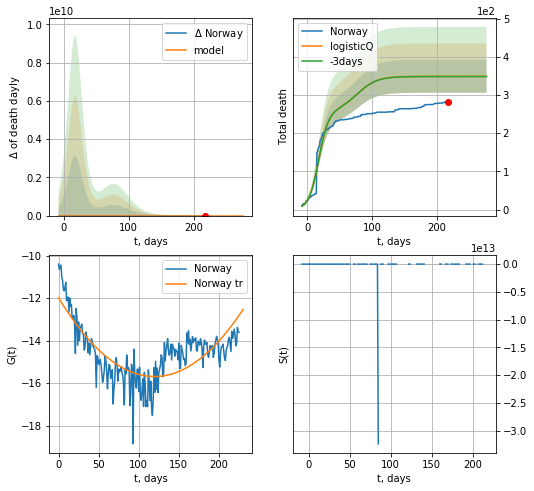

Norway data at: 2020-11-04
+3 day model MAPE: 0.001808
model: logisticQ
coeffs: [ 2.57701661e+02  1.51451958e-07  1.78141912e+01 -8.65653646e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.123558
forecast at the end of period: +59 days
	 total death: 348 ± 43
trend coefficient of determination: 0.592279
 intercept_: -11.985303393518969
 coeffs_: [ 0.         -0.0619206   0.00025878]


In [4756]:
x = forecastRRR('Norway',dfNG[26:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

SW
           date   cases  active   death
249 2020-10-31  126824       0  5938.0
250 2020-11-01  129343       0  5938.0
251 2020-11-02  131912       0  5938.0
252 2020-11-03  134532       0  5969.0
253 2020-11-04  137730       0  5997.0


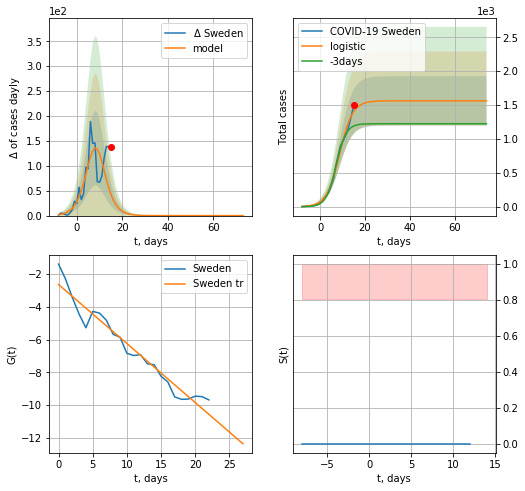

Sweden data at: 2020-11-04
+3 day model MAPE: 0.20348254679733155
model: logistic
coeffs:  [1.56232986e+03 3.49134536e-01 8.72829156e+00]
rational stdev:  0.2329336409619122
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  1562 ± 363
	 total death:  68 ± 47
trend coefficient of determination: 0.947679
 intercept: -2.633085
 slope: -0.360867


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


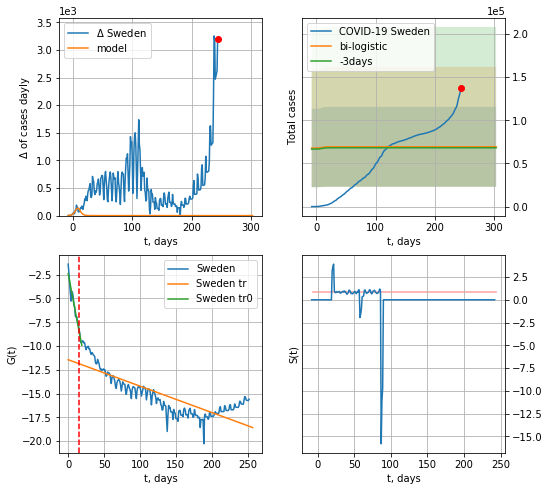

Sweden data at: 2020-11-04
+3 day model MAPE: 0.017298725973514572
model: bi-logistic
coeffs:  [ 5.42301116e+04 -1.95847487e+01  4.78663870e+02] [1.56232986e+03 3.49134536e-01 8.72829156e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.6678332167879135
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  69349 ± 46314
	 total death:  3019 ± 6048
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.906612
 intercept: -2.393320
 slope: -0.396924
trend coefficient of determination: 0.682464
 intercept: -11.443657
 slope: -0.027759


In [4757]:
vL = 15#len(dfSW)-12-dT
dfSW = read_df(pd.DataFrame(),"SW")
try:
    x = forecast('Sweden',dfSW[:-9-dT],d1,7*T18-dT,1.0)
    xx = forecast2('Sweden',dfSW[:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)
except:
    print ("Exception occurs")

SW
           date   cases  active   death
249 2020-10-31  126824       0  5938.0
250 2020-11-01  129343       0  5938.0
251 2020-11-02  131912       0  5938.0
252 2020-11-03  134532       0  5969.0
253 2020-11-04  137730       0  5997.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


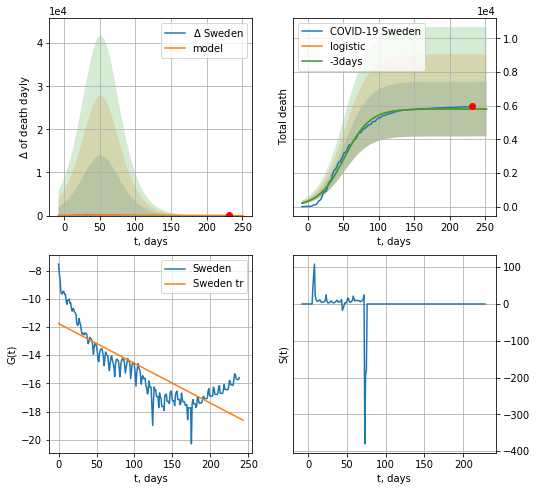

Sweden data at: 2020-11-04
+3 day model MAPE: 0.0008131974810411915
model: logistic
coeffs:  [5.80364110e+03 5.53706859e-02 5.15754526e+01]
rational stdev:  0.2801419442571471
forecast at the end of period: +21 days
	 total death:  5803 ± 1625
trend coefficient of determination: 0.682615
 intercept: -11.760923
 slope: -0.028207


In [4758]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


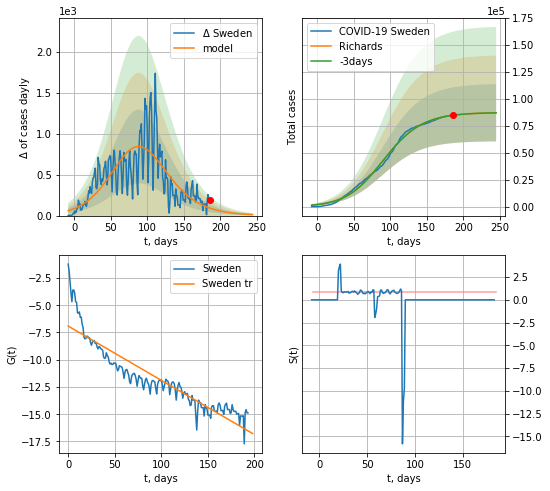

Sweden data at: 2020-11-04
+3 day model MAPE: 0.000915
model: Richards
coeffs: [8.74810267e+04 4.63409470e-02 8.14539890e+01 7.72628002e-01]
rational stdev: 0.304764
forecast at the end of period: +59 days
	 deltaDaycases: 11
	 total cases: 87157 ± 26562
	 total death: 3795 ± 3469
trend coefficient of determination: 0.837425
 intercept: -6.911532
 slope: -0.049779


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


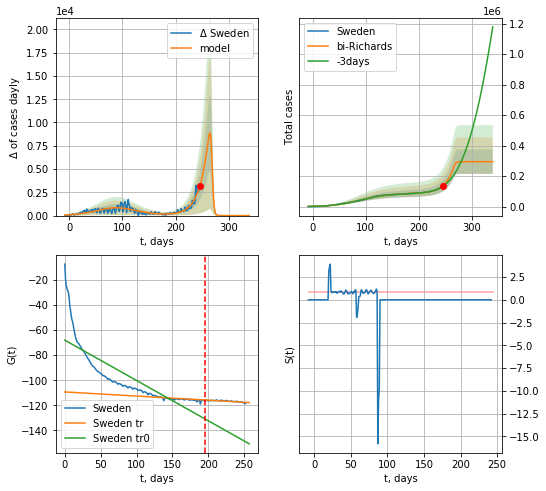

Sweden data at: 2020-11-04
+3 day model MAPE: 0.031449
model: bi-Richards
coeffs: [2.06957414e+05 6.06176241e-02 2.68478873e+02 9.69576573e+00]
rational stdev: 0.271020
forecast at the end of period: +94 days
	 deltaDaycases: 0
	 total cases: 294427 ± 79795
	 total death: 12819 ± 10422
bi-Richards approximation splitting point: 195
trend coefficient of determination: 0.692003
 intercept: -68.027870
 slope: -0.321542
trend coefficient of determination: 0.706778
 intercept: -109.311080
 slope: -0.032893


In [4759]:
iL = 0
vL = 195+iL
x = forecastRR('Sweden',dfSW[iL:vL-iL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sweden',dfSW[iL:],d12f(1),45*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


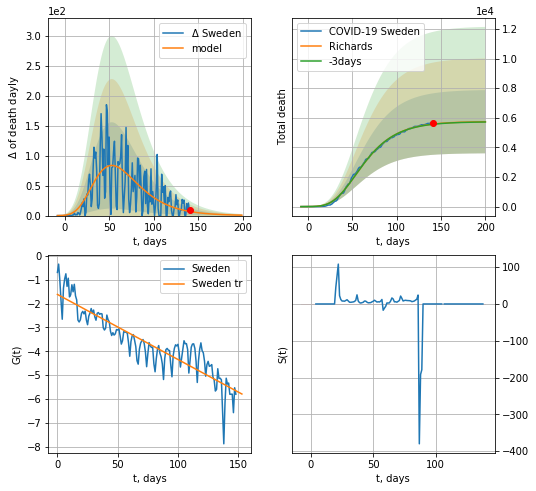

Sweden data at: 2020-11-04
+3 day model MAPE: 0.002445
model: Richards
coeffs: [ 5.75133549e+03  5.79293366e+00 -7.21072797e+01  6.85063513e-03]
rational stdev: 0.372383
forecast at the end of period: +59 days
	 total death: 5734 ± 2135
trend coefficient of determination: 0.814804
 intercept: -1.618399
 slope: -0.027247


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:209: RuntimeWarning: invalid value encountered in true_divide


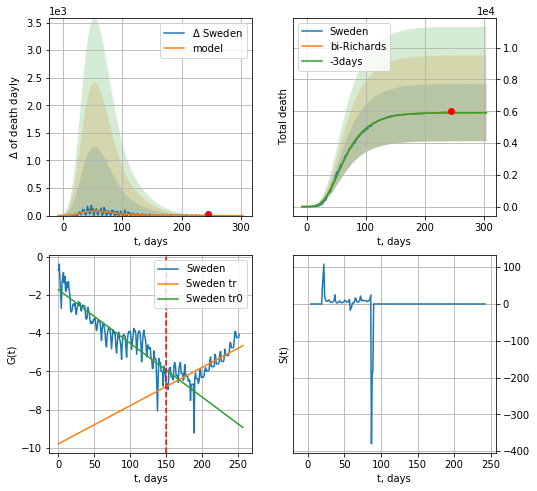

Sweden data at: 2020-11-04
+3 day model MAPE: 0.001312
model: bi-Richards
coeffs: [1.60899778e+02 1.66253115e+00 4.69617609e+01 2.46243619e-02]
rational stdev: 0.304190
forecast at the end of period: +59 days
	 total death: 5911 ± 1798
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.822955
 intercept: -1.724155
 slope: -0.028079
trend coefficient of determination: 0.536562
 intercept: -9.794560
 slope: 0.020001


In [4760]:
vL = 150
x = forecastRR('Sweden',dfSW[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death')
xx = forecast2RR('Sweden',dfSW[:],d1,T18*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death',vL=vL)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

In [4761]:
#x = forecastRRR('Sweden',dfSW[1:],d1,55*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


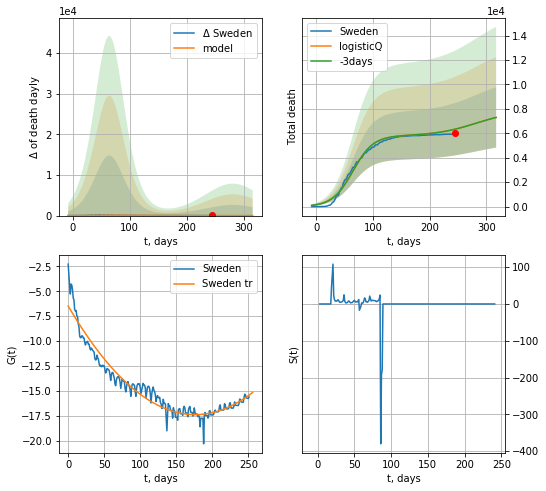

Sweden data at: 2020-11-04
+3 day model MAPE: 0.000573
model: logisticQ
coeffs: [ 5.80055947e+03  8.61207107e-08  6.45749632e+01 -6.48159354e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.338352
forecast at the end of period: +73 days
	 total death: 7301 ± 2470
trend coefficient of determination: 0.933847
 intercept_: -6.485433436932972
 coeffs_: [ 0.         -0.12341904  0.00034998]


In [4762]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
283 2020-10-31  85997.0     359  4634.0
284 2020-11-01  86021.0     363  4634.0
285 2020-11-02  86070.0     391  4634.0
286 2020-11-03  86087.0     392  4634.0
287 2020-11-04  86115.0     400  4634.0


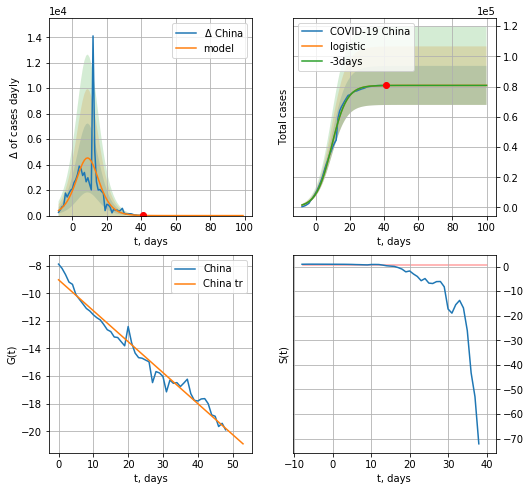

China data at: 2020-11-04
+3 day model MAPE: 0.00012785692963974442
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.159713160092933
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  80810 ± 12906
	 total death:  4348 ± 2083
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


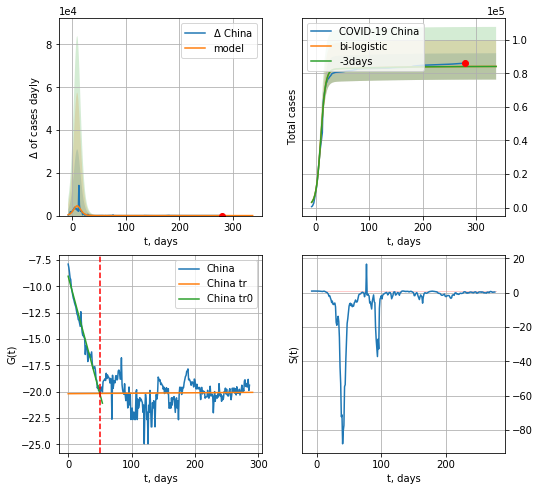

China data at: 2020-11-04
+3 day model MAPE: 0.00040445206920117715
model: bi-logistic
coeffs:  [3.42673109e+03 1.26232504e-02 1.02167538e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.09330313687522755
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  84183 ± 7854
	 total death:  4530 ± 1267
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.000629
 intercept: -20.194601
 slope: 0.000434


In [4763]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*T18-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,T18*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [4764]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

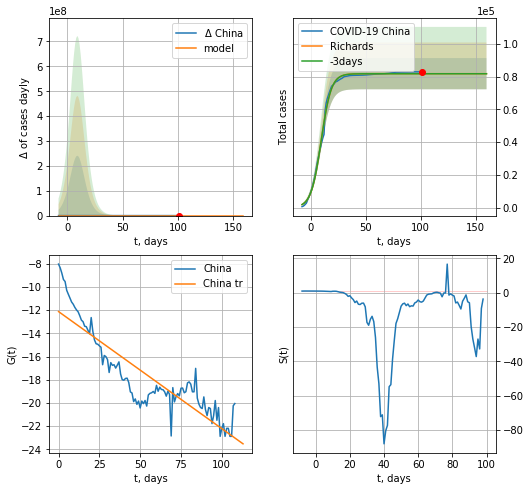

China data at: 2020-11-04
+3 day model MAPE: 0.000627
model: Richards
coeffs: [8.17736184e+04 2.15574455e-01 9.59539709e+00 1.02116174e+00]
rational stdev: 0.116457
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 81773 ± 9523
	 total death: 4400 ± 1537
trend coefficient of determination: 0.785239
 intercept: -12.125055
 slope: -0.100960


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


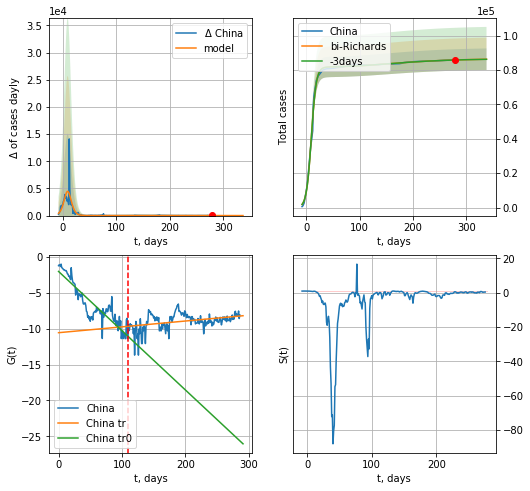

China data at: 2020-11-04
+3 day model MAPE: 0.000323
model: bi-Richards
coeffs: [ 4.92733802e+03  3.41168999e+00 -2.67766649e+02  3.88917250e-03]
rational stdev: 0.072627
forecast at the end of period: +59 days
	 deltaDaycases: 5
	 total cases: 86308 ± 6268
	 total death: 4644 ± 1011
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.820996
 intercept: -1.992301
 slope: -0.082701
trend coefficient of determination: 0.148954
 intercept: -10.543901
 slope: 0.008141


In [4765]:
vL = 110
x = forecastRR('China',dfCN[:vL],d1,T18*7-dT,1.0)
xx = forecast2RR('China',dfCN[:],d1,T18*7-dT,x,1.0,vL=vL)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

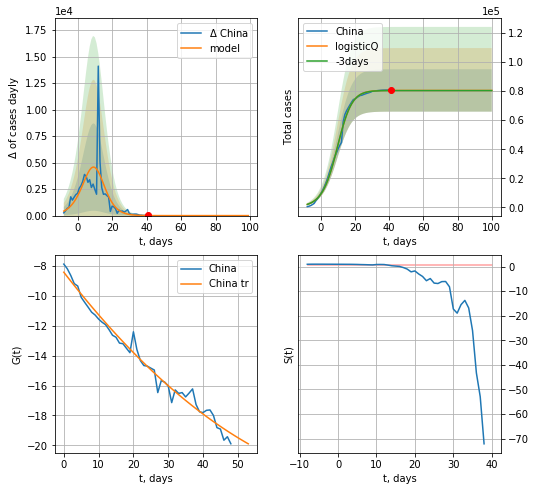

China data at: 2020-11-04
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650464e-03  9.35257489e+00 -2.02425637e+02]
rational stdev: 0.181019
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 80417 ± 14557
	 total death: 4327 ± 2349
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


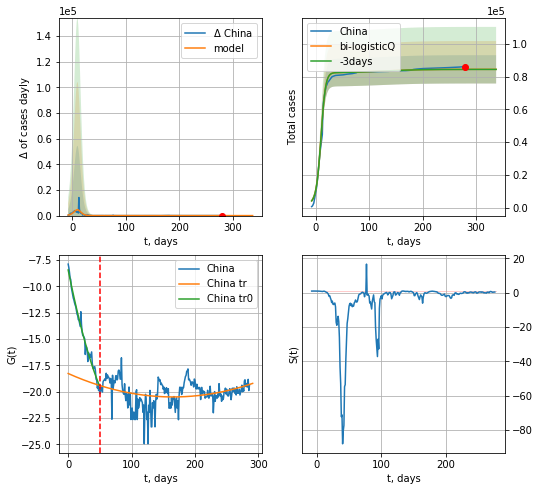

China data at: 2020-11-04
+3 day model MAPE: 0.000489
model: bi-logisticQ
coeffs: [ 3.99471927e+03  8.33282330e-05  2.47184975e+01 -5.53876429e-02]
rational stdev: 0.102351
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 84411 ± 8639
	 total death: 4542 ± 1394
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.083770
 intercept_: -18.277346299052848
 coeffs_: [ 0.00000000e+00 -2.69286322e-02  8.14353106e-05]


In [4766]:
x = forecastRRR('China',dfCN[:50],d1,7*T18-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,T18*7-dT,x,1.0,vL=50)

In [4767]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
259 2020-10-31  26635  1812.0  466.0
260 2020-11-01  26732  1869.0  468.0
261 2020-11-02  26807  1825.0  472.0
262 2020-11-03  26925  1835.0  474.0
263 2020-11-04  27050  1840.0  475.0


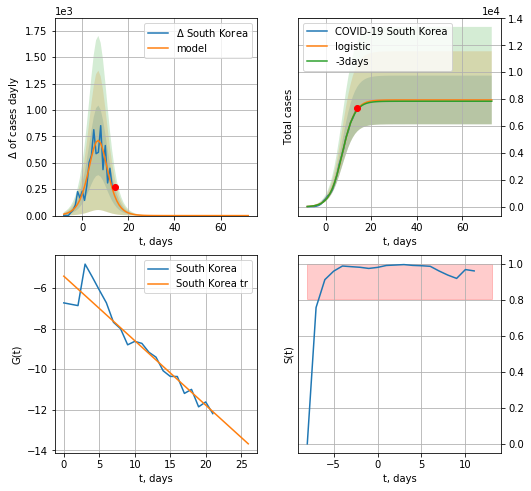

South Korea data at: 2020-11-04
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  7941 ± 1807
	 total death:  139 ± 94
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


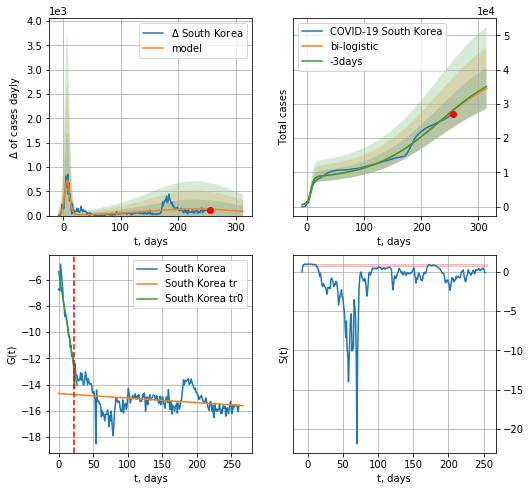

South Korea data at: 2020-11-04
+3 day model MAPE: 0.007029635579226331
model: bi-logistic
coeffs:  [3.28256545e+04 1.69266969e-02 2.28882068e+02] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.17378688083540322
forecast at the end of period: +59 days
	 deltaDaycases:  86
	 total cases:  34483 ± 5992
	 total death:  605 ± 315
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.069817
 intercept: -14.677402
 slope: -0.003466


In [4768]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*T18-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,T18*7-dT,x,1.0,vL=23)

In [4769]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

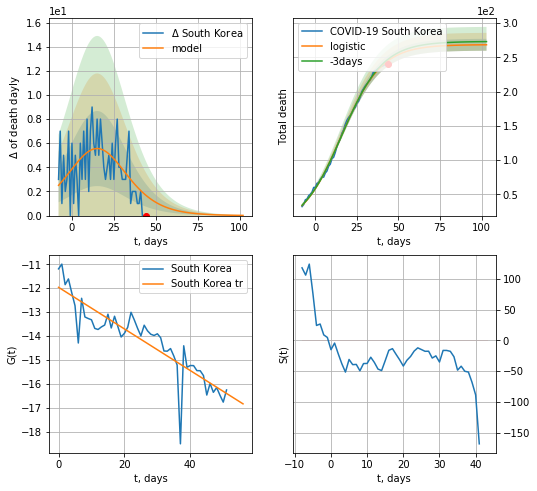

South Korea data at: 2020-11-04
model: logistic
coeffs:  [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.032418936831668854
forecast at the end of period: +59 days
	 total death:  268 ± 8
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: divide by zero encountered in true_divide


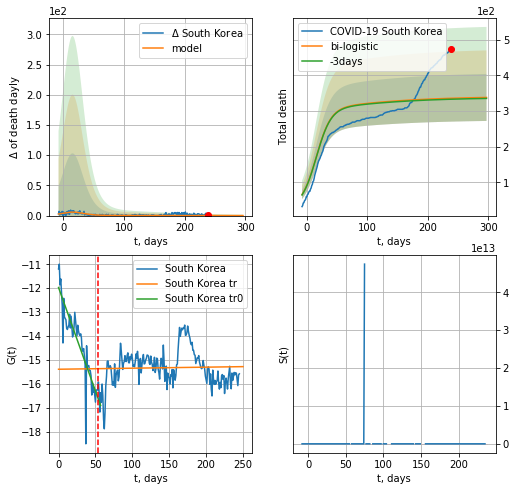

South Korea data at: 2020-11-04
+3 day model MAPE: 0.00784321241895664
model: bi-logistic
coeffs:  [7.24117248e+01 1.13658022e-02 9.85897139e+00] [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.19500161752183864
forecast at the end of period: +59 days
	 deltaDaydeath:  0
	 total death:  338 ± 65
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.001134
 intercept: -15.390605
 slope: 0.000435


In [4770]:
x = forecast('South Korea',dfKR[17:70],d1,T18*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,T18*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


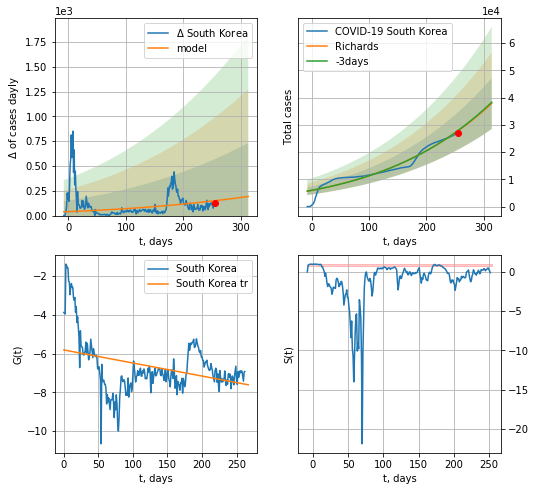

South Korea data at: 2020-11-04
+3 day model MAPE: 0.005024
model: Richards
coeffs: [1.88240589e+06 1.14279251e-02 1.89837174e+02 1.51382837e-01]
rational stdev: 0.247246
forecast at the end of period: +59 days
	 deltaDaycases: 192
	 total cases: 37825 ± 9352
	 total death: 664 ± 492
trend coefficient of determination: 0.127360
 intercept: -5.810864
 slope: -0.006735


In [4771]:
x = forecastRR('South Korea',dfKR[:],d1,T18*7-dT,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


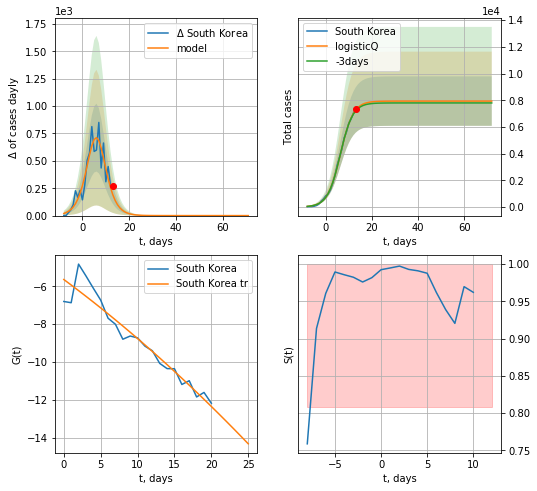

South Korea data at: 2020-11-04
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644740e+03  5.70893336e-05  6.37140939e+00 -6.30084107e+03]
rational stdev: 0.233522
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 7936 ± 1853
	 total death: 139 ± 97
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


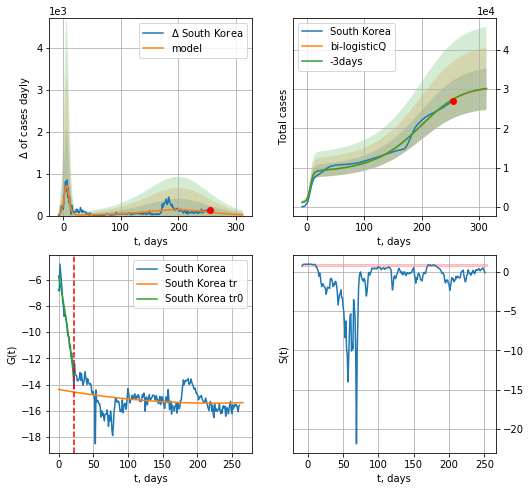

South Korea data at: 2020-11-04
+3 day model MAPE: 0.002837
model: bi-logisticQ
coeffs: [ 2.25962819e+04  4.60845904e-05  1.88610170e+02 -3.42835710e+02]
rational stdev: 0.176415
forecast at the end of period: +59 days
	 deltaDaycases: 18
	 total cases: 30018 ± 5295
	 total death: 527 ± 278
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.076820
 intercept_: -14.368530810410121
 coeffs_: [ 0.00000000e+00 -9.33934482e-03  2.08532697e-05]


In [4772]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,T18*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,T18*7-dT,x,1.0,vL=vL)

In [4773]:
#x = forecastRR('South Korea',dfKR[68:],d1,10*7-dT,1.0)

In [4774]:
#vL=25
#x = forecastQR('South Korea',dfKR[1:vL],d1,16*7-dT,1.0)
#xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


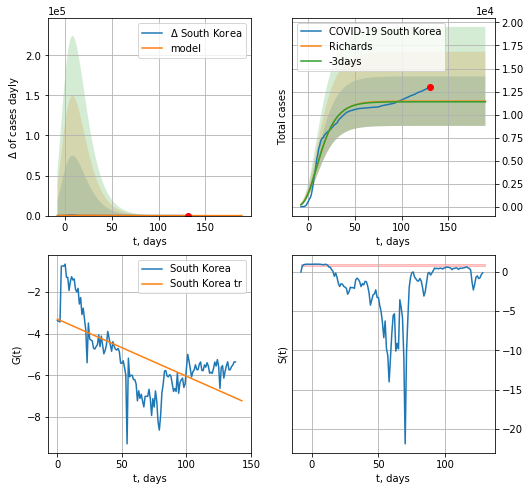

South Korea data at: 2020-11-04
+3 day model MAPE: 0.006245
model: Richards
coeffs: [ 1.14621909e+04  2.64955361e+01 -6.29475021e+01  3.05260511e-03]
rational stdev: 0.234092
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 11462 ± 2683
	 total death: 201 ± 141
trend coefficient of determination: 0.403266
 intercept: -3.307543
 slope: -0.027367


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


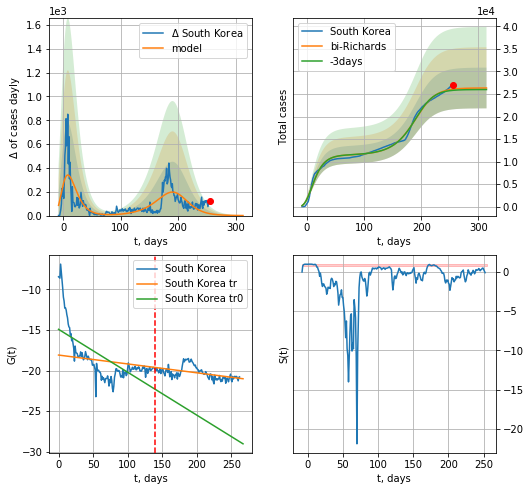

South Korea data at: 2020-11-04
+3 day model MAPE: 0.009798
model: bi-Richards
coeffs: [1.48773690e+04 4.06037169e-02 1.97406005e+02 1.50904544e+00]
rational stdev: 0.171460
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 26331 ± 4514
	 total death: 462 ± 237
bi-Richards approximation splitting point: 140
trend coefficient of determination: 0.453210
 intercept: -14.920959
 slope: -0.052802
trend coefficient of determination: 0.254345
 intercept: -18.090254
 slope: -0.010921


In [4775]:
iL = 0
vL = 140+iL
x = forecastRR('South Korea',dfKR[iL:vL-iL],d1,T18*7-dT,1.0)
xx=forecast2RR('South Korea',dfKR[iL:],d1,T18*7-dT,x,1.0,vL=vL-iL)
#xx = np.concatenate((x, xx), axis=0)
#print (xx)
#xxx=forecast3RR('South Korea',dfKR[1:],d1,12*7-dT,xx,1.0,vL=[vL,vL1],zoom=1e3)

In [4776]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

In [4777]:
#x = forecastQR('South Korea',dfKR[:],d1,16*7-dT,1.0)

SG
           date    cases  active  death
282 2020-10-31  58019.0      78   28.0
283 2020-11-01  58020.0      68   28.0
284 2020-11-02  58029.0      77   28.0
285 2020-11-03  58036.0      71   28.0
286 2020-11-04  58043.0      77   28.0


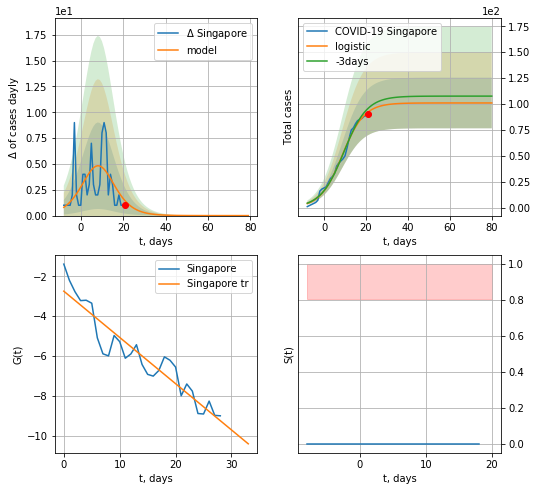

Singapore data at: 2020-11-04
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  101 ± 24
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


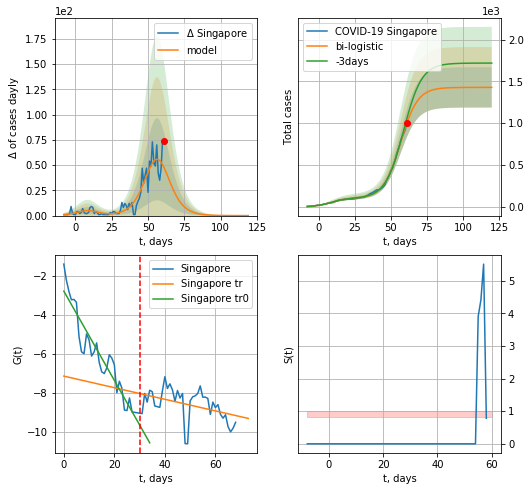

Singapore data at: 2020-11-04
+3 day model MAPE: 0.06119827726371909
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112356490856
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  1427 ± 241
	 total death:  0 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:353: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


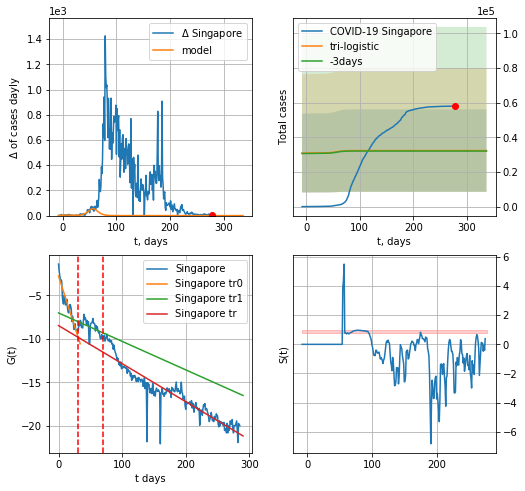

Singapore data at: 2020-11-04
+3 day model MAPE: 0.008463022381349505
model: tri-logistic
coeffs:  [ 3.09140911e+04 -1.93242251e+01  4.65825701e+02] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  0.7359211306998533
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  32342 ± 23801
	 total death:  15 ± 33
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.872916
 intercept: -8.469895
 slope: -0.043847


In [4778]:
vL = 30
vL1 = 70
try:
    dfSG = read_df(pd.DataFrame(),"SG")
    x = forecast('Singapore',dfSG[:vL],d1,7*T18-dT,1.0)
    xx = forecast2('Singapore',dfSG[:vL1],d1,T18*7-dT,x,1.0,vL=vL)
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Singapore",dfSG,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])
except:
    print ("Exception occurs")

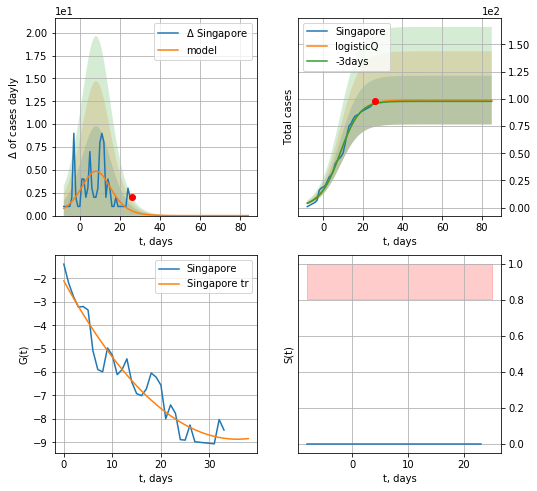

Singapore data at: 2020-11-04
+3 day model MAPE: 0.007575
model: logisticQ
coeffs: [ 9.88556613e+01  2.70689941e-04  8.43151450e+00 -7.17657610e+02]
rational stdev: 0.226599
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 98 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


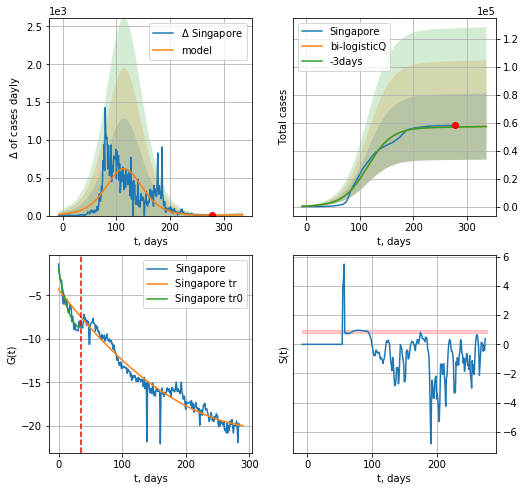

Singapore data at: 2020-11-04
+3 day model MAPE: 0.000959
model: bi-logisticQ
coeffs: [ 5.66942261e+04  4.35123221e-08  1.14497643e+02 -1.00399241e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.413806
forecast at the end of period: +59 days
	 deltaDaycases: 11
	 total cases: 57343 ± 23729
	 total death: 27 ± 33
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.938161
 intercept_: -4.294255969096575
 coeffs_: [ 0.         -0.09578337  0.00014349]


In [4779]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*T18-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d12f(1),T18*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [4780]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


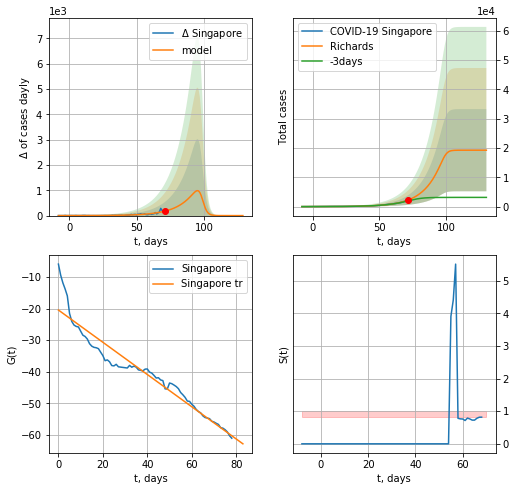

Singapore data at: 2020-11-04
+3 day model MAPE: 0.158856
model: Richards
coeffs: [1.92302023e+04 7.72500001e-02 9.92482833e+01 7.56752958e+00]
rational stdev: 0.728321
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 19230 ± 14005
	 total death: 9 ± 19
trend coefficient of determination: 0.919778
 intercept: -20.482187
 slope: -0.510333


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


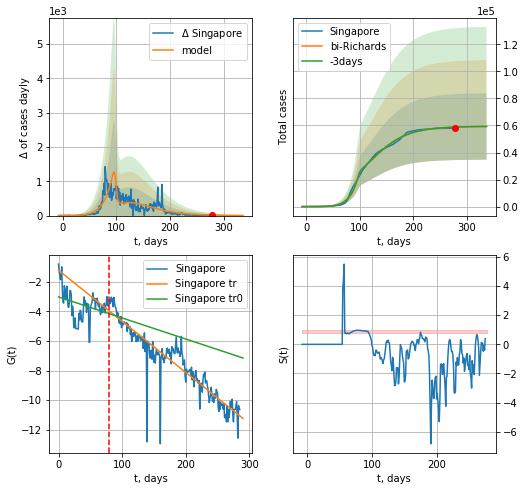

Singapore data at: 2020-11-04
+3 day model MAPE: 0.000996
model: bi-Richards
coeffs: [4.01052804e+04 1.88992601e-01 5.36397924e+01 1.46062137e-01]
rational stdev: 0.414702
forecast at the end of period: +59 days
	 deltaDaycases: 3
	 total cases: 59225 ± 24560
	 total death: 28 ± 34
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.106871
 intercept: -3.014144
 slope: -0.014246
trend coefficient of determination: 0.849454
 intercept: -1.207933
 slope: -0.034587


In [4781]:
iL = 0
vL = 80+iL
x = forecastRR('Singapore',dfSG[iL:vL+iL],d1,T18*7-dT,1.0)
x = forecast2RR('Singapore',dfSG[iL:],d12f(1),T18*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
#x = forecastQR('Singapore',dfSG[60:],d1,16*7-dT,1.0)

In [4782]:
shift = 1.0
try:
    dfES = read_df(pd.DataFrame(),"ES")
    #x = forecast('Estonia',dfES[1:7],d1,17,1.)
    #xx = forecast2('Estonia',dfES[1:],d1,T18*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)
except:
    print ("Exception occurs")

ES
           date   cases  active  death
233 2020-10-31  4985.0    1088   73.0
234 2020-11-01  5046.0    1141   73.0
235 2020-11-02  5125.0    1148   73.0
236 2020-11-03  5333.0    1306   73.0
237 2020-11-04  5464.0    1359   73.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


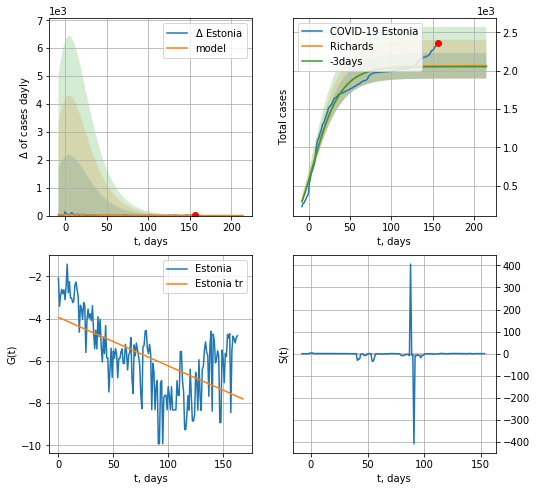

Estonia data at: 2020-11-04
+3 day model MAPE: 0.006696
model: Richards
coeffs: [ 2.06547249e+03  1.08705444e+01 -1.03315442e+02  4.56197694e-03]
rational stdev: 0.081619
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 2065 ± 168
	 total death: 27 ± 6
trend coefficient of determination: 0.348386
 intercept: -3.939276
 slope: -0.022998


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


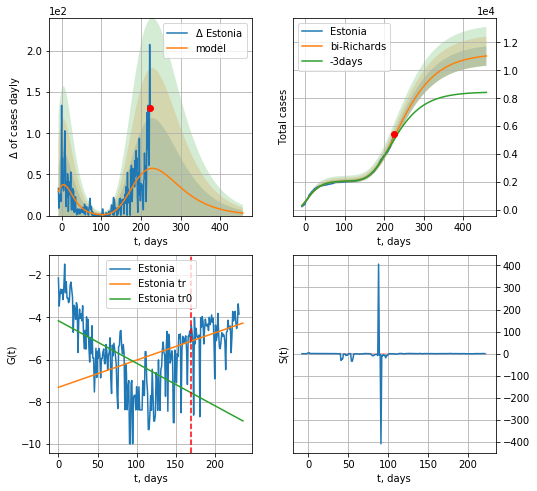

Estonia data at: 2020-11-04
+3 day model MAPE: 0.030406
model: bi-Richards
coeffs: [ 9.14161751e+03  1.29327515e+00 -2.22417329e+01  1.32889551e-02]
rational stdev: 0.063060
forecast at the end of period: +234 days
	 deltaDaycases: 3
	 total cases: 11029 ± 695
	 total death: 147 ± 27
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.293050
 intercept: -4.161410
 slope: -0.020115
trend coefficient of determination: 0.059664
 intercept: -7.316447
 slope: 0.012909


In [4783]:
iL = 5
vL=170+iL
x = forecastRR('Estonia',dfES[iL:vL-iL],d1,7*T18-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RR('Estonia',dfES[iL:],d1,7*65-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [4784]:
#x = forecastRRR('Estonia',dfES[:],d1,7*T18-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
           date   cases  active  death
238 2020-10-31  6013.0    4417   71.0
239 2020-11-01  6136.0    4656   74.0
240 2020-11-02  6268.0    4785   77.0
241 2020-11-03  6439.0    4916   79.0
242 2020-11-04  6752.0    5223   85.0


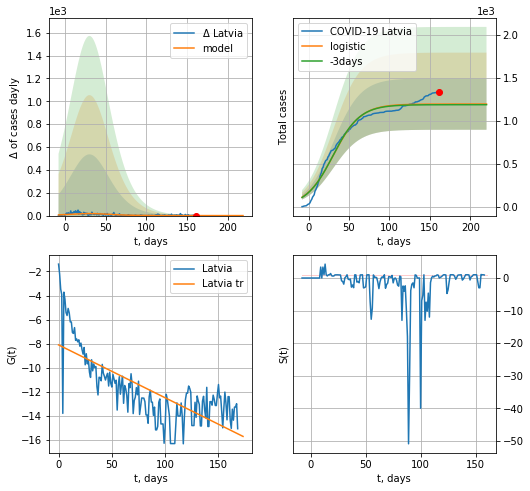

Latvia data at: 2020-11-04
+3 day model MAPE: 0.006385594006530808
model: logistic
coeffs:  [1.19448476e+03 5.92278882e-02 3.05409104e+01]
rational stdev:  0.2505192877675996
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  1194 ± 299
	 total death:  15 ± 11
trend coefficient of determination: 0.548772
 intercept: -8.111036
 slope: -0.044049


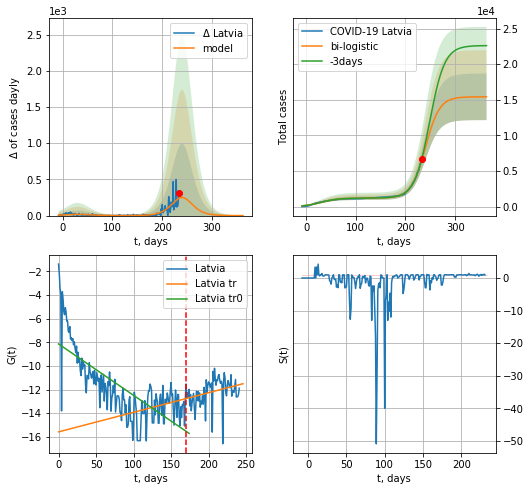

Latvia data at: 2020-11-04
+3 day model MAPE: 0.03857823553977291
model: bi-logistic
coeffs:  [1.42203360e+04 7.04363900e-02 2.40079445e+02] [1.19448476e+03 5.92278882e-02 3.05409104e+01]
rational stdev:  0.21223136900375947
forecast at the end of period: +129 days
	 deltaDaycases:  0
	 total cases:  15412 ± 3270
	 total death:  194 ± 123
bi-logistic approximation splitting point: 170
trend0 coefficient of determination: 0.544306
 intercept: -8.141730
 slope: -0.043501
trend coefficient of determination: 0.094828
 intercept: -15.586219
 slope: 0.016570


In [4785]:
vL=170
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,T18*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,50*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


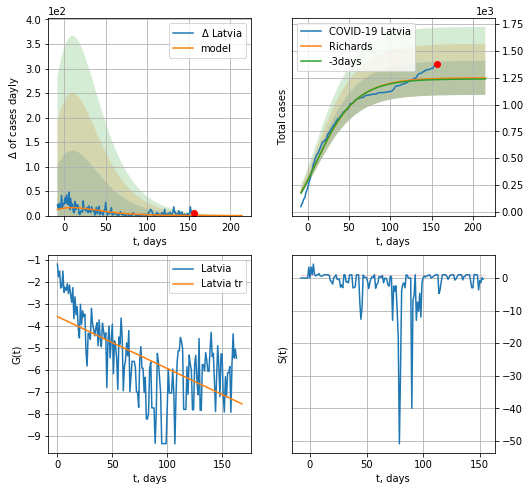

Latvia data at: 2020-11-04
+3 day model MAPE: 0.007772
model: Richards
coeffs: [ 1.24930626e+03  6.40625024e+00 -1.35573848e+02  5.54745387e-03]
rational stdev: 0.126894
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 1248 ± 158
	 total death: 15 ± 5
trend coefficient of determination: 0.384319
 intercept: -3.580648
 slope: -0.023612


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


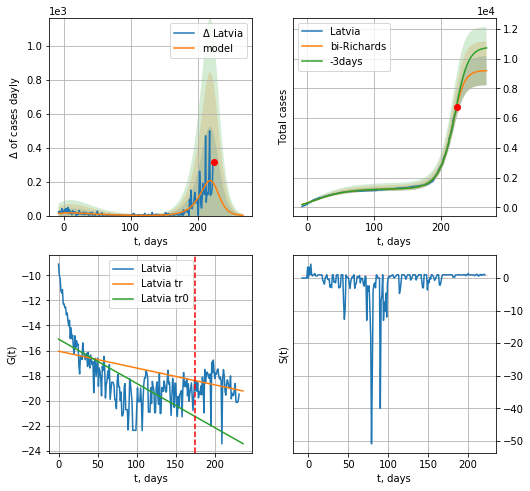

Latvia data at: 2020-11-04
+3 day model MAPE: 0.021517
model: bi-Richards
coeffs: [7.95185941e+03 7.01049536e-02 2.24081817e+02 1.86100662e+00]
rational stdev: 0.106751
forecast at the end of period: +45 days
	 deltaDaycases: 1
	 total cases: 9188 ± 980
	 total death: 115 ± 36
bi-Richards approximation splitting point: 175
trend coefficient of determination: 0.484978
 intercept: -15.091905
 slope: -0.035331
trend coefficient of determination: 0.036202
 intercept: -16.050185
 slope: -0.013457


In [4786]:
iL=10
vL = 175+iL
x = forecastRR('Latvia',dfLV[iL:vL-iL],d1,7*T18-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Latvia',dfLV[iL:],d12f(1),7*38-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('Latvia',dfLV[:],d1,7*16-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

In [4787]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
#x = forecastRRR('Latvia',dfLV[:],d1,7*T18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


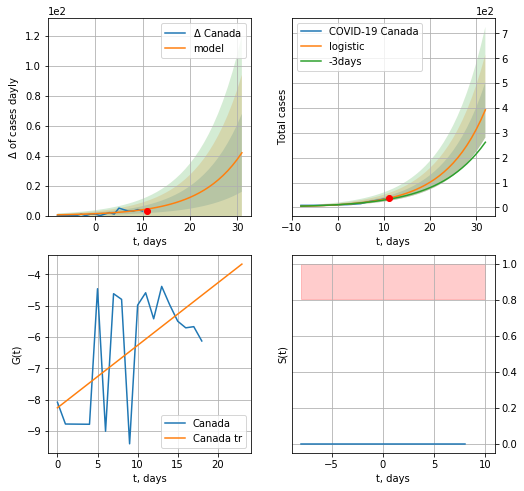

Canada data at: 2020-11-04
+3 day model MAPE: 0.14133490187696762
model: logistic
coeffs:  [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2833740936364515
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  16 ± 13
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


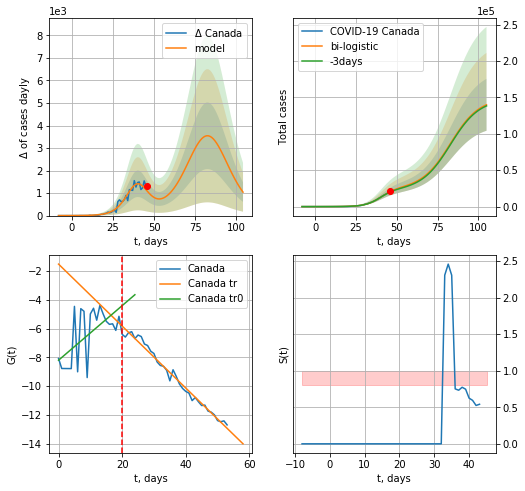

Canada data at: 2020-11-04
+3 day model MAPE: 0.029367009846107475
model: bi-logistic
coeffs:  [2.40153999e+04 2.16961374e-01 4.02658690e+01] [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2549294005106464
forecast at the end of period: +59 days
	 deltaDaycases:  1042
	 total cases:  139867 ± 35656
	 total death:  5833 ± 4461
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:311: RuntimeWarning: overflow encountered in exp


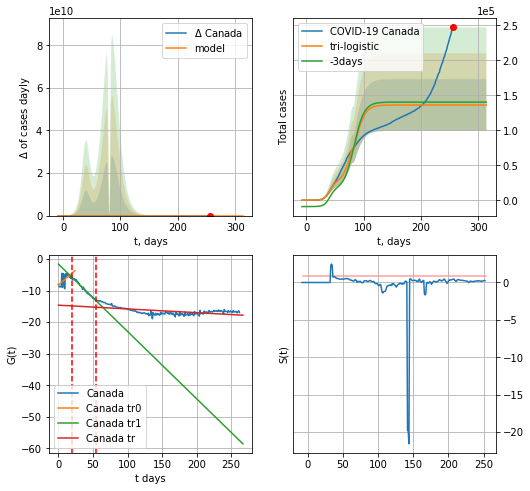

Canada data at: 2020-11-04
+3 day model MAPE: 0.02962755971398099
model: tri-logistic
coeffs:  [-1.32710506e+04  1.13893576e+00  8.10300650e+01] [1.25342997e+05 1.13222116e-01 8.29018541e+01 2.40153999e+04
 2.16961374e-01 4.02658690e+01]
forecast rational stdev:  0.2716646590084596
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  136087 ± 36970
	 total death:  5675 ± 4625
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.350365
 intercept: -14.599842
 slope: -0.011890


In [4788]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,T18*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date     cases  active    death
259 2020-10-31  234511.0   28499  10136.0
260 2020-11-01  236841.0   28933  10179.0
261 2020-11-02  240263.0   30003  10208.0
262 2020-11-03  244935.0   31147  10279.0
263 2020-11-04  247703.0   31725  10331.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:86: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


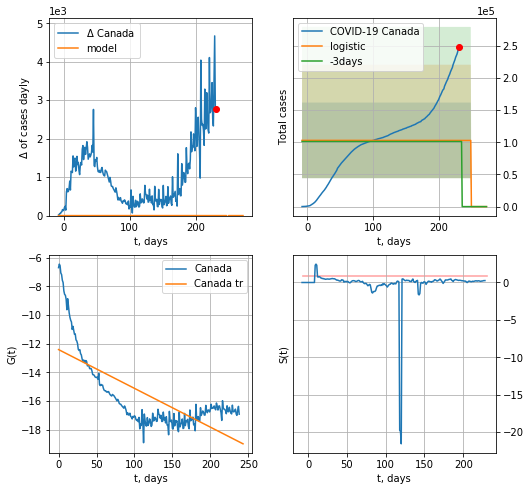

Canada data at: 2020-11-04
+3 day model MAPE: 0.01768734114396043
model: logistic
coeffs:  [ 1.02949346e+05 -2.07125010e+01  2.49327761e+02]
rational stdev:  0.5708599234263126
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.519125
 intercept: -12.407822
 slope: -0.027052


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp


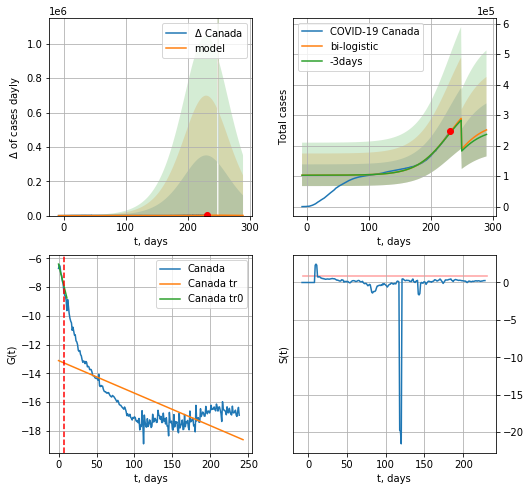

Canada data at: 2020-11-04
+3 day model MAPE: 0.010439249132975682
model: bi-logistic
coeffs:  [2.76691916e+05 3.84115086e-02 2.30112181e+02] [ 1.02949346e+05 -2.07125010e+01  2.49327761e+02]
rational stdev:  0.3453283886572694
forecast at the end of period: +59 days
	 deltaDaycases:  893
	 total cases:  251487 ± 86845
	 total death:  10488 ± 10865
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.499546
 intercept: -13.110193
 slope: -0.022661


In [4789]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,T18*7-dT,x,1.,vL=31-24,cases='cases')

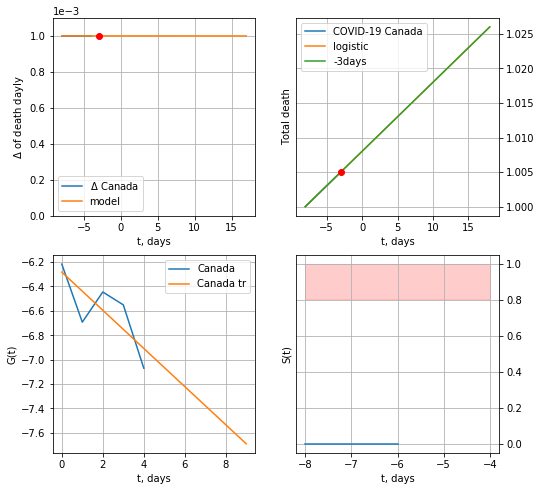

Canada data at: 2020-11-04
+3 day model MAPE: 6.189159426418585e-07
model: logistic
coeffs:  [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  1.593569349221903e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


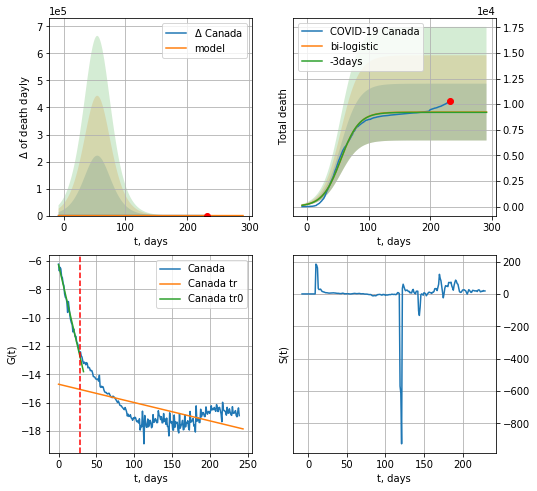

Canada data at: 2020-11-04
+3 day model MAPE: 0.00297940909445857
model: bi-logistic
coeffs:  [9.22403943e+03 6.74153922e-02 5.49930284e+01] [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  0.3002818002944535
forecast at the end of period: +59 days
	 deltaDaydeath:  0
	 total death:  9225 ± 2770
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.377406
 intercept: -14.697204
 slope: -0.012928


In [4790]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,T18*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


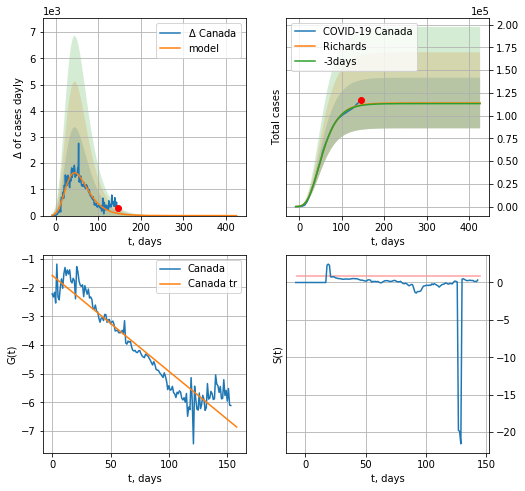

Canada data at: 2020-11-04
+3 day model MAPE: 0.004991
model: Richards
coeffs: [ 1.13901342e+05  5.10785279e+00 -7.91415351e+01  7.66667602e-03]
rational stdev: 0.244657
forecast at the end of period: +280 days
	 deltaDaycases: 0
	 total cases: 113901 ± 27866
	 total death: 4750 ± 3486
trend coefficient of determination: 0.904676
 intercept: -1.579387
 slope: -0.033378


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


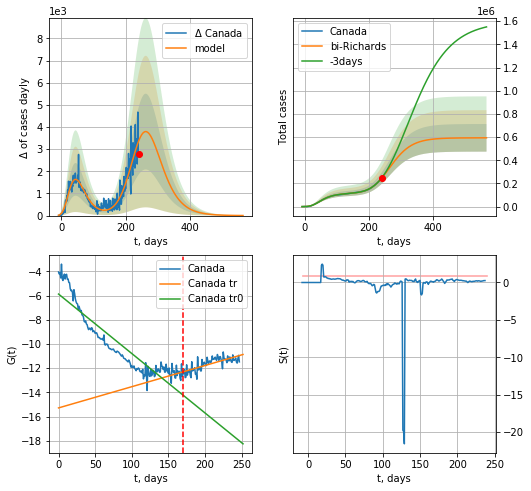

Canada data at: 2020-11-04
+3 day model MAPE: 0.007446
model: bi-Richards
coeffs: [4.79660789e+05 4.85851234e-02 2.41655208e+02 5.62147320e-01]
rational stdev: 0.200899
forecast at the end of period: +325 days
	 deltaDaycases: 3
	 total cases: 593437 ± 119221
	 total death: 24750 ± 14916
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.841179
 intercept: -5.873540
 slope: -0.049104
trend coefficient of determination: 0.545357
 intercept: -15.280908
 slope: 0.017519


In [4791]:
iL = 15
vL = 170 + iL
x = forecastRR('Canada',dfCA[iL:vL-iL],d1,T18*7,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Canada',dfCA[iL:],d1,78*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('Canada',dfCA[28:],d1,16*7,1.)

In [4792]:
#x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
           date   cases  active   death
243 2020-10-31  141279   58492  2507.0
244 2020-11-01  144341   60026  2544.0
245 2020-11-02  146847   60963  2590.0
246 2020-11-03  149443   60219  2635.0
247 2020-11-04  156940   65300  2694.0


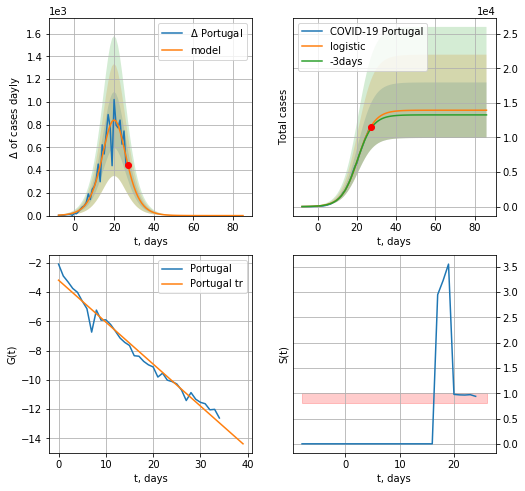

Portugal data at: 2020-11-04
+3 day model MAPE: 0.02876881186141646
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.28806592053196767
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  13943 ± 4016
	 total death:  239 ± 206
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


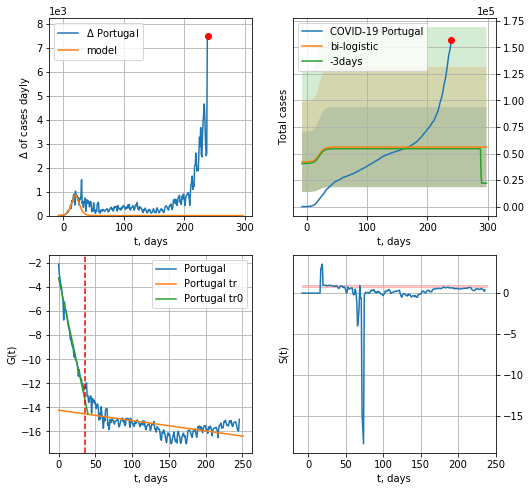

Portugal data at: 2020-11-04
+3 day model MAPE: 0.02906450338255582
model: bi-logistic
coeffs:  [ 3.36917230e+04 -1.21355622e+01  2.99410216e+02] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.6729450812318917
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  56058 ± 37724
	 total death:  962 ± 1942
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.347939
 intercept: -14.244439
 slope: -0.008620


In [4793]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,T18*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


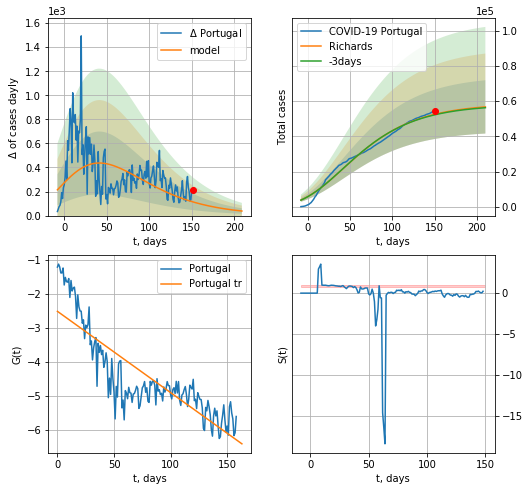

Portugal data at: 2020-11-04
+3 day model MAPE: 0.005487
model: Richards
coeffs: [ 5.85732808e+04  3.00313335e+00 -2.03470726e+02  6.78095718e-03]
rational stdev: 0.266912
forecast at the end of period: +59 days
	 deltaDaycases: 37
	 total cases: 56700 ± 15133
	 total death: 973 ± 779
trend coefficient of determination: 0.725401
 intercept: -2.517362
 slope: -0.023928


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


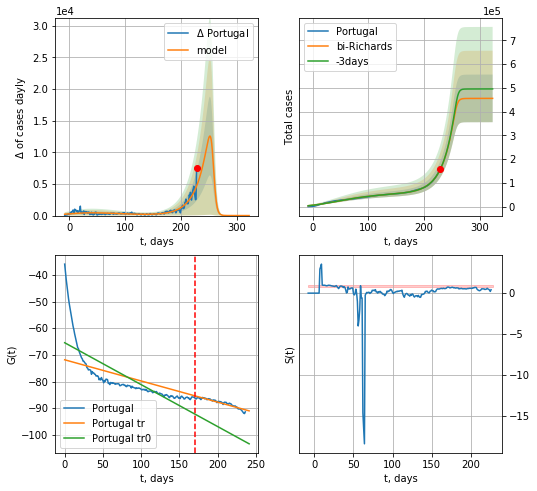

Portugal data at: 2020-11-04
+3 day model MAPE: 0.004139
model: bi-Richards
coeffs: [3.97126162e+05 4.78895061e-02 2.57980602e+02 7.38367602e+00]
rational stdev: 0.220086
forecast at the end of period: +94 days
	 deltaDaycases: 3
	 total cases: 455509 ± 100251
	 total death: 7819 ± 5162
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.610077
 intercept: -65.454827
 slope: -0.157363
trend coefficient of determination: 0.889650
 intercept: -71.851788
 slope: -0.079512


In [4794]:
iL = 10
vL=170+iL
x = forecastRR('Portugal',dfPT[iL:vL-iL],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Portugal',dfPT[iL:],d1,45*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [4795]:
#x = forecastRRR('Portugal',dfPT[:],d1,T18*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

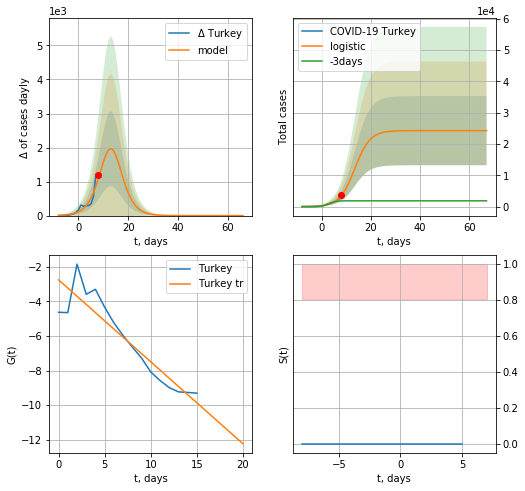

Turkey data at: 2020-11-04
+3 day model MAPE: 1.5246812178063545
model: logistic
coeffs:  [2.42671393e+04 3.25610709e-01 1.34529674e+01]
rational stdev:  0.45520285261707166
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  24267 ± 11046
	 total death:  666 ± 909
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


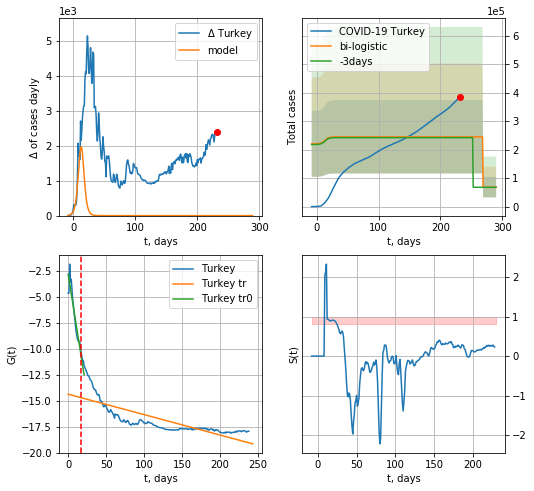

Turkey data at: 2020-11-04
+3 day model MAPE: 0.011851049184410625
model: bi-logistic
coeffs:  [ 1.76548965e+05 -8.14127609e+01  2.68661360e+02] [2.42671393e+04 3.25610709e-01 1.34529674e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.5251797388661134
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  68404 ± 35924
	 total death:  1878 ± 2958
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.599832
 intercept: -14.372830
 slope: -0.019679


In [4796]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*T18-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,T18*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


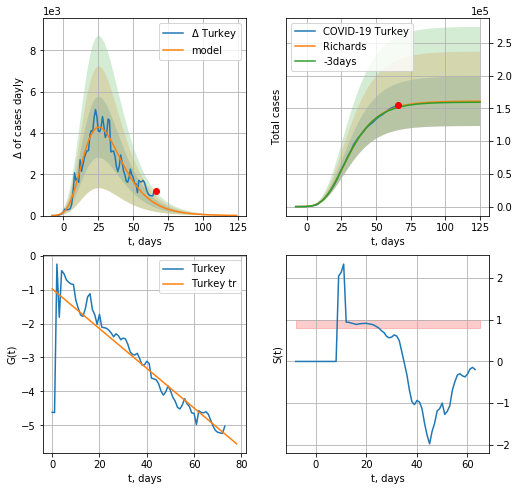

Turkey data at: 2020-11-04
+3 day model MAPE: 0.006544
model: Richards
coeffs: [ 1.61234279e+05  5.77618311e+00 -3.44308441e+01  1.25694326e-02]
rational stdev: 0.235075
forecast at the end of period: +59 days
	 deltaDaycases: 9
	 total cases: 161113 ± 37873
	 total death: 4423 ± 3119
trend coefficient of determination: 0.775259
 intercept: -0.978843
 slope: -0.058549


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


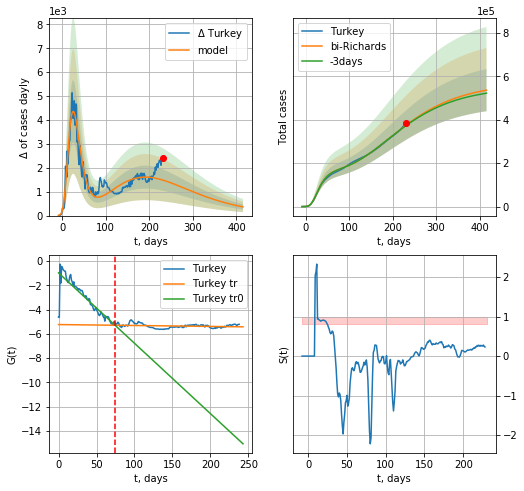

Turkey data at: 2020-11-04
+3 day model MAPE: 0.005486
model: bi-Richards
coeffs: [ 4.11090889e+05  1.09242963e+00 -2.40926395e+02  9.79540739e-03]
rational stdev: 0.180976
forecast at the end of period: +185 days
	 deltaDaycases: 364
	 total cases: 536817 ± 97151
	 total death: 14740 ± 8002
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.777430
 intercept: -0.969289
 slope: -0.057984
trend coefficient of determination: 0.047354
 intercept: -5.227755
 slope: -0.000765


In [4797]:
vL = 75
x = forecastRR('Turkey',dfTR[:vL],d1,T18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Turkey',dfTR[:],d1,58*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [4798]:
#x = forecastQR('Turkey',dfTR[:],d1,16*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

In [4799]:
#x = forecastRRR('Turkey',dfTR[:],d1,T18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [4800]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0],dfTT[dfTT.Country=='%s'%("Lithuania")][0].values[0]

(0.012588862559241706, 0.010059694892770286)

In [4801]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

PL
           date     cases  active   death
241 2020-10-31  379902.0  227524  5783.0
242 2020-11-01  395480.0  235192  5875.0
243 2020-11-02  414844.0  248756  6102.0
244 2020-11-03  439536.0  264101  6475.0
245 2020-11-04  466679.0  282156  6842.0


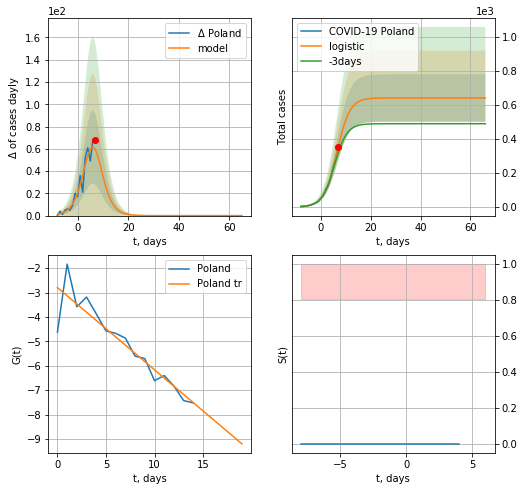

Poland data at: 2020-11-04
+3 day model MAPE: 0.14646235252259687
model: logistic
coeffs:  [6.41107575e+02 3.87606717e-01 6.46563504e+00]
rational stdev:  0.2177068805945458
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  641 ± 139
	 total death:  9 ± 5
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


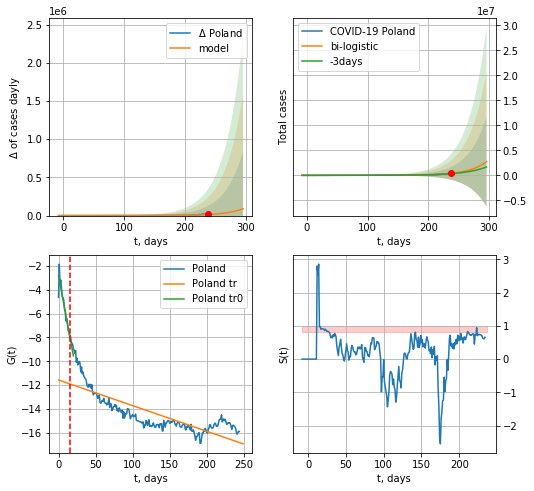

Poland data at: 2020-11-04
+3 day model MAPE: 0.1681439102871188
model: bi-logistic
coeffs:  [3.74973662e+09 3.32833915e-02 5.13031982e+02] [6.41107575e+02 3.87606717e-01 6.46563504e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  3.2863912696184356
forecast at the end of period: +59 days
	 deltaDaycases:  89381
	 total cases:  2732962 ± 8981583
	 total death:  40260 ± 396930
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.640643
 intercept: -11.570943
 slope: -0.021531


In [4983]:
vL=16
vL1=38
try:
    dfPL = read_df(pd.DataFrame(),"PL")
    x =  forecast('Poland',dfPL[:vL],d1,7*T18-dT,1.)
    xx = forecast2('Poland',dfPL[:],d1,T18*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
    #xx = np.concatenate((x, xx), axis=0)
    #xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


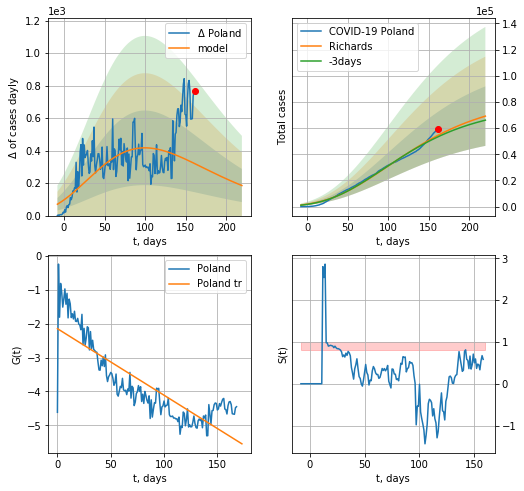

Poland data at: 2020-11-04
+3 day model MAPE: 0.021663
model: Richards
coeffs: [ 8.41741058e+04  1.47966569e+00 -2.46676717e+02  9.14859854e-03]
rational stdev: 0.328700
forecast at the end of period: +59 days
	 deltaDaycases: 185
	 total cases: 69116 ± 22718
	 total death: 1018 ± 1003
trend coefficient of determination: 0.711205
 intercept: -2.146265
 slope: -0.019650


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


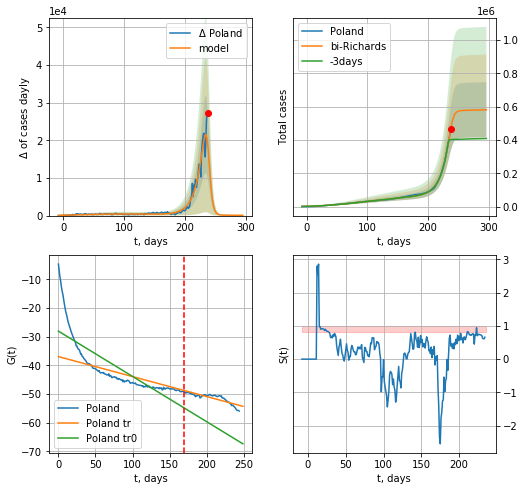

Poland data at: 2020-11-04
+3 day model MAPE: 0.196312
model: bi-Richards
coeffs: [5.03164856e+05 7.90136810e-02 2.38834139e+02 4.06674619e+00]
rational stdev: 0.285300
forecast at the end of period: +59 days
	 deltaDaycases: 75
	 total cases: 581609 ± 165933
	 total death: 8567 ± 7332
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.673938
 intercept: -28.037334
 slope: -0.157837
trend coefficient of determination: 0.734863
 intercept: -36.917276
 slope: -0.069641


In [4984]:
vL = 170
x =  forecastRR('Poland',dfPL[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx =  forecast2RR('Poland',dfPL[:],d12f(1),40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

In [3371]:
#x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
           date     cases  active   death
252 2020-10-31  314498.0   10473  2541.0
253 2020-11-01  315131.0    9800  2554.0
254 2020-11-02  315983.0    9769  2580.0
255 2020-11-03  316792.0    9782  2592.0
256 2020-11-04  317556.0    9406  2597.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


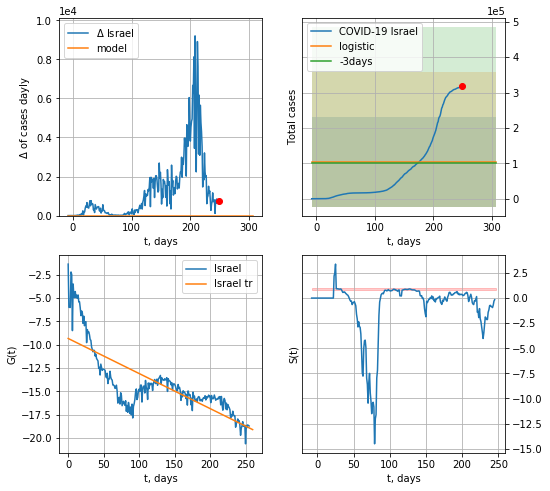

Israel data at: 2020-11-04
+3 day model MAPE: 0.03397529371841137
model: logistic
coeffs:  [ 8.37579143e+04 -3.55287526e+01  8.55884309e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.212428489359297
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  104697 ± 126938
	 total death:  856 ± 3113
trend coefficient of determination: 0.613595
 intercept: -9.337698
 slope: -0.037479


In [4803]:
dfIS = read_df(pd.DataFrame(),"IS")
try:
    x = forecast('Israel',dfIS[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print ("Exception occurs")
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


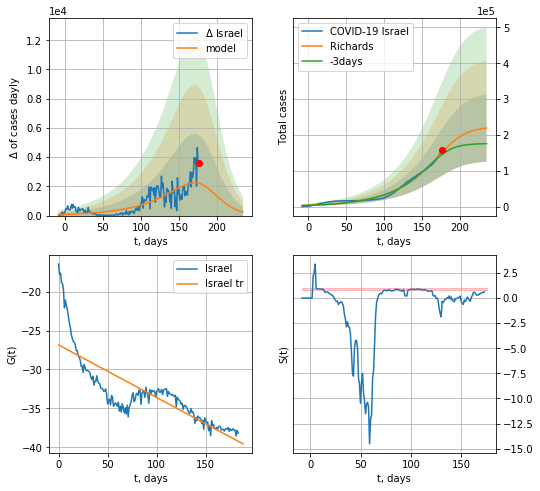

Israel data at: 2020-11-04
+3 day model MAPE: 0.043052
model: Richards
coeffs: [2.22982517e+05 2.18053289e-02 1.87753593e+02 2.87495191e+00]
rational stdev: 0.429268
forecast at the end of period: +59 days
	 deltaDaycases: 241
	 total cases: 219105 ± 94054
	 total death: 1791 ± 2306
trend coefficient of determination: 0.666990
 intercept: -26.852072
 slope: -0.067481


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


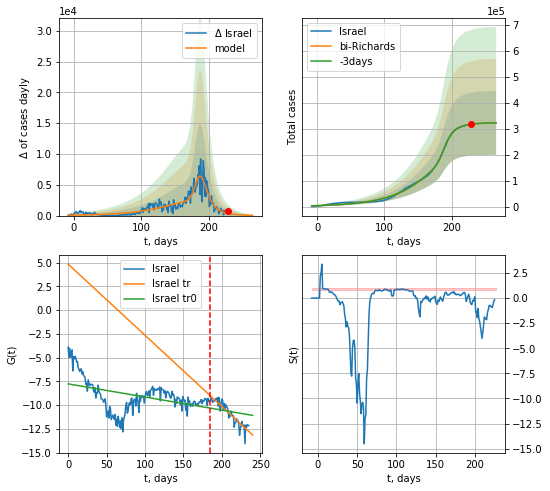

Israel data at: 2020-11-04
+3 day model MAPE: 0.000271
model: bi-Richards
coeffs: [1.00013198e+05 3.13083184e-01 1.83431552e+02 4.84957199e-01]
rational stdev: 0.381425
forecast at the end of period: +38 days
	 deltaDaycases: 36
	 total cases: 322423 ± 122980
	 total death: 2636 ± 3016
bi-Richards approximation splitting point: 185
trend coefficient of determination: 0.192598
 intercept: -7.769689
 slope: -0.013818
trend coefficient of determination: 0.833252
 intercept: 4.850739
 slope: -0.075016


In [4804]:
vL = 185+20
x = forecastRR('Israel',dfIS[20:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Israel',dfIS[20:],d1,37*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

In [4805]:
#x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

In [4806]:
#x = forecastRRR('Israel',dfIS[27:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

SZ
           date     cases  active   death
249 2020-10-31  161238.0   86754  2297.0
250 2020-11-01  168542.0   86725  2326.0
251 2020-11-02  176177.0   93373  2404.0
252 2020-11-03  182303.0   96432  2471.0
253 2020-11-04  192376.0  102721  2555.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


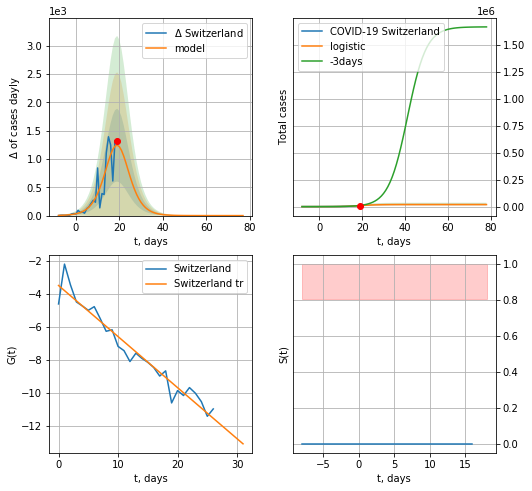

Switzerland data at: 2020-11-04
+3 day model MAPE: 0.24949882905970236
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.3060478989718857
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  18706 ± 5724
	 total death:  248 ± 227
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


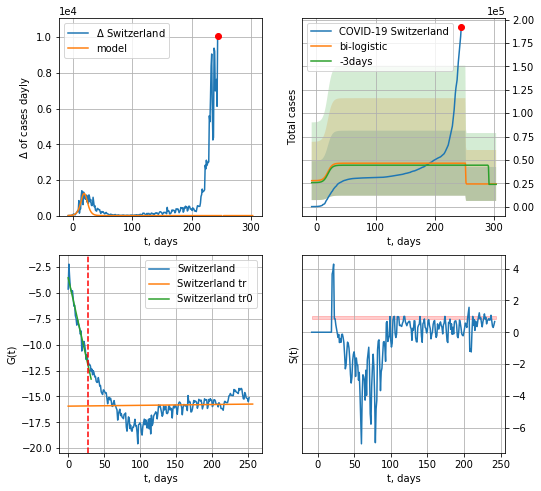

Switzerland data at: 2020-11-04
+3 day model MAPE: 0.04808407527205956
model: bi-logistic
coeffs:  [22211.65245167   -24.53656862   252.88476949] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.7488006753318335
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  24259 ± 18165
	 total death:  322 ± 723
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.001398
 intercept: -15.937397
 slope: 0.000779


In [4807]:
vL= 28
try:
    dfSZ = read_df(pd.DataFrame(),"SZ")
    x = forecast('Switzerland',dfSZ[:vL],d1,7*T18-dT)
    xx = forecast2('Switzerland',dfSZ[:],d1,7*T18-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


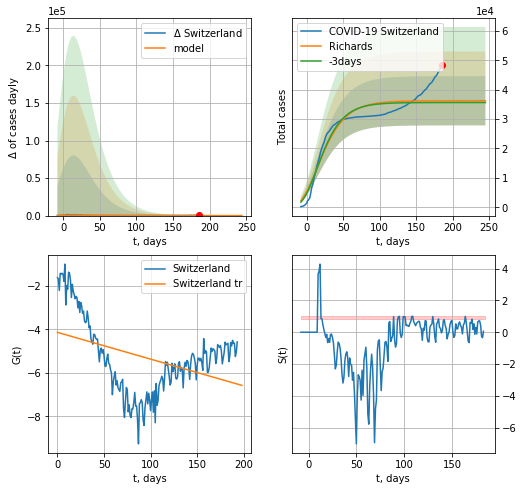

Switzerland data at: 2020-11-04
+3 day model MAPE: 0.017011
model: Richards
coeffs: [ 3.62432935e+04  1.60636037e+01 -1.13737864e+02  2.85003887e-03]
rational stdev: 0.231139
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 36242 ± 8377
	 total death: 481 ± 333
trend coefficient of determination: 0.162726
 intercept: -4.134057
 slope: -0.012335


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


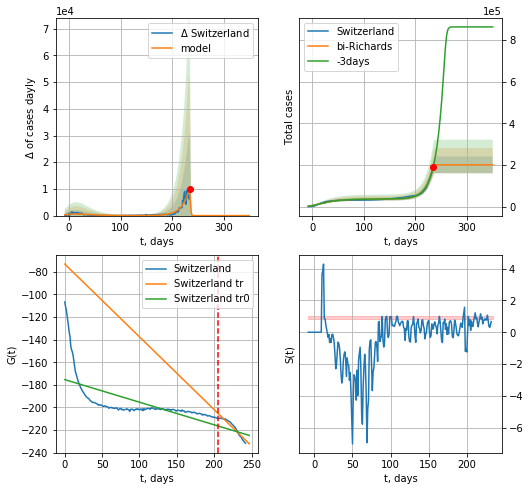

Switzerland data at: 2020-11-04
+3 day model MAPE: 0.048517
model: bi-Richards
coeffs: [1.64313376e+05 6.83113064e-02 2.35433373e+02 1.87963043e+01]
rational stdev: 0.200473
forecast at the end of period: +115 days
	 deltaDaycases: 0
	 total cases: 200556 ± 40206
	 total death: 2663 ± 1601
bi-Richards approximation splitting point: 205
trend coefficient of determination: 0.418183
 intercept: -175.368094
 slope: -0.199951
trend coefficient of determination: 0.914824
 intercept: -73.123563
 slope: -0.643997


In [4808]:
iL = 10
vL = 205 + iL#175 + iL#85 + iL
x = forecastRR('Switzerland',dfSZ[iL:vL-iL],d1,7*T18-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Switzerland',dfSZ[iL:],d12f(1),7*48-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

In [4809]:
#x = forecastRRR('Switzerland',dfSZ[:],d1,7*T18-dT,addpred=False,xcoef=koreaCoeffs)

In [4810]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
           date     cases  active   death
235 2020-10-31  395440.0  226693  7306.0
236 2020-11-01  402194.0  231051  7375.0
237 2020-11-02  411093.0  234693  7532.0
238 2020-11-03  420617.0  236482  7731.0
239 2020-11-04  430467.0  237761  7924.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


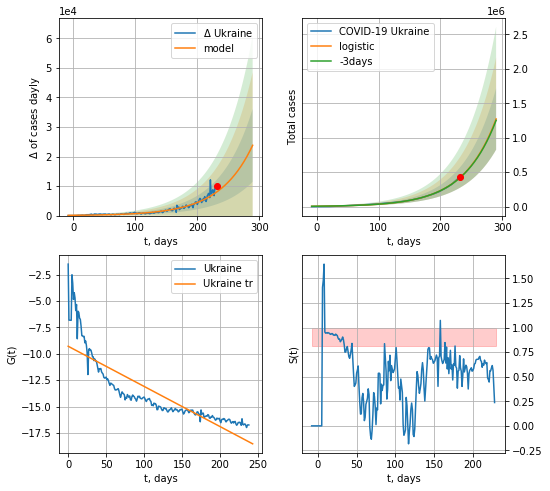

Ukraine data at: 2020-11-04
+3 day model MAPE: 0.007619860673525273
model: logistic
coeffs:  [3.84294204e+08 1.89434588e-02 5.91289400e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.34995108270196573
forecast at the end of period: +59 days
	 deltaDaycases:  23792
	 total cases:  1272053 ± 445156
	 total death:  23415 ± 24582
trend coefficient of determination: 0.729741
 intercept: -9.289088
 slope: -0.038048


In [4811]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


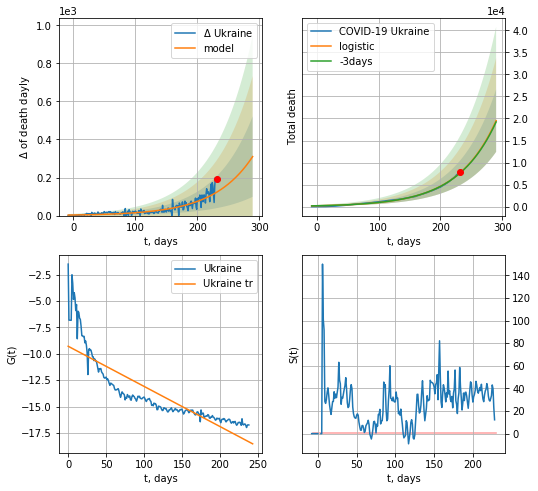

Ukraine data at: 2020-11-04
+3 day model MAPE: 0.008138400655623492
model: logistic
coeffs:  [4.79827448e+06 1.60794281e-02 6.32079993e+02]
rational stdev:  0.36315047814850693
forecast at the end of period: +59 days
	 total death:  19520 ± 7089
trend coefficient of determination: 0.729741
 intercept: -9.289088
 slope: -0.038048


In [4812]:
x=forecast('Ukraine',dfUR[:],d1,T18*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


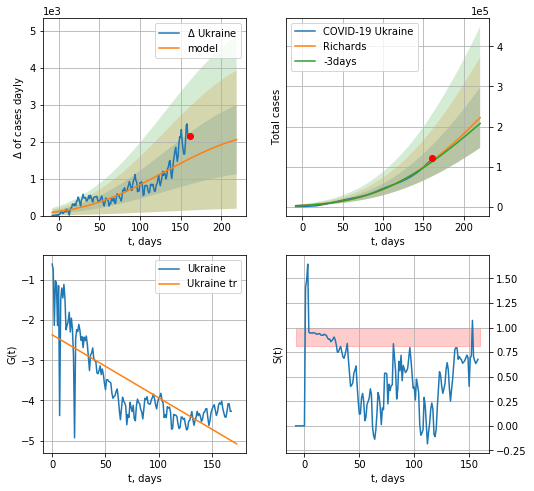

Ukraine data at: 2020-11-04
+3 day model MAPE: 0.020951
model: Richards
coeffs: [ 9.71556496e+05  3.24855332e-01 -3.33588886e+02  1.96162664e-02]
rational stdev: 0.340033
forecast at the end of period: +59 days
	 deltaDaycases: 2055
	 total cases: 222103 ± 75522
	 total death: 4088 ± 4170
trend coefficient of determination: 0.622475
 intercept: -2.366387
 slope: -0.015671


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


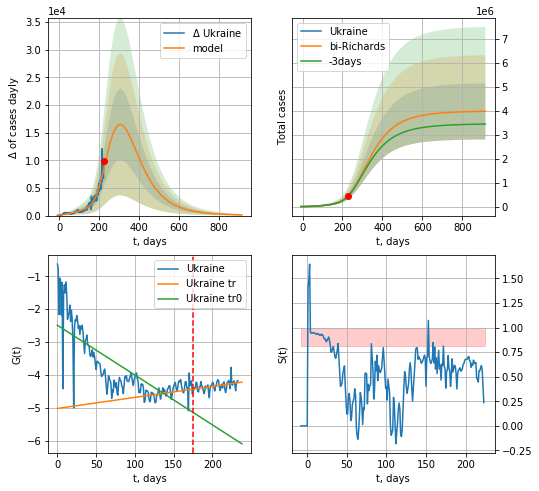

Ukraine data at: 2020-11-04
+3 day model MAPE: 0.006140
model: bi-Richards
coeffs: [3.02223132e+06 4.24496606e-01 3.94158408e+01 3.06664824e-02]
rational stdev: 0.295142
forecast at the end of period: +689 days
	 deltaDaycases: 123
	 total cases: 3975487 ± 1173333
	 total death: 73180 ± 64795
bi-Richards approximation splitting point: 175
trend coefficient of determination: 0.609913
 intercept: -2.490965
 slope: -0.015156
trend coefficient of determination: 0.165522
 intercept: -5.021632
 slope: 0.003362


In [4813]:
vL = 180#65+5 +55
x=forecastRR('Ukraine',dfUR[5:vL-5],d1,7*T18-dT,addpred=False,xcoef=RkoreaCoeffs)
xx=forecast2RR('Ukraine',dfUR[5:],d1,7*130-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

In [4814]:
#x=forecastRRR('Ukraine',dfUR[5:],d1,7*86-dT,addpred=True,xcoef=koreaCoeffs)

In [4815]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

In [4816]:
dfIN = read_df(pd.DataFrame(),"IN")
#x = forecast('Iran',dfIN[:18],d1,7*T18-dT)
#xx = forecast2('Iran',dfIN[:],d1,T18*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

IN
           date   cases  active    death
255 2020-10-31  612772   95978  34864.0
256 2020-11-01  620491   98502  35298.0
257 2020-11-02  628780  101795  35738.0
258 2020-11-03  637712  106079  36160.0
259 2020-11-04  646164  109185  36579.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


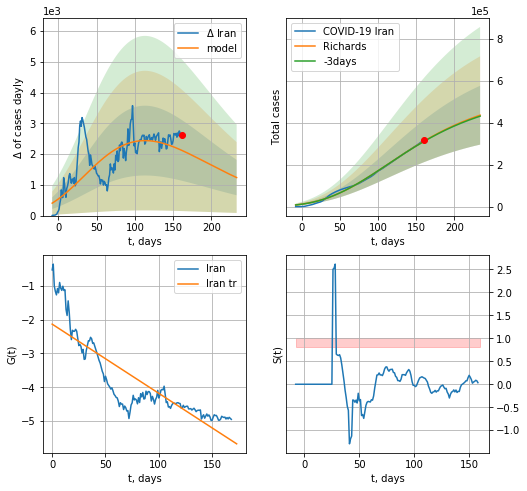

Iran data at: 2020-11-04
+3 day model MAPE: 0.004493
model: Richards
coeffs: [ 5.51823007e+05  1.04808501e+00 -2.55847777e+02  1.15235351e-02]
rational stdev: 0.321811
forecast at the end of period: +73 days
	 deltaDaycases: 1236
	 total cases: 436870 ± 140589
	 total death: 24731 ± 23876
trend coefficient of determination: 0.738838
 intercept: -2.133047
 slope: -0.020440


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


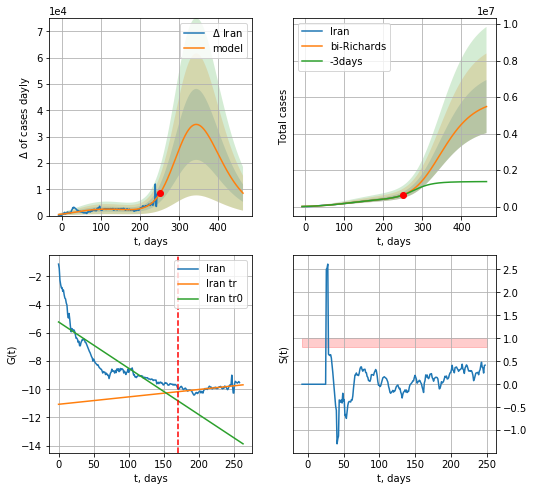

Iran data at: 2020-11-04
+3 day model MAPE: 0.006317
model: bi-Richards
coeffs: [5.36728797e+06 5.31740399e-02 2.98600502e+02 3.88209196e-01]
rational stdev: 0.265450
forecast at the end of period: +213 days
	 deltaDaycases: 8536
	 total cases: 5481751 ± 1455128
	 total death: 310319 ± 247122
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.715386
 intercept: -5.233121
 slope: -0.032825
trend coefficient of determination: 0.324512
 intercept: -11.066295
 slope: 0.005242


In [4817]:
vL = 170
x = forecastRR('Iran',dfIN[:vL],d1,42*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Iran',dfIN[:],d12f(1),62*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [4818]:
#x = forecastRRR('Iran',dfIN[:17],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR('Iran',dfIN[:],d1,66*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
           date      cases  active    death
245 2020-10-31  1618116.0  382873  28235.0
246 2020-11-01  1636781.0  390532  28473.0
247 2020-11-02  1655038.0  393494  28828.0
248 2020-11-03  1673686.0  397306  29217.0
249 2020-11-04  1693454.0  404180  29509.0


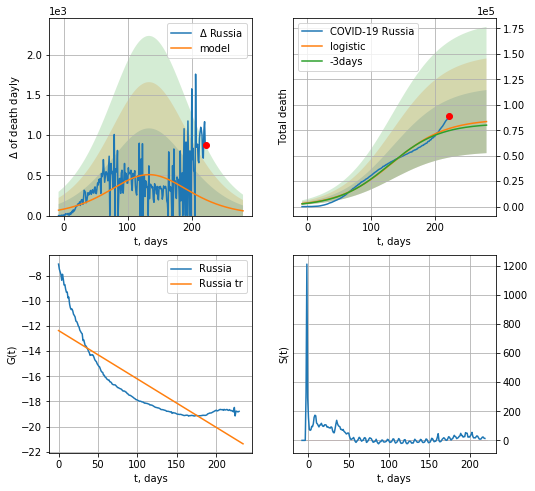

Russia data at: 2020-11-04
+3 day model MAPE: 0.02787892298355028
model: logistic
coeffs:  [8.60505567e+04 2.36691235e-02 1.33636493e+02]
rational stdev:  0.3711257027628259
forecast at the end of period: +59 days
	 total death:  83498 ± 30988
trend coefficient of determination: 0.703503
 intercept: -12.363533
 slope: -0.038509


In [4820]:
try:
    dfRS = read_df(pd.DataFrame(),"RS")
    x = forecast('Russia',dfRS[19:],d1,T18*7-dT,shift=3.,cases='death')
    #xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]
except:
    print ("Exeption occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


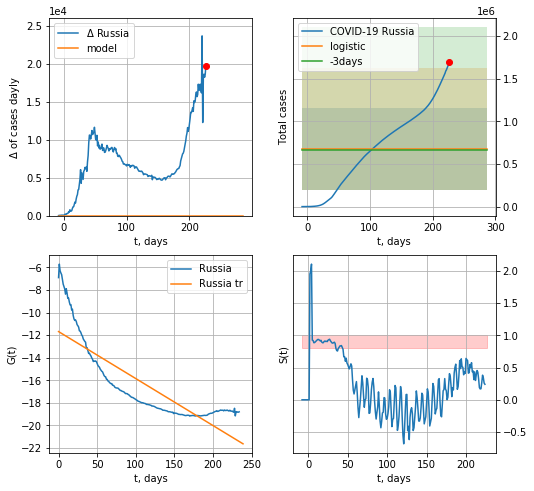

Russia data at: 2020-11-04
+3 day model MAPE: 0.019438575518288342
model: logistic
coeffs:  [ 6.74767623e+05 -1.69183716e+01  4.15218939e+02]
rational stdev:  0.7067393279813976
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  674767 ± 476884
	 total death:  11624 ± 24645
trend coefficient of determination: 0.703027
 intercept: -11.683087
 slope: -0.041616


In [4821]:
x = forecast('Russia',dfRS[14:],d1,T18*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


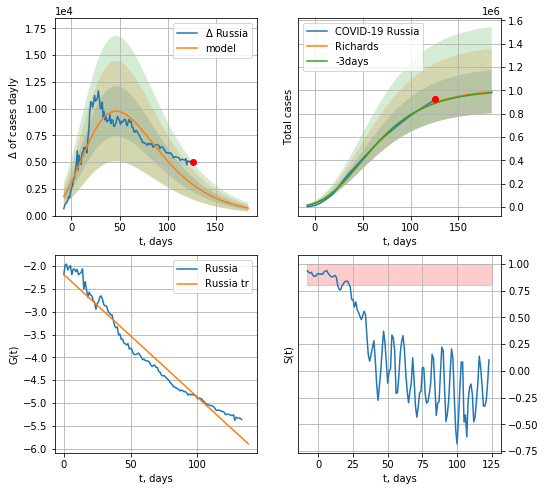

Russia data at: 2020-11-04
+3 day model MAPE: 0.005868
model: Richards
coeffs: [ 1.01532090e+06  2.66815048e+00 -1.28940873e+02  9.84509575e-03]
rational stdev: 0.186876
forecast at the end of period: +59 days
	 deltaDaycases: 700
	 total cases: 988647 ± 184754
	 total death: 17032 ± 9548
trend coefficient of determination: 0.959018
 intercept: -2.187740
 slope: -0.026848


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


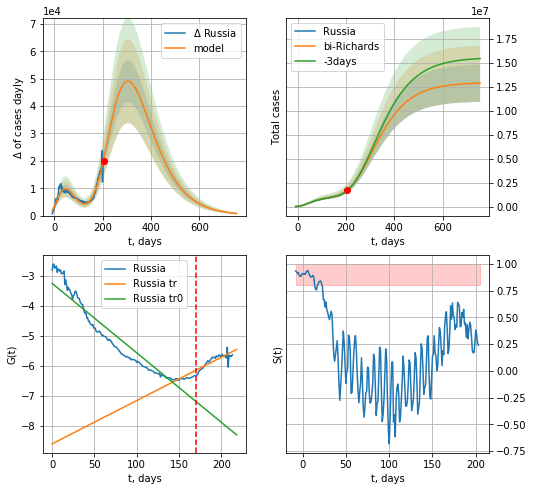

Russia data at: 2020-11-04
+3 day model MAPE: 0.002386
model: bi-Richards
coeffs: [1.19331004e+07 1.43107833e-01 9.01802868e+01 8.13459871e-02]
rational stdev: 0.151725
forecast at the end of period: +549 days
	 deltaDaycases: 743
	 total cases: 12884739 ± 1954936
	 total death: 221977 ± 101038
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.905553
 intercept: -3.240237
 slope: -0.023161
trend coefficient of determination: 0.692552
 intercept: -8.586944
 slope: 0.014433


In [4822]:
vL = 170 + 35
x = forecastRR('Russia',dfRS[35:vL-35],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
xx = forecast2RR('Russia',dfRS[35:],d1,110*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-35)
#x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

In [4823]:
#x = forecastRRR('Russia',dfRS[:],d1,68*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date     cases  active   death
283 2020-10-31  100392.0    6162  1755.0
284 2020-11-01  101146.0    6420  1766.0
285 2020-11-02  101813.0    6656  1774.0
286 2020-11-03  102281.0    6646  1780.0
287 2020-11-04  102900.0    6819  1786.0


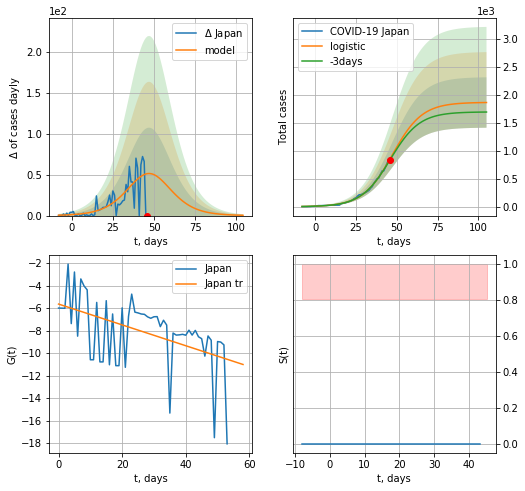

Japan data at: 2020-11-04
+3 day model MAPE: 0.024413899387998084
model: logistic
coeffs:  [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.24188431732788906
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  1863 ± 450
	 total death:  32 ± 23
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


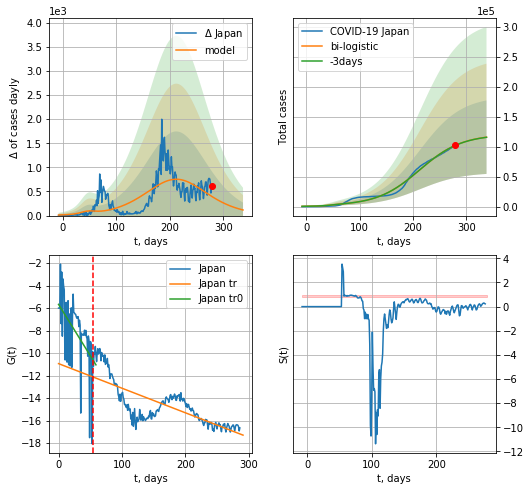

Japan data at: 2020-11-04
+3 day model MAPE: 0.0010983054141975605
model: bi-logistic
coeffs:  [1.18904842e+05 2.53635949e-02 2.12566934e+02] [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.5294219422333171
forecast at the end of period: +59 days
	 deltaDaycases:  116
	 total cases:  116030 ± 61429
	 total death:  2013 ± 3197
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.587414
 intercept: -10.940433
 slope: -0.021845


In [4824]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*T18-dT)
    xx = forecast2('Japan',dfJP[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

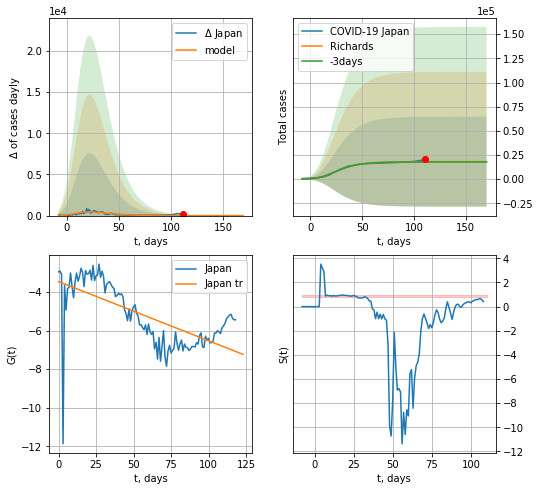

Japan data at: 2020-11-04
+3 day model MAPE: 0.014160
model: Richards
coeffs: [ 1.80899741e+04  8.76063151e-01 -1.40637335e+01  7.97075842e-02]
rational stdev: 2.570143
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 18089 ± 46492
	 total death: 313 ± 2413
trend coefficient of determination: 0.437220
 intercept: -3.449083
 slope: -0.030740


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


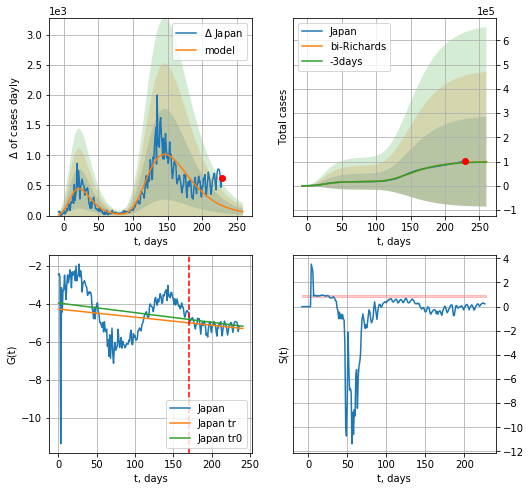

Japan data at: 2020-11-04
+3 day model MAPE: 0.011542
model: bi-Richards
coeffs: [ 8.37725197e+04  4.75216944e+00 -3.78326731e+00  6.96161654e-03]
rational stdev: 1.853304
forecast at the end of period: +31 days
	 deltaDaycases: 64
	 total cases: 99933 ± 185206
	 total death: 1734 ± 9640
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.033884
 intercept: -3.966431
 slope: -0.005071
trend coefficient of determination: 0.095376
 intercept: -4.286686
 slope: -0.004239


In [4825]:
iL = 50
vL = 170+iL
x = forecastRR('Japan',dfJP[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Japan',dfJP[iL:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [4826]:
#x = forecastRRR('Japan',dfJP[54:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

NL
           date     cases  active   death
247 2020-10-31  351178.0       0  7395.0
248 2020-11-01  359861.0       0  7434.0
249 2020-11-02  368147.0       0  7463.0
250 2020-11-03  375890.0       0  7576.0
251 2020-11-04  383523.0       0  7682.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


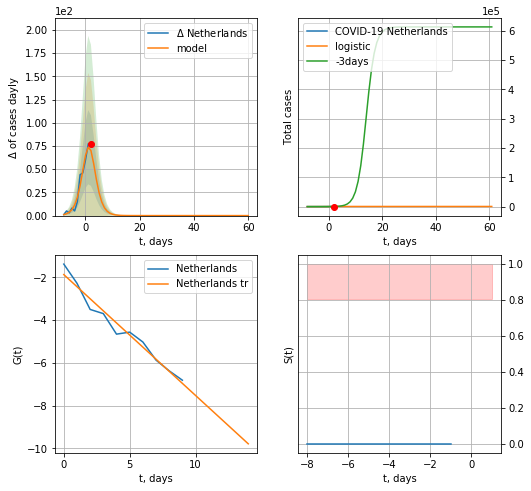

Netherlands data at: 2020-11-04
model: logistic
coeffs:  [487.7470779    0.61204075   1.72557626]
rational stdev:  0.23761281134430468
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  487 ± 115
	 total death:  9 ± 6
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


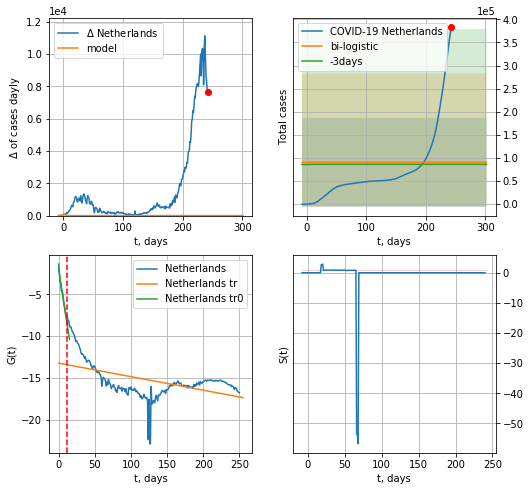

Netherlands data at: 2020-11-04
+3 day model MAPE: 0.052963161781777256
model: bi-logistic
coeffs:  [ 7.22219963e+04 -1.41879144e+01  3.66629543e+02] [487.7470779    0.61204075   1.72557626]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.0579123748267603
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  90765 ± 96021
	 total death:  1818 ± 5769
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.257842
 intercept: -13.214901
 slope: -0.016162


In [4827]:
vL=11
vL1=32
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[:vL],d1,T18*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


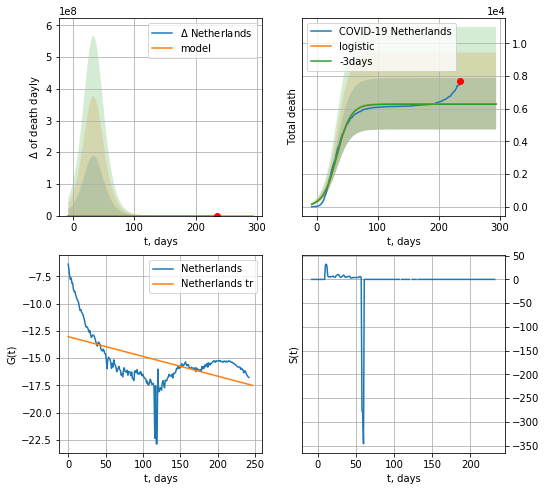

Netherlands data at: 2020-11-04
+3 day model MAPE: 0.003989426019526454
model: logistic
coeffs:  [6.29939842e+03 8.94268620e-02 3.36048059e+01]
rational stdev:  0.24943203712850098
forecast at the end of period: +59 days
	 total death:  6299 ± 1571
trend coefficient of determination: 0.284538
 intercept: -13.029166
 slope: -0.018107


In [4828]:
x = forecast('Netherlands',dfNL[8:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


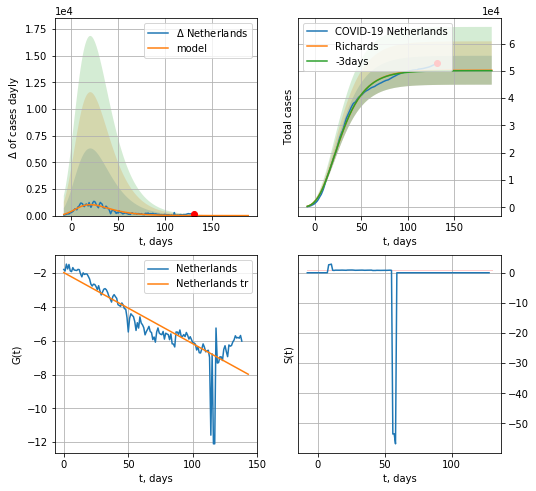

Netherlands data at: 2020-11-04
+3 day model MAPE: 0.003437
model: Richards
coeffs: [ 5.02415869e+04  8.73155449e+00 -6.99416502e+01  6.38067202e-03]
rational stdev: 0.105306
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 50237 ± 5290
	 total death: 1006 ± 317
trend coefficient of determination: 0.744376
 intercept: -1.967578
 slope: -0.042068


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


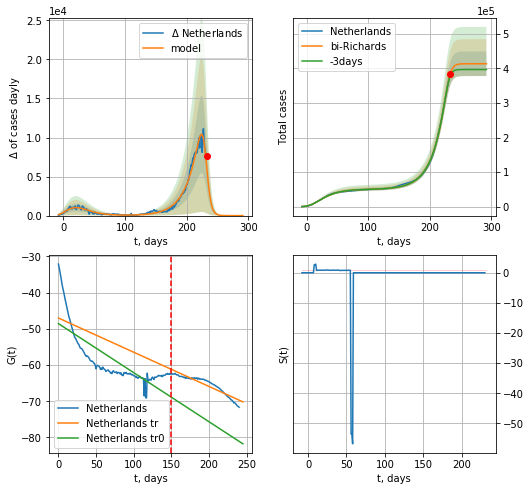

Netherlands data at: 2020-11-04
+3 day model MAPE: 0.017040
model: bi-Richards
coeffs: [3.63278721e+05 4.83375638e-02 2.31043811e+02 5.26871538e+00]
rational stdev: 0.085905
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 413520 ± 35523
	 total death: 8282 ± 2134
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.618013
 intercept: -48.575508
 slope: -0.135392
trend coefficient of determination: 0.873640
 intercept: -47.028286
 slope: -0.094436


In [4829]:
iL = 10
vL = 150+iL
x = forecastRR('Netherlands',dfNL[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Netherlands',dfNL[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [4830]:
#x = forecastQR('Netherlands',dfNL[7:],d1,16*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


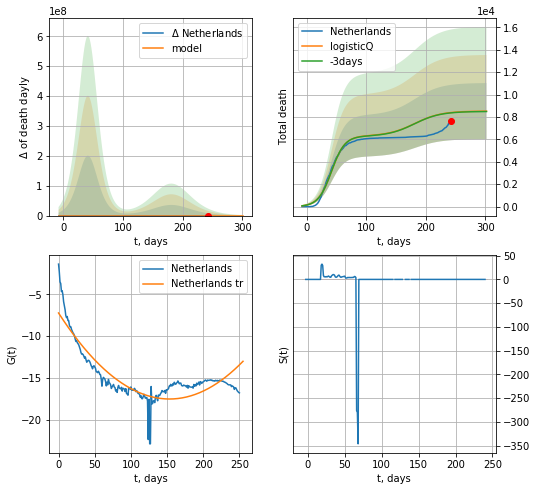

Netherlands data at: 2020-11-04
+3 day model MAPE: 0.003133
model: logisticQ
coeffs: [ 6.29860131e+03  1.84268124e-07  4.16071892e+01 -4.87084591e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.294259
forecast at the end of period: +59 days
	 total death: 8519 ± 2507
trend coefficient of determination: 0.781127
 intercept_: -7.2264282792399115
 coeffs_: [ 0.         -0.13397467  0.00043664]


In [4831]:
#x = forecastRRR('Netherlands',dfNL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [4832]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

AT
           date     cases  active   death
248 2020-10-31  104925.0   36590  1109.0
249 2020-11-01  114016.0   41166  1159.0
250 2020-11-02  116088.0   41166  1159.0
251 2020-11-03  118198.0   42714  1192.0
252 2020-11-04  125099.0   46836  1227.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:86: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:195: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


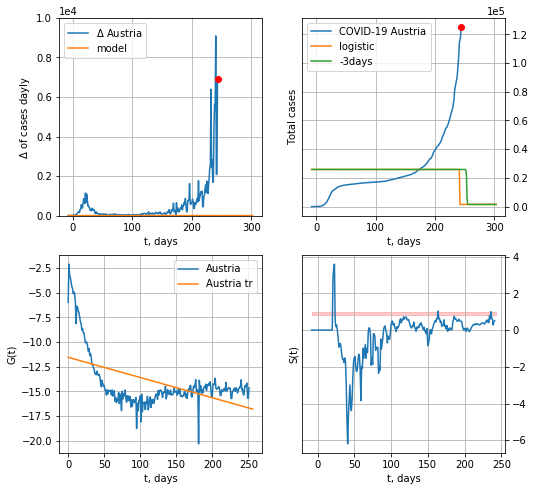

Austria data at: 2020-11-04
+3 day model MAPE: 0.9411764704231934
model: logistic
coeffs:  [24341.18412567  -144.95668743   241.42092292]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  inf
forecast at the end of period: +59 days
	 deltaDaycases:  0
Exception occurs


/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:195: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)


In [4833]:
dfAT = read_df(pd.DataFrame(),"AT")
try:
    x = forecast('Austria',dfAT[:],d1,7*T18-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
except:
    print ("Exception occurs")
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


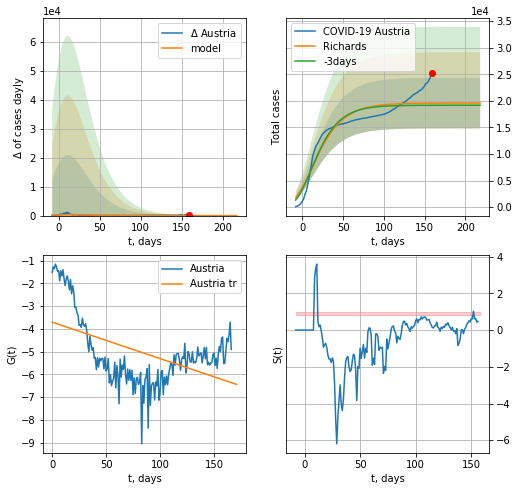

Austria data at: 2020-11-04
+3 day model MAPE: 0.021066
model: Richards
coeffs: [ 1.95969018e+04  1.90827911e+01 -1.19732201e+02  2.40902532e-03]
rational stdev: 0.243717
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 19595 ± 4775
	 total death: 192 ± 140
trend coefficient of determination: 0.252400
 intercept: -3.709727
 slope: -0.015997


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


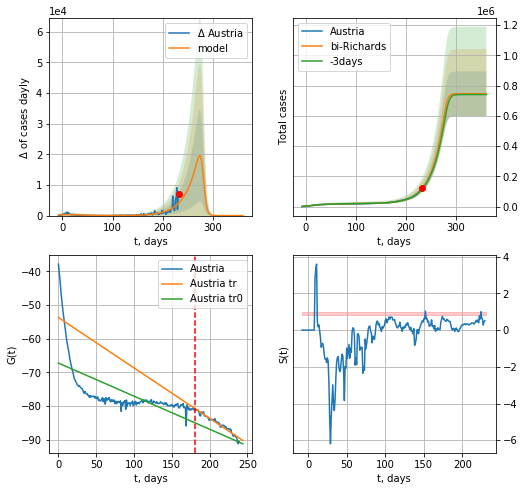

Austria data at: 2020-11-04
+3 day model MAPE: 0.035018
model: bi-Richards
coeffs: [7.26641894e+05 4.07124996e-02 2.81116108e+02 7.45558672e+00]
rational stdev: 0.197359
forecast at the end of period: +129 days
	 deltaDaycases: 0
	 total cases: 746238 ± 147276
	 total death: 7319 ± 4333
bi-Richards approximation splitting point: 180
trend coefficient of determination: 0.419990
 intercept: -67.198304
 slope: -0.098173
trend coefficient of determination: 0.949900
 intercept: -53.686601
 slope: -0.149519


In [4834]:
vL=180+12
x = forecastRR('Austria',dfAT[12:vL-12],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Austria',dfAT[12:],d12f(1),50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

In [4835]:
#vL = 68
#x = forecastRRR('Austria',dfAT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

BG
           date     cases  active    death
244 2020-10-31  429229.0  392035  11625.0
245 2020-11-01  441018.0  403462  11737.0
246 2020-11-02  447355.0  409498  11858.0
247 2020-11-03  452541.0  413754  12126.0
248 2020-11-04  468213.0  428548  12331.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


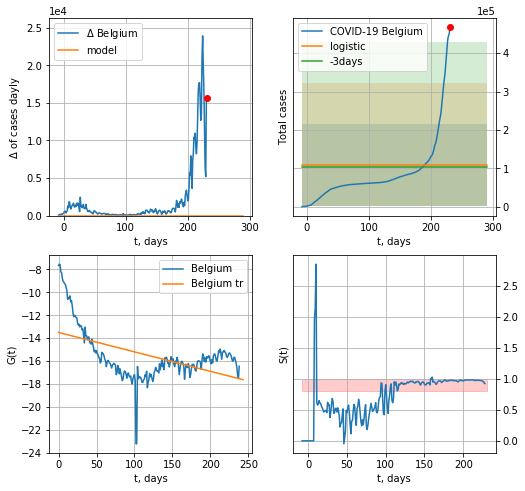

Belgium data at: 2020-11-04
+3 day model MAPE: 0.05706918937837744
model: logistic
coeffs:  [ 8.66155623e+04 -2.11554716e+01  5.68604625e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.9836598410057524
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  108269 ± 106500
	 total death:  2851 ± 8413
trend coefficient of determination: 0.260635
 intercept: -13.500574
 slope: -0.016974


In [4836]:
vL=9
try:
    dfBG = read_df(pd.DataFrame(),"BG")
    x = forecast('Belgium',dfBG[vL:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,3.])
    #xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

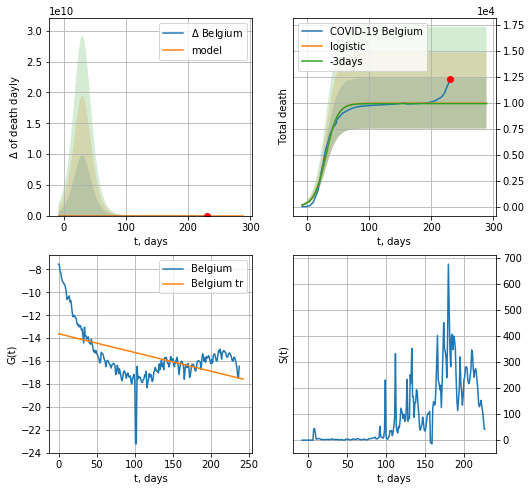

Belgium data at: 2020-11-04
+3 day model MAPE: 0.004136362764426268
model: logistic
coeffs:  [9.95866476e+03 1.06481946e-01 3.06360609e+01]
rational stdev:  0.24567272980687252
forecast at the end of period: +59 days
	 total death:  9958 ± 2446
trend coefficient of determination: 0.251279
 intercept: -13.615900
 slope: -0.016351


In [4837]:
#dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


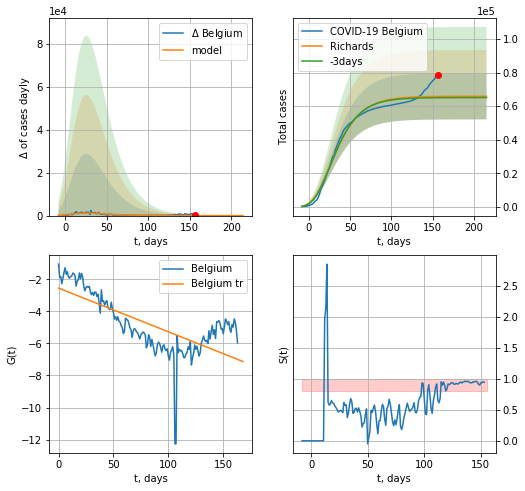

Belgium data at: 2020-11-04
+3 day model MAPE: 0.011690
model: Richards
coeffs: [ 6.59502350e+04  1.16564107e+01 -8.64901843e+01  4.18089404e-03]
rational stdev: 0.209120
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 65943 ± 13790
	 total death: 1736 ± 1089
trend coefficient of determination: 0.496391
 intercept: -2.551765
 slope: -0.027253


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


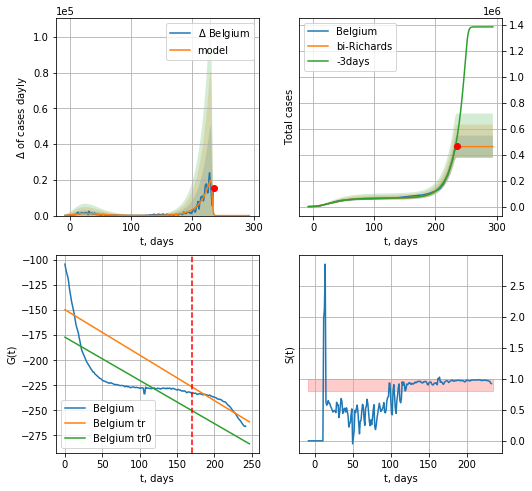

Belgium data at: 2020-11-04
+3 day model MAPE: 0.163500
model: bi-Richards
coeffs: [3.95892933e+05 6.14027035e-02 2.32593677e+02 2.00906875e+01]
rational stdev: 0.184039
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 461843 ± 84997
	 total death: 12163 ± 6715
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.533959
 intercept: -176.986252
 slope: -0.430578
trend coefficient of determination: 0.860314
 intercept: -149.542731
 slope: -0.452941


In [4838]:
iL = 5
vL = 170+ iL
x = forecastRR('Belgium',dfBG[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Belgium',dfBG[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [4839]:
#x = forecastRRR('Belgium',dfBG[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

In [4840]:
dfBZ.tail()

,date,cases,active,death
249,2020-10-31,5535605.0,402805,159902.0
250,2020-11-01,5545705.0,404659,160104.0
251,2020-11-02,5554206.0,412992,160272.0
252,2020-11-03,5567126.0,378362,160548.0
253,2020-11-04,5590941.0,365427,161170.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


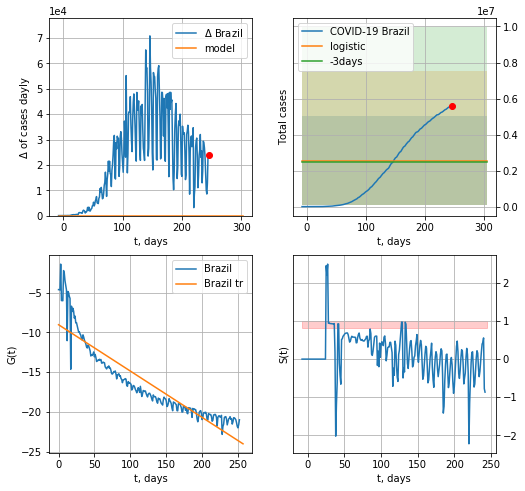

Brazil data at: 2020-11-04
+3 day model MAPE: 0.021098322559638148
model: logistic
coeffs:  [ 2.04150337e+06 -3.58285262e+01  8.54452776e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.9699498577286741
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  2551879 ± 2475194
	 total death:  73562 ± 214054
trend coefficient of determination: 0.835930
 intercept: -9.038865
 slope: -0.058287


In [4841]:
x = forecast('Brazil',dfBZ[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


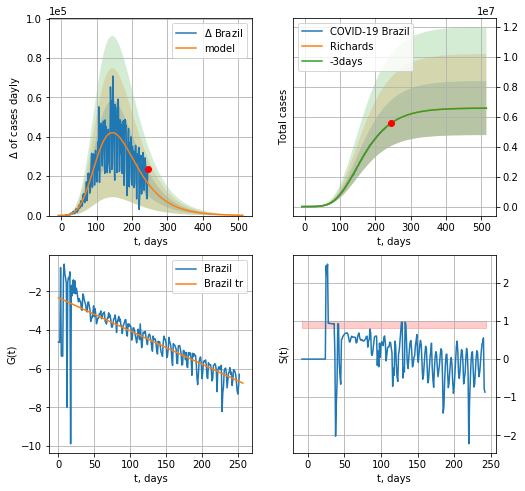

Brazil data at: 2020-11-04
+3 day model MAPE: 0.000557
model: Richards
coeffs: [ 6.58121210e+06  3.33043814e-01 -1.90750672e+01  5.36228854e-02]
rational stdev: 0.274191
forecast at the end of period: +269 days
	 deltaDaycases: 162
	 total cases: 6572214 ± 1802039
	 total death: 189457 ± 155842
trend coefficient of determination: 0.685515
 intercept: -2.318706
 slope: -0.017232


In [4842]:
x = forecastRR('Brazil',dfBZ[:],d1,70*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

In [4843]:
#x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [4844]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date    cases  active  death
259 2020-10-31  27595.0    1352  907.0
260 2020-11-01  27601.0    1344  907.0
261 2020-11-02  27608.0    1345  907.0
262 2020-11-03  27620.0    1319  907.0
263 2020-11-04  27634.0    1307  907.0


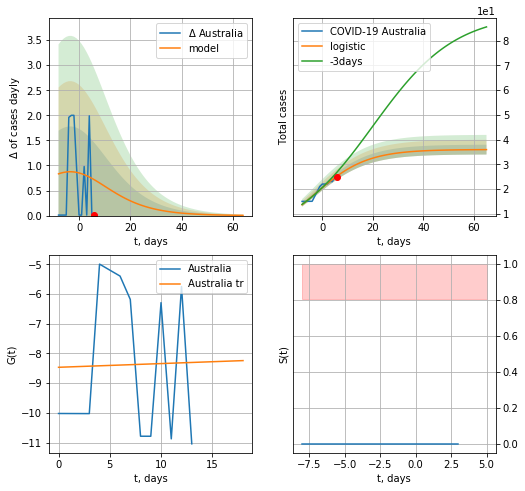

Australia data at: 2020-11-04
model: logistic
coeffs:  [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.05518162900834631
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  35 ± 1
	 total death:  1 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


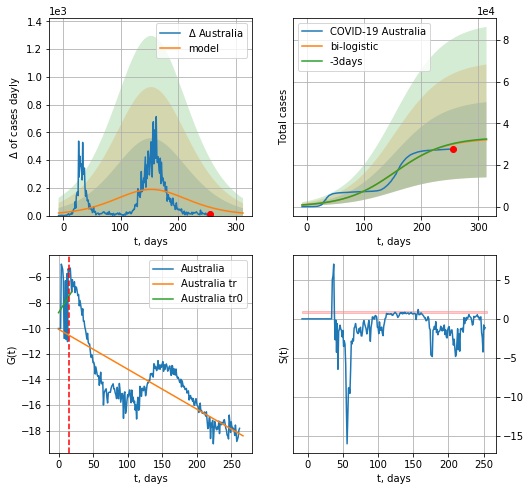

Australia data at: 2020-11-04
+3 day model MAPE: 0.008284130763410103
model: bi-logistic
coeffs:  [3.28598644e+04 2.29922412e-02 1.53584088e+02] [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.5624110797713159
forecast at the end of period: +59 days
	 deltaDaycases:  18
	 total cases:  32093 ± 18049
	 total death:  1053 ± 1776
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.582823
 intercept: -10.078590
 slope: -0.031166


In [4845]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,T18*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,T18*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


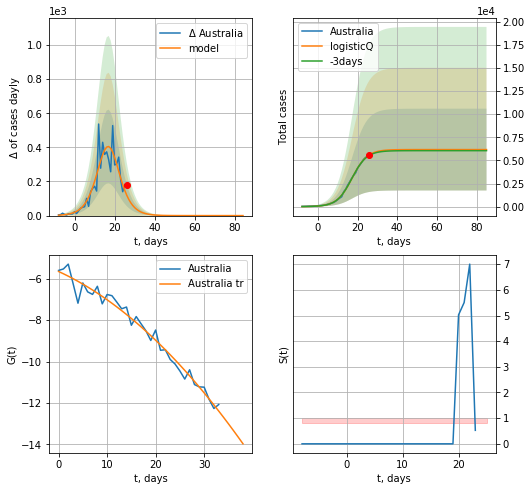

Australia data at: 2020-11-04
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16826027e+03  4.63150668e-05  1.72354354e+01 -5.67232010e+03]
rational stdev: 0.716727
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 6168 ± 4420
	 total death: 202 ± 434
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


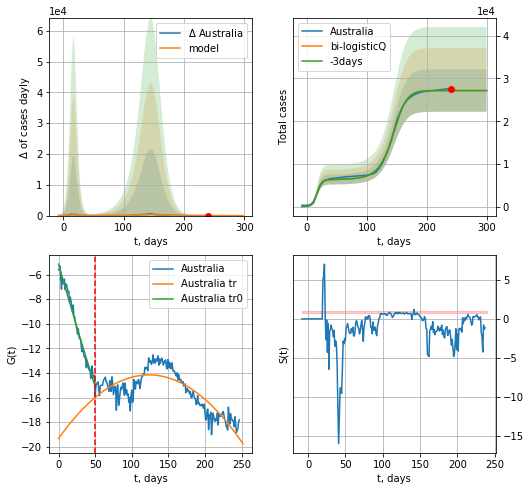

Australia data at: 2020-11-04
+3 day model MAPE: 0.000862
model: bi-logisticQ
coeffs: [ 2.10130121e+04  3.73294148e-04  1.43004026e+02 -8.28045471e+01]
rational stdev: 0.182451
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 27181 ± 4959
	 total death: 892 ± 488
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.696602
 intercept_: -19.329296605331027
 coeffs_: [ 0.          0.0837888  -0.00033928]


In [4846]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,T18*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


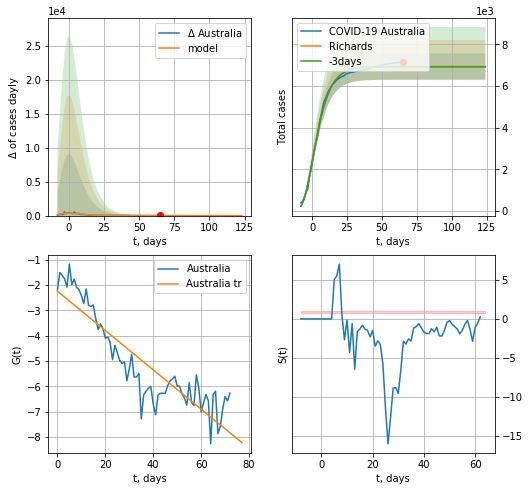

Australia data at: 2020-11-04
+3 day model MAPE: 0.002782
model: Richards
coeffs: [ 6.93376739e+03  1.41182137e+01 -3.14466269e+01  1.01384170e-02]
rational stdev: 0.091309
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 6933 ± 633
	 total death: 227 ± 62
trend coefficient of determination: 0.809708
 intercept: -2.241214
 slope: -0.077557


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


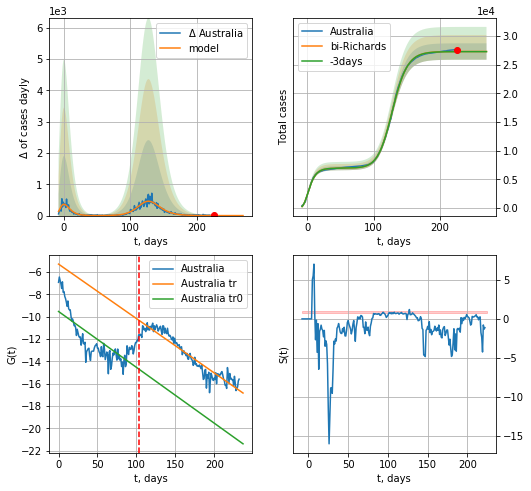

Australia data at: 2020-11-04
+3 day model MAPE: 0.000851
model: bi-Richards
coeffs: [2.03724151e+04 1.07418638e-01 1.24561492e+02 7.81964612e-01]
rational stdev: 0.052449
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 27306 ± 1432
	 total death: 896 ± 140
bi-Richards approximation splitting point: 104
trend coefficient of determination: 0.544511
 intercept: -9.525864
 slope: -0.050006
trend coefficient of determination: 0.902563
 intercept: -5.282871
 slope: -0.048714


In [4847]:
iL = 20+10
vL = 104+iL
x = forecastRR('Australia',dfAS[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Australia',dfAS[iL:],d1,38*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

ML
           date    cases  active  death
247 2020-10-31  32505.0   10036  249.0
248 2020-11-01  33339.0    9968  251.0
249 2020-11-02  34393.0   10135  263.0
250 2020-11-03  35425.0   10339  271.0
251 2020-11-04  36434.0   10503  277.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


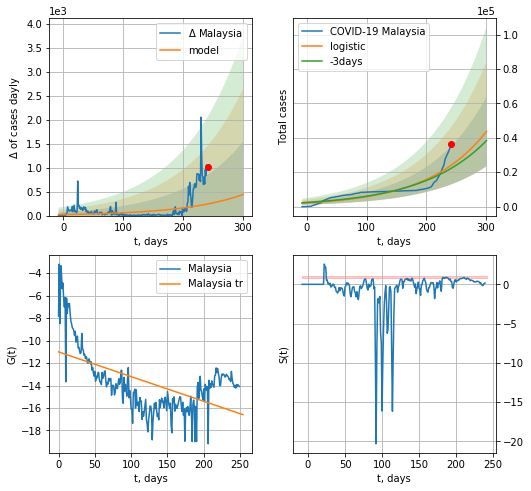

Malaysia data at: 2020-11-04
+3 day model MAPE: 0.08177399585035937
model: logistic
coeffs:  [1.75124467e+08 1.01044218e-02 1.12193298e+03]
rational stdev:  0.46290610057775466
forecast at the end of period: +59 days
	 deltaDaycases:  439
	 total cases:  43726 ± 20241
	 total death:  334 ± 463
trend coefficient of determination: 0.318041
 intercept: -11.011890
 slope: -0.021971


In [4985]:
try:
    dfML = read_df(pd.DataFrame(),"ML")
    x = forecast('Malaysia',dfML[1:],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


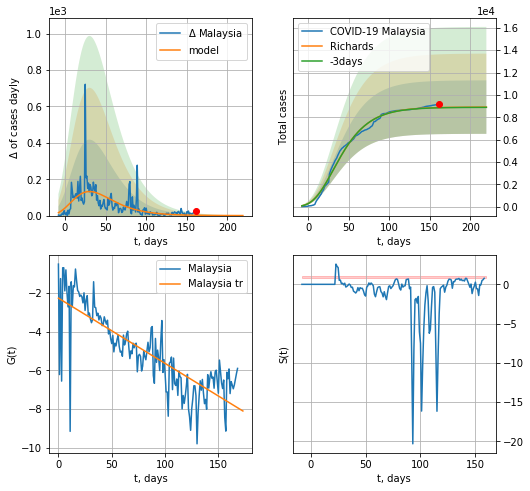

Malaysia data at: 2020-11-04
+3 day model MAPE: 0.002240
model: Richards
coeffs: [ 8.90988900e+03  9.44653085e+00 -1.04060324e+02  4.28353192e-03]
rational stdev: 0.268624
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 8905 ± 2392
	 total death: 68 ± 54
trend coefficient of determination: 0.661509
 intercept: -2.276525
 slope: -0.033689


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


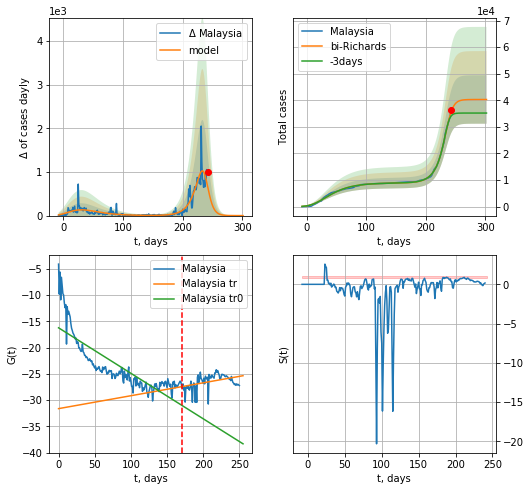

Malaysia data at: 2020-11-04
+3 day model MAPE: 0.059592
model: bi-Richards
coeffs: [3.13876952e+04 7.96334769e-02 2.37939805e+02 2.25130918e+00]
rational stdev: 0.225944
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 40297 ± 9104
	 total death: 308 ± 208
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.679223
 intercept: -16.249899
 slope: -0.086545
trend coefficient of determination: 0.168954
 intercept: -31.626607
 slope: 0.024556


In [4986]:
vL = 170
x = forecastRR('Malaysia',dfML[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Malaysia',dfML[:],d12f(1),40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [3049]:
#x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
           date   cases  active  death
246 2020-10-31  1959.0      77   25.0
247 2020-11-01  1963.0      81   25.0
248 2020-11-02  1968.0      75   25.0
249 2020-11-03  1971.0      73   25.0
250 2020-11-04  1973.0      67   25.0


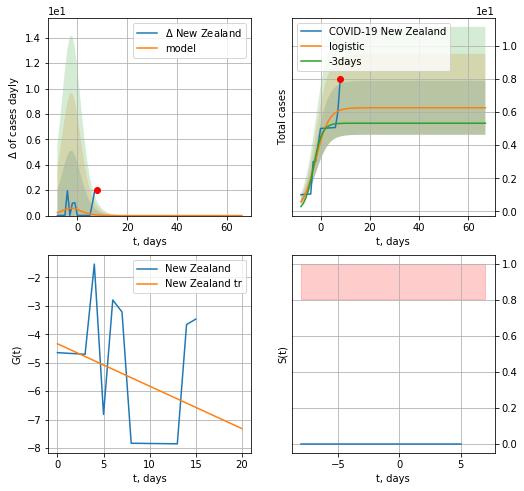

New Zealand data at: 2020-11-04
model: logistic
coeffs:  [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.26005250706023997
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


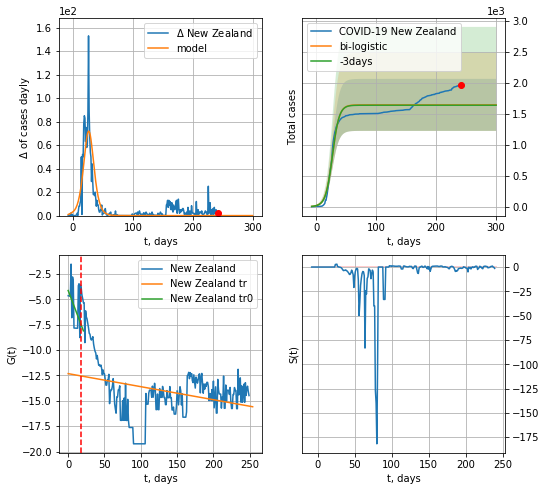

New Zealand data at: 2020-11-04
+3 day model MAPE: 0.0032074984235258997
model: bi-logistic
coeffs:  [1.64021971e+03 1.75587703e-01 2.68239656e+01] [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.2553817744934477
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  1646 ± 420
	 total death:  20 ± 15
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.089264
 intercept: -12.322463
 slope: -0.012844


In [4849]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,T18*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

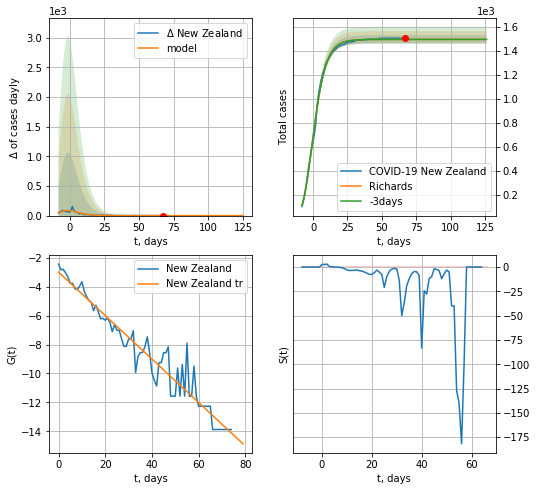

New Zealand data at: 2020-11-04
+3 day model MAPE: 0.000505
model: Richards
coeffs: [ 1.49487953e+03  6.79159620e-01 -8.03485752e+00  2.67314239e-01]
rational stdev: 0.023076
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 1494 ± 34
	 total death: 18 ± 1
trend coefficient of determination: 0.938641
 intercept: -2.993592
 slope: -0.150300


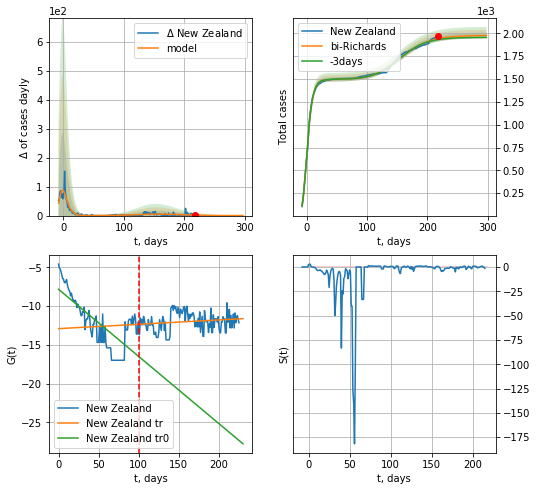

New Zealand data at: 2020-11-04
+3 day model MAPE: 0.005528
model: bi-Richards
coeffs: [4.83942547e+02 5.63008278e-02 1.44191416e+02 6.93282994e-01]
rational stdev: 0.015769
forecast at the end of period: +80 days
	 deltaDaycases: 0
	 total cases: 1977 ± 31
	 total death: 25 ± 1
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.550103
 intercept: -7.837765
 slope: -0.086659
trend coefficient of determination: 0.029342
 intercept: -12.910879
 slope: 0.005609


In [4850]:
iL = 24
vL = 100+iL
x = forecastRR('New Zealand',dfZL[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('New Zealand',dfZL[iL:],d12f(1),43*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [4851]:
#x = forecastRRR('New Zealand',dfZL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

In [4852]:
dfBR = read_df(pd.DataFrame(),"BR")
#x = forecast('Belarus',dfBR[:35],d1,7*T18-dT)
#xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
           date     cases  active  death
246 2020-10-31   98482.0   11286  985.0
247 2020-11-01   99459.0   11286  985.0
248 2020-11-02  100400.0   12011  989.0
249 2020-11-03  101329.0   12352  992.0
250 2020-11-04  102313.0   12617  995.0


BR
           date     cases  active  death
246 2020-10-31   98482.0   11286  985.0
247 2020-11-01   99459.0   11286  985.0
248 2020-11-02  100400.0   12011  989.0
249 2020-11-03  101329.0   12352  992.0
250 2020-11-04  102313.0   12617  995.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


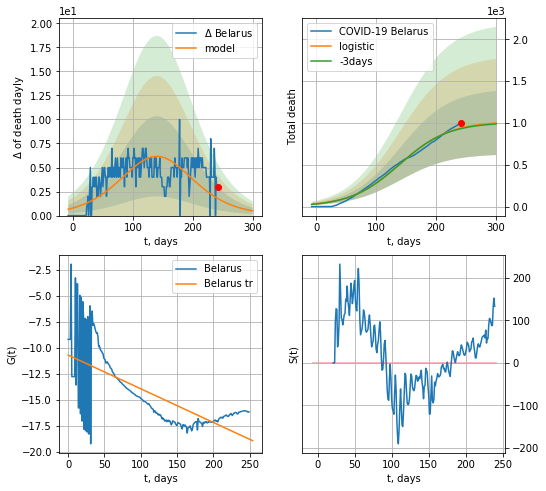

Belarus data at: 2020-11-04
+3 day model MAPE: 0.008370671698218217
model: logistic
coeffs:  [1.01993999e+03 2.41712880e-02 1.40250383e+02]
rational stdev:  0.38314492193082345
forecast at the end of period: +59 days
	 total death:  999 ± 382
trend coefficient of determination: 0.490647
 intercept: -10.723986
 slope: -0.032416


In [4853]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


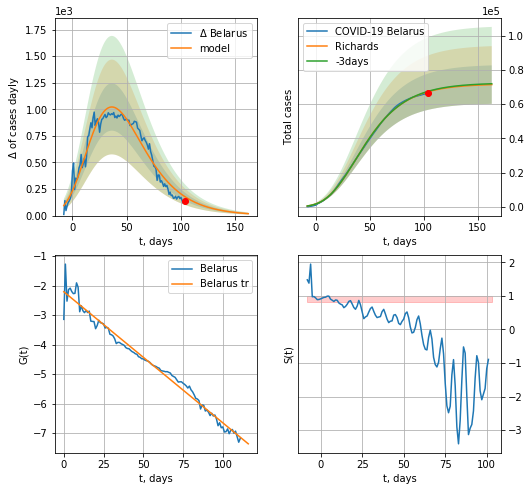

Belarus data at: 2020-11-04
+3 day model MAPE: 0.003761
model: Richards
coeffs: [ 7.18037592e+04  4.57951913e-01 -2.34141452e+01  8.81440501e-02]
rational stdev: 0.157351
forecast at the end of period: +59 days
	 deltaDaycases: 17
	 total cases: 71365 ± 11229
	 total death: 694 ± 327
trend coefficient of determination: 0.978684
 intercept: -2.208926
 slope: -0.044428


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


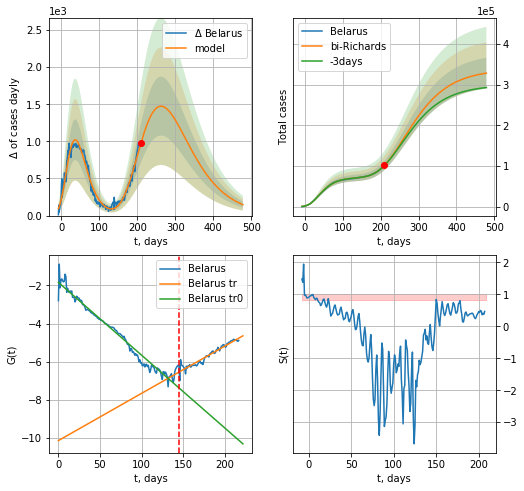

Belarus data at: 2020-11-04
+3 day model MAPE: 0.003617
model: bi-Richards
coeffs: [2.66653139e+05 7.38930410e-01 6.78157394e+00 2.05442861e-02]
rational stdev: 0.115329
forecast at the end of period: +269 days
	 deltaDaycases: 147
	 total cases: 328646 ± 37902
	 total death: 3196 ± 1105
bi-Richards approximation splitting point: 145
trend coefficient of determination: 0.967332
 intercept: -1.844529
 slope: -0.038077
trend coefficient of determination: 0.924937
 intercept: -10.127308
 slope: 0.024707


In [4854]:
iL=32
vL = 145+iL
x = forecastRR('Belarus',dfBR[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Belarus',dfBR[iL:],d1,70*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastRRR('Belarus',dfBR[iL:],d1,30*7-dT,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


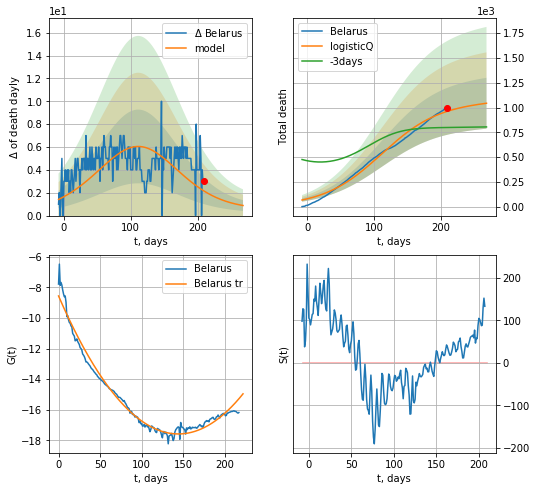

Belarus data at: 2020-11-04
+3 day model MAPE: 0.206123
model: logisticQ
coeffs: [ 1.03759024e+03  3.21272879e-06  1.10224435e+02 -7.07351566e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.245954
forecast at the end of period: +59 days
	 total death: 1043 ± 256
trend coefficient of determination: 0.976810
 intercept_: -8.566842045681362
 coeffs_: [ 0.         -0.12497826  0.00043326]


In [4855]:
x = forecastRRR('Belarus',dfBR[32:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

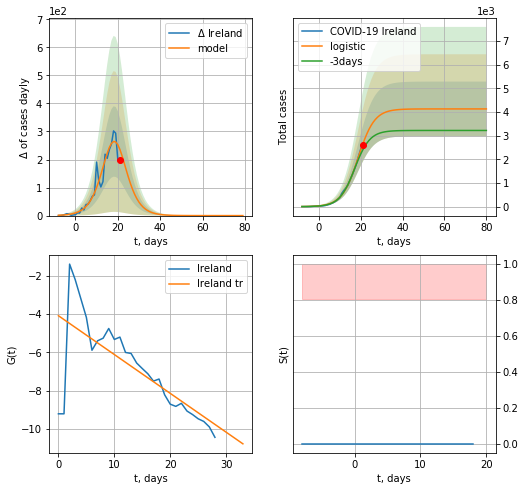

Ireland data at: 2020-11-04
+3 day model MAPE: 0.12282208937722881
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  4127 ± 1154
	 total death:  125 ± 104
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


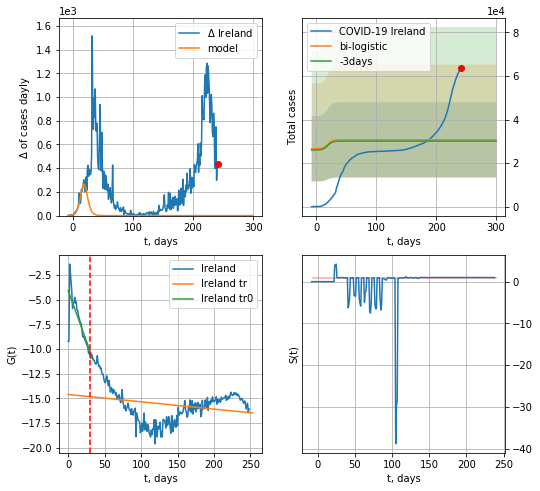

Ireland data at: 2020-11-04
+3 day model MAPE: 0.019027485141268407
model: bi-logistic
coeffs:  [ 2.12388575e+04 -1.56809150e+01  3.86183916e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.5635723006818467
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  30675 ± 17288
	 total death:  932 ± 1575
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.062966
 intercept: -14.594651
 slope: -0.007422


In [4856]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,T18*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


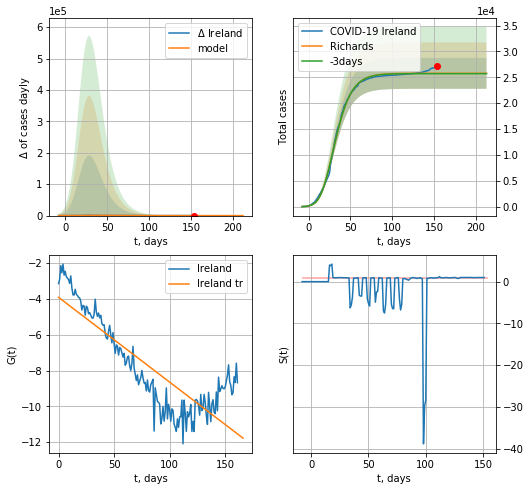

Ireland data at: 2020-11-04
+3 day model MAPE: 0.002433
model: Richards
coeffs: [2.57657943e+04 3.18771220e-01 1.26344801e+01 2.60248569e-01]
rational stdev: 0.115969
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 25765 ± 2988
	 total death: 783 ± 272
trend coefficient of determination: 0.719937
 intercept: -3.912376
 slope: -0.047358


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


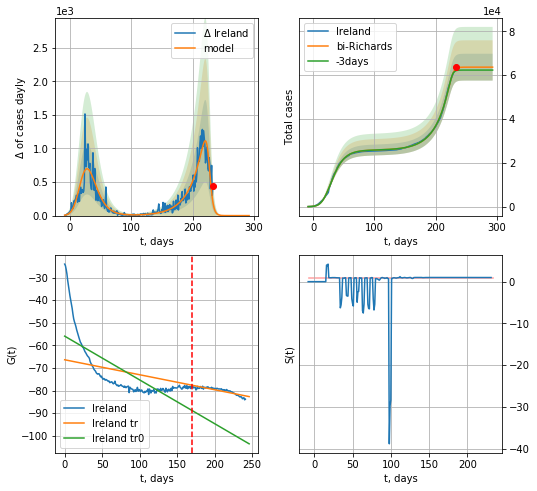

Ireland data at: 2020-11-04
+3 day model MAPE: 0.016717
model: bi-Richards
coeffs: [3.78512399e+04 4.50905124e-02 2.27302601e+02 7.12694666e+00]
rational stdev: 0.096184
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 63617 ± 6118
	 total death: 1934 ± 558
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.549839
 intercept: -55.931034
 slope: -0.193683
trend coefficient of determination: 0.762609
 intercept: -66.380373
 slope: -0.066283


In [4857]:
ivL = 7
vL = 170 +ivL
x = forecastRR('Ireland',dfIR[ivL:vL-ivL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Ireland',dfIR[ivL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-ivL)
#x = forecastRRR('Ireland',dfIR[3:],d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)

CL
           date   cases  active    death
242 2020-10-31  510256    9407  14207.0
243 2020-11-01  511864    9451  14247.0
244 2020-11-02  513188    9361  14302.0
245 2020-11-03  514202    9063  14319.0
246 2020-11-04  515042    8553  14340.0


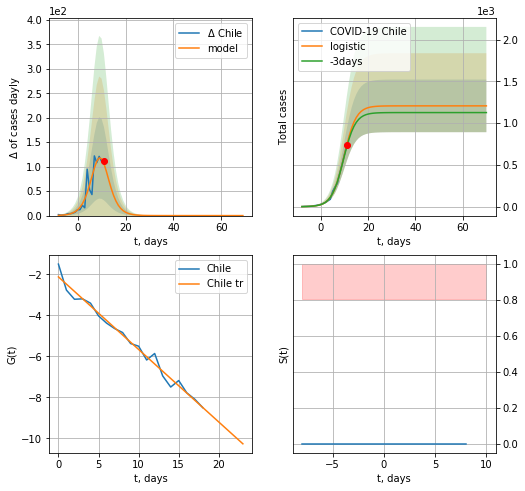

Chile data at: 2020-11-04
+3 day model MAPE: 0.03908993891192624
model: logistic
coeffs:  [1.20759839e+03 3.93191843e-01 9.80781865e+00]
rational stdev:  0.2610672451056305
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  1207 ± 315
	 total death:  33 ± 25
trend coefficient of determination: 0.982168
 intercept: -2.127319
 slope: -0.354074


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


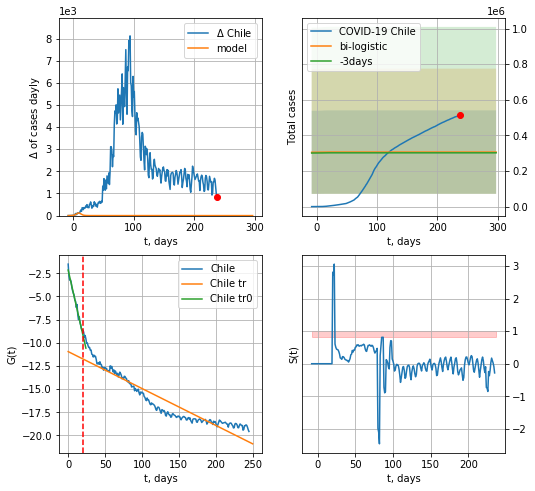

Chile data at: 2020-11-04
+3 day model MAPE: 0.013686721055280113
model: bi-logistic
coeffs:  [ 2.43964409e+05 -4.75709926e+01  1.13577008e+03] [1.20759839e+03 3.93191843e-01 9.80781865e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.765427507693576
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  306163 ± 234345
	 total death:  8524 ± 19573
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.984051
 intercept: -2.144368
 slope: -0.351232
trend coefficient of determination: 0.879397
 intercept: -10.948730
 slope: -0.039817


In [4858]:
vL=20
dfCL = read_df(pd.DataFrame(),"CL")
x = forecast('Chile',dfCL[:vL],d1,7*T18-dT)
xx = forecast2('Chile',dfCL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


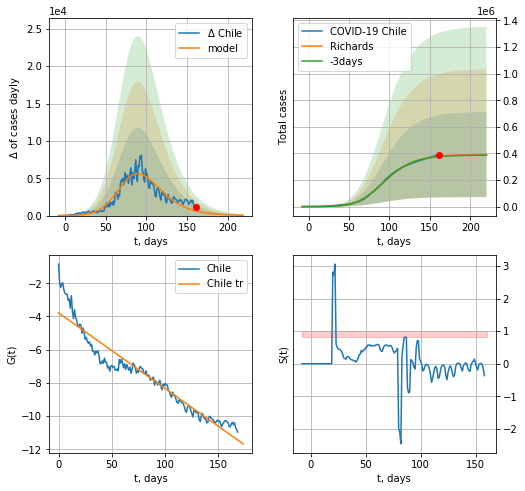

Chile data at: 2020-11-04
+3 day model MAPE: 0.007583
model: Richards
coeffs: [3.92652491e+05 1.16049666e-01 7.04582771e+01 4.00939983e-01]
rational stdev: 0.816952
forecast at the end of period: +59 days
	 deltaDaycases: 44
	 total cases: 391722 ± 320018
	 total death: 10906 ± 26729
trend coefficient of determination: 0.916357
 intercept: -3.781163
 slope: -0.045598


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: RuntimeWarning: overflow encountered in power


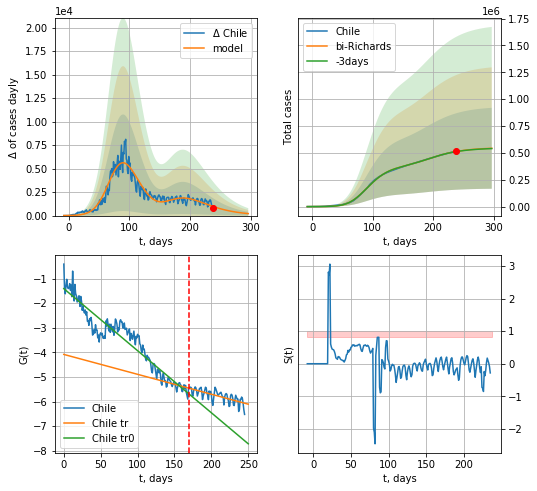

Chile data at: 2020-11-04
+3 day model MAPE: 0.002067
model: bi-Richards
coeffs: [1.57152764e+05 3.69367327e+00 3.17541349e+01 8.05576847e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.693628
forecast at the end of period: +59 days
	 deltaDaycases: 211
	 total cases: 542660 ± 376404
	 total death: 15108 ± 31438
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.912418
 intercept: -1.410308
 slope: -0.025237
trend coefficient of determination: 0.487142
 intercept: -4.085236
 slope: -0.008094


In [4859]:
vL = 170
x = forecastRR('Chile',dfCL[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Chile',dfCL[:],d1,40*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastRRR('Chile',dfCL[:],d1,24*7-dT,addpred=False,xcoef=koreaCoeffs)

In [4860]:
#x = forecast('Czechia',dfCH[:],d1,T18*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

CH
           date     cases  active   death
244 2020-10-31  335102.0  188492  3251.0
245 2020-11-01  341644.0  180797  3429.0
246 2020-11-02  350896.0  176634  3654.0
247 2020-11-03  362985.0  173892  3913.0
248 2020-11-04  378716.0  174820  4133.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


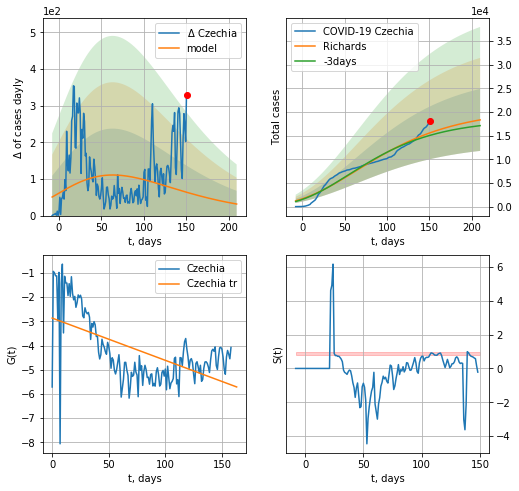

Czechia data at: 2020-11-04
+3 day model MAPE: 0.036194
model: Richards
coeffs: [ 2.05903469e+04  1.92716393e+00 -2.68842410e+02  7.61388243e-03]
rational stdev: 0.357386
forecast at the end of period: +59 days
	 deltaDaycases: 31
	 total cases: 18323 ± 6548
	 total death: 199 ± 213
trend coefficient of determination: 0.344405
 intercept: -2.865835
 slope: -0.017469


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


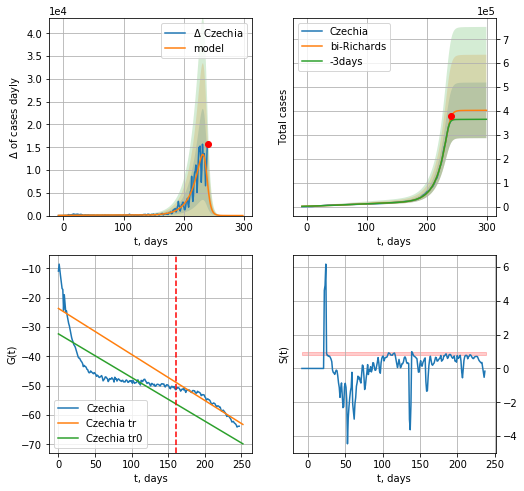

Czechia data at: 2020-11-04
+3 day model MAPE: 0.053012
model: bi-Richards
coeffs: [3.82664766e+05 6.15669025e-02 2.37340001e+02 4.72103232e+00]
rational stdev: 0.288865
forecast at the end of period: +59 days
	 deltaDaycases: 9
	 total cases: 402614 ± 116301
	 total death: 4393 ± 3806
bi-Richards approximation splitting point: 160
trend coefficient of determination: 0.560625
 intercept: -32.320832
 slope: -0.148851
trend coefficient of determination: 0.927696
 intercept: -23.641206
 slope: -0.157059


In [4861]:
vL= 160
dfCH = read_df(pd.DataFrame(),"CH")
x = forecastRR('Czechia',dfCH[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Czechia',dfCH[:],d1,T18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastRRR('Czechia',dfCH[:],d1,60*7-dT,addpred=True,xcoef=koreaCoeffs)

In [4862]:
dfMX = read_df(pd.DataFrame(),"MX")
#x = forecast('Mexico',dfMX[:],d1,T18*7-dT,addpred=True,xcoef=[.25,1.,2.])#

MX
           date   cases    active    death
237 2020-10-31  924962  155550.0  91753.0
238 2020-11-01  929392  155453.0  91895.0
239 2020-11-02  933155  153635.0  92100.0
240 2020-11-03  938405  152585.0  92593.0
241 2020-11-04  943630  153000.0  93228.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


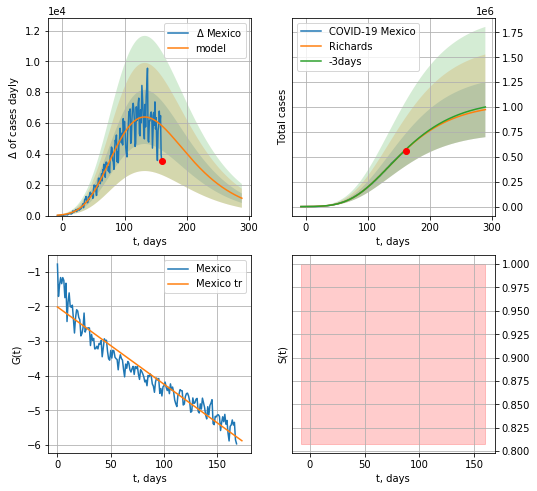

Mexico data at: 2020-11-04
+3 day model MAPE: 0.003545
model: Richards
coeffs: [ 1.04179119e+06  2.55360694e-01 -2.33371173e+01  6.75272317e-02]
rational stdev: 0.284208
forecast at the end of period: +129 days
	 deltaDaycases: 1124
	 total cases: 974738 ± 277028
	 total death: 96301 ± 82108
trend coefficient of determination: 0.926547
 intercept: -2.020698
 slope: -0.022282


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


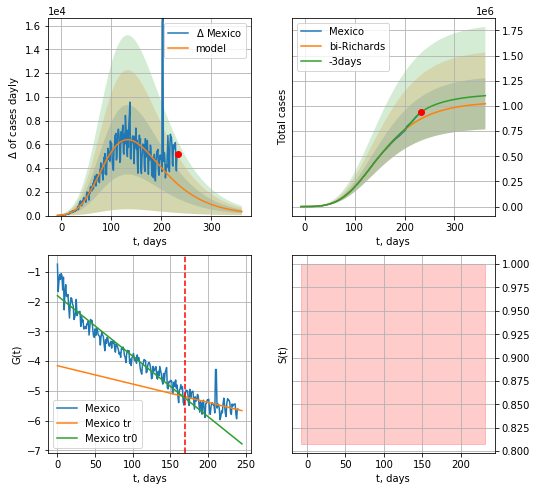

Mexico data at: 2020-11-04
+3 day model MAPE: 0.070159
model: bi-Richards
coeffs: [ 1.66795202e+04 -4.14878118e-02 -4.49782487e+01  3.06260413e-02]
rational stdev: 0.249059
forecast at the end of period: +129 days
	 deltaDaycases: 341
	 total cases: 1021925 ± 254519
	 total death: 100963 ± 75437
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.929763
 intercept: -1.798758
 slope: -0.020327
trend coefficient of determination: 0.163624
 intercept: -4.152203
 slope: -0.006168


In [4863]:
vL = 170#60
x = forecastRR('Mexico',dfMX[:vL],d1,50*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Mexico',dfMX[:],d12f(1),50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastRRR('Mexico',dfMX[10:],d1,66*7-dT,addpred=False,xcoef=koreaCoeffs)#

LT
           date    cases  active  death      tests
236 2020-10-31  15719.0   10613  166.0  1027761.0
237 2020-11-01  16556.0   11435  170.0  1033171.0
238 2020-11-02  17453.0   12283  175.0  1038164.0
239 2020-11-03  18092.0   12765  182.0  1050223.0
240 2020-11-04  19091.0   13557  186.0        0.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


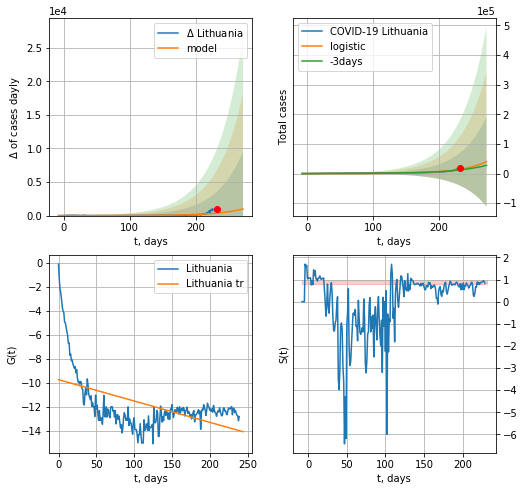

Lithuania data at: 2020-11-04
+3 day model MAPE: 0.18874317064999213
model: logistic
coeffs:  [1.49636025e+08 2.49959970e-02 6.01987395e+02]
rational stdev:  3.7764588016422604
forecast at the end of period: +41 days
	 deltaDaycases:  990
	 total cases:  40138 ± 151579
	 total death:  403 ± 4565
trend coefficient of determination: 0.263530
 intercept: -9.729299
 slope: -0.017767


In [4987]:
vL = 1
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [4988]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [4989]:
#np.diff(dfLT["cases"])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


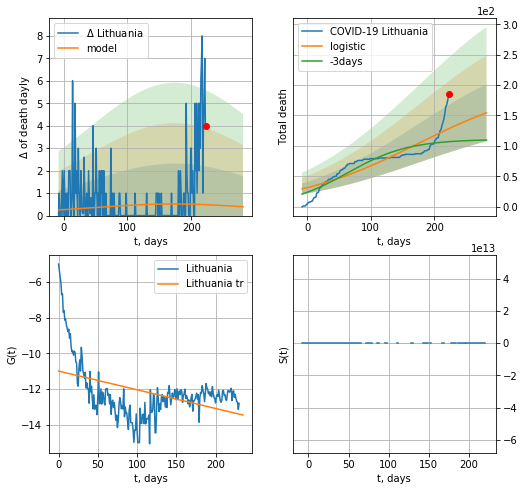

Lithuania data at: 2020-11-04
+3 day model MAPE: 0.204139248388454
model: logistic
coeffs:  [2.07601887e+02 9.93163267e-03 1.74428329e+02]
rational stdev:  0.3048780812590957
forecast at the end of period: +59 days
	 total death:  154 ± 47
trend coefficient of determination: 0.184376
 intercept: -10.996209
 slope: -0.010479


In [4990]:
x = forecast('Lithuania',dfLT[9:],d1,7*T18-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


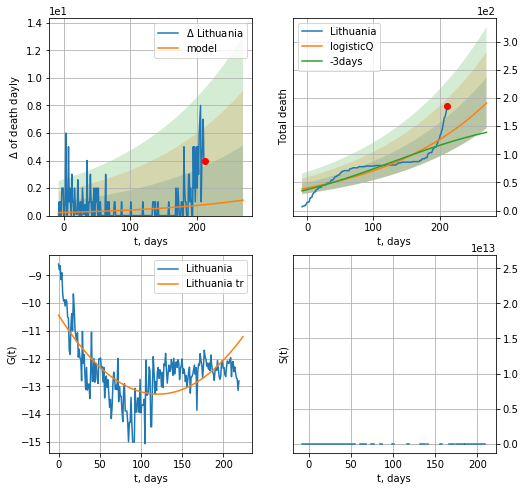

Lithuania data at: 2020-11-04
+3 day model MAPE: 0.126098
model: logisticQ
coeffs: [ 4.62851214e+04  5.49238544e-07  1.13055822e+03 -1.13488297e+04]
rational stdev: 0.236285
forecast at the end of period: +59 days
	 total death: 191 ± 45
trend coefficient of determination: 0.473745
 intercept_: -10.428689725235827
 coeffs_: [ 0.         -0.04720655  0.0001953 ]


In [4991]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
#x = forecastRRR('Lithuania',dfLT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


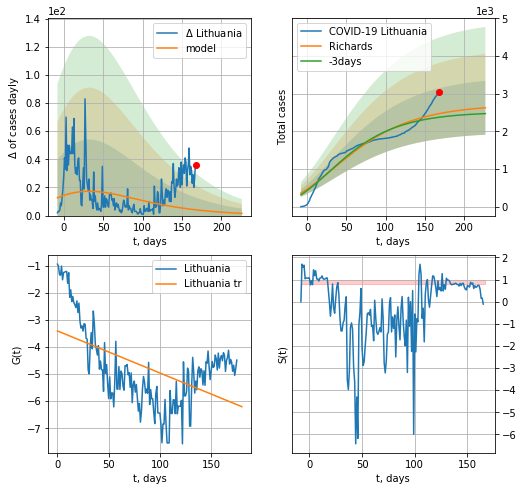

Lithuania data at: 2020-11-04
+3 day model MAPE: 0.040869
model: Richards
coeffs: [ 2.71955977e+03  3.23520726e+00 -2.68399504e+02  5.36559455e-03]
rational stdev: 0.272263
forecast at the end of period: +59 days
	 deltaDaycases: 1
	 total cases: 2627 ± 715
	 total death: 26 ± 21
trend coefficient of determination: 0.280184
 intercept: -3.398007
 slope: -0.015578


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


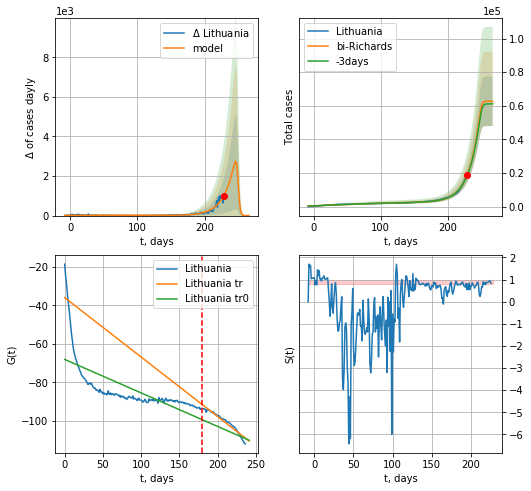

Lithuania data at: 2020-11-04
+3 day model MAPE: 0.025112
model: bi-Richards
coeffs: [6.00360098e+04 6.23456659e-02 2.50013221e+02 1.10442212e+01]
rational stdev: 0.235224
forecast at the end of period: +38 days
	 deltaDaycases: 0
	 total cases: 62709 ± 14750
	 total death: 630 ± 444
bi-Richards approximation splitting point: 180
trend coefficient of determination: 0.478911
 intercept: -68.073108
 slope: -0.173808
trend coefficient of determination: 0.941050
 intercept: -36.054837
 slope: -0.308296


In [4992]:
iL = 3
vL =180+iL#170+iL
x = forecastRR('Lithuania',dfLT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Lithuania',dfLT[iL:],d1,37*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

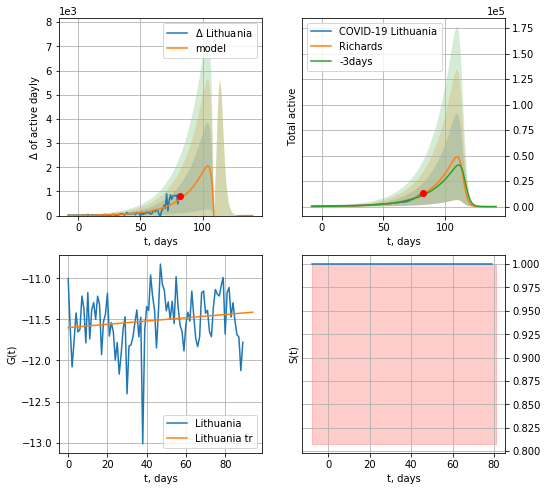

Lithuania data at: 2020-11-04
+3 day model MAPE: 0.109825
model: Richards
coeffs: [4.74002499e+03 5.72302869e-01 1.13874057e+02 8.95635335e-01]
rational stdev: 0.867612
forecast at the end of period: +59 days
	 total active: 0 ± 0
trend coefficient of determination: 0.023672
 intercept: -11.600173
 slope: 0.001987


In [4997]:
iL = 150
vL =100+iL
RAkoreaCoeffs = [5.86900283e+04, 2.15711530e+01, -9.80541238e+01,  2.21893275e-03]
x, t, tt, allmodel = forecastRRA('Lithuania',dfLT[iL:],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs,cases='active')#
#xx = forecast2RRA('Lithuania',dfLT[iL:],d1,90*7-dT,x,addpred=False,xcoef=RAkoreaCoeffs,vL=vL-iL,cases='active')#

In [4998]:
import datetime
a=zip(tt, allmodel)
print (t)
i = -1
stdevc = 0.867612
for a1,a2 in a:
    i = i + 1
    if i<t: continue
    start_date = "11/4/20"
    date_1 = datetime.datetime.strptime(start_date, "%m/%d/%y")
    end_date = date_1 + datetime.timedelta(days=int(a1)-81)
    print('active',(end_date.strftime("%Y/%m/%d)"),int(a2),'±',int(a2*stdevc)))
    print('5%',(end_date.strftime("%Y/%m/%d)"),int(a2*0.05),'±',int(0.05*a2*stdevc)))
    print('8%',(end_date.strftime("%Y/%m/%d)"),int(a2*0.08),'±',int(0.08*a2*stdevc)))
dfLT.tail()

82
active ('2020/11/05)', 8110, '±', 7037)
5% ('2020/11/05)', 405, '±', 351)
8% ('2020/11/05)', 648, '±', 562)
active ('2020/11/06)', 8554, '±', 7421)
5% ('2020/11/06)', 427, '±', 371)
8% ('2020/11/06)', 684, '±', 593)
active ('2020/11/07)', 9022, '±', 7828)
5% ('2020/11/07)', 451, '±', 391)
8% ('2020/11/07)', 721, '±', 626)
active ('2020/11/08)', 9516, '±', 8256)
5% ('2020/11/08)', 475, '±', 412)
8% ('2020/11/08)', 761, '±', 660)
active ('2020/11/09)', 10038, '±', 8709)
5% ('2020/11/09)', 501, '±', 435)
8% ('2020/11/09)', 803, '±', 696)
active ('2020/11/10)', 10589, '±', 9187)
5% ('2020/11/10)', 529, '±', 459)
8% ('2020/11/10)', 847, '±', 734)
active ('2020/11/11)', 11170, '±', 9691)
5% ('2020/11/11)', 558, '±', 484)
8% ('2020/11/11)', 893, '±', 775)
active ('2020/11/12)', 11784, '±', 10224)
5% ('2020/11/12)', 589, '±', 511)
8% ('2020/11/12)', 942, '±', 817)
active ('2020/11/13)', 12432, '±', 10786)
5% ('2020/11/13)', 621, '±', 539)
8% ('2020/11/13)', 994, '±', 862)
active ('2020/11/1

,date,cases,active,death,tests
236,2020-10-31,15719.0,10613,166.0,1027761.0
237,2020-11-01,16556.0,11435,170.0,1033171.0
238,2020-11-02,17453.0,12283,175.0,1038164.0
239,2020-11-03,18092.0,12765,182.0,1050223.0
240,2020-11-04,19091.0,13557,186.0,0.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


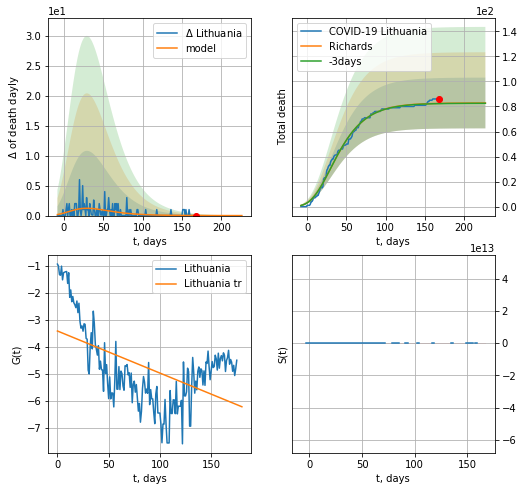

Lithuania data at: 2020-11-04
+3 day model MAPE: 0.002495
model: Richards
coeffs: [ 8.28105392e+01  6.19948354e+00 -9.53688137e+01  6.48963991e-03]
rational stdev: 0.244736
forecast at the end of period: +59 days
	 total death: 82 ± 20
trend coefficient of determination: 0.280445
 intercept: -3.404567
 slope: -0.015594


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:209: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:209: RuntimeWarning: invalid value encountered in true_divide


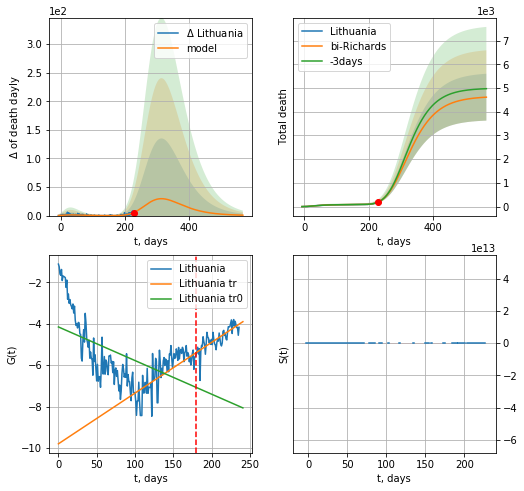

Lithuania data at: 2020-11-04
+3 day model MAPE: 0.003436
model: bi-Richards
coeffs: [4.57282806e+03 1.51093966e-01 2.01550216e+02 1.23510371e-01]
rational stdev: 0.214017
forecast at the end of period: +339 days
	 total death: 4616 ± 987
bi-Richards approximation splitting point: 180
trend coefficient of determination: 0.287052
 intercept: -4.151216
 slope: -0.016234
trend coefficient of determination: 0.601639
 intercept: -9.798515
 slope: 0.024490


In [4999]:
iL = 3
vL =180+iL
x = forecastRR('Lithuania',dfLT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs,cases='death')#
xx = forecast2RR('Lithuania',dfLT[iL:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,cases='death')#

In [3444]:
#x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
           date    cases  active  death
238 2020-10-31  17933.0    7695  157.0
239 2020-11-01  18782.0    8541  160.0
240 2020-11-02  19101.0    8224  160.0
241 2020-11-03  19634.0    8642  167.0
242 2020-11-04  20344.0    9110  171.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


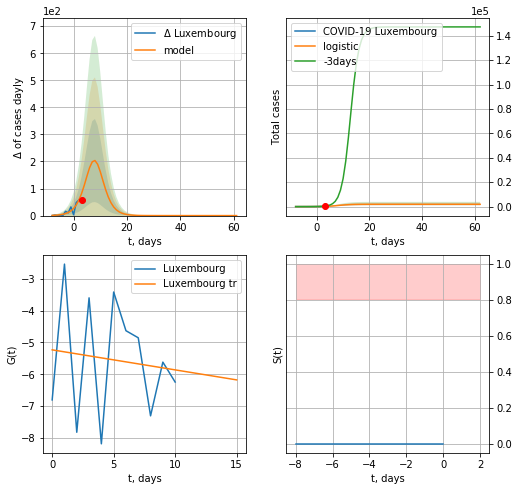

Luxembourg data at: 2020-11-04
model: logistic
coeffs:  [1.87757966e+03 4.36654344e-01 8.24919508e+00]
rational stdev:  0.35795936969501296
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  1877 ± 672
	 total death:  15 ± 16
trend coefficient of determination: 0.012091
 intercept: -5.231862
 slope: -0.063083


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


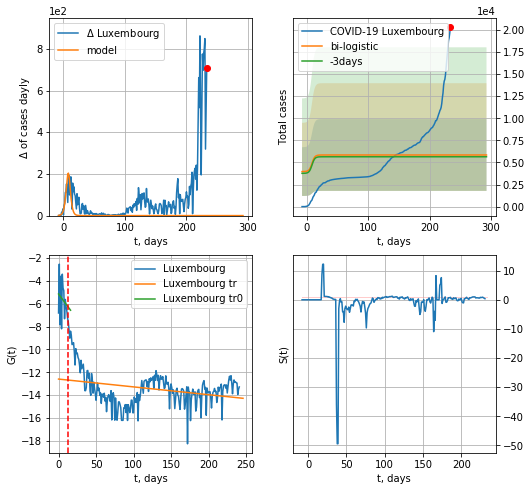

Luxembourg data at: 2020-11-04
+3 day model MAPE: 0.03559569010992499
model: bi-logistic
coeffs:  [3527.18708847  -20.34453535  513.64157452] [1.87757966e+03 4.36654344e-01 8.24919508e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.6950689031347611
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  5845 ± 4063
	 total death:  49 ± 102
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.030158
 intercept: -5.146907
 slope: -0.088569
trend coefficient of determination: 0.084284
 intercept: -12.589961
 slope: -0.006832


In [4865]:
try:
    dfLX = read_df(pd.DataFrame(),"LX")
    x = forecast("Luxembourg",dfLX[:12],d1,T18*7-dT,pMAPE=False)
    xx = forecast2("Luxembourg",dfLX[:],d1,T18*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


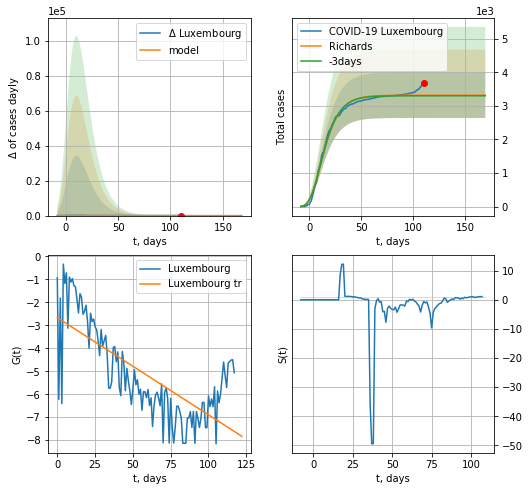

Luxembourg data at: 2020-11-04
+3 day model MAPE: 0.005360
model: Richards
coeffs: [ 3.31795764e+03  2.37937450e+01 -4.59915621e+01  4.08039431e-03]
rational stdev: 0.204084
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 3317 ± 677
	 total death: 27 ± 16
trend coefficient of determination: 0.519585
 intercept: -2.664922
 slope: -0.042328


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


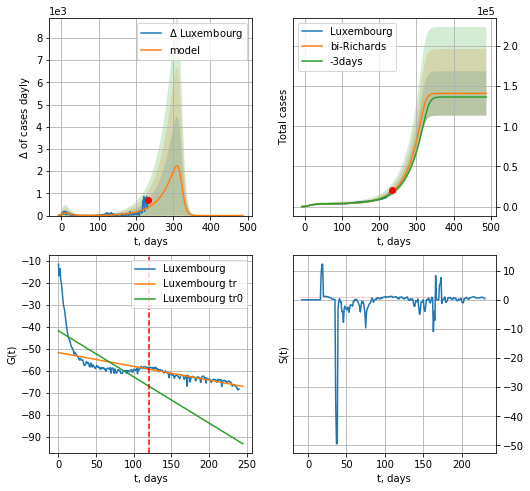

Luxembourg data at: 2020-11-04
+3 day model MAPE: 0.060924
model: bi-Richards
coeffs: [1.37532548e+05 2.55660941e-02 3.21803223e+02 6.54260015e+00]
rational stdev: 0.195920
forecast at the end of period: +255 days
	 deltaDaycases: 0
	 total cases: 140850 ± 27595
	 total death: 1183 ± 695
bi-Richards approximation splitting point: 120
trend coefficient of determination: 0.470780
 intercept: -41.735994
 slope: -0.209570
trend coefficient of determination: 0.830660
 intercept: -51.640869
 slope: -0.062575


In [4866]:
iL=1
vL = 120+iL#105+iL-10
x = forecastRR("Luxembourg",dfLX[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Luxembourg",dfLX[iL:],d1,68*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


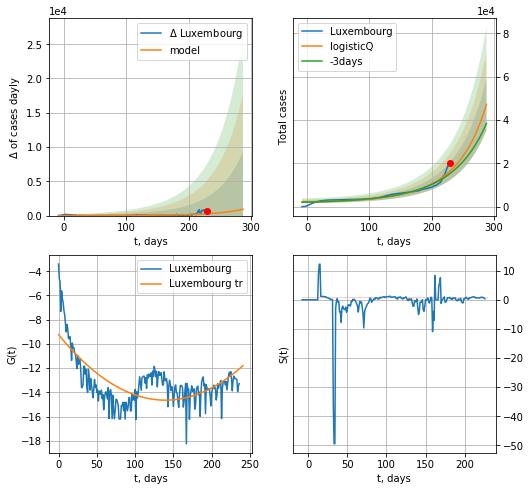

Luxembourg data at: 2020-11-04
+3 day model MAPE: 0.075549
model: logisticQ
coeffs: [ 2.88033616e+07  3.22948035e-05  5.21261957e+02 -5.63105300e+02]
rational stdev: 0.252565
forecast at the end of period: +59 days
	 deltaDaycases: 930
	 total cases: 47233 ± 11929
	 total death: 397 ± 300
trend coefficient of determination: 0.480342
 intercept_: -9.236736043379171
 coeffs_: [ 0.         -0.07752055  0.00027757]


In [4867]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)

In [4868]:
dfED = read_df(pd.DataFrame(),"ED")
#x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

ED
           date     cases   active    death
245 2020-10-31  168192.0  13763.0  12670.0
246 2020-11-01  169194.0   7462.0  12684.0
247 2020-11-02  169562.0   7822.0  12692.0
248 2020-11-03  170110.0   8364.0  12698.0
249 2020-11-04  171433.0   9681.0  12704.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


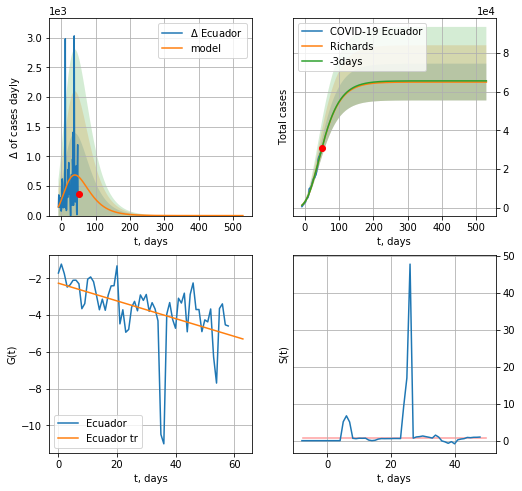

Ecuador data at: 2020-11-04
+3 day model MAPE: 0.001443
model: Richards
coeffs: [ 6.49031363e+04  1.85787235e+00 -1.03613231e+02  1.55703468e-02]
rational stdev: 0.146273
forecast at the end of period: +479 days
	 deltaDaycases: 0
	 total cases: 64903 ± 9493
	 total death: 4809 ± 2110
trend coefficient of determination: 0.218364
 intercept: -2.268609
 slope: -0.048096


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


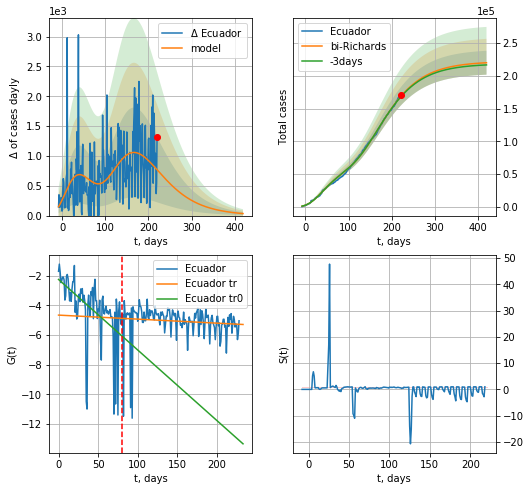

Ecuador data at: 2020-11-04
+3 day model MAPE: 0.004358
model: bi-Richards
coeffs: [ 1.57078979e+05  1.19875600e+00 -6.73922614e+01  1.47536110e-02]
rational stdev: 0.082788
forecast at the end of period: +199 days
	 deltaDaycases: 33
	 total cases: 220071 ± 18219
	 total death: 16308 ± 4050
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.275418
 intercept: -2.258499
 slope: -0.047520
trend coefficient of determination: 0.011356
 intercept: -4.660732
 slope: -0.002707


In [4869]:
vL = 80+20
x = forecastRR("Ecuador",dfED[20:vL-20],d1,100*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Ecuador",dfED[20:],d1,60*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

In [4870]:
#x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
           date    cases  active  death
249 2020-10-31  16291.0    4633  358.0
250 2020-11-01  16400.0    4742  358.0
251 2020-11-02  16637.0    4978  359.0
252 2020-11-03  16902.0    5243  359.0
253 2020-11-04  16930.0    3869  361.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


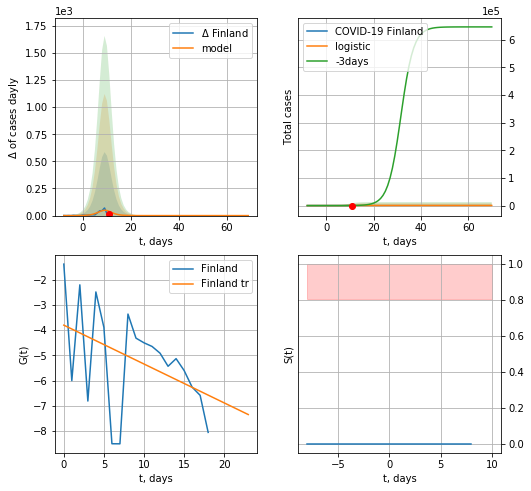

Finland data at: 2020-11-04
+3 day model MAPE: 0.3536795630191518
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  373 ± 4115
	 total death:  7 ± 231
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


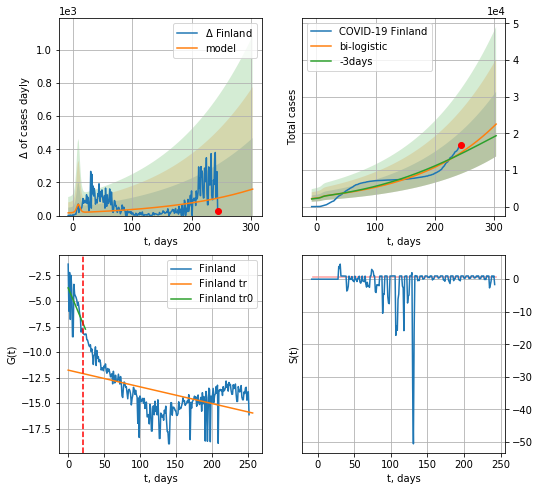

Finland data at: 2020-11-04
+3 day model MAPE: 0.023913871686885777
model: bi-logistic
coeffs:  [5.73028950e+05 7.53145470e-03 7.31149272e+02] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.39251385558560664
forecast at the end of period: +59 days
	 deltaDaycases:  159
	 total cases:  22521 ± 8839
	 total death:  480 ± 565
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.250019
 intercept: -11.774640
 slope: -0.016342


In [4871]:
try:
    dfFI = read_df(pd.DataFrame(),"FI")
    vL=20
    x = forecast("Finland",dfFI[:vL],d1,7*T18-dT)
    xx = forecast2("Finland",dfFI[:],d1,T18*7-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


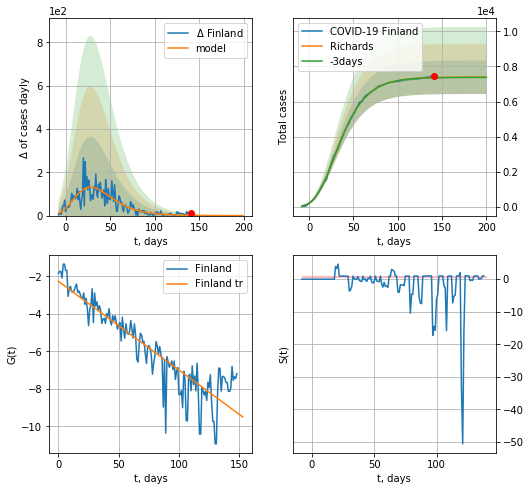

Finland data at: 2020-11-04
+3 day model MAPE: 0.001103
model: Richards
coeffs: [ 7.38854164e+03  5.39963308e-01 -1.81801816e+01  9.38814747e-02]
rational stdev: 0.129256
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 7387 ± 954
	 total death: 157 ± 60
trend coefficient of determination: 0.823115
 intercept: -2.267352
 slope: -0.047318


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


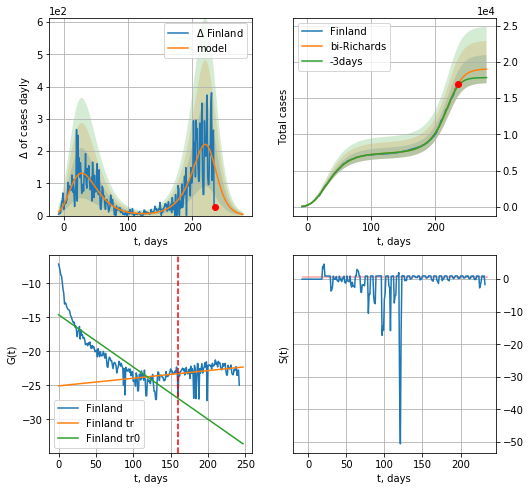

Finland data at: 2020-11-04
+3 day model MAPE: 0.018144
model: bi-Richards
coeffs: [1.16475485e+04 5.06029586e-02 2.27446754e+02 1.91017222e+00]
rational stdev: 0.102367
forecast at the end of period: +45 days
	 deltaDaycases: 3
	 total cases: 18998 ± 1944
	 total death: 405 ± 124
bi-Richards approximation splitting point: 160
trend coefficient of determination: 0.728336
 intercept: -14.625512
 slope: -0.076850
trend coefficient of determination: 0.047203
 intercept: -25.085484
 slope: 0.011221


In [4872]:
vL = 170#96 + 10 + 25
x = forecastRR("Finland",dfFI[10:vL-10],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Finland",dfFI[10:],d12f(1),38*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)

In [4873]:
## x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
           date  cases   active   death
235 2020-10-31  52844  31520.0  1279.0
236 2020-11-01  54069  32241.0  1298.0
237 2020-11-02  56496  34110.0  1349.0
238 2020-11-03  60537  37581.0  1412.0
239 2020-11-04  64591  41178.0  1466.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


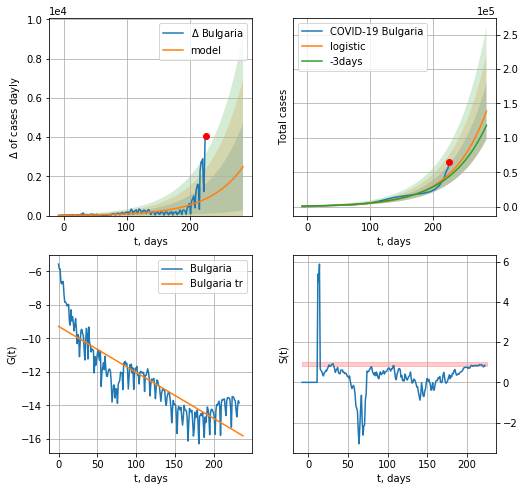

Bulgaria data at: 2020-11-04
+3 day model MAPE: 0.08157217369562288
model: logistic
coeffs:  [2.21899405e+08 1.81146446e-02 6.92234339e+02]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.2942152731638163
forecast at the end of period: +59 days
	 deltaDaycases:  2488
	 total cases:  138718 ± 40813
	 total death:  3148 ± 2778
trend coefficient of determination: 0.739606
 intercept: -9.277234
 slope: -0.027474


In [4874]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,T18*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


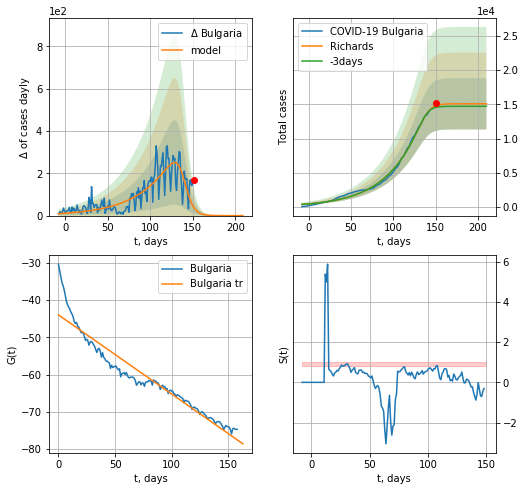

Bulgaria data at: 2020-11-04
+3 day model MAPE: 0.017805
model: Richards
coeffs: [1.50824768e+04 2.52805245e-02 1.39971141e+02 7.29152366e+00]
rational stdev: 0.248593
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 15082 ± 3749
	 total death: 342 ± 255
trend coefficient of determination: 0.915098
 intercept: -43.939842
 slope: -0.212540


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


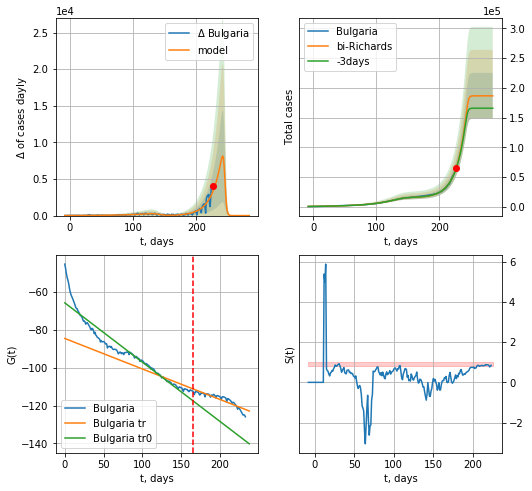

Bulgaria data at: 2020-11-04
+3 day model MAPE: 0.021496
model: bi-Richards
coeffs: [1.71441232e+05 6.48082739e-02 2.45769535e+02 1.11193840e+01]
rational stdev: 0.207423
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 186523 ± 38689
	 total death: 4233 ± 2634
bi-Richards approximation splitting point: 165
trend coefficient of determination: 0.923220
 intercept: -65.800590
 slope: -0.312554
trend coefficient of determination: 0.817137
 intercept: -84.586130
 slope: -0.160818


In [4875]:
vL = 170#71+5
x = forecastRR('Bulgaria',dfBL[5:vL-5],d1,T18*7-dT,shift=1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bulgaria',dfBL[5:],d1,40*7-dT,x,shift=1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

In [4876]:
#x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
           date   cases  active  death
247 2020-10-31  3784.0   133.0   59.0
248 2020-11-01  3787.0   133.0   59.0
249 2020-11-02  3797.0   133.0   59.0
250 2020-11-03  3804.0   133.0   59.0
251 2020-11-04  3810.0   128.0   59.0


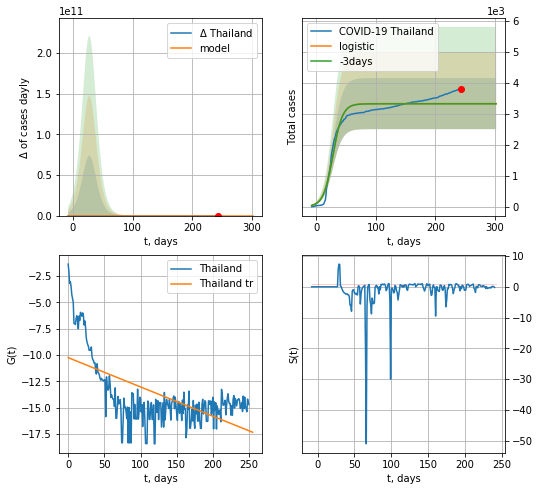

Thailand data at: 2020-11-04
+3 day model MAPE: 0.002491330550755752
model: logistic
coeffs:  [3.32971422e+03 1.23331614e-01 2.78067944e+01]
rational stdev:  0.2479931145527691
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  3329 ± 825
	 total death:  51 ± 37
trend coefficient of determination: 0.379501
 intercept: -10.252569
 slope: -0.027736


In [4877]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [4878]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


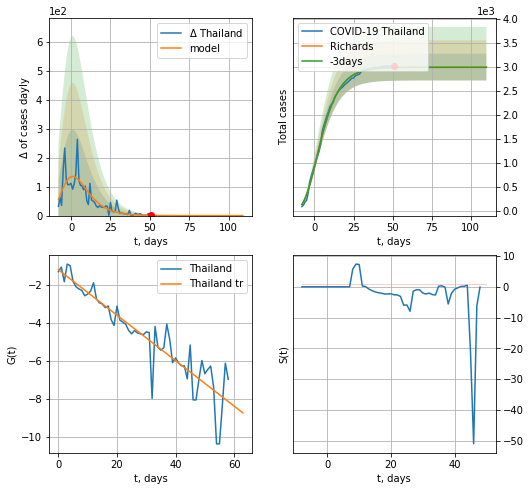

Thailand data at: 2020-11-04
+3 day model MAPE: 0.001958
model: Richards
coeffs: [ 2.99625224e+03  1.57427901e+01 -3.79340304e+01  7.81992540e-03]
rational stdev: 0.093292
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 2996 ± 279
	 total death: 46 ± 12
trend coefficient of determination: 0.845848
 intercept: -1.208254
 slope: -0.119672


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


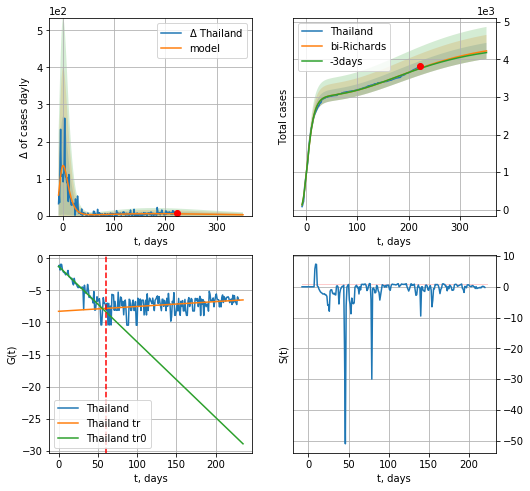

Thailand data at: 2020-11-04
+3 day model MAPE: 0.002375
model: bi-Richards
coeffs: [ 1.49339473e+03  1.15708845e+00 -3.28341906e+02  8.18119420e-03]
rational stdev: 0.050328
forecast at the end of period: +129 days
	 deltaDaycases: 2
	 total cases: 4225 ± 212
	 total death: 65 ± 9
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.843333
 intercept: -1.251485
 slope: -0.117572
trend coefficient of determination: 0.101598
 intercept: -8.258645
 slope: 0.007539


In [4879]:
vL = 80
x = forecastRR("Thailand",dfTH[20:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Thailand",dfTH[20:],d12f(1),50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

In [4880]:
#x = forecastRRR("Thailand",dfTH[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

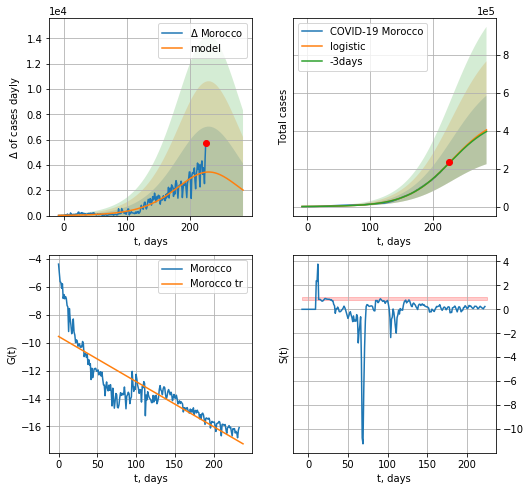

Morocco data at: 2020-11-04
+3 day model MAPE: 0.005353587471747265
model: logistic
coeffs:  [4.90667974e+05 2.80789800e-02 2.30017727e+02]
rational stdev:  0.4472994267746852
forecast at the end of period: +59 days
	 deltaDaycases:  2016
	 total cases:  404321 ± 180852
	 total death:  6842 ± 9181
trend coefficient of determination: 0.755601
 intercept: -9.548103
 slope: -0.032352


In [4881]:
x = forecast("Morocco",dfMR[5:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


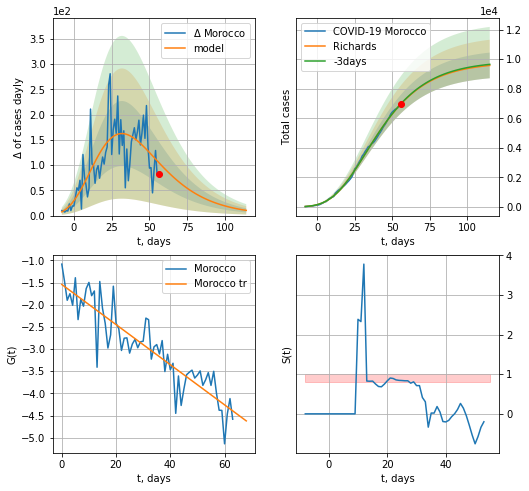

Morocco data at: 2020-11-04
+3 day model MAPE: 0.002854
model: Richards
coeffs: [ 9.80051535e+03  2.80051836e+00 -5.84633428e+01  1.62270604e-02]
rational stdev: 0.090760
forecast at the end of period: +59 days
	 deltaDaycases: 10
	 total cases: 9575 ± 869
	 total death: 162 ± 44
trend coefficient of determination: 0.815717
 intercept: -1.543258
 slope: -0.045268


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


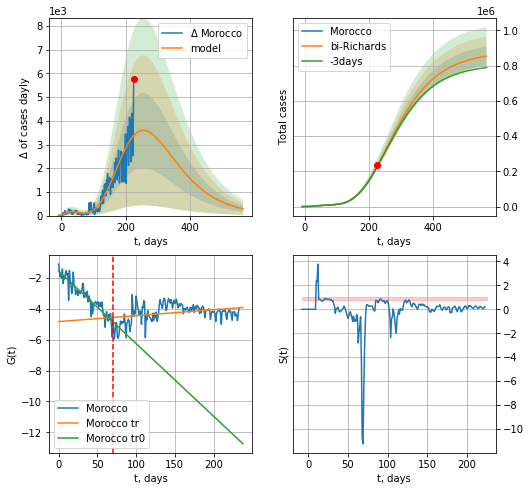

Morocco data at: 2020-11-04
+3 day model MAPE: 0.007371
model: bi-Richards
coeffs: [ 8.69782877e+05  5.17723328e-01 -8.08461369e+01  2.19497269e-02]
rational stdev: 0.064821
forecast at the end of period: +339 days
	 deltaDaycases: 285
	 total cases: 854231 ± 55372
	 total death: 14455 ± 2810
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.846372
 intercept: -1.540266
 slope: -0.047060
trend coefficient of determination: 0.105808
 intercept: -4.824969
 slope: 0.003843


In [4882]:
vL = 75 
x = forecastRR("Morocco",dfMR[5:vL-5],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Morocco",dfMR[5:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

In [4883]:
#x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

In [4884]:
dfRM = read_df(pd.DataFrame(),"RM")
#x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

RM
           date     cases   active   death
248 2020-10-31  241339.0  61858.0  6968.0
249 2020-11-01  246663.0  63621.0  7067.0
250 2020-11-02  250704.0  66190.0  7153.0
251 2020-11-03  258437.0  69989.0  7273.0
252 2020-11-04  267088.0  73409.0  7419.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


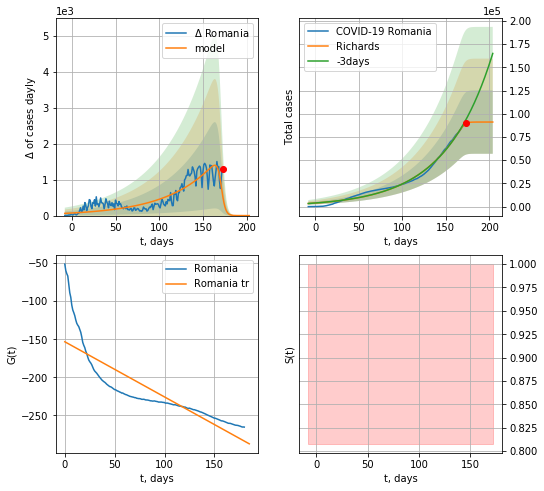

Romania data at: 2020-11-04
+3 day model MAPE: 0.053954
model: Richards
coeffs: [9.10483361e+04 1.84517813e-02 1.71468019e+02 2.28787361e+01]
rational stdev: 0.374976
forecast at the end of period: +31 days
	 deltaDaycases: 0
	 total cases: 91048 ± 34140
	 total death: 2529 ± 2844
trend coefficient of determination: 0.713660
 intercept: -153.246272
 slope: -0.723824


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


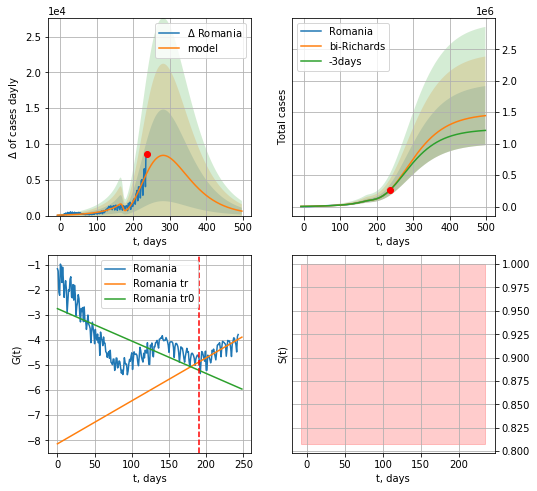

Romania data at: 2020-11-04
+3 day model MAPE: 0.009603
model: bi-Richards
coeffs: [1.39223169e+06 5.84565547e-01 6.85527537e+01 2.84976943e-02]
rational stdev: 0.325145
forecast at the end of period: +262 days
	 deltaDaycases: 623
	 total cases: 1445625 ± 470038
	 total death: 40155 ± 39168
bi-Richards approximation splitting point: 190
trend coefficient of determination: 0.472143
 intercept: -2.753489
 slope: -0.012924
trend coefficient of determination: 0.564595
 intercept: -8.142833
 slope: 0.017149


In [4885]:
vL = 190+8#87+8
x = forecastRR("Romania",dfRM[8:vL-8],d1,36*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Romania",dfRM[8:],d12f(1),69*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL = vL-8)

In [4886]:
#xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [4887]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

In [4888]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
#x = forecast("European Union",dfEU[:vL],d1,T18*7-dT)
#xx = forecast2("European Union",dfEU[:vL1],d1,T18*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("European Union",dfEU,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

EU
           date    cases   active     death
266 2020-10-31  6447197  2987034  174857.0
267 2020-11-01  6609427  3090148  176085.0
268 2020-11-02  6791135  3182909  177913.0
269 2020-11-03  6978723  3278554  180864.0
270 2020-11-04  7212035  3399738  184862.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


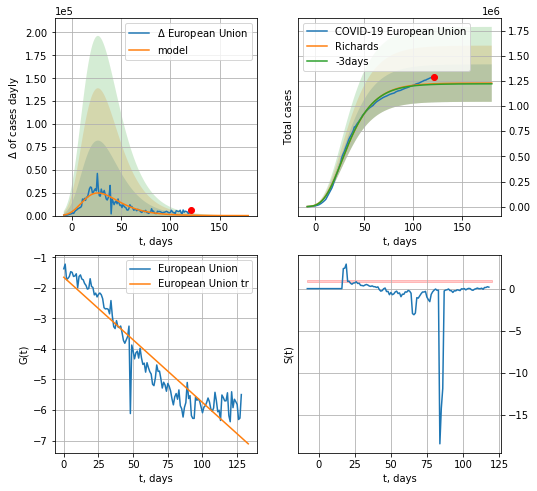

European Union data at: 2020-11-04
+3 day model MAPE: 0.005519
model: Richards
coeffs: [ 1.22822181e+06  1.02143494e+01 -6.81750717e+01  5.37108302e-03]
rational stdev: 0.151488
forecast at the end of period: +59 days
	 deltaDaycases: 15
	 total cases: 1227942 ± 186017
	 total death: 31475 ± 14304
trend coefficient of determination: 0.882661
 intercept: -1.652643
 slope: -0.041014


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


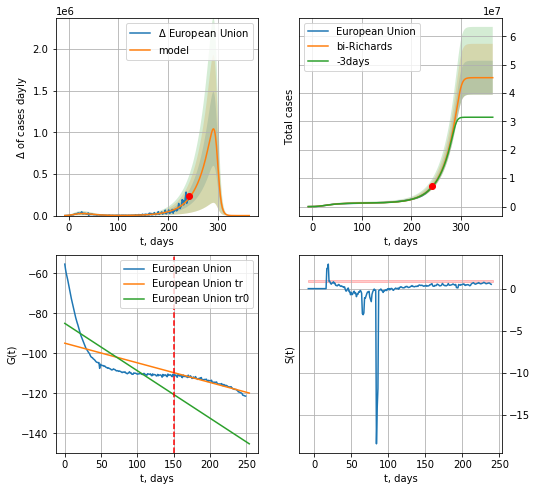

European Union data at: 2020-11-04
+3 day model MAPE: 0.014060
model: bi-Richards
coeffs: [4.41740866e+07 3.55985706e-02 2.99004625e+02 7.46805277e+00]
rational stdev: 0.131265
forecast at the end of period: +122 days
	 deltaDaycases: 0
	 total cases: 45402308 ± 5959717
	 total death: 1163771 ± 458285
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.604994
 intercept: -85.026980
 slope: -0.236861
trend coefficient of determination: 0.921663
 intercept: -94.925879
 slope: -0.098036


In [4889]:
vL = 150+20#83+20+17
x = forecastRR("European Union",dfEU[20:vL-20],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("European Union",dfEU[20:],d1,49*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

In [4890]:
#x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

In [4891]:
#x = forecastQR("European Union",dfEU[20:],d1,16*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [4892]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [4893]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [4894]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [4895]:
#dfIC[:]

IC
           date   cases  active  death
244 2020-10-31  4865.0     979   13.0
245 2020-11-01  4890.0     927   15.0
246 2020-11-02  4931.0     905   16.0
247 2020-11-03  4958.0     860   17.0
248 2020-11-04  4989.0     798   17.0


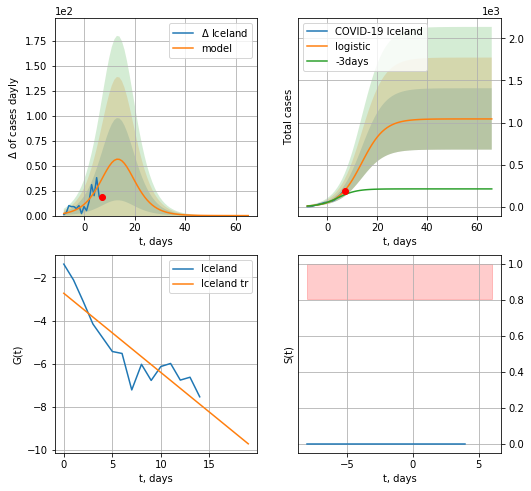

Iceland data at: 2020-11-04
+3 day model MAPE: 0.4751648041928849
model: logistic
coeffs:  [1.04285054e+03 2.17199299e-01 1.38649769e+01]
rational stdev:  0.34947878303574653
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  1042 ± 364
	 total death:  3 ± 3
trend coefficient of determination: 0.782203
 intercept: -2.736046
 slope: -0.366728


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


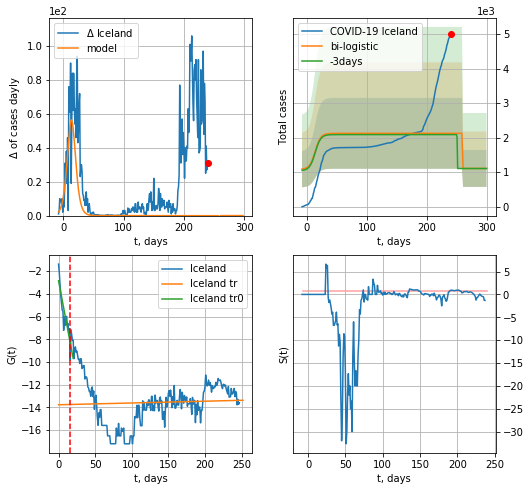

Iceland data at: 2020-11-04
+3 day model MAPE: 0.01800789077968088
model: bi-logistic
coeffs:  [1017.24347188   -9.39611663  259.02418743] [1.04285054e+03 2.17199299e-01 1.38649769e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.4836818972422452
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  1106 ± 535
	 total death:  3 ± 4
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.774693
 intercept: -2.854940
 slope: -0.341251
trend coefficient of determination: 0.002624
 intercept: -13.763206
 slope: 0.001571


In [4896]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


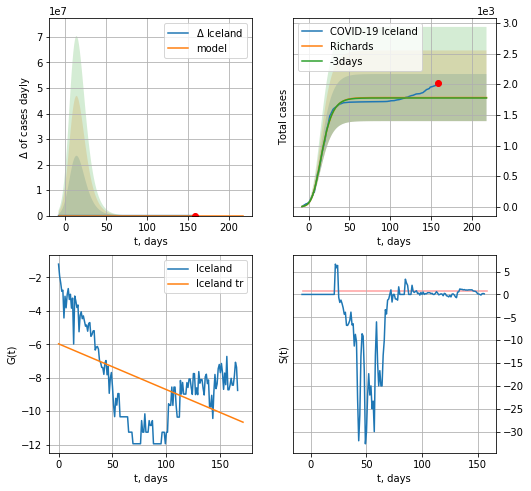

Iceland data at: 2020-11-04
+3 day model MAPE: 0.003798
model: Richards
coeffs: [1.78218704e+03 4.15281218e-01 4.51711528e+00 2.96176572e-01]
rational stdev: 0.215516
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 1782 ± 384
	 total death: 6 ± 3
trend coefficient of determination: 0.246093
 intercept: -5.976231
 slope: -0.027410


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


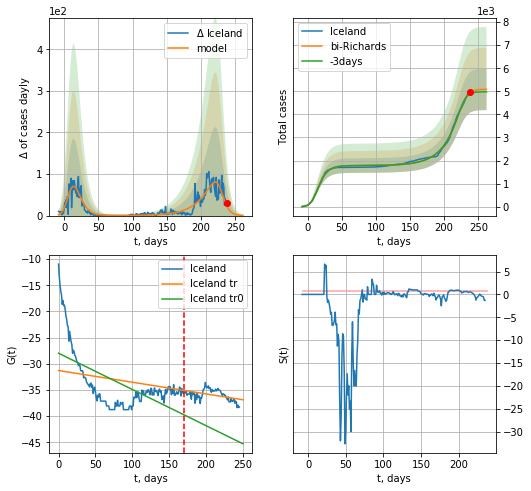

Iceland data at: 2020-11-04
+3 day model MAPE: 0.013445
model: bi-Richards
coeffs: [3.30700695e+03 4.62645244e-02 2.28465396e+02 3.89520258e+00]
rational stdev: 0.177226
forecast at the end of period: +24 days
	 deltaDaycases: 0
	 total cases: 5087 ± 901
	 total death: 17 ± 9
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.364865
 intercept: -27.978362
 slope: -0.069225
trend coefficient of determination: 0.215503
 intercept: -31.282452
 slope: -0.022349


In [4897]:
vL = 170+2
x = forecastRR("Iceland",dfIC[2:vL-2],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iceland",dfIC[2:],d1,35*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-2)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

In [4898]:
#x = forecastRRR("Iceland",dfIC[5:],d1,T18*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
           date   cases   active   death
235 2020-10-31  133598  20346.0  2700.0
236 2020-11-01  134336  19996.0  2706.0
237 2020-11-02  134915  19630.0  2720.0
238 2020-11-03  135592  19482.0  2731.0
239 2020-11-04  136024  19073.0  2744.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


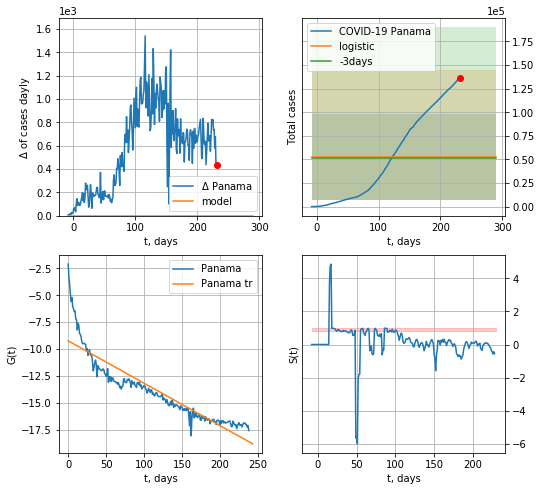

Panama data at: 2020-11-04
+3 day model MAPE: 0.020443190647824024
model: logistic
coeffs:  [ 5.24693374e+04 -4.38811948e+01  1.06168310e+03]
rational stdev:  0.8763742064590937
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  52469 ± 45982
	 total death:  1058 ± 2781
trend coefficient of determination: 0.827041
 intercept: -9.231923
 slope: -0.039386


In [4899]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


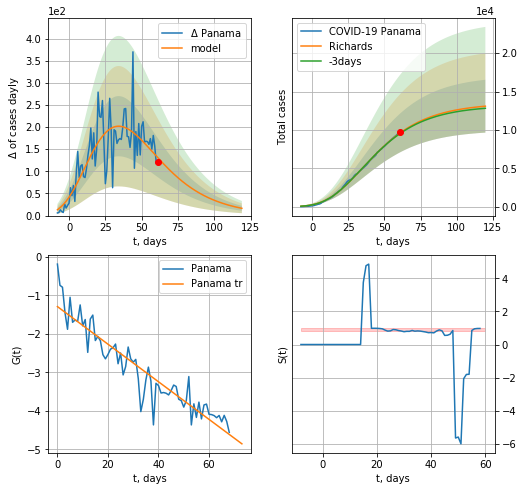

Panama data at: 2020-11-04
+3 day model MAPE: 0.008202
model: Richards
coeffs: [ 1.34884806e+04  2.34095265e+00 -6.38236986e+01  1.75426471e-02]
rational stdev: 0.263123
forecast at the end of period: +59 days
	 deltaDaycases: 16
	 total cases: 13089 ± 3444
	 total death: 264 ± 208
trend coefficient of determination: 0.871686
 intercept: -1.291509
 slope: -0.048815


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


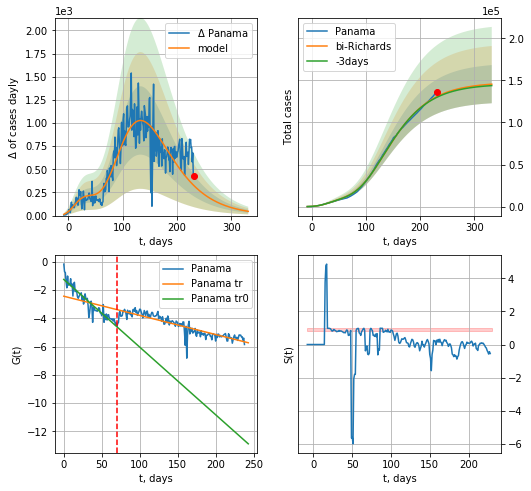

Panama data at: 2020-11-04
+3 day model MAPE: 0.006409
model: bi-Richards
coeffs: [ 1.34261618e+05  2.31954946e+00 -9.36225148e+01  8.92626526e-03]
rational stdev: 0.155887
forecast at the end of period: +101 days
	 deltaDaycases: 46
	 total cases: 145529 ± 22686
	 total death: 2935 ± 1372
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.873434
 intercept: -1.257061
 slope: -0.047833
trend coefficient of determination: 0.793668
 intercept: -2.441354
 slope: -0.013548


In [4900]:
vL = 70
x = forecastRR("Panama",dfPM[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Panama",dfPM[:],d1,46*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [4901]:
#x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


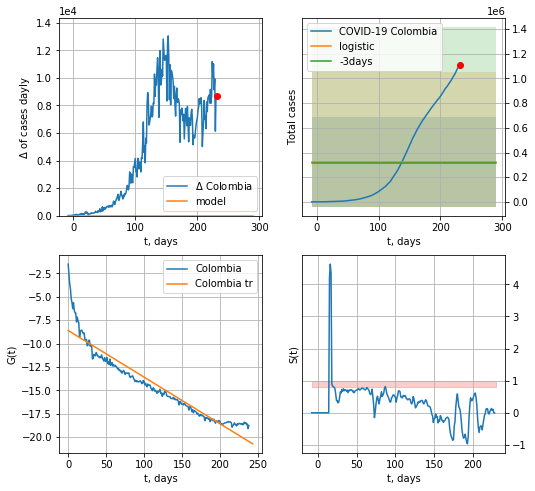

Colombia data at: 2020-11-04
+3 day model MAPE: 0.031044532160466924
model: logistic
coeffs:  [ 3.25643779e+05 -2.38907756e+01  5.74458644e+02]
rational stdev:  1.117285026739279
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  325643 ± 363836
	 total death:  9407 ± 31530
trend coefficient of determination: 0.898938
 intercept: -8.603238
 slope: -0.049894


In [4902]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


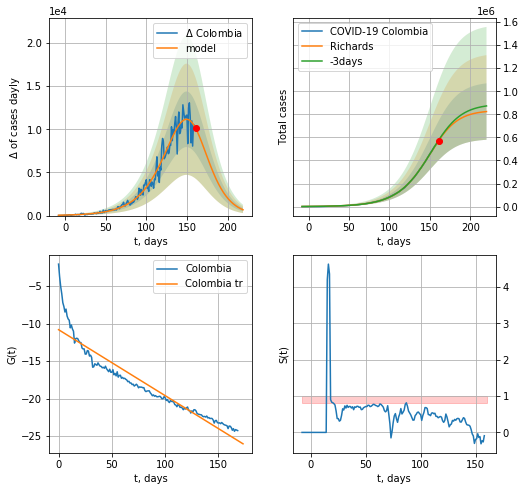

Colombia data at: 2020-11-04
+3 day model MAPE: 0.007195
model: Richards
coeffs: [8.34733445e+05 4.05910499e-02 1.56797482e+02 1.52613261e+00]
rational stdev: 0.296867
forecast at the end of period: +59 days
	 deltaDaycases: 673
	 total cases: 824006 ± 244619
	 total death: 23805 ± 21200
trend coefficient of determination: 0.889696
 intercept: -10.819712
 slope: -0.087917


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


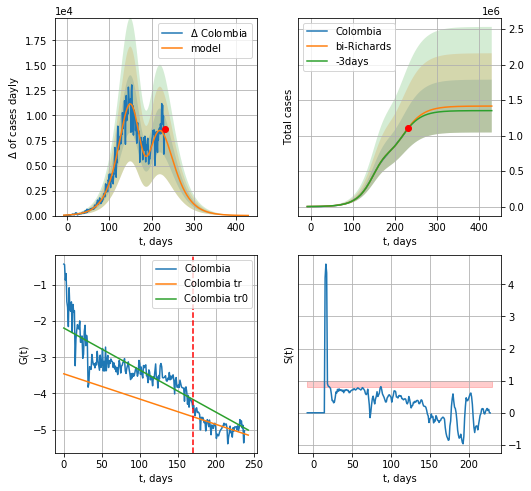

Colombia data at: 2020-11-04
+3 day model MAPE: 0.006109
model: bi-Richards
coeffs: [5.81123413e+05 2.90253001e+00 1.06638208e+02 1.28466775e-02]
rational stdev: 0.262518
forecast at the end of period: +199 days
	 deltaDaycases: 9
	 total cases: 1415594 ± 371619
	 total death: 40897 ± 32208
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.635485
 intercept: -2.188741
 slope: -0.011617
trend coefficient of determination: 0.385619
 intercept: -3.455258
 slope: -0.006982


In [4903]:
vL = 170#41
x = forecastRR("Colombia",dfCB[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Colombia",dfCB[:],d1,60*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [4904]:
#x = forecastRRR("Colombia",dfCB[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
           date    cases   active   death
241 2020-10-31  57942.0  15777.0  1964.0
242 2020-11-01  58272.0  15904.0  1973.0
243 2020-11-02  58574.0  16017.0  1980.0
244 2020-11-03  58979.0  16422.0  1980.0
245 2020-11-04  59527.0  16527.0  1999.0


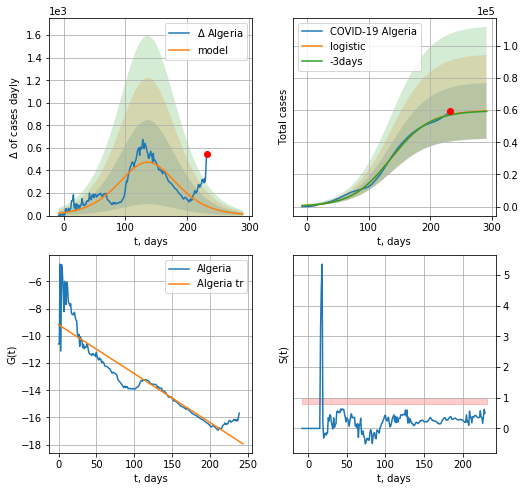

Algeria data at: 2020-11-04
+3 day model MAPE: 0.0041680573942509385
model: logistic
coeffs:  [5.99721770e+04 3.15960483e-02 1.36254311e+02]
rational stdev:  0.2922843373413486
forecast at the end of period: +59 days
	 deltaDaycases:  14
	 total cases:  59524 ± 17397
	 total death:  1998 ± 1751
trend coefficient of determination: 0.852490
 intercept: -9.183554
 slope: -0.035876


In [4905]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,T18*7-dT)
#dfAG

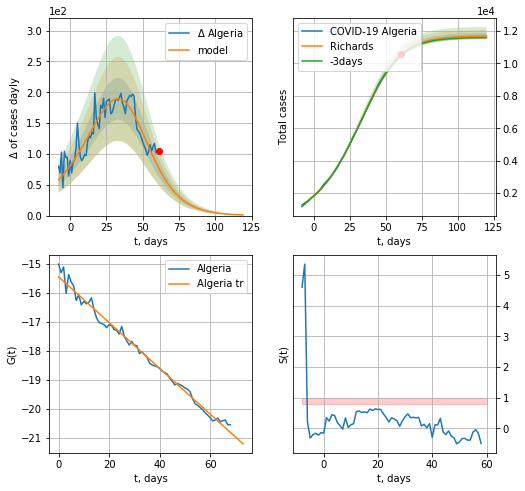

Algeria data at: 2020-11-04
+3 day model MAPE: 0.002873
model: Richards
coeffs: [1.17018124e+04 4.57679581e-02 4.02904334e+01 1.72065937e+00]
rational stdev: 0.015955
forecast at the end of period: +59 days
	 deltaDaycases: 1
	 total cases: 11689 ± 186
	 total death: 392 ± 18
trend coefficient of determination: 0.988499
 intercept: -15.458346
 slope: -0.078873


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


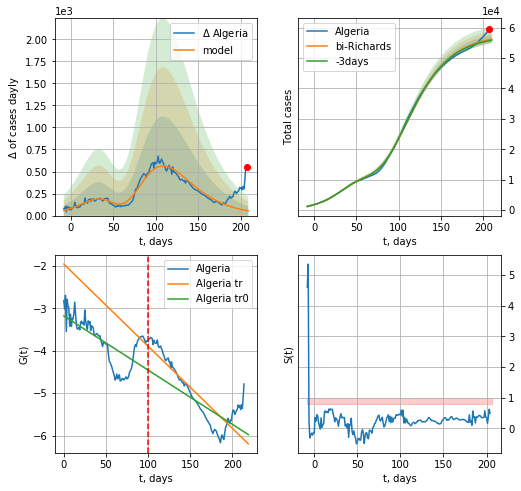

Algeria data at: 2020-11-04
+3 day model MAPE: 0.007241
model: bi-Richards
coeffs: [ 4.61813900e+04  3.81800272e+00 -3.38527913e+01  8.67760546e-03]
rational stdev: 0.023504
forecast at the end of period: +3 days
	 deltaDaycases: 53
	 total cases: 56263 ± 1322
	 total death: 1889 ± 133
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.461515
 intercept: -3.174196
 slope: -0.012799
trend coefficient of determination: 0.764052
 intercept: -1.952134
 slope: -0.019376


In [4906]:
iL = 30
vL = 100+iL
x = forecastRR("Algeria",dfAR[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[iL:],d1,32*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [4907]:
#x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

IE
           date   cases   active    death
236 2020-10-31  412784  56899.0  13943.0
237 2020-11-01  415402  55792.0  14044.0
238 2020-11-02  418375  54732.0  14146.0
239 2020-11-03  418375  54732.0  14146.0
240 2020-11-04  421731  54190.0  14259.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


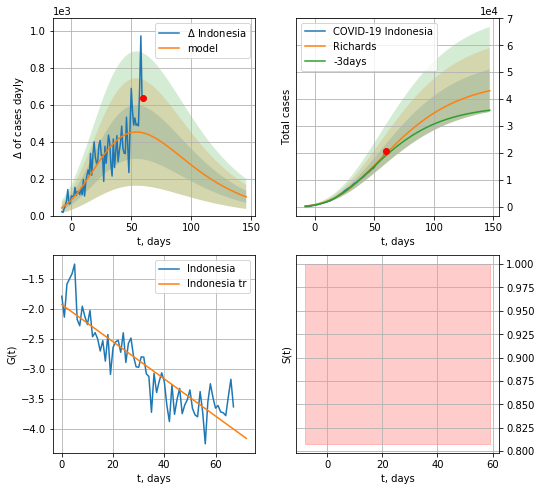

Indonesia data at: 2020-11-04
+3 day model MAPE: 0.038052
model: Richards
coeffs: [ 4.71241400e+04  1.80052285e+00 -1.05975004e+02  1.46057737e-02]
rational stdev: 0.182929
forecast at the end of period: +87 days
	 deltaDaycases: 101
	 total cases: 43141 ± 7891
	 total death: 1458 ± 800
trend coefficient of determination: 0.798542
 intercept: -1.926266
 slope: -0.031064
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:647: RuntimeWarning: divide by zero encountered in log


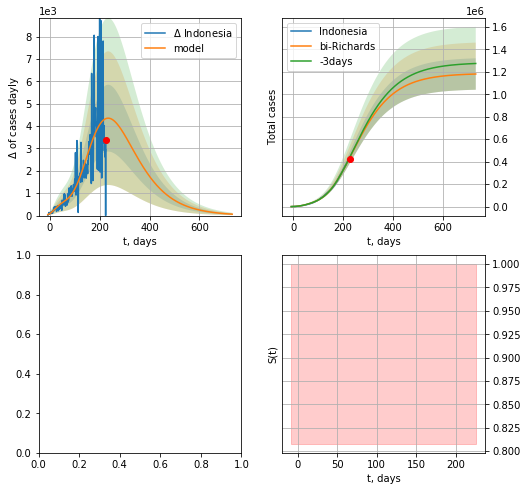

In [4908]:
dfIE = read_df(pd.DataFrame(),"IE")
try:
    #x = forecast("Indonesia",dfIE[5:],d1,T18*7-dT)
    vL = 75+6
    x = forecastRR("Indonesia",dfIE[6:vL-6],d1,44*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Indonesia",dfIE[6:],d12f(1),104*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-6)
except:
    print ("Exception occurs")

In [3487]:
#x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

In [4909]:
vL=10
vL1=25
try:
    dfPH = read_df(pd.DataFrame(),"PH")
    #x = forecast("Philippines",dfPH[4:vL],d1,T18*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
    #xx = forecast2("Philippines",dfPH[:],d1,T18*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
    #xx = np.concatenate((x, xx), axis=0)
    #xxx = forecast3("Philippines",dfPH,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])
except:
    print ("Exception occurs")

PH
           date   cases   active   death
238 2020-10-31  383113  27115.0  7238.0
239 2020-11-01  385400  29301.0  7269.0
240 2020-11-02  387161  30876.0  7318.0
241 2020-11-03  388137  31679.0  7367.0
242 2020-11-04  389725  32773.0  7409.0


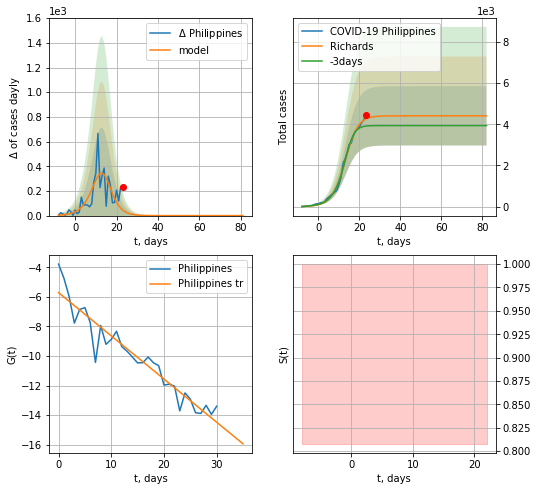

Philippines data at: 2020-11-04
+3 day model MAPE: 0.095041
model: Richards
coeffs: [4.40831989e+03 2.70678377e-01 1.39356489e+01 1.24523177e+00]
rational stdev: 0.326084
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 4408 ± 1437
	 total death: 83 ± 81
trend coefficient of determination: 0.911495
 intercept: -5.712821
 slope: -0.292234


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


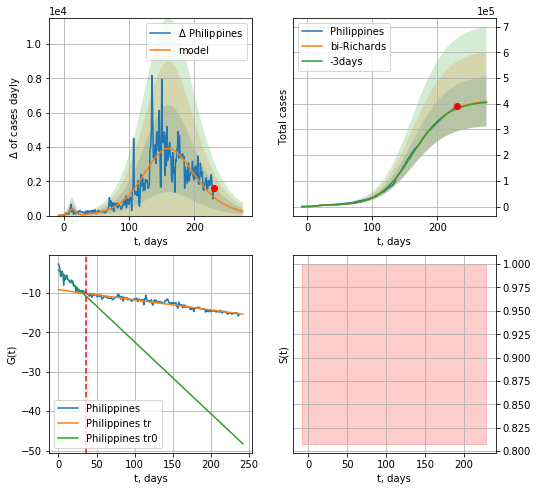

Philippines data at: 2020-11-04
+3 day model MAPE: 0.005212
model: bi-Richards
coeffs: [4.11542262e+05 4.58101106e-02 1.53251924e+02 7.70077755e-01]
rational stdev: 0.236207
forecast at the end of period: +45 days
	 deltaDaycases: 253
	 total cases: 408775 ± 96555
	 total death: 7771 ± 5506
bi-Richards approximation splitting point: 36
trend coefficient of determination: 0.856479
 intercept: -4.235385
 slope: -0.182004
trend coefficient of determination: 0.931890
 intercept: -9.186303
 slope: -0.025669


In [4910]:
vL = 36 + 4
x = forecastRR("Philippines",dfPH[4:vL-4],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Philippines",dfPH[4:],d12f(1),38*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)

In [4911]:
#x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

In [4912]:
dfGC = read_df(pd.DataFrame(),"GC")
#x = forecast("Greece",dfGC[:10],d1,T18*7-dT)
#xx = forecast2("Greece",dfGC[:],d1,T18*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

GC
           date    cases  active  death
245 2020-10-31  39251.0   28636  626.0
246 2020-11-01  40929.0   30305  635.0
247 2020-11-02  42080.0   31449  642.0
248 2020-11-03  44246.0   33602  655.0
249 2020-11-04  46892.0   36230  673.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


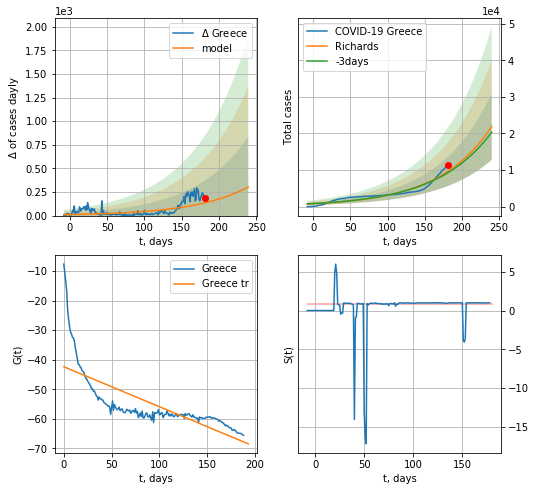

Greece data at: 2020-11-04
+3 day model MAPE: 0.039783
model: Richards
coeffs: [9.42035688e+04 1.39351077e-02 3.44671444e+02 6.57935766e+00]
rational stdev: 0.414534
forecast at the end of period: +59 days
	 deltaDaycases: 303
	 total cases: 21907 ± 9081
	 total death: 314 ± 390
trend coefficient of determination: 0.553823
 intercept: -42.362526
 slope: -0.135102


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


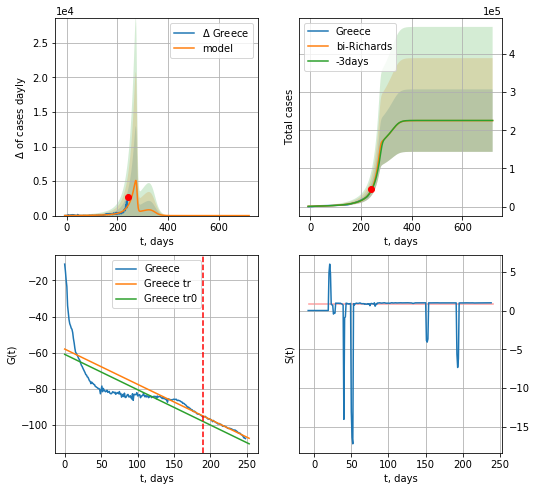

Greece data at: 2020-11-04
+3 day model MAPE: 0.047427
model: bi-Richards
coeffs: [1.31069282e+05 4.95650786e-02 2.77566805e+02 9.71747608e+00]
rational stdev: 0.363185
forecast at the end of period: +479 days
	 deltaDaycases: 0
	 total cases: 225272 ± 81815
	 total death: 3233 ± 3522
bi-Richards approximation splitting point: 190
trend coefficient of determination: 0.570170
 intercept: -60.885650
 slope: -0.195169
trend coefficient of determination: 0.985410
 intercept: -57.959438
 slope: -0.194675


In [4913]:
iL = 0
vL = 190+iL
x = forecastRR("Greece",dfGC[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Greece",dfGC[iL:],d1,100*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [4914]:
#x = forecastRRR("Greece",dfGC[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

In [4915]:
dfHG = read_df(pd.DataFrame(),"HG")
#try:
#    x = forecast("Hungary",dfHG[:],d1,T18*7-dT,addpred=True,xcoef=[.35,.5,4,1])
#except:
#    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

HG
           date    cases  active   death
239 2020-10-31  79199.0   57302  1819.0
240 2020-11-01  82780.0   60415  1889.0
241 2020-11-02  86769.0   63940  1973.0
242 2020-11-03  90988.0   67693  2063.0
243 2020-11-04  94916.0   69946  2147.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


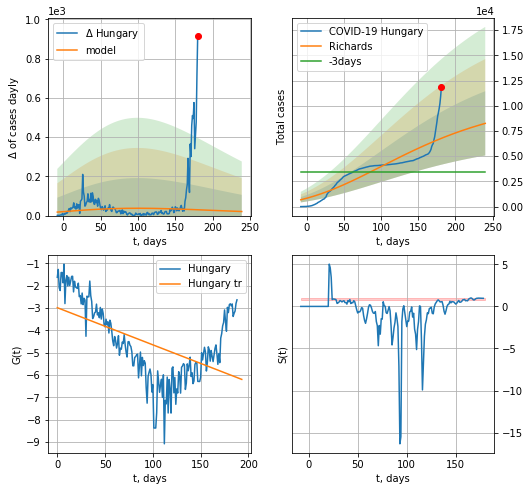

Hungary data at: 2020-11-04
+3 day model MAPE: 1.000059
model: Richards
coeffs: [ 1.07408269e+04  1.23496945e+00 -4.12281741e+02  7.69712535e-03]
rational stdev: 0.386199
forecast at the end of period: +59 days
	 deltaDaycases: 20
	 total cases: 8254 ± 3187
	 total death: 186 ± 215
trend coefficient of determination: 0.279203
 intercept: -2.983246
 slope: -0.016652


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


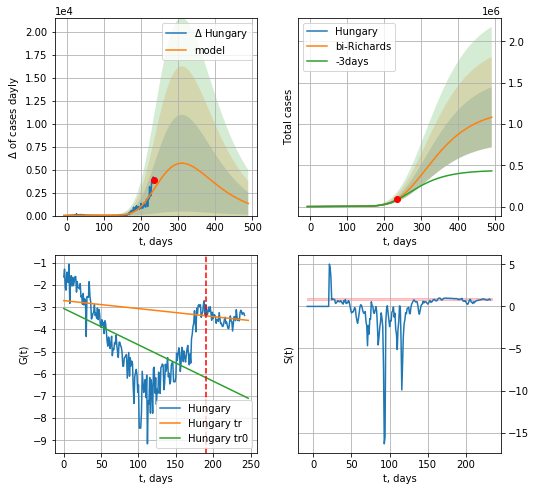

Hungary data at: 2020-11-04
+3 day model MAPE: 0.065663
model: bi-Richards
coeffs: [1.17586796e+06 8.22585526e-01 9.18993588e-02 1.61481451e-02]
rational stdev: 0.336669
forecast at the end of period: +255 days
	 deltaDaycases: 1324
	 total cases: 1082639 ± 364491
	 total death: 24489 ± 24734
bi-Richards approximation splitting point: 190
trend coefficient of determination: 0.270607
 intercept: -3.060214
 slope: -0.016366
trend coefficient of determination: 0.043220
 intercept: -2.702669
 slope: -0.003601


In [4916]:
vL = 190#130
x = forecastRR("Hungary",dfHG[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Hungary",dfHG[:],d1,68*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [4917]:
#x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


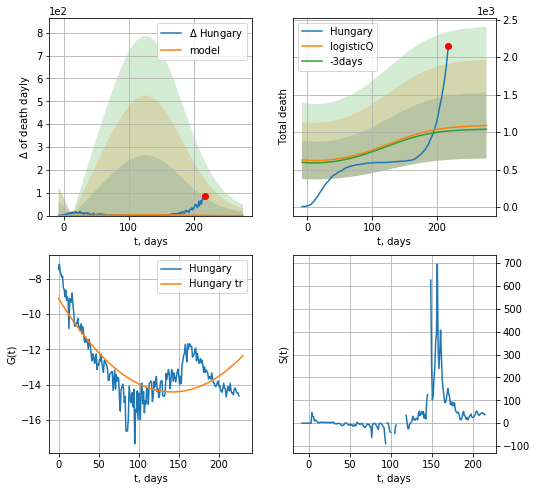

Hungary data at: 2020-11-04
+3 day model MAPE: 0.042872
model: logisticQ
coeffs: [9.21340254e+02 8.14859159e-05 2.22555715e+01 3.14166709e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.403014
forecast at the end of period: +59 days
	 total death: 1088 ± 438
trend coefficient of determination: 0.600153
 intercept_: -9.118176309530382
 coeffs_: [ 0.         -0.07477657  0.00026394]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide


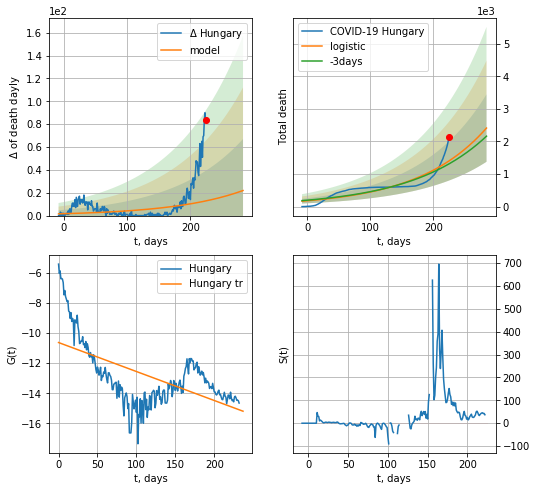

Hungary data at: 2020-11-04
+3 day model MAPE: 0.06984143256732618
model: logistic
coeffs:  [5.66089864e+06 9.13915055e-03 1.13315495e+03]
rational stdev:  0.4289613817275441
forecast at the end of period: +59 days
	 total death:  2411 ± 1034
trend coefficient of determination: 0.359431
 intercept: -10.629471
 slope: -0.019224


In [4918]:
x = forecastRRR("Hungary",dfHG[17:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,T18*7-dT,cases='death')

In [4919]:
try:
    dfMT = read_df(pd.DataFrame(),"MT")
    #x = forecast("Malta",dfMT[:15],d1,7*T18-dT,pMAPE=False)
    #xx = forecast2("Malta",dfMT[:],d1,7*T18-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])
except:
    print("Exception occurs")

MT
           date   cases  active  death
237 2020-10-31  6111.0    1825   62.0
238 2020-11-01  6182.0    1832   64.0
239 2020-11-02  6400.0    1937   66.0
240 2020-11-03  6506.0    1937   64.0
241 2020-11-04  6590.0    1853   65.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


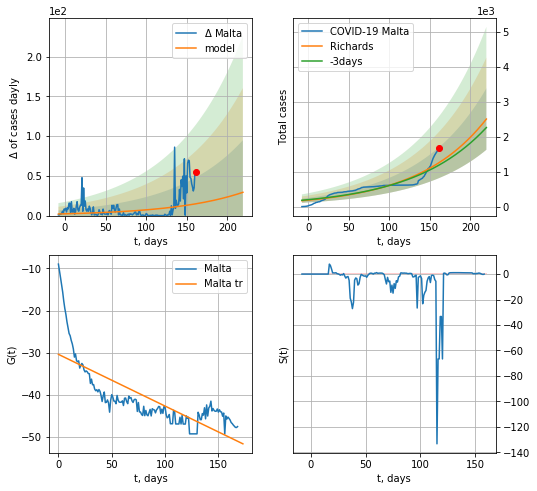

Malta data at: 2020-11-04
+3 day model MAPE: 0.058506
model: Richards
coeffs: [1.79480999e+04 1.17638464e-02 3.87365718e+02 5.94374794e+00]
rational stdev: 0.350416
forecast at the end of period: +59 days
	 deltaDaycases: 29
	 total cases: 2505 ± 878
	 total death: 24 ± 25
trend coefficient of determination: 0.590889
 intercept: -30.386213
 slope: -0.122562


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


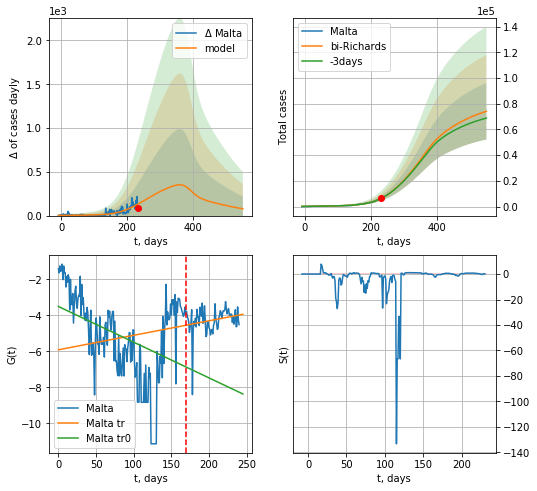

Malta data at: 2020-11-04
+3 day model MAPE: 0.004953
model: bi-Richards
coeffs: [ 6.50080404e+04  5.70034121e-01 -8.77630604e+01  1.65258787e-02]
rational stdev: 0.295542
forecast at the end of period: +318 days
	 deltaDaycases: 78
	 total cases: 74056 ± 21886
	 total death: 730 ± 647
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.171706
 intercept: -3.501376
 slope: -0.019853
trend coefficient of determination: 0.059528
 intercept: -5.908769
 slope: 0.008053


In [4920]:
vL = 170#112
x = forecastRR("Malta",dfMT[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Malta",dfMT[:],d12f(1),77*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [4921]:
#x = forecastRRR("Malta",dfMT[:30],d1,T18*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
#xx = forecast2RRR("Malta",dfMT[:],d1,40*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

In [4922]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
#try:
#    x = forecast("Slovakia",dfSL[:10],d1,T18*7-dT,pMAPE=False)
#    xx = forecast2("Slovakia",dfSL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
#except:
#    print("Exception ocurs")

SL
           date    cases   active  death
235 2020-10-31  59946.0  46929.0  219.0
236 2020-11-01  61829.0  48598.0  219.0
237 2020-11-02  62686.0  48598.0  219.0
238 2020-11-03  63556.0  49064.0  235.0
239 2020-11-04  68734.0  52022.0  286.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


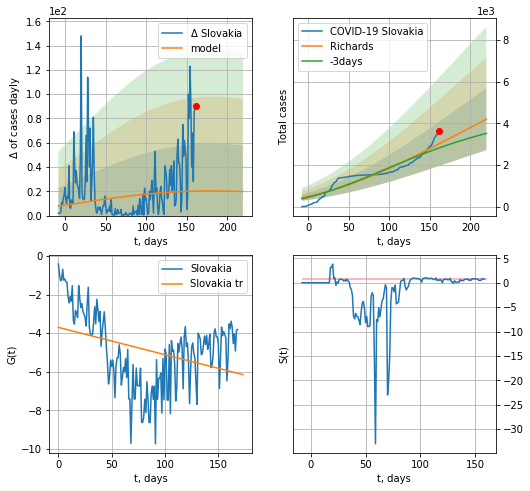

Slovakia data at: 2020-11-04
+3 day model MAPE: 0.071099
model: Richards
coeffs: [ 9.22154238e+03  4.41676744e-01 -5.31921240e+02  1.36332717e-02]
rational stdev: 0.352489
forecast at the end of period: +59 days
	 deltaDaycases: 19
	 total cases: 4192 ± 1477
	 total death: 17 ± 17
trend coefficient of determination: 0.127387
 intercept: -3.700946
 slope: -0.014153


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


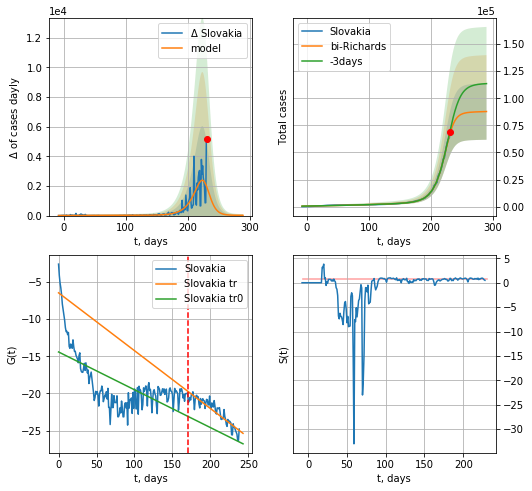

Slovakia data at: 2020-11-04
+3 day model MAPE: 0.042028
model: bi-Richards
coeffs: [8.22921332e+04 7.47644258e-02 2.28555097e+02 1.99275234e+00]
rational stdev: 0.296677
forecast at the end of period: +59 days
	 deltaDaycases: 17
	 total cases: 87780 ± 26042
	 total death: 365 ± 324
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.410678
 intercept: -14.413723
 slope: -0.050864
trend coefficient of determination: 0.826292
 intercept: -6.458258
 slope: -0.077804


In [4923]:
vL = 170
x = forecastRR("Slovakia",dfSL[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovakia",dfSL[:],d12f(1),40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [4924]:
#x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

In [4925]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
#try:
#    x = forecast("Slovenia",dfSV[:10],d1,7*T18-dT,pMAPE=False)
#    xx = forecast2("Slovenia",dfSV[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
#except:
#    print ("Exception occurs")

SV
           date    cases   active  death
240 2020-10-31  35649.0  22501.0  363.0
241 2020-11-01  35926.0  22501.0  363.0
242 2020-11-02  36206.0  22521.0  388.0
243 2020-11-03  37382.0  22896.0  412.0
244 2020-11-04  39408.0  23417.0  441.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


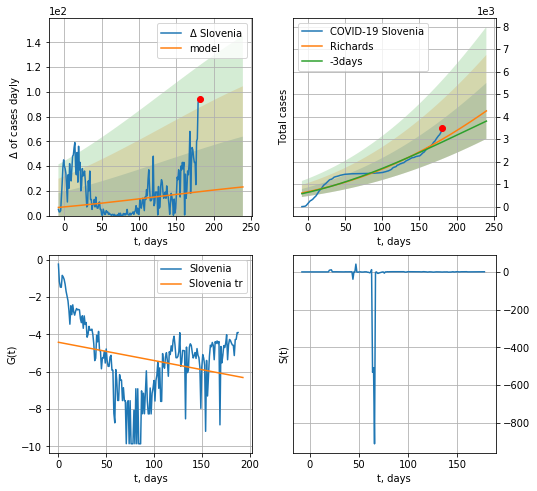

Slovenia data at: 2020-11-04
+3 day model MAPE: 0.043655
model: Richards
coeffs: [ 2.70400717e+04  8.50477759e-02 -6.41573816e+02  3.57785297e-02]
rational stdev: 0.292464
forecast at the end of period: +59 days
	 deltaDaycases: 23
	 total cases: 4256 ± 1244
	 total death: 47 ± 41
trend coefficient of determination: 0.069976
 intercept: -4.426936
 slope: -0.009764


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


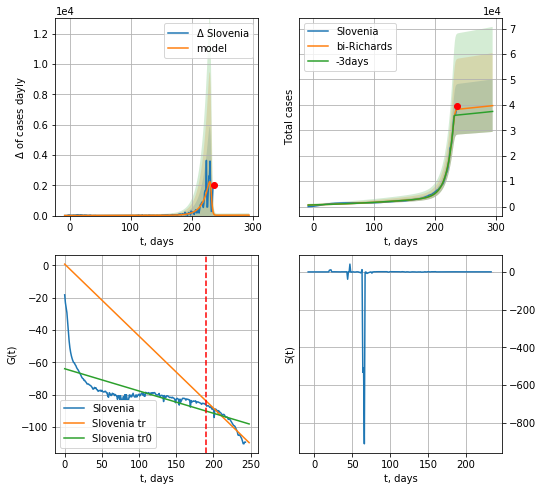

Slovenia data at: 2020-11-04
+3 day model MAPE: 0.061582
model: bi-Richards
coeffs: [3.40684697e+04 9.17908490e-02 2.32553298e+02 1.00531741e+01]
rational stdev: 0.259995
forecast at the end of period: +59 days
	 deltaDaycases: 26
	 total cases: 39683 ± 10317
	 total death: 444 ± 346
bi-Richards approximation splitting point: 190
trend coefficient of determination: 0.465844
 intercept: -63.932644
 slope: -0.137766
trend coefficient of determination: 0.922537
 intercept: 0.806110
 slope: -0.445481


In [4928]:
vL = 190
x = forecastRR("Slovenia",dfSV[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovenia",dfSV[:],d12f(1),40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [4929]:
#print(koreaCoeffs)
#x = forecastRRR("Slovenia",dfSV[:10],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR("Slovenia",dfSV[:],d1,T18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
           date  cases   active  death
235 2020-10-31  46954  14598.0  820.0
236 2020-11-01  48403  16041.0  826.0
237 2020-11-02  49205  16836.0  833.0
238 2020-11-03  51083  18703.0  844.0
239 2020-11-04  53495  21109.0  850.0


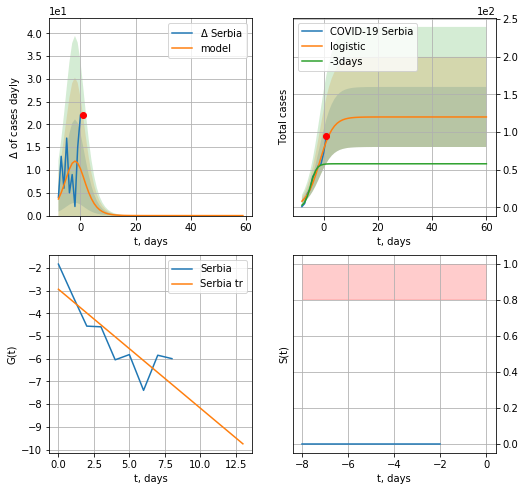

Serbia data at: 2020-11-04
model: logistic
coeffs:  [119.86808879   0.40041875  -1.48148474]
rational stdev:  0.33210329199703215
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  119 ± 39
	 total death:  1 ± 0
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


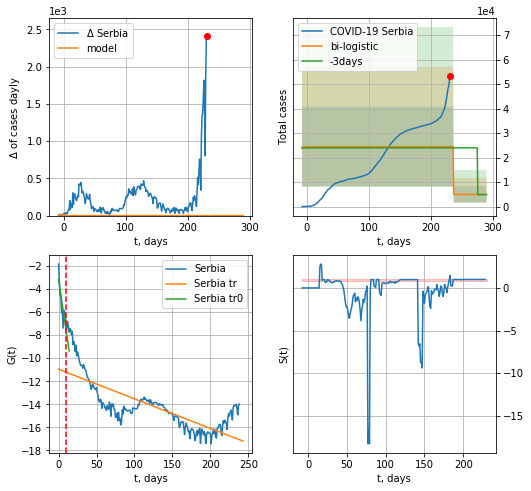

Serbia data at: 2020-11-04
+3 day model MAPE: 0.020863034424891375
model: bi-logistic
coeffs:  [19501.38892812   -20.82144788   236.80384875] [119.86808879   0.40041875  -1.48148474]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.6651571235507068
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  4995 ± 3322
	 total death:  79 ± 157
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.589329
 intercept: -10.955095
 slope: -0.025681


In [4930]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,T18*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


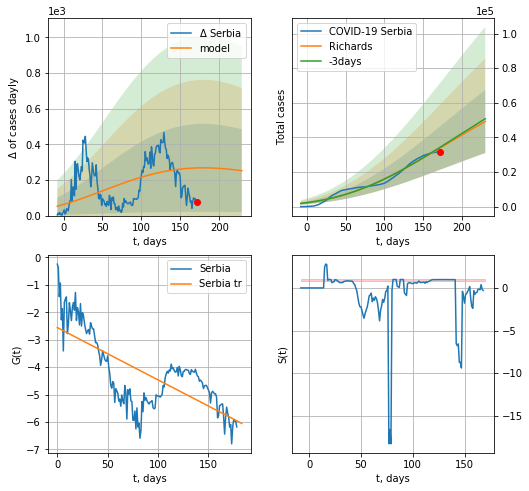

Serbia data at: 2020-11-04
+3 day model MAPE: 0.012817
model: Richards
coeffs: [ 9.73409225e+04  5.07695386e-01 -3.77960441e+02  1.48584660e-02]
rational stdev: 0.370374
forecast at the end of period: +59 days
	 deltaDaycases: 252
	 total cases: 49194 ± 18220
	 total death: 781 ± 867
trend coefficient of determination: 0.522326
 intercept: -2.559756
 slope: -0.019070


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


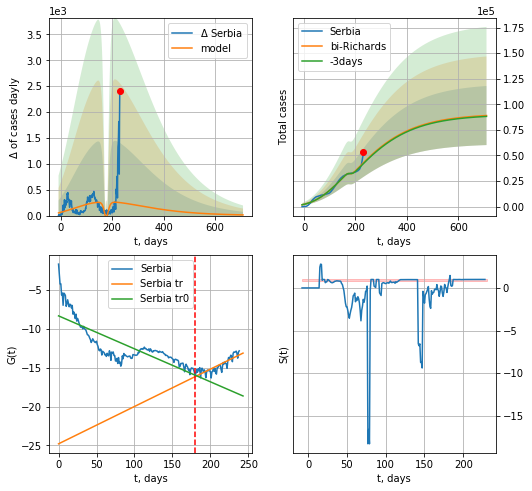

Serbia data at: 2020-11-04
+3 day model MAPE: 0.019942
model: bi-Richards
coeffs: [-6.50017051e+03  2.02968820e-01  1.77078106e+02  8.93228104e-01]
rational stdev: 0.324299
forecast at the end of period: +479 days
	 deltaDaycases: 13
	 total cases: 89070 ± 28885
	 total death: 1415 ± 1376
bi-Richards approximation splitting point: 180
trend coefficient of determination: 0.652719
 intercept: -8.322080
 slope: -0.042424
trend coefficient of determination: 0.722272
 intercept: -24.789734
 slope: 0.048040


In [4931]:
iL=0
vL=180+iL
x = forecastRR("Serbia",dfSB[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Serbia",dfSB[iL:],d1,100*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [4932]:
#x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

In [4933]:
try:
    dfCT = read_df(pd.DataFrame(),"CT")
    dfCT = dfCT.fillna(0)
    #x = forecast("Croatia",dfCT[:10],d1,T18*7-dT,pMAPE=False)
    #xx = forecast2("Croatia",dfCT[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)
except:
    print ("Exception occurs")

CT
           date    cases   active  death
245 2020-10-31  51495.0  15894.0  562.0
246 2020-11-01  52660.0  14734.0  594.0
247 2020-11-02  53368.0  14734.0  594.0
248 2020-11-03  54087.0  14079.0  628.0
249 2020-11-04  59415.0  15356.0  683.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


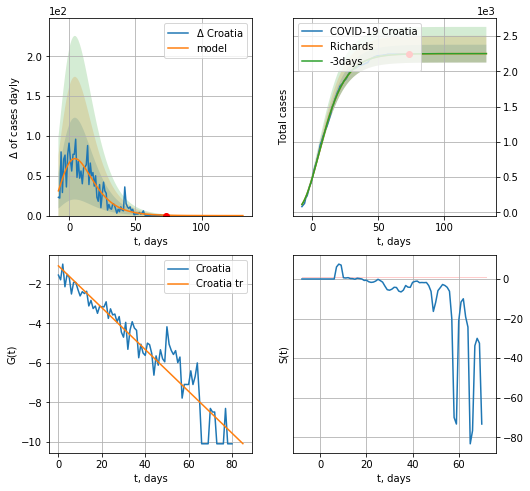

Croatia data at: 2020-11-04
+3 day model MAPE: 0.000062
model: Richards
coeffs: [ 2.25221314e+03  8.22861964e+00 -4.74876633e+01  1.05637631e-02]
rational stdev: 0.056077
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 2252 ± 126
	 total death: 25 ± 4
trend coefficient of determination: 0.906222
 intercept: -1.091343
 slope: -0.105900


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


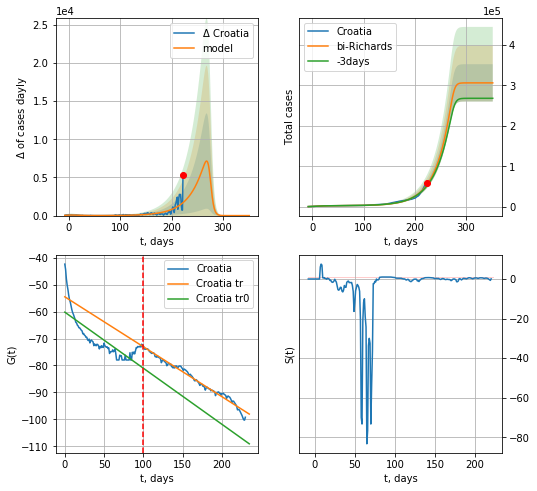

Croatia data at: 2020-11-04
+3 day model MAPE: 0.051752
model: bi-Richards
coeffs: [3.04041200e+05 3.39740116e-02 2.75693433e+02 8.80400436e+00]
rational stdev: 0.150715
forecast at the end of period: +129 days
	 deltaDaycases: 0
	 total cases: 306293 ± 46163
	 total death: 3520 ± 1591
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.627873
 intercept: -60.213793
 slope: -0.207795
trend coefficient of determination: 0.980885
 intercept: -54.522848
 slope: -0.185067


In [4934]:
iL = 18
vL = 100+iL
x = forecastRR("Croatia",dfCT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Croatia",dfCT[iL:],d12f(1),50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [4935]:
#x = forecastRRR("Croatia",dfCT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

In [4936]:
dfEG = read_df(pd.DataFrame(),"EG")
#x = forecast("Egypt",dfEG[:8],d1,7*T18-dT)
#xx = forecast2("Egypt",dfEG[:],d1,30*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

EG
           date   cases  active   death
239 2020-10-31  107555    1837  6266.0
240 2020-11-01  107736    1903  6278.0
241 2020-11-02  107925    1982  6291.0
242 2020-11-03  108122    2052  6305.0
243 2020-11-04  108329    2137  6318.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


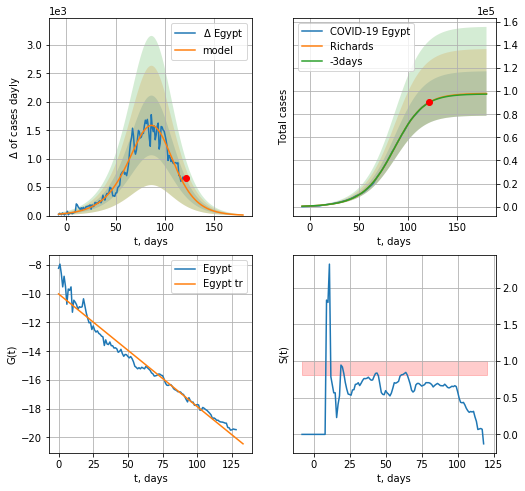

Egypt data at: 2020-11-04
+3 day model MAPE: 0.002349
model: Richards
coeffs: [9.80452652e+04 5.49784423e-02 9.01515288e+01 1.27472002e+00]
rational stdev: 0.196169
forecast at the end of period: +59 days
	 deltaDaycases: 10
	 total cases: 97903 ± 19205
	 total death: 5709 ± 3359
trend coefficient of determination: 0.969341
 intercept: -10.012670
 slope: -0.078415


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


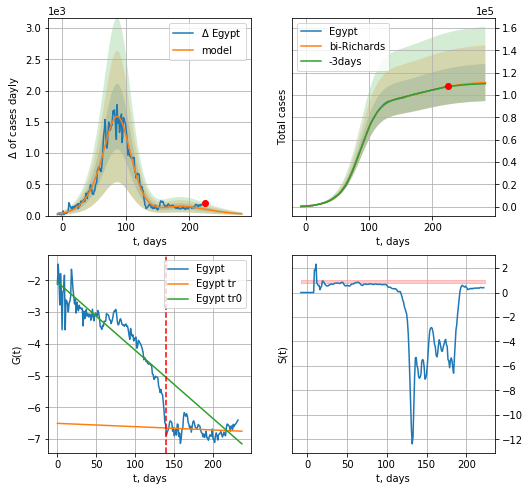

Egypt data at: 2020-11-04
+3 day model MAPE: 0.002619
model: bi-Richards
coeffs: [1.42038877e+04 2.31596002e+00 3.03304243e+01 1.19512026e-02]
rational stdev: 0.149399
forecast at the end of period: +59 days
	 deltaDaycases: 27
	 total cases: 111227 ± 16617
	 total death: 6487 ± 2907
bi-Richards approximation splitting point: 140
trend coefficient of determination: 0.798895
 intercept: -2.053484
 slope: -0.021491
trend coefficient of determination: 0.017428
 intercept: -6.502205
 slope: -0.001041


In [4937]:
iL = 10
vL = 140+iL
x = forecastRR("Egypt",dfEG[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Egypt",dfEG[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [4938]:
#x = forecastRRR("Egypt",dfEG[12:],d1,85*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
           date   cases   active    death
242 2020-10-31  473957  62065.0  10910.0
243 2020-11-01  475288  61540.0  10966.0
244 2020-11-02  478701  61907.0  11017.0
245 2020-11-03  482296  62472.0  11068.0
246 2020-11-04  485870  57507.0  11128.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


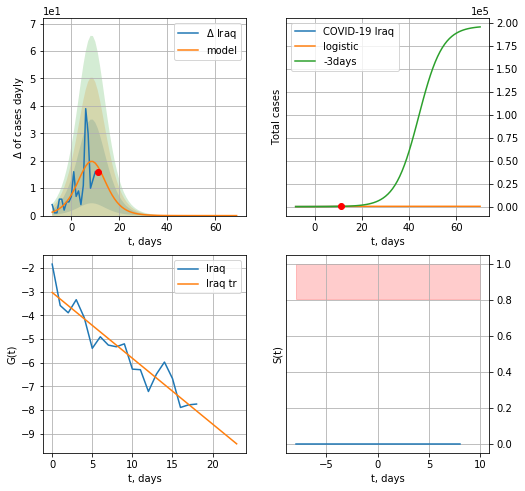

Iraq data at: 2020-11-04
+3 day model MAPE: 0.34474037669474106
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  317 ± 65
	 total death:  7 ± 4
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


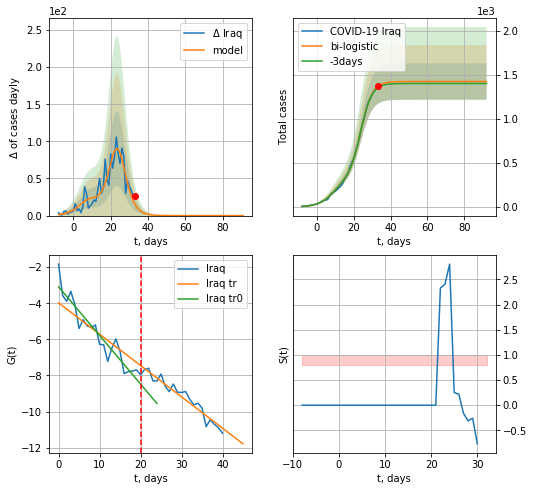

Iraq data at: 2020-11-04
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  1425 ± 207
	 total death:  32 ± 13
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:353: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


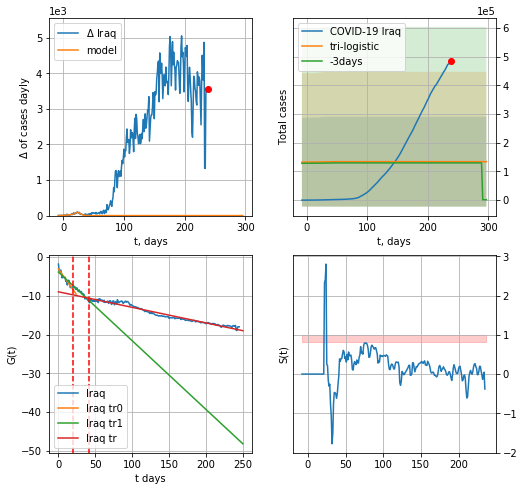

Iraq data at: 2020-11-04
+3 day model MAPE: 0.032968405581010767
model: tri-logistic
coeffs:  [ 1.32697942e+05 -1.22208753e+01  2.98926957e+02] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  1.167678904855217
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  134123 ± 156613
	 total death:  3071 ± 10757
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.959381
 intercept: -8.969910
 slope: -0.040123


In [4939]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,T18*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


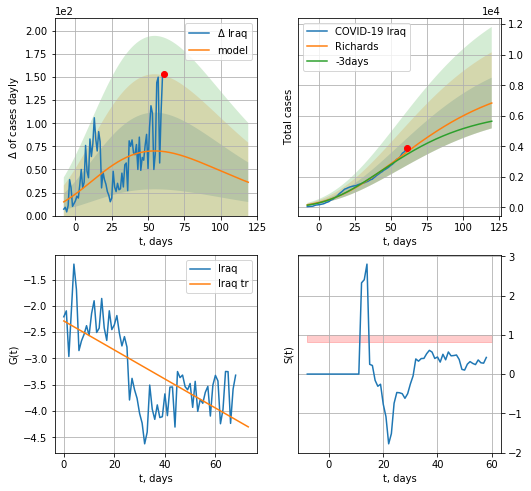

Iraq data at: 2020-11-04
+3 day model MAPE: 0.049876
model: Richards
coeffs: [ 8.66913850e+03  2.11659471e+00 -1.51652885e+02  1.04324891e-02]
rational stdev: 0.242987
forecast at the end of period: +59 days
	 deltaDaycases: 36
	 total cases: 6835 ± 1660
	 total death: 156 ± 113
trend coefficient of determination: 0.498225
 intercept: -2.287589
 slope: -0.027573


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


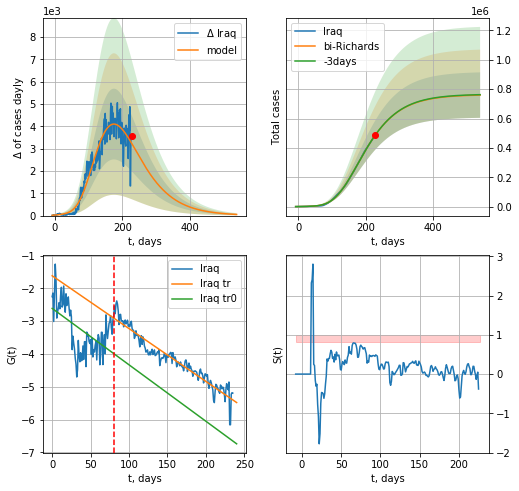

Iraq data at: 2020-11-04
+3 day model MAPE: 0.000826
model: bi-Richards
coeffs: [ 7.54430991e+05  6.89887659e-01 -8.23525266e+01  2.15697398e-02]
rational stdev: 0.203815
forecast at the end of period: +311 days
	 deltaDaycases: 50
	 total cases: 759733 ± 154845
	 total death: 17400 ± 10639
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.286933
 intercept: -2.611162
 slope: -0.017207
trend coefficient of determination: 0.920254
 intercept: -1.616360
 slope: -0.016108


In [4940]:
iL = 10
vL=80+iL#25+10
x = forecastRR("Iraq",dfIQ[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iraq",dfIQ[iL:],d1,76*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [4941]:
#x = forecastRRR("Iraq",dfIQ[9:42],d1,T18*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
#xx = forecast2RRR("Iraq",dfIQ[9:],d1,24*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=42)

In [4942]:
#len(dfAR)

AR
           date    cases   active   death
241 2020-10-31  57942.0  15777.0  1964.0
242 2020-11-01  58272.0  15904.0  1973.0
243 2020-11-02  58574.0  16017.0  1980.0
244 2020-11-03  58979.0  16422.0  1980.0
245 2020-11-04  59527.0  16527.0  1999.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


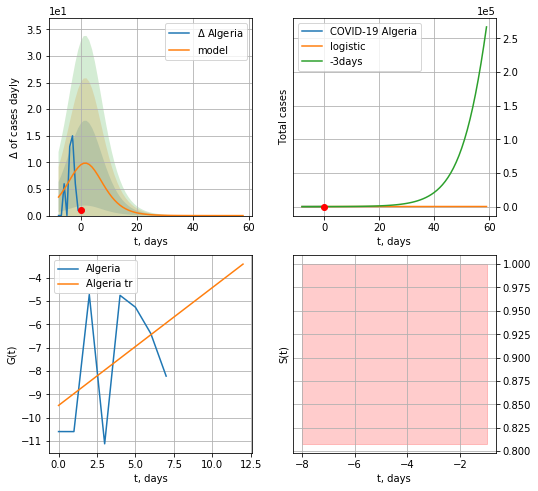

Algeria data at: 2020-11-04
+3 day model MAPE: 0.16392519582549905
model: logistic
coeffs:  [169.67149558   0.23328995   2.04236169]
rational stdev:  0.1546785167835457
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  169 ± 26
	 total death:  5 ± 2
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


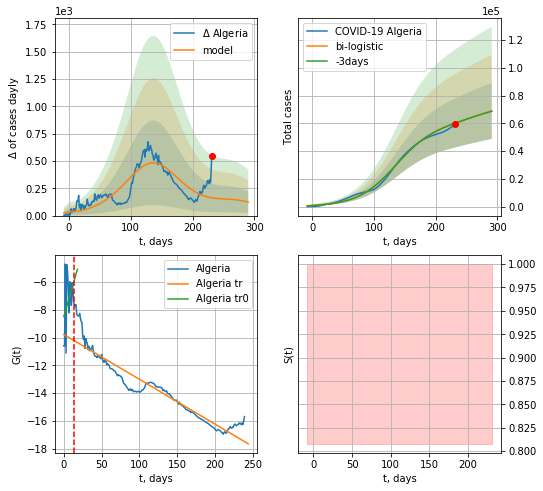

Algeria data at: 2020-11-04
+3 day model MAPE: 0.003471289786295495
model: bi-logistic
coeffs:  [5.96394347e+04 3.19449611e-02 1.36277278e+02] [169.67149558   0.23328995   2.04236169]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.2924610817597468
forecast at the end of period: +59 days
	 deltaDaycases:  123
	 total cases:  68976 ± 20172
	 total death:  2316 ± 2032
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.899725
 intercept: -9.785004
 slope: -0.032174


In [4943]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*T18-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*T18-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


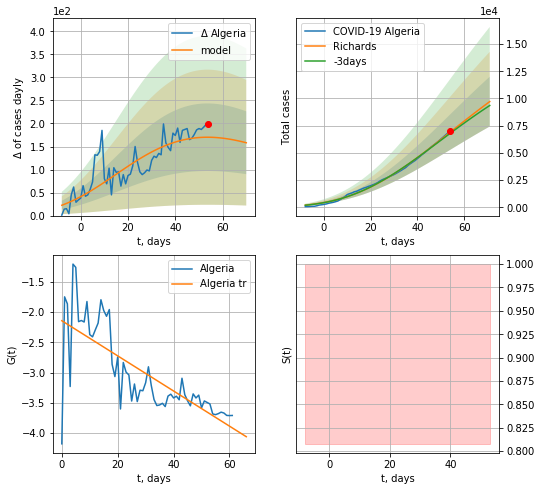

Algeria data at: 2020-11-04
+3 day model MAPE: 0.017361
model: Richards
coeffs: [ 1.86312269e+04  1.59750196e+00 -1.12063742e+02  1.56623086e-02]
rational stdev: 0.235608
forecast at the end of period: +17 days
	 deltaDaycases: 158
	 total cases: 9714 ± 2288
	 total death: 326 ± 230
trend coefficient of determination: 0.563244
 intercept: -2.140644
 slope: -0.029042


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


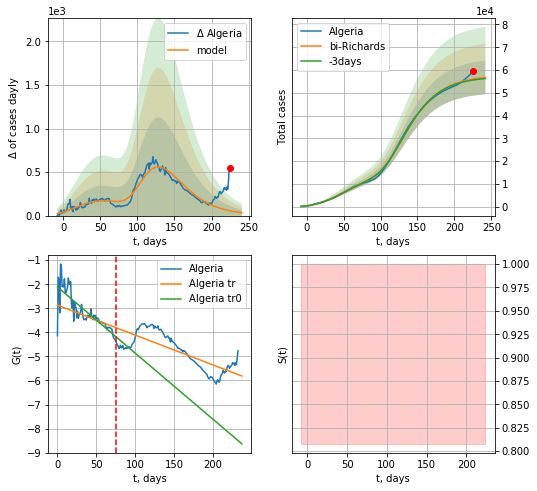

Algeria data at: 2020-11-04
+3 day model MAPE: 0.007582
model: bi-Richards
coeffs: [ 3.91177481e+04  4.92799644e+00 -1.18253482e+01  7.05011385e-03]
rational stdev: 0.130183
forecast at the end of period: +17 days
	 deltaDaycases: 32
	 total cases: 56768 ± 7390
	 total death: 1906 ± 744
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.667827
 intercept: -2.114402
 slope: -0.027500
trend coefficient of determination: 0.587919
 intercept: -2.869059
 slope: -0.012427


In [4944]:
vL = 75+12
x = forecastRR("Algeria",dfAR[12:vL-12],d1,34*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[12:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

In [4945]:
#x = forecastRRR("Algeria",dfAR[12:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
           date   cases  active  death
233 2020-10-31  4366.0  2458.0   26.0
234 2020-11-01  4563.0  2655.0   26.0
235 2020-11-02  4760.0  2851.0   27.0
236 2020-11-03  4934.0  3025.0   27.0
237 2020-11-04  5100.0  3191.0   27.0


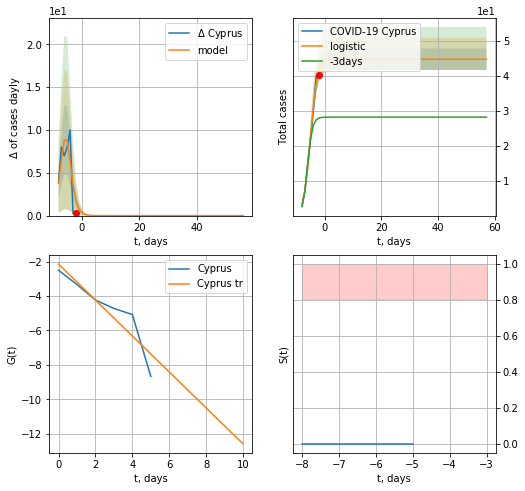

Cyprus data at: 2020-11-04
+3 day model MAPE: 0.5347775670777937
model: logistic
coeffs:  [44.71273924  0.83168064 -5.024159  ]
rational stdev:  0.06852146203610965
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  44 ± 3
	 total death:  0 ± 0
trend coefficient of determination: 0.837222
 intercept: -2.149855
 slope: -1.042802


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


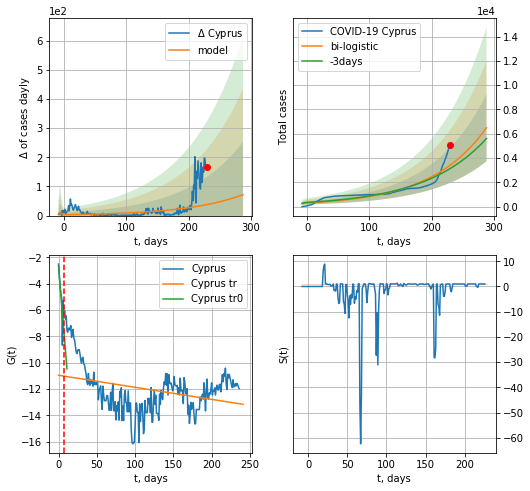

Cyprus data at: 2020-11-04
+3 day model MAPE: 0.08890971429047805
model: bi-logistic
coeffs:  [2.44323832e+07 1.11678835e-02 1.02561735e+03] [44.71273924  0.83168064 -5.024159  ]
rational stdev:  0.4248823662532497
forecast at the end of period: +59 days
	 deltaDaycases:  71
	 total cases:  6505 ± 2764
	 total death:  34 ± 43
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.605369
 intercept: -2.714226
 slope: -0.704180
trend coefficient of determination: 0.110761
 intercept: -10.949111
 slope: -0.009166


In [4946]:
try:
    dfCP = read_df(pd.DataFrame(),"CP")
    dfCP = dfCP.fillna(0)
    x = forecast("Cyprus",dfCP[:7],d1,7*T18-dT)
    xx = forecast2("Cyprus",dfCP[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


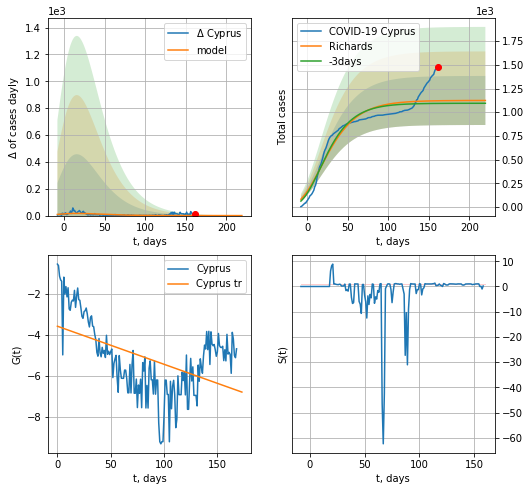

Cyprus data at: 2020-11-04
+3 day model MAPE: 0.025589
model: Richards
coeffs: [ 1.12435531e+03  1.26988122e+01 -1.28010603e+02  3.14446807e-03]
rational stdev: 0.230425
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 1124 ± 259
	 total death: 5 ± 3
trend coefficient of determination: 0.244510
 intercept: -3.586718
 slope: -0.018510


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


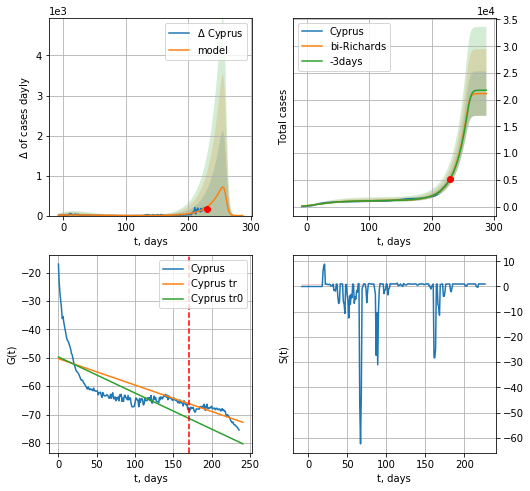

Cyprus data at: 2020-11-04
+3 day model MAPE: 0.013911
model: bi-Richards
coeffs: [2.00175641e+04 5.20468006e-02 2.60229692e+02 8.43675550e+00]
rational stdev: 0.196648
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 21141 ± 4157
	 total death: 111 ± 65
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.492051
 intercept: -49.701792
 slope: -0.126952
trend coefficient of determination: 0.587814
 intercept: -50.280069
 slope: -0.093053


In [4947]:
iL = 0
vL=170+iL
x = forecastRR("Cyprus",dfCP[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecast2RR("Cyprus",dfCP[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [4948]:
#vL=33
#x = forecastRRR("Cyprus",dfCP[:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
           date   cases   active    death
238 2020-10-31  902503  42830.0  34476.0
239 2020-11-01  904911  42769.0  34529.0
240 2020-11-02  906545  41348.0  34585.0
241 2020-11-03  908902  41350.0  34623.0
242 2020-11-04  911787  41422.0  34671.0


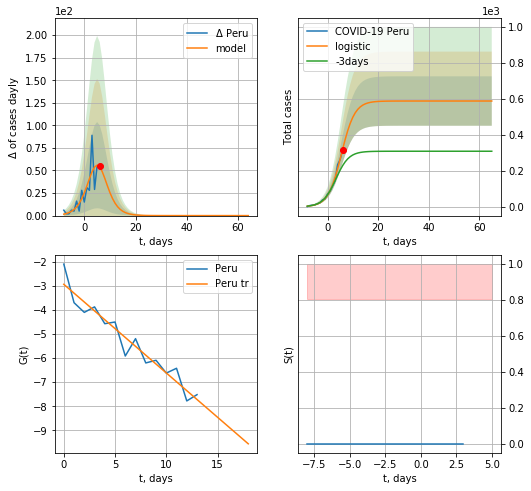

Peru data at: 2020-11-04
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  588 ± 137
	 total death:  22 ± 15
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


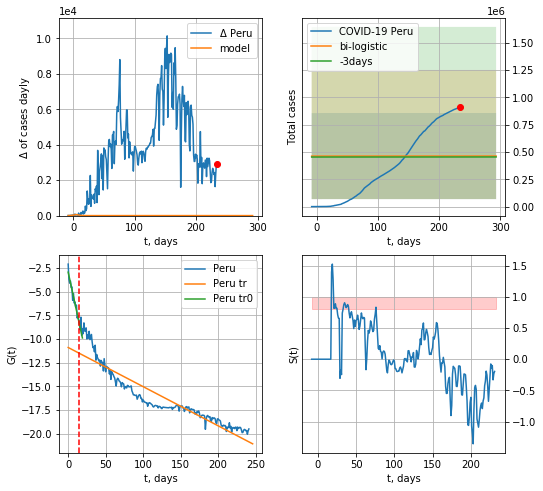

Peru data at: 2020-11-04
+3 day model MAPE: 0.018499020411226603
model: bi-logistic
coeffs:  [ 3.70072980e+05 -4.19882878e+01  1.00270126e+03] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.851606616180968
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  463180 ± 394447
	 total death:  17612 ± 44995
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.858357
 intercept: -10.891079
 slope: -0.041284


In [4949]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*T18-dT)
xx = forecast2("Peru",dfPU[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


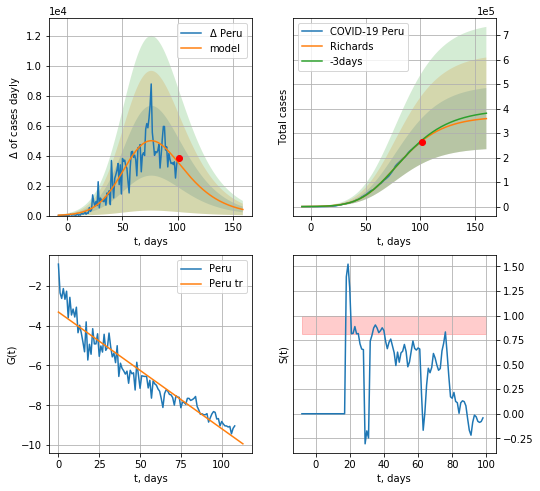

Peru data at: 2020-11-04
+3 day model MAPE: 0.011915
model: Richards
coeffs: [3.68474787e+05 1.13868989e-01 5.48653842e+01 3.85481107e-01]
rational stdev: 0.347400
forecast at the end of period: +59 days
	 deltaDaycases: 409
	 total cases: 359173 ± 124776
	 total death: 13657 ± 14233
trend coefficient of determination: 0.910589
 intercept: -3.314617
 slope: -0.058598


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


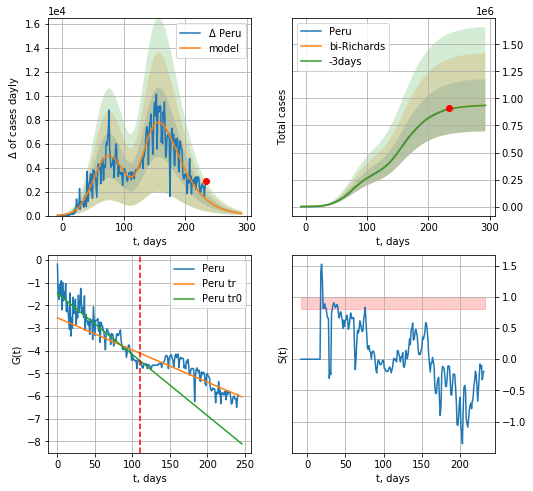

Peru data at: 2020-11-04
+3 day model MAPE: 0.001836
model: bi-Richards
coeffs: [5.74184327e+05 2.70280675e+00 3.51513001e+01 1.29681610e-02]
rational stdev: 0.257496
forecast at the end of period: +59 days
	 deltaDaycases: 187
	 total cases: 937393 ± 241375
	 total death: 35644 ± 27534
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.803947
 intercept: -1.469361
 slope: -0.026975
trend coefficient of determination: 0.695465
 intercept: -2.547882
 slope: -0.014187


In [4950]:
vL = 110
x = forecastRR("Peru",dfPU[:vL],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Peru",dfPU[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

In [4951]:
#x = forecastRRR("Peru",dfPU[:].fillna(0),d1,62*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
           date    cases    active     death
245 2020-10-31  8184082  570420.0  122149.0
246 2020-11-01  8230711  563262.0  122651.0
247 2020-11-02  8267623  541363.0  123139.0
248 2020-11-03  8313876  533748.0  123650.0
249 2020-11-04  8364086  527923.0  124354.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


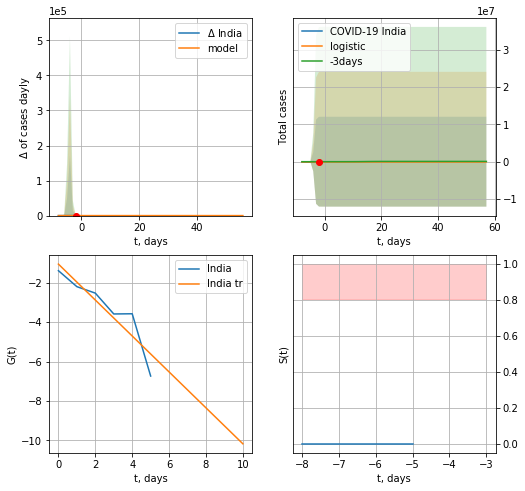

India data at: 2020-11-04
+3 day model MAPE: 0.19486002826260063
model: logistic
coeffs:  [29.4003363   4.01436821 -3.67575825]
rational stdev:  409417.6299021335
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  29 ± 12037016
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


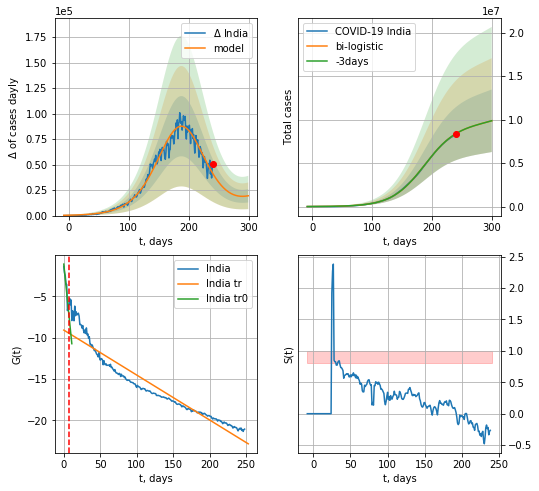

India data at: 2020-11-04
+3 day model MAPE: 3.107580027060842e-05
model: bi-logistic
coeffs:  [9.55524331e+06 3.65470812e-02 1.87943879e+02] [29.4003363   4.01436821 -3.67575825]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3642573416174775
forecast at the end of period: +59 days
	 deltaDaycases:  19429
	 total cases:  9871433 ± 3595742
	 total death:  146764 ± 160379
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.912431
 intercept: -9.091167
 slope: -0.054324


In [4952]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*T18-dT)
xx = forecast2("India",dfID[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


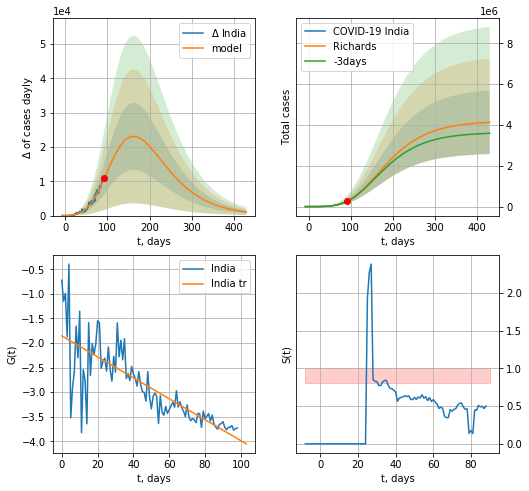

India data at: 2020-11-04
+3 day model MAPE: 0.006994
model: Richards
coeffs: [ 4.19766377e+06  3.32044249e-01 -3.85411502e+01  4.61089241e-02]
rational stdev: 0.377105
forecast at the end of period: +339 days
	 deltaDaycases: 1058
	 total cases: 4128471 ± 1556867
	 total death: 61380 ± 69440
trend coefficient of determination: 0.633758
 intercept: -1.855387
 slope: -0.021306


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


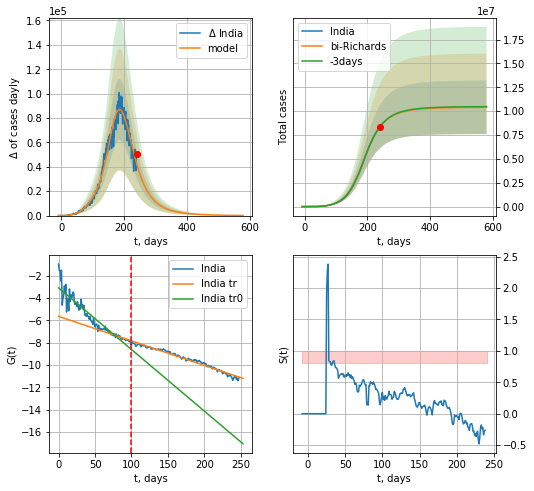

India data at: 2020-11-04
+3 day model MAPE: 0.001842
model: bi-Richards
coeffs: [6.21686027e+06 8.98493443e-02 1.59581589e+02 3.76270404e-01]
rational stdev: 0.269746
forecast at the end of period: +339 days
	 deltaDaycases: 108
	 total cases: 10407497 ± 2807380
	 total death: 154734 ± 125216
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.881500
 intercept: -3.077814
 slope: -0.055226
trend coefficient of determination: 0.975758
 intercept: -5.634968
 slope: -0.021958


In [4953]:
vL = 100
x = forecastRR("India",dfID[:vL],d1,80*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("India",dfID[:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [4954]:
#x = forecastRRR("India",dfID[31:].fillna(0),d1,86*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
           date      cases    active    death
241 2020-10-31  1166924.0  161983.0  31002.0
242 2020-11-01  1173533.0  157077.0  31140.0
243 2020-11-02  1183131.0  153492.0  31623.0
244 2020-11-03  1195276.0  153946.0  32052.0
245 2020-11-04  1205928.0  155761.0  32520.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


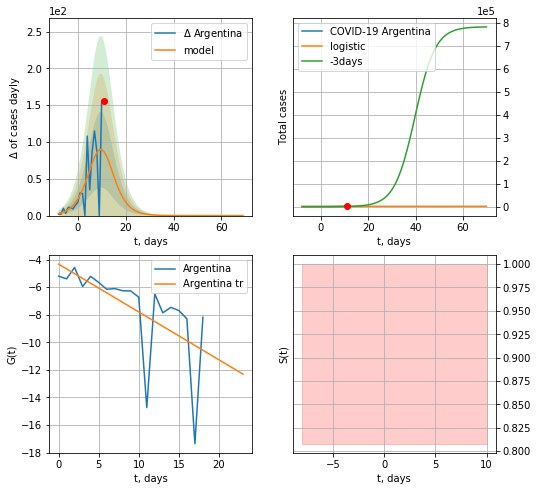

Argentina data at: 2020-11-04
+3 day model MAPE: 0.34277903234874524
model: logistic
coeffs:  [1.30607345e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.27772613105407934
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  1306 ± 362
	 total death:  35 ± 29
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


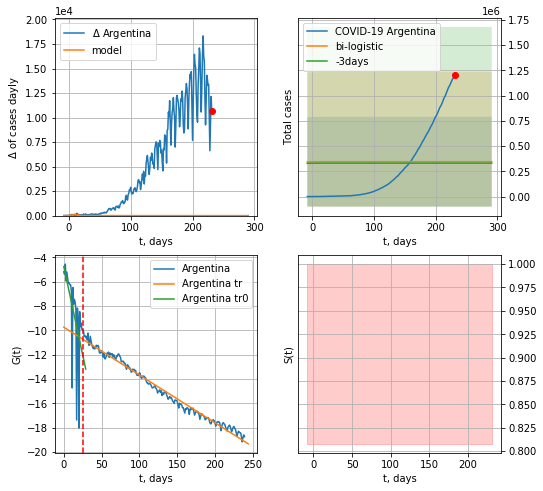

Argentina data at: 2020-11-04
+3 day model MAPE: 0.04369834131898291
model: bi-logistic
coeffs:  [ 2.75362201e+05 -2.28139613e+01  5.48387245e+02] [1.30607345e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.2866147284643936
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  345508 ± 444536
	 total death:  9317 ± 35962
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.984656
 intercept: -9.741606
 slope: -0.039233


In [4955]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*T18-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,T18*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

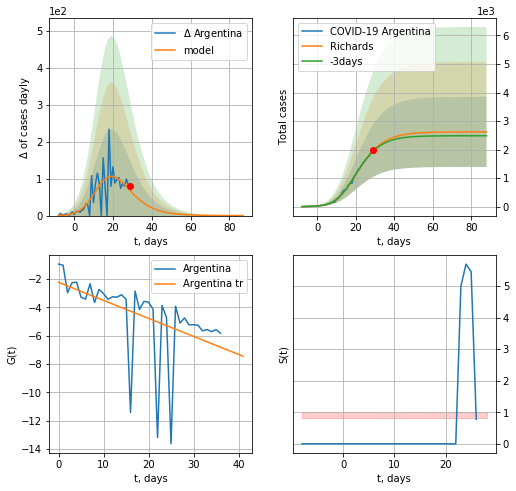

Argentina data at: 2020-11-04
+3 day model MAPE: 0.013138
model: Richards
coeffs: [2.62031767e+03 3.73237042e-01 1.15845098e+01 3.46306086e-01]
rational stdev: 0.468281
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 2619 ± 1226
	 total death: 70 ± 98
trend coefficient of determination: 0.244505
 intercept: -2.222432
 slope: -0.127357


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


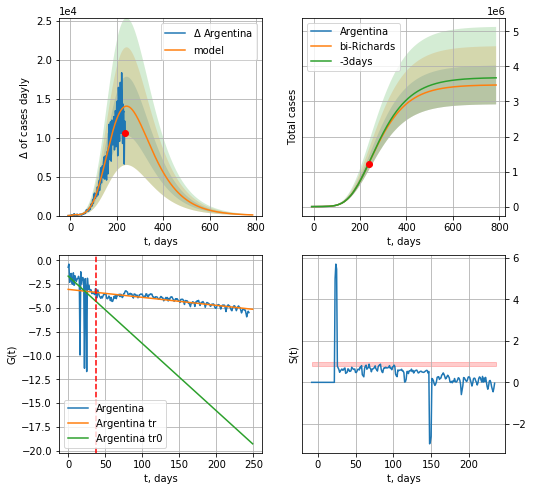

Argentina data at: 2020-11-04
+3 day model MAPE: 0.004861
model: bi-Richards
coeffs: [ 3.47532058e+06  2.08233640e-01 -1.48455787e+01  5.41822322e-02]
rational stdev: 0.159308
forecast at the end of period: +549 days
	 deltaDaycases: 86
	 total cases: 3470310 ± 552848
	 total death: 93583 ± 44725
bi-Richards approximation splitting point: 38
trend coefficient of determination: 0.097913
 intercept: -1.660673
 slope: -0.070689
trend coefficient of determination: 0.782148
 intercept: -3.050900
 slope: -0.008390


In [4956]:
vL = 38
x = forecastRR('Argentina',dfAG[:vL].fillna(0),d1,40*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Argentina',dfAG[:].fillna(0),d1,110*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [4957]:
#x = forecastRRR('Argentina',dfAG[10:],d1,104*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

In [4958]:
#vL=33
#x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*T18-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
#xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

QR
           date   cases  active  death
240 2020-10-31  132720  2704.0  232.0
241 2020-11-01  132818  2704.0  232.0
242 2020-11-02  132917  2689.0  232.0
243 2020-11-03  133143  2709.0  232.0
244 2020-11-04  133370  2724.0  232.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


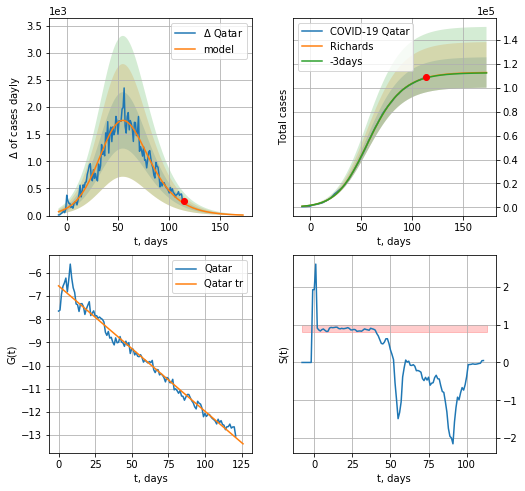

Qatar data at: 2020-11-04
+3 day model MAPE: 0.001883
model: Richards
coeffs: [1.13070089e+05 8.99170413e-02 4.60810469e+01 6.06536184e-01]
rational stdev: 0.112907
forecast at the end of period: +59 days
	 deltaDaycases: 10
	 total cases: 112886 ± 12745
	 total death: 196 ± 66
trend coefficient of determination: 0.979229
 intercept: -6.558422
 slope: -0.054146


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


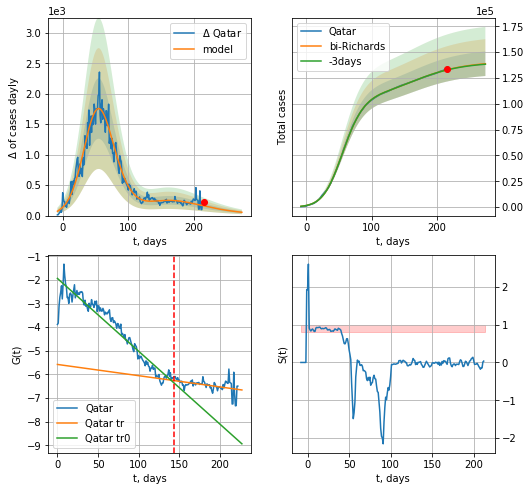

Qatar data at: 2020-11-04
+3 day model MAPE: 0.001175
model: bi-Richards
coeffs: [ 2.82073056e+04  2.25472362e+00 -3.21326259e+01  1.01142747e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.085562
forecast at the end of period: +59 days
	 deltaDaycases: 54
	 total cases: 138802 ± 11876
	 total death: 241 ± 61
bi-Richards approximation splitting point: 144
trend coefficient of determination: 0.918170
 intercept: -1.937874
 slope: -0.030842
trend coefficient of determination: 0.178905
 intercept: -5.579099
 slope: -0.004758


In [4959]:
iL = 21
vL = 144 + iL
dfQR = read_df(pd.DataFrame(),"QR")
x = forecastRR('Qatar',dfQR[iL:vL-iL].fillna(0),d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Qatar',dfQR[iL:].fillna(0),d12f(1),40*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL)

In [4960]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date     cases  active  death
259 2020-10-31  133907.0    2903  496.0
260 2020-11-01  134522.0    2903  496.0
261 2020-11-02  135141.0    2620  497.0
262 2020-11-03  136149.0    2156  503.0
263 2020-11-04  137310.0    1822  505.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


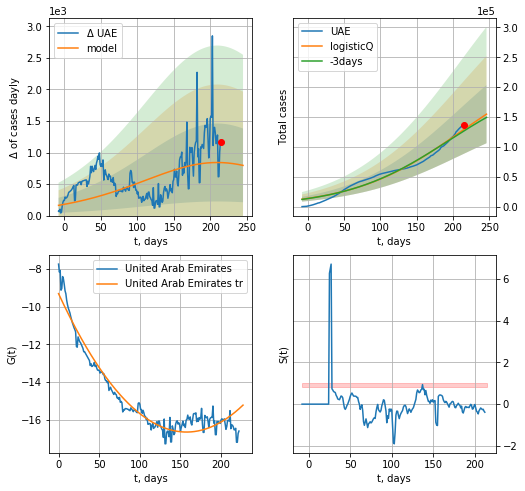

UAE data at: 2020-11-04
+3 day model MAPE: 0.019290
model: logisticQ
coeffs: [ 2.48063163e+05  7.35566899e-08  2.09528959e+02 -1.83289725e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.314019
forecast at the end of period: +31 days
	 deltaDaycases: 796
	 total cases: 154904 ± 48642
	 total death: 569 ± 536
trend coefficient of determination: 0.941924
 intercept_: -9.301156352399751
 coeffs_: [ 0.         -0.09339527  0.00029647]


In [4961]:
try:
    dfUAE = read_df(pd.DataFrame(),"UAE")
    x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


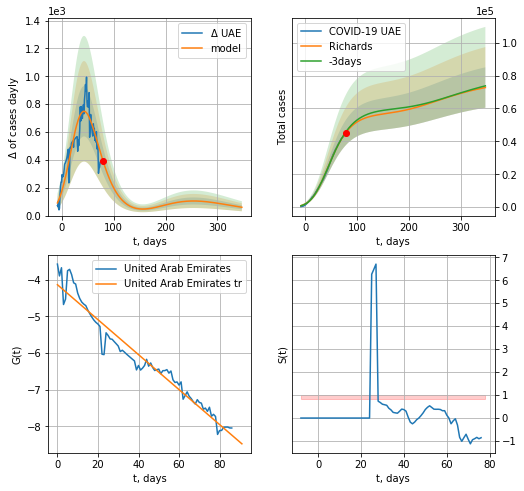

UAE data at: 2020-11-04
+3 day model MAPE: 0.009864
model: Richards
coeffs: [5.69575832e+04 1.33404785e-01 1.50634020e+01 3.08321872e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.168958
forecast at the end of period: +269 days
	 deltaDaycases: 59
	 total cases: 72716 ± 12285
	 total death: 267 ± 135
trend coefficient of determination: 0.950927
 intercept: -4.139656
 slope: -0.047646


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


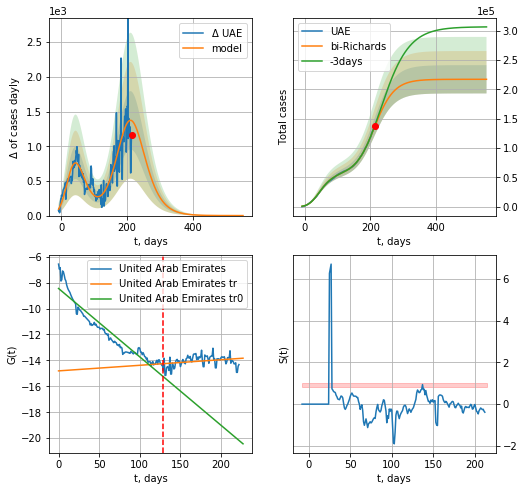

UAE data at: 2020-11-04
+3 day model MAPE: 0.012776
model: bi-Richards
coeffs: [1.60285101e+05 3.98636991e-02 2.04804566e+02 8.07568658e-01]
rational stdev: 0.110850
forecast at the end of period: +339 days
	 deltaDaycases: 0
	 total cases: 217240 ± 24081
	 total death: 798 ± 265
bi-Richards approximation splitting point: 128
trend coefficient of determination: 0.911593
 intercept: -8.454259
 slope: -0.052776
trend coefficient of determination: 0.077405
 intercept: -14.809433
 slope: 0.004304


In [4962]:
iL = 40
vL = 128 + iL
x = forecastRR('UAE',dfUAE[iL:vL-iL],d1,70*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('UAE',dfUAE[iL:],d1,80*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [4963]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

In [4964]:
dfSA = read_df(pd.DataFrame(),"SA")
#x = forecastRRR('Saudi Arabia',dfSA[:],d1,76*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

SA
           date     cases  active   death
242 2020-10-31  347282.0    8038  5402.0
243 2020-11-01  347656.0    8000  5420.0
244 2020-11-02  348037.0    7928  5437.0
245 2020-11-03  348510.0    7901  5456.0
246 2020-11-04  348936.0    7871  5471.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


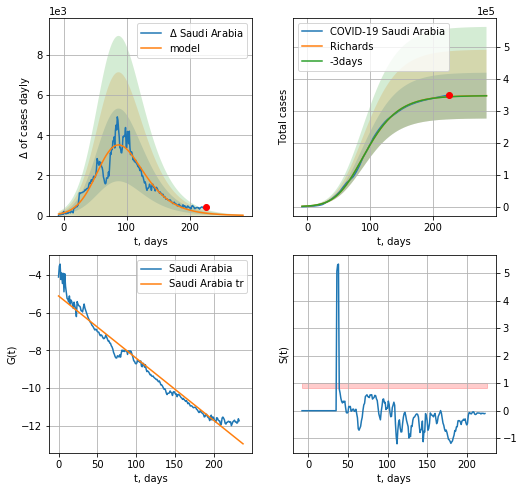

Saudi Arabia data at: 2020-11-04
+3 day model MAPE: 0.001391
model: Richards
coeffs: [3.47139985e+05 8.35179398e-02 5.90033389e+01 3.93326579e-01]
rational stdev: 0.206376
forecast at the end of period: +59 days
	 deltaDaycases: 17
	 total cases: 346613 ± 71532
	 total death: 5434 ± 3364
trend coefficient of determination: 0.964358
 intercept: -5.108889
 slope: -0.032951


In [4965]:
x = forecastRR('Saudi Arabia',dfSA[12:],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Saudi Arabia',dfSA[12:],d1,27*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=75)
#x = forecastQR('Saudi Arabia',dfSA[12:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [4966]:
try:
    dfSri = read_df(pd.DataFrame(),"Sri")
    vL= 30
    #x = forecastRRR('Sri Lanka',dfSri[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    #xx = forecast2RRR('Sri Lanka',dfSri[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

Sri
           date    cases  active  death
235 2020-10-31  10663.0    6244   20.0
236 2020-11-01  11060.0    5789   22.0
237 2020-11-02  11335.0    6065   21.0
238 2020-11-03  11744.0    6140   23.0
239 2020-11-04  12187.0    5540   24.0


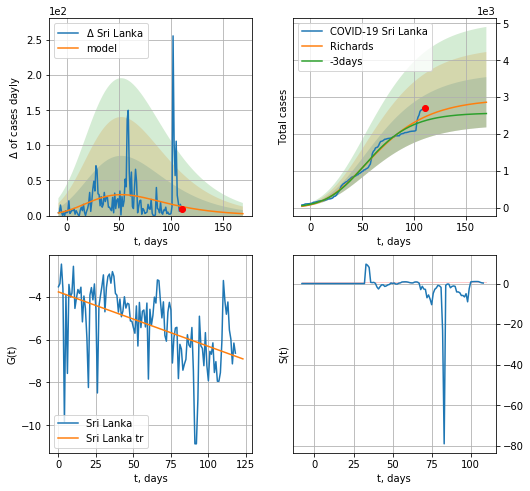

Sri Lanka data at: 2020-11-04
+3 day model MAPE: 0.046566
model: Richards
coeffs: [ 2.95449828e+03  2.23648946e-01 -1.68618598e+01  1.30710649e-01]
rational stdev: 0.238323
forecast at the end of period: +59 days
	 deltaDaycases: 2
	 total cases: 2860 ± 681
	 total death: 5 ± 3
trend coefficient of determination: 0.261938
 intercept: -3.763839
 slope: -0.025471


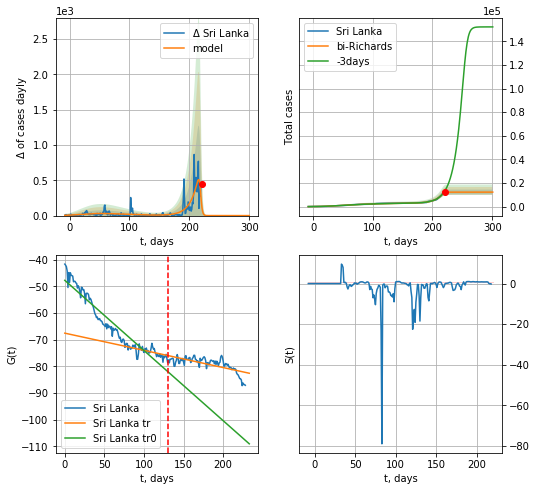

Sri Lanka data at: 2020-11-04
+3 day model MAPE: 0.158221
model: bi-Richards
coeffs: [9.33763490e+03 7.88673430e-02 2.19103845e+02 8.90329366e+00]
rational stdev: 0.175748
forecast at the end of period: +80 days
	 deltaDaycases: 0
	 total cases: 12290 ± 2159
	 total death: 24 ± 12
bi-Richards approximation splitting point: 130
trend coefficient of determination: 0.909877
 intercept: -47.716596
 slope: -0.263160
trend coefficient of determination: 0.480015
 intercept: -67.527186
 slope: -0.064524


In [4967]:
vL=140#88
x = forecastRR('Sri Lanka',dfSri[10:vL-10],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sri Lanka',dfSri[10:],d1,43*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)
#x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
           date     cases  active   death
247 2020-10-31  333970.0   12592  6823.0
248 2020-11-01  335093.0   13242  6835.0
249 2020-11-02  336260.0   13965  6849.0
250 2020-11-03  337573.0   14646  6867.0
251 2020-11-04  338875.0   15317  6893.0


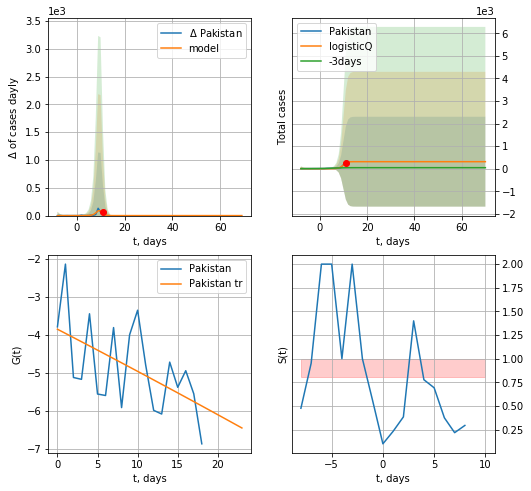

Pakistan data at: 2020-11-04
+3 day model MAPE: 5.954392
model: logisticQ
coeffs: [ 3.10300108e+02  5.80299149e-02  9.88962592e+00 -1.18245382e+01]
rational stdev: 6.420495
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


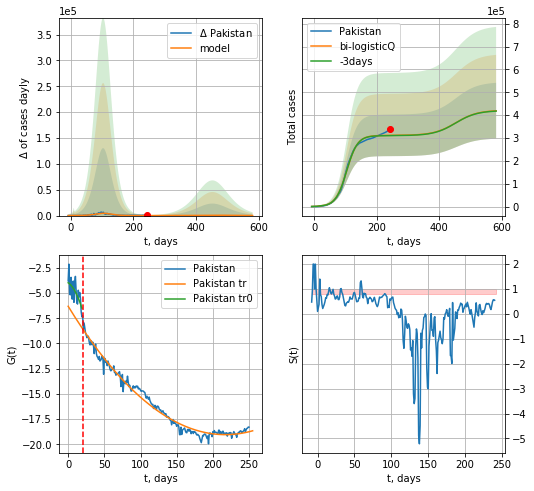

Pakistan data at: 2020-11-04
+3 day model MAPE: 0.003671
model: bi-logisticQ
coeffs: [ 3.11083619e+05  1.42563461e-07  1.03925493e+02 -4.01777113e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.291797
forecast at the end of period: +339 days
	 deltaDaycases: 74
	 total cases: 418960 ± 122251
	 total death: 8522 ± 7460
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.981784
 intercept_: -6.310641645821164
 coeffs_: [ 0.         -0.11709885  0.0002694 ]


In [4968]:
try:
    dfPS = read_df(pd.DataFrame(),"PS")
    vL= 20
    x = forecastRRR('Pakistan',dfPS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Pakistan',dfPS[:],d1,80*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


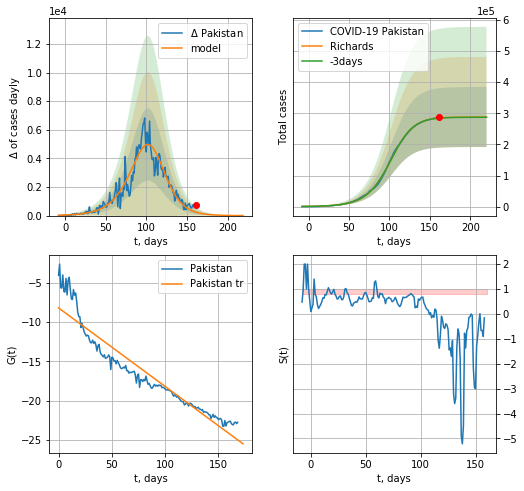

Pakistan data at: 2020-11-04
+3 day model MAPE: 0.002417
model: Richards
coeffs: [2.88169103e+05 5.68558279e-02 1.06265073e+02 1.33731169e+00]
rational stdev: 0.335042
forecast at the end of period: +59 days
	 deltaDaycases: 2
	 total cases: 288131 ± 96536
	 total death: 5860 ± 5890
trend coefficient of determination: 0.903657
 intercept: -8.180854
 slope: -0.100161


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


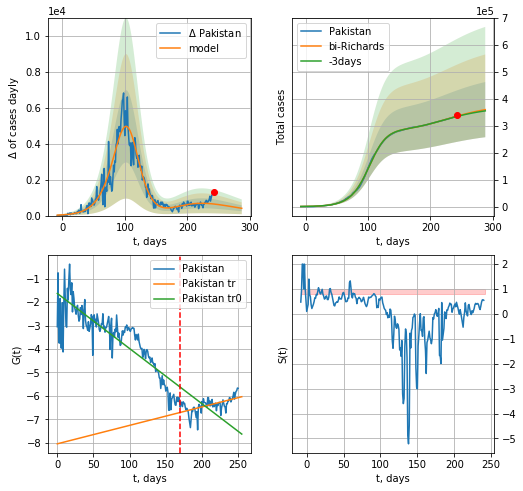

Pakistan data at: 2020-11-04
+3 day model MAPE: 0.003599
model: bi-Richards
coeffs: [ 9.56674543e+04  2.20576070e+00 -1.82931283e+01  8.83463475e-03]
rational stdev: 0.284393
forecast at the end of period: +45 days
	 deltaDaycases: 405
	 total cases: 359817 ± 102329
	 total death: 7318 ± 6243
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.744249
 intercept: -1.634399
 slope: -0.023483
trend coefficient of determination: 0.334864
 intercept: -8.037414
 slope: 0.007862


In [4969]:
vL = 170#25
x = forecastRR('Pakistan',dfPS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Pakistan',dfPS[:],d12f(1),38*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
           date     cases  active   death
237 2020-10-31  409252.0   77371  5941.0
238 2020-11-01  410119.0   77371  5941.0
239 2020-11-02  410988.0   77121  5966.0
240 2020-11-03  412647.0   76877  5983.0
241 2020-11-04  414164.0   76463  6004.0


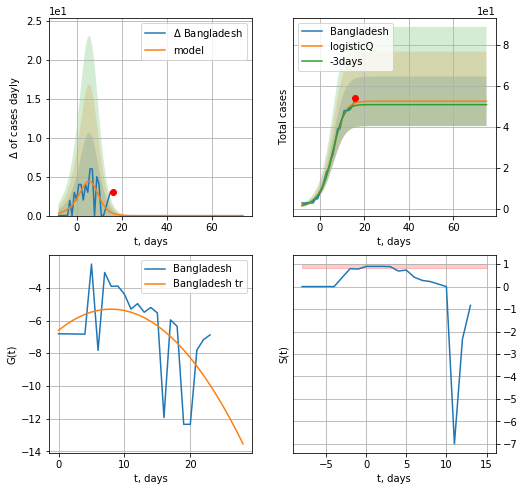

Bangladesh data at: 2020-11-04
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923910e+01  5.83606353e-03  5.49443194e+00 -5.18823422e+01]
rational stdev: 0.229682
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


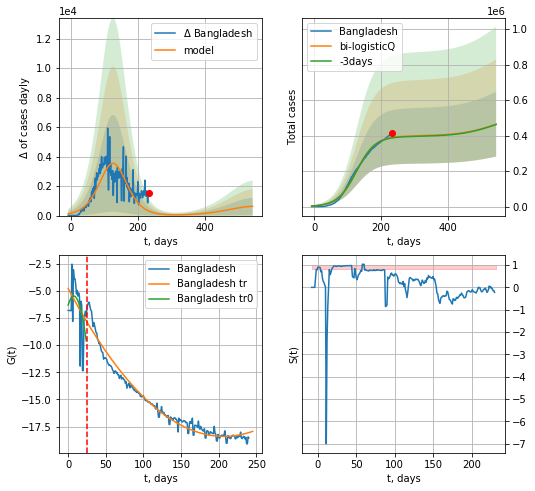

Bangladesh data at: 2020-11-04
+3 day model MAPE: 0.006504
model: bi-logisticQ
coeffs: [ 3.97861387e+05  7.91152528e-08  1.26239112e+02 -4.50218505e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.393371
forecast at the end of period: +311 days
	 deltaDaycases: 629
	 total cases: 464442 ± 182698
	 total death: 6732 ± 7944
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.971161
 intercept_: -4.7939740126971415
 coeffs_: [ 0.         -0.13155592  0.00031794]


In [4970]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
try:
    x = forecastRRR('Bangladesh',dfBN[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Bangladesh',dfBN[:],d1,76*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

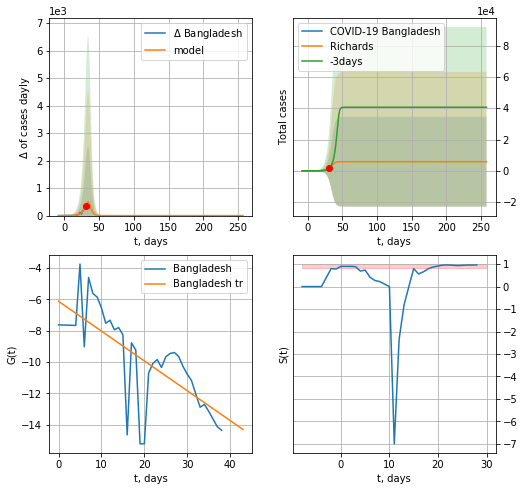

Bangladesh data at: 2020-11-04
+3 day model MAPE: 0.079004
model: Richards
coeffs: [5.83662075e+03 2.41285864e-01 3.62036516e+01 1.74331712e+00]
rational stdev: 4.915459
forecast at the end of period: +227 days
	 deltaDaycases: 0
	 total cases: 5836 ± 28689
	 total death: 84 ± 1238
trend coefficient of determination: 0.544590
 intercept: -6.123432
 slope: -0.190441


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


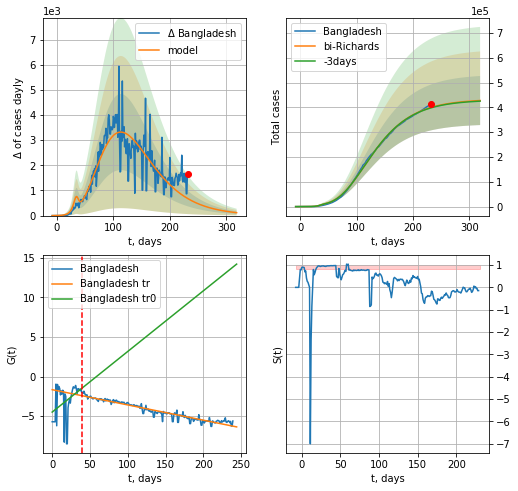

Bangladesh data at: 2020-11-04
+3 day model MAPE: 0.003861
model: bi-Richards
coeffs: [ 4.27251559e+05  2.55369382e+00 -1.12060831e+02  8.30820407e-03]
rational stdev: 0.231282
forecast at the end of period: +87 days
	 deltaDaycases: 116
	 total cases: 427637 ± 98904
	 total death: 6199 ± 4301
bi-Richards approximation splitting point: 40
trend coefficient of determination: 0.168184
 intercept: -4.498788
 slope: 0.076672
trend coefficient of determination: 0.924330
 intercept: -1.664611
 slope: -0.019283


In [4971]:
vL=40
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bangladesh',dfBN[:-1],d1,44*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Bangladesh',dfBN[:],d1,16*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
           date     cases  active  death
250 2020-10-31  125926.0    8285  779.0
251 2020-11-01  126534.0    8194  782.0
252 2020-11-02  127293.0    8121  786.0
253 2020-11-03  128080.0    8211  789.0
254 2020-11-04  128843.0    8307  794.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


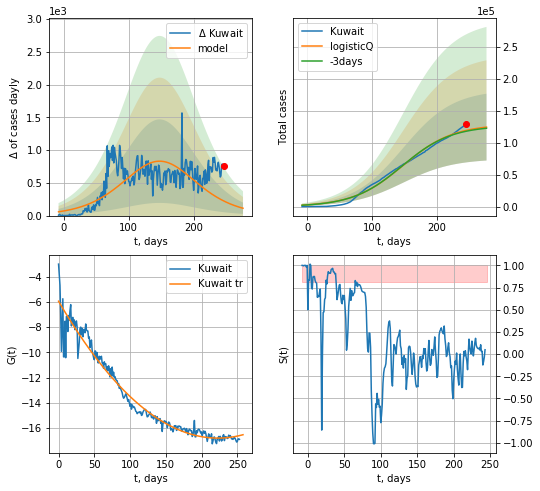

Kuwait data at: 2020-11-04
+3 day model MAPE: 0.011260
model: logisticQ
coeffs: [ 1.28728503e+05  5.27242029e-08  1.48061627e+02 -4.89522235e+05]
rational stdev: 0.420074
forecast at the end of period: +31 days
	 deltaDaycases: 112
	 total cases: 124279 ± 52206
	 total death: 765 ± 964
trend coefficient of determination: 0.956614
 intercept_: -5.946391073316521
 coeffs_: [ 0.         -0.09738931  0.00021846]


In [4972]:
try:
    dfKW = read_df(pd.DataFrame(),"KW")
    x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


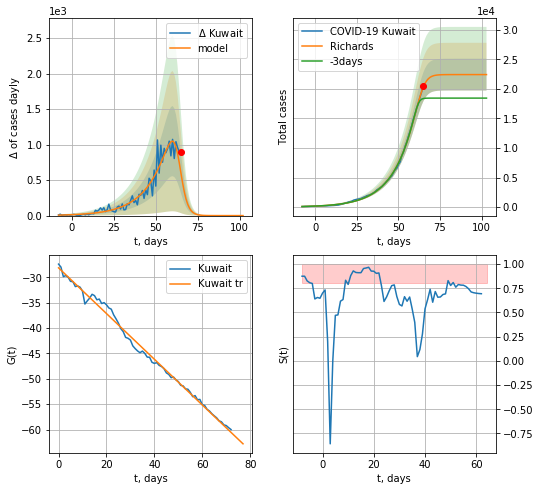

Kuwait data at: 2020-11-04
+3 day model MAPE: 0.136577
model: Richards
coeffs: [2.24365718e+04 7.66634183e-02 6.43548409e+01 5.72971780e+00]
rational stdev: 0.119998
forecast at the end of period: +38 days
	 deltaDaycases: 0
	 total cases: 22436 ± 2692
	 total death: 138 ± 49
trend coefficient of determination: 0.993036
 intercept: -28.143720
 slope: -0.450232


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


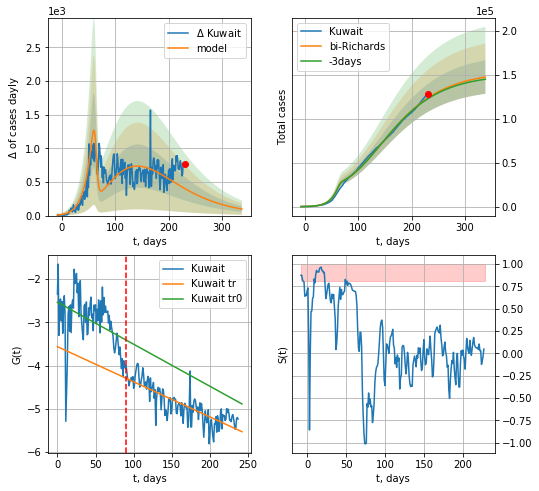

Kuwait data at: 2020-11-04
+3 day model MAPE: 0.007188
model: bi-Richards
coeffs: [ 1.31686008e+05  1.67067046e+00 -1.65681202e+02  9.12949611e-03]
rational stdev: 0.129028
forecast at the end of period: +108 days
	 deltaDaycases: 97
	 total cases: 147640 ± 19049
	 total death: 909 ± 351
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.167039
 intercept: -2.532526
 slope: -0.009725
trend coefficient of determination: 0.672229
 intercept: -3.561053
 slope: -0.008131


In [4973]:
iL= 16
vL = 90 + iL
x = forecastRR('Kuwait',dfKW[iL:vL-iL],d1,37*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Kuwait',dfKW[iL:],d1,47*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

DM
           date     cases  active   death
244 2020-10-31  127018.0   19911  2245.0
245 2020-11-01  127332.0   19794  2249.0
246 2020-11-02  127591.0   19707  2250.0
247 2020-11-03  127848.0   19614  2252.0
248 2020-11-04  128278.0   19717  2257.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


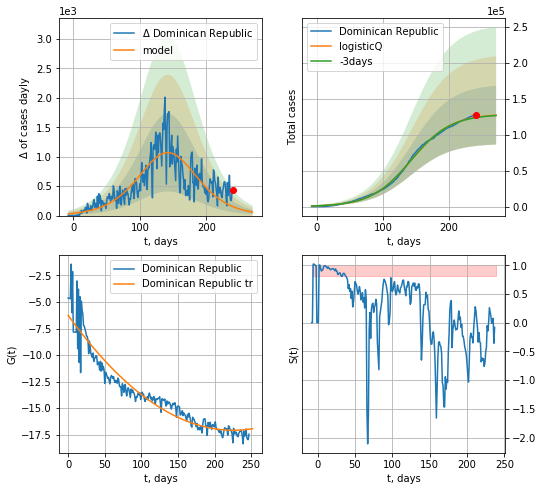

Dominican Republic data at: 2020-11-04
+3 day model MAPE: 0.003714
model: logisticQ
coeffs: [ 1.29216567e+05  4.65972848e-07  1.42398359e+02 -7.09348454e+04]
rational stdev: 0.321483
forecast at the end of period: +31 days
	 deltaDaycases: 59
	 total cases: 127429 ± 40966
	 total death: 2242 ± 2162
trend coefficient of determination: 0.909053
 intercept_: -6.25895598189333
 coeffs_: [ 0.         -0.09594734  0.00021253]


In [4974]:
try:
    dfDM = read_df(pd.DataFrame(),"DM")
    x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


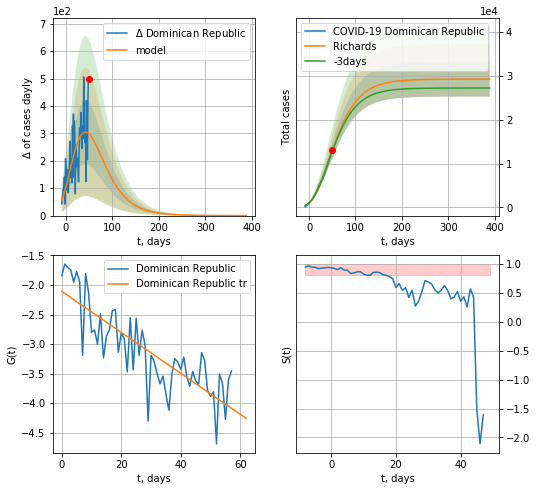

Dominican Republic data at: 2020-11-04
+3 day model MAPE: 0.011985
model: Richards
coeffs: [ 2.92636962e+04  1.52410692e+00 -9.56887865e+01  1.87798018e-02]
rational stdev: 0.135750
forecast at the end of period: +339 days
	 deltaDaycases: 0
	 total cases: 29262 ± 3972
	 total death: 514 ± 209
trend coefficient of determination: 0.671301
 intercept: -2.108314
 slope: -0.034707


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


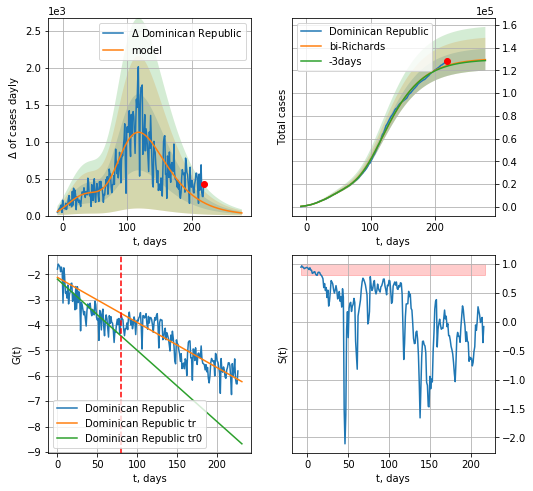

Dominican Republic data at: 2020-11-04
+3 day model MAPE: 0.004392
model: bi-Richards
coeffs: [ 1.01543968e+05  2.97878664e+00 -4.61378837e+01  9.40674424e-03]
rational stdev: 0.074117
forecast at the end of period: +59 days
	 deltaDaycases: 35
	 total cases: 129553 ± 9602
	 total death: 2279 ± 506
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.727919
 intercept: -2.185420
 slope: -0.028128
trend coefficient of determination: 0.782212
 intercept: -2.116648
 slope: -0.017808


In [4975]:
vL = 80+21
x = forecastRR('Dominican Republic',dfDM[21:vL-21],d1,80*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Dominican Republic',dfDM[21:],d1,40*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-21)

MD
           date    cases  active   death
238 2020-10-31  76040.0   18473  1785.0
239 2020-11-01  76582.0   18470  1800.0
240 2020-11-02  76777.0   18084  1818.0
241 2020-11-03  77487.0   18247  1838.0
242 2020-11-04  78507.0   18364  1851.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


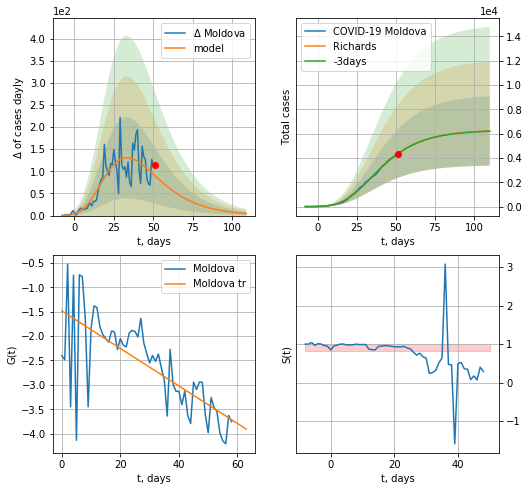

Moldova data at: 2020-11-04
+3 day model MAPE: 0.000798
model: Richards
coeffs: [ 6.30547519e+03  3.98861804e+00 -4.11482156e+01  1.42375767e-02]
rational stdev: 0.458356
forecast at the end of period: +59 days
	 deltaDaycases: 4
	 total cases: 6223 ± 2852
	 total death: 146 ± 200
trend coefficient of determination: 0.512178
 intercept: -1.485670
 slope: -0.038427


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


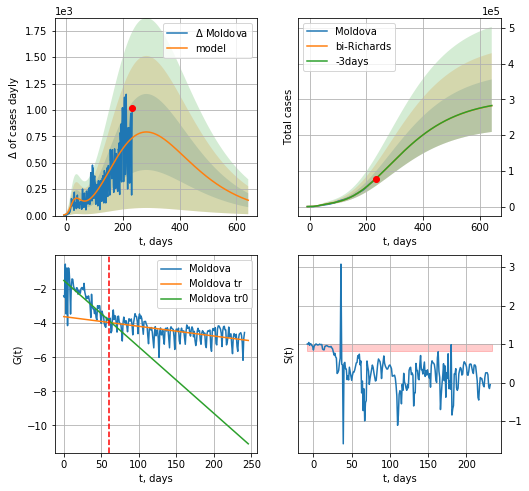

Moldova data at: 2020-11-04
+3 day model MAPE: 0.000145
model: bi-Richards
coeffs: [ 2.96624845e+05  4.06572028e-01 -2.65131230e+02  1.80142619e-02]
rational stdev: 0.260013
forecast at the end of period: +409 days
	 deltaDaycases: 145
	 total cases: 282407 ± 73429
	 total death: 6658 ± 5193
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.532785
 intercept: -1.493025
 slope: -0.038974
trend coefficient of determination: 0.319795
 intercept: -3.612708
 slope: -0.005692


In [4976]:
dfMD = read_df(pd.DataFrame(),"MD")
dfMD = dfMD.fillna(0)
try:
    vL = 60
    x = forecastRR("Moldova",dfMD[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Moldova",dfMD[:],d1,90*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [4977]:
#np.diff(dfAF["cases"])

AF
           date     cases  active    death
240 2020-10-31  725452.0   51994  19276.0
241 2020-11-01  726823.0   52082  19411.0
242 2020-11-02  727595.0   50630  19465.0
243 2020-11-03  728836.0   50038  19539.0
244 2020-11-04  730548.0   50778  19585.0


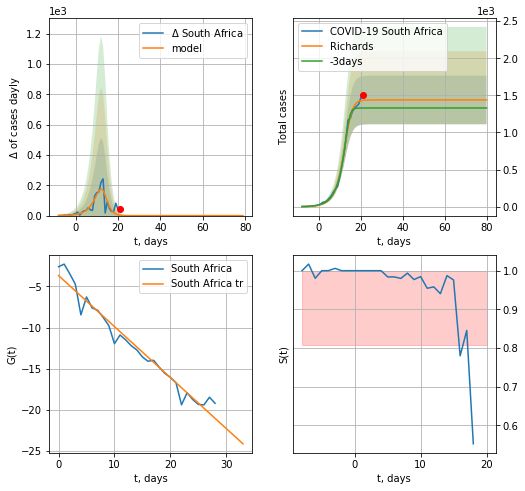

South Africa data at: 2020-11-04
+3 day model MAPE: 0.079443
model: Richards
coeffs: [1.43832006e+03 3.09188711e-01 1.37785511e+01 2.13840843e+00]
rational stdev: 0.227967
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 1438 ± 327
	 total death: 38 ± 25
trend coefficient of determination: 0.961533
 intercept: -3.675972
 slope: -0.619731


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


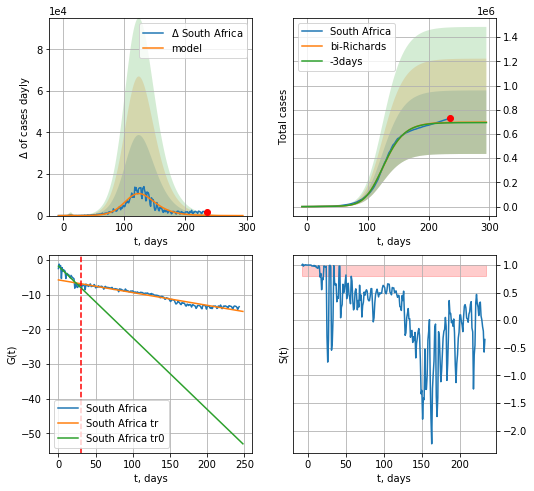

South Africa data at: 2020-11-04
+3 day model MAPE: 0.004573
model: bi-Richards
coeffs: [6.96286758e+05 9.54649581e-02 1.12482520e+02 5.47935249e-01]
rational stdev: 0.376194
forecast at the end of period: +59 days
	 deltaDaycases: 4
	 total cases: 697634 ± 262445
	 total death: 18702 ± 21106
bi-Richards approximation splitting point: 30
trend coefficient of determination: 0.818408
 intercept: -1.752971
 slope: -0.206612
trend coefficient of determination: 0.946727
 intercept: -5.730910
 slope: -0.036649


In [4978]:
dfAF = read_df(pd.DataFrame(),"AF").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 30
    x = forecastRR("South Africa",dfAF[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("South Africa",dfAF[:],d1,T18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

UB
           date  cases  active  death
230 2020-10-31  67055    2252  568.0
231 2020-11-01  67254    2217  571.0
232 2020-11-02  67501    2259  571.0
233 2020-11-03  67698    2238  575.0
234 2020-11-04  67932    2241  579.0


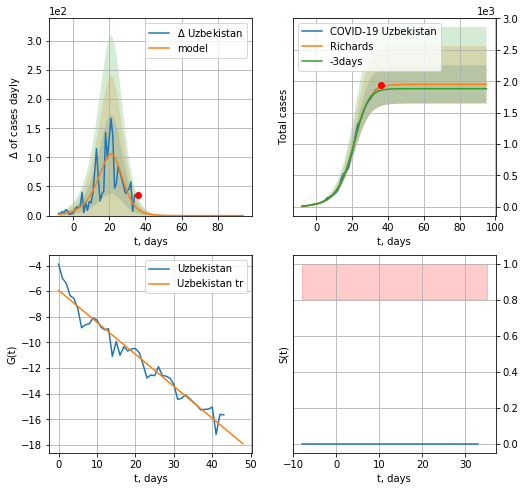

Uzbekistan data at: 2020-11-04
+3 day model MAPE: 0.027380
model: Richards
coeffs: [1.95086939e+03 1.63729535e-01 2.32758397e+01 1.53766466e+00]
rational stdev: 0.156222
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 1950 ± 304
	 total death: 16 ± 7
trend coefficient of determination: 0.953191
 intercept: -5.936816
 slope: -0.249439


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


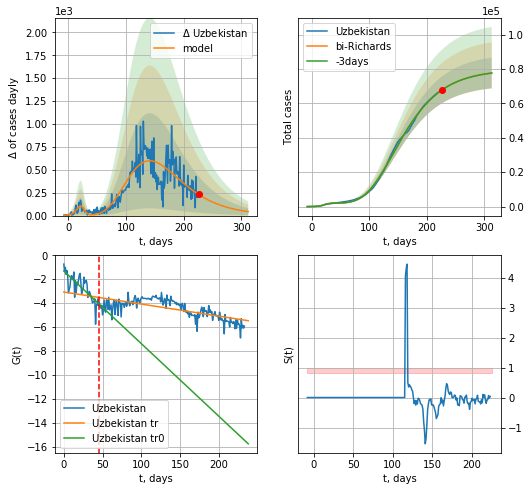

Uzbekistan data at: 2020-11-04
+3 day model MAPE: 0.000418
model: bi-Richards
coeffs: [ 7.78041426e+04  9.15464107e-01 -3.66675979e+01  2.31023089e-02]
rational stdev: 0.114880
forecast at the end of period: +87 days
	 deltaDaycases: 43
	 total cases: 77714 ± 8927
	 total death: 662 ± 228
bi-Richards approximation splitting point: 45
trend coefficient of determination: 0.600780
 intercept: -1.318987
 slope: -0.060712
trend coefficient of determination: 0.485177
 intercept: -3.072668
 slope: -0.010088


In [4979]:
dfUB = read_df(pd.DataFrame(),"UB").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 45
    x = forecastRR("Uzbekistan",dfUB[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Uzbekistan",dfUB[:],d1,44*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [4980]:
dfAFG = read_df(pd.DataFrame(),"AFG").fillna(0)
#dfAFG['active'] = np.zeros(len(dfAFG))
#dfAFG.tail()

AFG
           date  cases  active   death
214 2020-10-31  41501  5639.0  1536.0
215 2020-11-01  41633  5750.0  1541.0
216 2020-11-02  41728  5829.0  1544.0
217 2020-11-03  41814  5904.0  1548.0
218 2020-11-04  41935  5941.0  1554.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


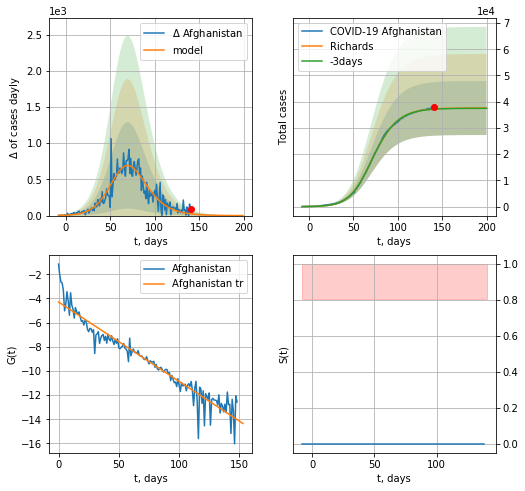

Afghanistan data at: 2020-11-04
+3 day model MAPE: 0.002616
model: Richards
coeffs: [3.76180908e+04 1.03902591e-01 6.27870896e+01 6.26119251e-01]
rational stdev: 0.274011
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 37610 ± 10305
	 total death: 1393 ± 1145
trend coefficient of determination: 0.924978
 intercept: -4.288806
 slope: -0.065757


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


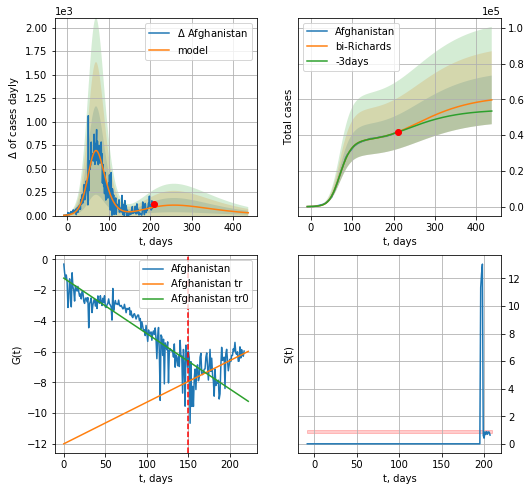

Afghanistan data at: 2020-11-04
+3 day model MAPE: 0.003392
model: bi-Richards
coeffs: [ 2.46557497e+04  1.19082228e+00 -1.12033771e+02  1.03750979e-02]
rational stdev: 0.228030
forecast at the end of period: +227 days
	 deltaDaycases: 29
	 total cases: 59725 ± 13619
	 total death: 2213 ± 1513
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.802745
 intercept: -1.215730
 slope: -0.036090
trend coefficient of determination: 0.249685
 intercept: -11.994089
 slope: 0.027096


In [4982]:
#dfAFG = read_df(pd.DataFrame(),"AFG").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 150 + 0
    x = forecastRR("Afghanistan",dfAFG[0:vL],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Afghanistan",dfAFG[0:],d1,64*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-0)
except:
    print("Exception occurs")

In [795]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [4612]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=19:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"NewRecovered"
9:"ActiveCases"
10:"Serious,Critical"
11:"Tot Cases/1M pop"
12:"Deaths/1M pop"
13:"TotalTests"
14:"Tests/
1M pop
"
15:"Population"
16:"Continent"
17:"1 Caseevery X ppl"
18:"1 Deathevery X ppl"
19:"1 Testevery X ppl"
[704, 704, 704, 704, 704, 704, 704, 704, 704, 704, 704, 704, 704, 704, 704, 704, 704, 704, 704]


In [4613]:
df.head(10)
#df.columns[18]

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/\n1M pop\n,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"11,683,249","+7,000","358,640",680,"7,703,446","+5,844","3,621,163","21,735",,,,,,North America,\n,,
1,,\nAsia\n,"14,048,637","+10,090","249,251",130,"12,537,763","+7,982","1,261,623","22,539",,,,,,Asia,\n,,
2,,\nSouth America\n,"9,827,408",126,"298,817",7,"8,828,637",316,"699,954","17,958",,,,,,South America,\n,,
3,,\nEurope\n,"11,047,048","+53,120","280,045",829,"4,116,471","+36,416","6,650,532","24,782",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,840,838","+1,971","44,077",65,"1,529,549","+31,695","267,212","2,436",,,,,,Africa,\n,,
5,,\nOceania\n,"39,569",14,980,,"32,787",21,"5,802",26,,,,,,Australia/Oceania,\n,,
6,,\n\n,721,,15,,659,,47,4,,,,,,,\n,,
7,,World,"48,487,470","+72,321","1,231,825","+1,711","34,749,312","+82,274","12,506,333","89,480","6,220",158.0,,,,All,\n,,
8,1,USA,"9,802,374","+1,019","239,842",13,"6,293,132","+1,113","3,269,400","18,045","29,554",723,"152,052,680","458,439","331,674,530",North America,34,"1,383",2
9,2,India,"8,364,086",674,"124,354",,"7,711,809","+1,179","527,923","8,944","6,040",90,"114,208,384","82,480","1,384,678,624",Asia,166,"11,135",12


In [4614]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"11,683,249","+7,000","358,640",680,"7,703,446","+5,844","3,621,163","21,735",,,,,,North America,\n,,
1,,\nAsia\n,"14,048,637","+10,090","249,251",130,"12,537,763","+7,982","1,261,623","22,539",,,,,,Asia,\n,,
2,,\nSouth America\n,"9,827,408",126,"298,817",7,"8,828,637",316,"699,954","17,958",,,,,,South America,\n,,
3,,\nEurope\n,"11,047,048","+53,120","280,045",829,"4,116,471","+36,416","6,650,532","24,782",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,840,838","+1,971","44,077",65,"1,529,549","+31,695","267,212","2,436",,,,,,Africa,\n,,


In [4615]:
df[df["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
103,96,Lithuania,"18,092",,182,,"5,082",,"12,828",51,"6,679",67,"1,050,223","387,700","2,708,852",Europe,150,"14,884",3
339,97,Lithuania,"18,092",639,182,7,"5,082",148,"12,828",51,"6,679",67,"1,050,223","387,700","2,708,852",Europe,150,"14,884",3
574,97,Lithuania,"17,453",897,175,5,"4,934",43,"12,344",35,"6,443",65,"1,038,164","383,249","2,708,852",Europe,155,"15,479",3


In [4616]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

234


In [4617]:
df.head(55)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"11,683,249","+7,000","358,640",680,"7,703,446","+5,844","3,621,163","21,735",,,,,,North America,\n,,
1,,\nAsia\n,"14,048,637","+10,090","249,251",130,"12,537,763","+7,982","1,261,623","22,539",,,,,,Asia,\n,,
2,,\nSouth America\n,"9,827,408",126,"298,817",7,"8,828,637",316,"699,954","17,958",,,,,,South America,\n,,
3,,\nEurope\n,"11,047,048","+53,120","280,045",829,"4,116,471","+36,416","6,650,532","24,782",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,840,838","+1,971","44,077",65,"1,529,549","+31,695","267,212","2,436",,,,,,Africa,\n,,
5,,\nOceania\n,"39,569",14,980,,"32,787",21,"5,802",26,,,,,,Australia/Oceania,\n,,
6,,\n\n,721,,15,,659,,47,4,,,,,,,\n,,
7,,World,"48,487,470","+72,321","1,231,825","+1,711","34,749,312","+82,274","12,506,333","89,480","6,220",158.0,,,,All,\n,,
8,1,USA,"9,802,374","+1,019","239,842",13,"6,293,132","+1,113","3,269,400","18,045","29,554",723,"152,052,680","458,439","331,674,530",North America,34,"1,383",2
9,2,India,"8,364,086",674,"124,354",,"7,711,809","+1,179","527,923","8,944","6,040",90,"114,208,384","82,480","1,384,678,624",Asia,166,"11,135",12


In [4618]:
df.at[16, 'TotalRecovered'] = 0
df.at[13, 'TotalRecovered'] = 0
df.at[32, 'TotalRecovered'] = 0
df.at[45, 'TotalRecovered'] = 0
#df.at[109, 'TotalRecovered'] = 0
df.at[16,"ActiveCases"] = 0
df.at[13,"ActiveCases"] = 0
df.at[32,"ActiveCases"] = 0
df.at[45,"ActiveCases"] = 0
#df.at[109,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [4619]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,11683249,7000.0,358640.0,680.0,7703446.0,"+5,844",3621163,21735.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,\nAsia\n,14048637,10090.0,249251.0,130.0,12537763.0,"+7,982",1261623,22539.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,\nSouth America\n,9827408,126.0,298817.0,7.0,8828637.0,316,699954,17958.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,\nEurope\n,11047048,53120.0,280045.0,829.0,4116471.0,"+36,416",6650532,24782.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,\nAfrica\n,1840838,1971.0,44077.0,65.0,1529549.0,"+31,695",267212,2436.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,\nOceania\n,39569,14.0,980.0,NaN,32787.0,21,5802,26.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
6,,\n\n,721,NaN,15.0,NaN,659.0,,47,4.0,NaN,NaN,NaN,NaN,,,\n,,
7,,World,48487470,72321.0,1231825.0,1711.0,34749312.0,"+82,274",12506333,89480.0,6220.0,158.0,NaN,NaN,,All,\n,,
8,1,USA,9802374,1019.0,239842.0,13.0,6293132.0,"+1,113",3269400,18045.0,29554.0,723.0,152052680.0,458439.0,"331,674,530",North America,34,"1,383",2
9,2,India,8364086,674.0,124354.0,NaN,7711809.0,"+1,179",527923,8944.0,6040.0,90.0,114208384.0,82480.0,"1,384,678,624",Asia,166,"11,135",12


In [4620]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
229,,Total:,11047048,53120.0,280045.0,829.0,4116471.0,"+36,416",6650532,24782.0,NaN,NaN,NaN,NaN,,Europe,,,
230,,Total:,1840838,1971.0,44077.0,65.0,1529549.0,"+31,695",267212,2436.0,NaN,NaN,NaN,NaN,,Africa,,,
231,,Total:,39569,14.0,980.0,NaN,32787.0,,5802,26.0,NaN,NaN,NaN,NaN,,Australia/Oceania,,,
232,,Total:,721,NaN,15.0,NaN,659.0,,47,4.0,NaN,NaN,NaN,NaN,,,,,
233,NaN,European Union,7212035,23866.0,184862.0,344.0,1801181.0,NaN,3399738,19809.0,16197.701683,415.186494,118582141.0,266326.791933,NaN,Europe,NaN,NaN,NaN


In [4621]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,11683249,7000.0,358640.0,680.0,7703446.0,"+5,844",3621163,21735.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,Asia,14048637,10090.0,249251.0,130.0,12537763.0,"+7,982",1261623,22539.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,South America,9827408,126.0,298817.0,7.0,8828637.0,316,699954,17958.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,Europe,11047048,53120.0,280045.0,829.0,4116471.0,"+36,416",6650532,24782.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,1840838,1971.0,44077.0,65.0,1529549.0,"+31,695",267212,2436.0,NaN,NaN,NaN,NaN,,Africa,\n,,


In [4622]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [4623]:
#df

In [4624]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,11683249,7000.0,358640.0,680.0,7703446.0,"+5,844",3621163,21735.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,Asia,14048637,10090.0,249251.0,130.0,12537763.0,"+7,982",1261623,22539.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,South America,9827408,126.0,298817.0,7.0,8828637.0,316,699954,17958.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,Europe,11047048,53120.0,280045.0,829.0,4116471.0,"+36,416",6650532,24782.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,1840838,1971.0,44077.0,65.0,1529549.0,"+31,695",267212,2436.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,Oceania,39569,14.0,980.0,NaN,32787.0,21,5802,26.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
7,,World,48487470,72321.0,1231825.0,1711.0,34749312.0,"+82,274",12506333,89480.0,6220.0,158.0,NaN,NaN,,All,\n,,
8,1,USA,9802374,1019.0,239842.0,13.0,6293132.0,"+1,113",3269400,18045.0,29554.0,723.0,152052680.0,458439.0,"331,674,530",North America,34,"1,383",2
9,2,India,8364086,674.0,124354.0,NaN,7711809.0,"+1,179",527923,8944.0,6040.0,90.0,114208384.0,82480.0,"1,384,678,624",Asia,166,"11,135",12
10,3,Brazil,5590941,NaN,161170.0,NaN,5064344.0,,365427,8318.0,26238.0,756.0,21900000.0,102777.0,"213,081,672",South America,38,"1,322",10


In [4625]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [4626]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS",
    "Moldova":"MD",
    "Uzbekistan":"UB",
    "Afghanistan":"AFG"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

USA US
Italy IT
Spain SP
Germany GR
France FR
Iran IN
UK GB
Switzerland SZ
S. Korea KR
Norway NG
Sweden SW
Israel IS
Denmark DK
Poland PL
Estonia ES
Ukraine Ukr
Latvia LV
Lithuania LT
China CN
Russia RS
Japan JP
Netherlands NL
Belgium BG
Singapore SG
Austria AT
Turkey TR
Canada CA
Portugal PT
World World
Australia AS
Brazil BZ
Malaysia ML
New Zealand ZL
Belarus BR
Ireland IR
Chile CL
Czechia CH
Romania RM
Finland FI
India ID
Ecuador ED
Philippines PH
Luxembourg LX
Saudi Arabia SA
Thailand TH
Indonesia IE
Mexico MX
Panama PM
Peru PU
Serbia SB
South Africa AF
UAE UAE
Argentina AG
Iceland IC
Colombia CB
Qatar QR
Algeria AR
Croatia CT
Egypt EG
Slovenia SV
Morocco MR
Iraq IQ
European Union EU
Bulgaria BL
Hungary HG
Malta MT
Slovakia SL
Cyprus CP
Greece GC
Dominican Republic DM
Kuwait KW
Bangladesh BN
Sri Lanka Sri
Pakistan PS
Moldova MD
Uzbekistan UB
Afghanistan AFG


In [4627]:
len(countryDic)

77

In [4628]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    print (c)
    #if c in ['North America','South America','Asia','Europe','Africa','Oceania','World']:
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America
North America 2020-11-04,11683249,3621163,358640.0
Asia
Asia
Asia 2020-11-04,14048637,1261623,249251.0
South America
South America
South America 2020-11-04,9827408,699954,298817.0
Europe
Europe
Europe 2020-11-04,11047048,6650532,280045.0
Africa
Africa
Africa 2020-11-04,1840838,267212,44077.0
Oceania
Oceania
Oceania 2020-11-04,39569,5802,980.0
World
World
World 2020-11-04,48487470,12506333,1231825.0
USA
USA
USA 2020-11-04,9802374,3269400,239842.0
India
India
India 2020-11-04,8364086,527923,124354.0
Brazil
Brazil
Brazil 2020-11-04,5590941,365427,161170.0
Russia
Russia
Russia 2020-11-04,1712858,404180,29509.0
France
France
France 2020-11-04,1543321,1381985,38674.0
Spain
Spain
Spain 2020-11-04,1356798,0,38118.0
Argentina
Argentina
Argentina 2020-11-04,1205928,155761,32520.0
Colombia
Colombia
Colombia 2020-11-04,1108084,73869,32013.0
UK
UK
UK 2020-11-04,1099059,0,47742.0
Mexico
Mexico
Mexico 2020-11-04,943630,153000,93228.0
Peru
Peru
Peru 2020-11-04,911787,41422,

Niger 2020-11-04,1225,14,69.0
Vietnam
Vietnam
Vietnam 2020-11-04,1207,103,35.0
Curaçao
Curaçao
Curaçao 2020-11-04,1021,273,2.0
San Marino
San Marino
San Marino 2020-11-04,994,222,42.0
Sao Tome and Principe
Sao Tome and Principe
Sao Tome and Principe 2020-11-04,958,35,16.0
Channel Islands
Channel Islands
Channel Islands 2020-11-04,893,94,48.0
Sint Maarten
Sint Maarten
Sint Maarten 2020-11-04,870,80,22.0
Gibraltar
Gibraltar
Gibraltar 2020-11-04,743,93,nan
Diamond Princess
Diamond Princess
Diamond Princess 2020-11-04,712,40,13.0
Turks and Caicos
Turks and Caicos
Turks and Caicos 2020-11-04,705,8,6.0
Liechtenstein
Liechtenstein
Liechtenstein 2020-11-04,659,233,3.0
Burundi
Burundi
Burundi 2020-11-04,606,94,1.0
Saint Martin
Saint Martin
Saint Martin 2020-11-04,604,70,12.0
Papua New Guinea
Papua New Guinea
Papua New Guinea 2020-11-04,597,10,7.0
Taiwan
Taiwan
Taiwan 2020-11-04,569,39,7.0
Comoros
Comoros
Comoros 2020-11-04,554,30,7.0
Tanzania
Tanzania
Tanzania 2020-11-04,509,305,21.0
Faeroe Isl

In [4629]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [4630]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaUS.csv 2020-11-04,9802374,3269400,239842.0

append data/coronaIT.csv 2020-11-04,790377,443235,39764.0

append data/coronaSP.csv 2020-11-04,1356798,0,38118.0

append data/coronaGR.csv 2020-11-04,597453,194824,11029.0

append data/coronaFR.csv 2020-11-04,1543321,1381985,38674.0

append data/coronaIN.csv 2020-11-04,646164,109185,36579.0

append data/coronaGB.csv 2020-11-04,1099059,0,47742.0

append data/coronaSZ.csv 2020-11-04,192376,102721,2555.0

append data/coronaKR.csv 2020-11-04,27050,1840,475.0

append data/coronaNG.csv 2020-11-04,22578,10433,282.0

append data/coronaSW.csv 2020-11-04,137730,0,5997.0

append data/coronaIS.csv 2020-11-04,317556,9406,2597.0

append data/coronaDK.csv 2020-11-04,50530,12909,729.0

append data/coronaPL.csv 2020-11-04,439536,264101,6475.0

append data/coronaES.csv 2020-11-04,5464,1359,73.0

append data/coronaUkr.csv 2020-11-04,430467,237761,7924.0

append data/coronaLV.csv 2020-11-04,6752,5223,85.0

append data/coronaLT.csv 2020-11-04,18

In [4631]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [4632]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF","Afghanistan":"AFG"}
    
for  c in cD3:#countryDic1:
    if c != "Afghanistan":
        continue
    dfc = pd.read_csv("data/europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/data1/corona%s.csv'%(cD3[c]), index=False)#countryDic1

Afghanistan 41814


In [3584]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [3585]:
dfc.tail()#[['date', 'cases']]

,date,day,month,year,cases,deaths,countriesAndTerritories,geoId,countryterritoryCode,popData2019,continentExp,Cumulative_number_for_14_days_of_COVID-19_cases_per_100000
5,2020-10-28,28,10,2020,41145,7,Afghanistan,AF,AFG,38041757.0,Asia,3.025623
3,2020-10-30,30,10,2020,41268,3,Afghanistan,AF,AFG,38041757.0,Asia,3.264833
2,2020-10-31,31,10,2020,41425,4,Afghanistan,AF,AFG,38041757.0,Asia,3.553989
1,2020-11-01,1,11,2020,41501,0,Afghanistan,AF,AFG,38041757.0,Asia,3.575019
0,2020-11-02,2,11,2020,41633,5,Afghanistan,AF,AFG,38041757.0,Asia,3.766913


In [3586]:
date(2012, 3, 16)

datetime.date(2012, 3, 16)

In [3587]:
len(countriesEU)

27

In [3588]:
dfc = pd.read_csv("data/europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('data/corona%s_new.csv'%("EU"), index=False)

Afghanistan 6509157


In [3589]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [3590]:
#dfD

In [3591]:
#dfAll[dfAll['Country'].isin(cLst)]

In [3592]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

825115267.0 106088.67349825139


In [3593]:
TT/7.7776e3

106088.67349825139

In [3594]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

257921.18232119546

In [3595]:
sum(dfp.Population)/1e6

16014.157998

In [3596]:
dfAll[dfAll.TotalTests>0]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
7,1.0,USA,9475788,1877.0,236501.0,30.0,6104417.0,812,3134870,17205.0,28571.00000,713.000000,145042416.0,437324.000000,"331,658,650",North America,35,"1,402",2
8,2.0,India,8230711,1389.0,122651.0,9.0,7544798.0,"+1,893",563262,8944.0,5945.00000,89.000000,110743103.0,79984.000000,"1,384,567,503",Asia,168,"11,289",13
9,3.0,Brazil,5545705,0.0,160104.0,0.0,4980942.0,0,404659,8318.0,26028.00000,751.000000,21900000.0,102783.000000,"213,069,306",South America,38,"1,331",10
10,4.0,Russia,1655038,18257.0,28473.0,238.0,1236033.0,"+10,360",390532,2300.0,11339.00000,195.000000,61541970.0,421648.000000,"145,955,748",Europe,88,"5,126",2
11,5.0,France,1413915,0.0,37019.0,0.0,118227.0,0,1258669,3578.0,21645.00000,567.000000,16303968.0,249592.000000,"65,322,540",Europe,46,"1,765",4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
218,212.0,Solomon Islands,13,5.0,0.0,0.0,4.0,0,9,0.0,19.00000,0.000000,115.0,166.000000,"692,441",Australia/Oceania,"53,265",0,"6,021"
221,215.0,Anguilla,3,0.0,0.0,0.0,3.0,0,0,0.0,199.00000,0.000000,1329.0,88317.000000,"15,048",North America,"5,016",0,11
223,217.0,Wallis and Futuna,1,0.0,0.0,0.0,1.0,0,0,0.0,90.00000,0.000000,1046.0,93635.000000,"11,171",Australia/Oceania,"11,171",0,11
224,218.0,China,86021,24.0,4634.0,0.0,81024.0,20,363,12.0,60.00000,3.000000,160000000.0,111163.000000,"1,439,323,776",Asia,"16,732","310,601",9


In [3597]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [3598]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [3599]:
#cDicEU["Ireland"][1]

In [3600]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

257921.18232119546

In [3601]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [3602]:
#dfAll

In [3603]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

112540.02452969245

In [3604]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait",
"Dominican Republic","Moldova","South Africa","China","Uzbekistan"         
]

In [3605]:
len(CList)

73

In [3606]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

5610505190

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400